# PFAS Toolbox -  Thomas Dairy Soils Analysis

### 1) Libraries Import (REQUIRED)

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import itertools
import scipy.stats
import statsmodels.api as sm
from statsmodels.graphics.agreement import mean_diff_plot
from scipy.stats import ks_2samp
from matplotlib.font_manager import FontProperties
from matplotlib.ticker import FixedLocator, FixedFormatter
from matplotlib.ticker import AutoMinorLocator
from matplotlib.patches import Rectangle
from matplotlib.lines import Line2D


### Default Font Settings

In [2]:
# Set default tick label size
plt.rcParams['xtick.labelsize'] = 22
plt.rcParams['ytick.labelsize'] = 22

# Set default font size for title, labels, and legend
plt.rcParams['axes.titlesize'] = 30  # Set the font size for plot titles
plt.rcParams['axes.labelsize'] = 24  # Set the font size for axis labels
plt.rcParams['legend.fontsize'] = 20  # Set the font size for legend
plt.rcParams['legend.title_fontsize'] = 22  # Set the font size for legend

# Set default font family to Arial
plt.rcParams['font.family'] = 'Arial'

# Set default font type for plot titles to bold
plt.rcParams['axes.titleweight'] = 'bold'
plt.rcParams['axes.labelweight'] = 'normal' # for bland-altman plots  
plt.rcParams['axes.labelweight'] = 'bold'  #for stack bars

### 2) Data Import (REQUIRED)

In [3]:
def read_excel_sheet(excel_file, sheet_name):
    """
    Read a specific sheet from an Excel file into a DataFrame.

    Args:
        excel_file (str): The path to the Excel file.
        sheet_name (str): The name of the sheet to read.

    Returns:
        pd.DataFrame or None: A DataFrame containing the sheet data or None if the sheet is not found.
    """
    try:
        # Load the specified sheet from the Excel file into a DataFrame
        df = pd.read_excel(excel_file, sheet_name=sheet_name, skiprows=1)
        return df
    except Exception as e:
        print(f"An error occurred: {str(e)}")
        return None


#### 2.1) Read Macro

In [4]:
# Example usage:

#Specify where the file is saved use '/' instead of '\'
excel_file_path = 'U:/Research_and_Innovation/_ModellingGroupProjects/PFAS Investigations/Data and analysis/Database as of 12-12-2024.xlsm'
#Specify sheet name
sheet_name = 'PFAS Database'

#Call data import function
data_df = read_excel_sheet(excel_file_path, sheet_name)

data_df.head()


,Sampling point Date Component,Sample Number,Sampling Point,Sample Name,Sampled Date,Analysis,Component,Qualifiers,Result,Units,...,ChainLength,Pseudonym,Dominant Contributor,Sector,Depth,Edit Notes,Field,Notes,Region,Crop
0,ANODIZE SOLUTIONS (FPT)-43692.3333333333-10:2F...,259452.0,ANODIZE SOLUTIONS (FPT),NaN,2019-08-15 08:00:00,PFAS-CL,10:2Fluorotelomersulfonic Acid (Report),NaN,<9.40,ppt_wt_v,...,12.0,Metal Finisher B,NaN,Metal Finishing,NaN,NaN,NaN,NaN,NaN,NaN
1,ANODIZE SOLUTIONS (FPT)-43692.3333333333-11Cl-...,259452.0,ANODIZE SOLUTIONS (FPT),NaN,2019-08-15 08:00:00,PFAS-CL,11Cl-PF3OUdS (Report),NaN,<4.70,ppt_wt_v,...,10.0,Metal Finisher B,NaN,Metal Finishing,NaN,NaN,NaN,NaN,NaN,NaN
2,ANODIZE SOLUTIONS (FPT)-43692.3333333333-4:2Fl...,259452.0,ANODIZE SOLUTIONS (FPT),NaN,2019-08-15 08:00:00,PFAS-CL,4:2Fluorotelomersulfonic Acid (Report),NaN,<4.70,ppt_wt_v,...,6.0,Metal Finisher B,NaN,Metal Finishing,NaN,NaN,NaN,NaN,NaN,NaN
3,ANODIZE SOLUTIONS (FPT)-43692.3333333333-6:2Fl...,259452.0,ANODIZE SOLUTIONS (FPT),NaN,2019-08-15 08:00:00,PFAS-CL,6:2Fluorotelomersulfonic Acid (Report),NaN,<19.0,ppt_wt_v,...,8.0,Metal Finisher B,NaN,Metal Finishing,NaN,NaN,NaN,NaN,NaN,NaN
4,ANODIZE SOLUTIONS (FPT)-43692.3333333333-8:2Fl...,259452.0,ANODIZE SOLUTIONS (FPT),NaN,2019-08-15 08:00:00,PFAS-CL,8:2Fluorotelomersulfonic Acid (Report),NaN,<9.40,ppt_wt_v,...,10.0,Metal Finisher B,NaN,Metal Finishing,NaN,NaN,NaN,NaN,NaN,NaN


### 3) Import PFAS Compounds Attributes (REQUIRED)

In [5]:
# Import PFAS Attributes

#Specify where the file is saved use '/' instead of '\'
excel_file_path = 'U:/Research_and_Innovation/_ModellingGroupProjects/PFAS Investigations/Data and analysis/Database as of 12-12-2024.xlsm'
#Specify sheet name
sheet_name = 'PFAS Attributes'

df_PFAS_Attributes = pd.read_excel(excel_file_path, sheet_name=sheet_name)

In [6]:
# Create a dictionary mapping PFAS Compounds to their corresponding Abbreviation (No need to change)
pfas_mapping = dict(zip(df_PFAS_Attributes['Database'], df_PFAS_Attributes['Abbrev']))

In [7]:
# Load the Excel file into a DataFrame
df = pd.read_excel("U:/Research_and_Innovation/_ModellingGroupProjects/PFAS Investigations/Data and analysis/PFAS Toolbox_ColorsPalette.xlsx",sheet_name='ColorPalette_NonTOP')

def parse_rgb(rgb_string):
    # Check if rgb_string is a string and not empty
    if isinstance(rgb_string, str) and rgb_string:
        # Remove parentheses and split the string by commas
        rgb_values = rgb_string.strip('()').split(',')
        # Convert each value to float and return as a tuple
        return tuple(int(value)/255 for value in rgb_values)
    else:
        # Handle the case where rgb_string is not a string or is empty
        return None  # or return (0, 0, 0, 0) for a default transparent color, for example



# Create a dictionary with PFAS compounds as keys and corresponding colors as values
compound_colors_dict = {compound: parse_rgb(rgb) for compound, rgb in zip(df['Database'], df['New_RGB'])}
compound_colors_dict_abbrev = {abbrev: parse_rgb(rgb) for abbrev, rgb in zip(df['Abbrev'], df['New_RGB'])}

### Prepare Data

In [8]:
# List of locations to exclude
excluded_locations = [
    'Thomas Dairy A-0', 'Thomas Dairy A-1', 'Thomas Dairy A-2',
    'Thomas Dairy B-0', 'Thomas Dairy B-1', 'Thomas Dairy Control-0 2022', 
    'Thomas Dairy Control-1 2022', 'Thomas Dairy Control-2 2022', 
    'Thomas Dairy B-2', 'Thomas Dairy C-0', 'Thomas Dairy C-1', 'Thomas Dairy C-2'
]

# List of locations to exclude
excluded_locations_agg = [
    'Thomas Dairy Control Site Well'
]

# Date to exclude
excluded_date = '2023-07-14'

# Initial filtering for Thomas Dairy locations and specific types
data_df_filtered = data_df[
    (data_df['Sample Location'].str.contains("Thomas Dairy")) & 
    (data_df['Type'].isin(["Soils", "Groundwater"]))
]

# Exclude specific locations
data_df_filtered = data_df_filtered[
    ~data_df_filtered['Sample Location'].isin(excluded_locations)
]

# Exclude specific date and locations again (if needed, or check if necessary to apply again)
data_df_filtered_agg = data_df_filtered[
    ~(
        (data_df_filtered['Sample Date'] == excluded_date) & 
        (data_df_filtered['Sample Location'].isin(excluded_locations_agg)) & 
        (data_df_filtered['Type'].isin(["Groundwater"]))
    )
]


In [9]:
#For Radar Plots
# Initial filtering for Thomas Dairy locations and specific types
data_df_radar = data_df[(data_df['Type'].isin(["Soils", "Groundwater"]))
]
# Exclude specific date and locations again (if needed, or check if necessary to apply again)
data_df_radar = data_df_radar[
    ~(
        (data_df_radar['Sample Date'] == excluded_date) & 
        (data_df_radar['Sample Location'].isin(excluded_locations_agg)) & 
        (data_df_radar['Type'].isin(["Groundwater"]))
    )
]

#Exclude LINPMM21-31 Site 2 Soil - 1ft	Perfluorooctanesulfonic acid (PFOS)	7/31/2023
excluded_date= '2023-07-31'
data_df_radar = data_df_radar[
    ~(
        (data_df_radar['Sample Date'] == excluded_date) & 
        (data_df_radar['Sample Location']=='LINPMM21-31 Site 2 Soil - 1ft') & 
        (data_df_radar['Type'].isin(["Soils"]))
    )
]

#Exclude Thomas Dairy Site 2 Soil - 0	Perfluorooctanesulfonic acid (PFOS)	9/8/2023
excluded_date= '2023-09-08'
data_df_radar = data_df_radar[
    ~(
        (data_df_radar['Sample Date'] == excluded_date) & 
        (data_df_radar['Sample Location']=='Thomas Dairy Site 2 Soil - 0') & 
        (data_df_radar['Type'].isin(["Soils"]))
    )
]

In [10]:
len(data_df_filtered)

3008

In [11]:
len(data_df_filtered_agg)

2972

In [12]:
data_df_filtered['Sample Date'].unique()

<DatetimeArray>
['2023-07-14 00:00:00', '2023-09-08 00:00:00', '2023-10-06 00:00:00',
 '2024-03-29 00:00:00', '2024-04-23 00:00:00', '2024-05-31 00:00:00']
Length: 6, dtype: datetime64[ns]

In [13]:
data_df_filtered['PFAS Compound'].unique()

array(['10:2Fluorotelomersulfonic acid', '11Cl-PF3OUdS',
       '4:2 Fluorotelomersulfonic acid', '6:2 Fluorotelomersulfonic acid',
       '8:2 Fluorotelomersulfonic acid', '9Cl-PF3ONS', 'ADONA', 'HFPO-DA',
       'NEtFOSA', 'NEtFOSAA', 'NEtFOSE', 'NMeFOSA', 'NMeFOSAA', 'NMeFOSE',
       'Perfluorobutanesulfonic acid', 'Perfluorobutanoic acid',
       'Perfluorodecanesulfonic acid', 'Perfluorodecanoic acid',
       'Perfluorododecanesulfonic acid', 'Perfluorododecanoic acid',
       'Perfluoroheptanesulfonic acid', 'Perfluoroheptanoic acid',
       'Perfluorohexadecanoic acid', 'Perfluorohexanesulfonic acid',
       'Perfluorohexanoic acid', 'Perfluorononanesulfonic acid',
       'Perfluorononanoic acid', 'Perfluorooctadecanoic acid',
       'Perfluorooctanesulfonamide',
       'Perfluorooctanesulfonic acid (PFOS)',
       'Perfluorooctanoic acid (PFOA)', 'Perfluoropentanesulfonic acid',
       'Perfluoropentanoic acid', 'Perfluorotetradecanoic acid',
       'Perfluorotridecanoic acid'

In [14]:
data_df_filtered['Sample Location'].unique()

array(['Thomas Dairy Control Site Soil - 0',
       'Thomas Dairy Control Site Soil - 1',
       'Thomas Dairy Control Site Soil - 2',
       'Thomas Dairy Control Site Well', 'Thomas Dairy Site 1 Soil - 0',
       'Thomas Dairy Site 1 Soil - 1', 'Thomas Dairy Site 1 Soil - 2',
       'Thomas Dairy Site 1 Well', 'Thomas Dairy Site 2 Soil - 0',
       'Thomas Dairy Site 2 Soil - 1', 'Thomas Dairy Site 2 Soil - 2',
       'Thomas Dairy Site 2 Well', 'Thomas Dairy Site 3 Soil - 0',
       'Thomas Dairy Site 3 Soil - 1', 'Thomas Dairy Site 3 Soil - 2',
       'Thomas Dairy Site 3 Well'], dtype=object)

### PFAS Concentrations Over Time Table

#### Functions

In [15]:
def create_multilevel_pivot_table(data_df, filter_type=None, filter_qual_summary=None, filter_sample_location=None, filter_dominant_contributor=None, start_date=None, end_date=None):
    """
    Create a multilevel pivot table with filters based on 'Type', 'Qual Summary (Grade for filtering)',
    'Sample Location', 'Dominant Contributor', and 'Sample Date' columns.

    Args:
        data_df (pd.DataFrame): The DataFrame containing the data.
        filter_type (list of str, optional): List of 'Type' values to filter the data (default is None).
        filter_qual_summary (list of str, optional): List of 'Qual Summary (Grade for filtering)' values to filter the data (default is None).
        filter_sample_location (list of str, optional): List of 'Sample Location' values to filter the data (default is None).
        filter_dominant_contributor (list of str, optional): List of 'Dominant Contributor' values to filter the data (default is None).
        start_date (str, optional): Start date in 'YYYY-MM-DD' format (default is None).
        end_date (str, optional): End date in 'YYYY-MM-DD' format (default is None).

    Returns:
        pd.DataFrame: The multilevel pivot table with average values.
    """
    try:
        # Apply filters based on user-provided values
        filtered_data = data_df

        if filter_type:
            filtered_data = filtered_data[filtered_data['Type'].isin(filter_type)]

        if filter_qual_summary:
            filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

        if filter_sample_location:
            filtered_data = filtered_data[filtered_data['Sample Location'].isin(filter_sample_location)]

        if filter_dominant_contributor:
            filtered_data = filtered_data[filtered_data['Dominant Contributor'].isin(filter_dominant_contributor)]

        if start_date and end_date:
            filtered_data = filtered_data[(filtered_data['Sample Date'] >= start_date) & (filtered_data['Sample Date'] <= end_date)]

        # Create the pivot table with multilevel rows
        pivot_table = pd.pivot_table(filtered_data, values='Quant Incl Estimates Incl Qual Flags',
                                     index=['Sample Location', 'Sample Date'],
                                     columns='PFAS Compound', aggfunc='mean',fill_value=np.nan)

        return pivot_table

    except Exception as e:
        print(f"An error occurred: {str(e)}")
        return None

In [16]:
def dfs_to_excel(dfs, filename):
    """
    Write an array of dataframes to separate tabs in an Excel file.
    
    Parameters:
    - dfs: A dictionary where keys are the tab names and values are the DataFrames to write.
    - filename: The name of the Excel file to write to.
    """
    # Create a Pandas Excel writer using XlsxWriter as the engine.
    with pd.ExcelWriter(filename, engine='openpyxl') as writer:
        for tab_name, df in dfs.items():
            # Write each dataframe to a separate sheet
            df.to_excel(writer, sheet_name=tab_name)
    
    print(f"File '{filename}' has been written with {len(dfs)} tabs.")

#### Filters and Settings

In [17]:
sample_location_filter = ['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2','Thomas Dairy Control Site Well',
                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 1 Well','Thomas Dairy Site 2 Soil - 0',
                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 2 Well','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
                          'Thomas Dairy Site 3 Soil - 2','Thomas Dairy Site 3 Well']
#sample_location_filter = ['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2',
#                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 0',
#                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
#                          'Thomas Dairy Site 3 Soil - 2']

#qual_summary_filter (list): Filter values for 'Qual Summary (Grade for filtering)'.
qual_summary_filter = ['Good', 'Probably Ok', 'Probably ok']

#### Create Multi-level Pivot Table 

In [18]:
pivot_table = create_multilevel_pivot_table(data_df_filtered_agg,filter_sample_location=sample_location_filter,filter_qual_summary=qual_summary_filter)
# Rename the index of data_df using the mapping (No need to change)
#pivot_table.columns = pivot_table.columns.map(pfas_mapping)
pivot_table

PFAS Compound                                   10:2Fluorotelomersulfonic acid  \
Sample Location                    Sample Date                                   
Thomas Dairy Control Site Soil - 0 2023-07-14                              0.0   
                                   2023-09-08                              0.0   
                                   2023-10-06                              0.0   
                                   2024-04-23                              NaN   
                                   2024-05-31                              NaN   
...                                                                        ...   
Thomas Dairy Site 3 Well           2023-07-14                              0.0   
                                   2023-09-08                              0.0   
                                   2023-10-06                              0.0   
                                   2024-03-29                              NaN   
                                   2024-04-23                              NaN   

PFAS Compound                                   11Cl-PF3OUdS  3:3 FTCA  \
Sample Location                    Sample Date                           
Thomas Dairy Control Site Soil - 0 2023-07-14              0       NaN   
                                   2023-09-08              0       NaN   
                                   2023-10-06              0       NaN   
                                   2024-04-23              0       0.0   
                                   2024-05-31              0       0.0   
...                                                      ...       ...   
Thomas Dairy Site 3 Well           2023-07-14              0       NaN   
                                   2023-09-08              0       NaN   
                                   2023-10-06              0       NaN   
                                   2024-03-29              0       0.0   
                                   2024-04-23              0       0.0   

PFAS Compound                                   4:2 Fluorotelomersulfonic acid  \
Sample Location                    Sample Date                                   
Thomas Dairy Control Site Soil - 0 2023-07-14                                0   
                                   2023-09-08                                0   
                                   2023-10-06                                0   
                                   2024-04-23                                0   
                                   2024-05-31                                0   
...                                                                        ...   
Thomas Dairy Site 3 Well           2023-07-14                                0   
                                   2023-09-08                                0   
                                   2023-10-06                                0   
                                   2024-03-29                                0   
                                   2024-04-23                                0   

PFAS Compound                                   5:3 FTCA  \
Sample Location                    Sample Date             
Thomas Dairy Control Site Soil - 0 2023-07-14        NaN   
                                   2023-09-08        NaN   
                                   2023-10-06        NaN   
                                   2024-04-23        0.0   
                                   2024-05-31        0.0   
...                                                  ...   
Thomas Dairy Site 3 Well           2023-07-14        NaN   
                                   2023-09-08        NaN   
                                   2023-10-06        NaN   
                                   2024-03-29        0.0   
                                   2024-04-23        0.0   

PFAS Compound                                   6:2 Fluorotelomersulfonic acid  \
Sample Location                    Sampl

In [19]:
# Calculate the sum of each column and filter for non-zero sums
non_zero_sum_columns = pivot_table.sum().loc[lambda x: x != 0].index.tolist()

non_zero_sum_columns

['HFPO-DA',
 'NEtFOSAA',
 'Perfluorobutanesulfonic acid',
 'Perfluorobutanoic acid',
 'Perfluorodecanesulfonic acid',
 'Perfluorodecanoic acid',
 'Perfluorododecanoic acid',
 'Perfluoroheptanesulfonic acid',
 'Perfluoroheptanoic acid',
 'Perfluorohexanesulfonic acid',
 'Perfluorohexanoic acid',
 'Perfluorononanoic acid',
 'Perfluorooctanesulfonamide',
 'Perfluorooctanesulfonic acid (PFOS)',
 'Perfluorooctanoic acid (PFOA)',
 'Perfluoropentanesulfonic acid',
 'Perfluoropentanoic acid',
 'Perfluoroundecanoic acid']

In [20]:
#dfs: A dictionary where keys are the tab names and values are the DataFrames to write.
dfs = {'TD_Soils': pivot_table}

#filename: The name of the Excel file to write to.
filename= 'ThomasDairy_Soils.xlsx'
dfs_to_excel(dfs, filename)

File 'ThomasDairy_Soils.xlsx' has been written with 1 tabs.


### Stacked Bar Plots

#### Functions

In [175]:
def create_pivot_tables(data_df, qual_summary_filter, start_date, end_date, sample_location_filter, pfas_compound_filter):
    """
    Create three pivot tables for the average, standard deviation, and count of 'Quant Only Incl Qual Flags',
    filtered by specified criteria.

    Args:
        data_df (pd.DataFrame): The input dataframe.
        qual_summary_filter (list): Filter values for 'Qual Summary (Grade for filtering)'.
        start_date (str): Start date for filtering 'Sample Date', in 'YYYY-MM-DD' format.
        end_date (str): End date for filtering 'Sample Date', in 'YYYY-MM-DD' format.
        sample_location_filter (list): Filter values for 'Sample Location'.
        pfas_compound_filter (list): Filter values for 'PFAS Compound'.

    Returns:
        tuple: A tuple containing three pd.DataFrames (average, standard deviation, count pivot tables).
    """
    # Convert 'Sample Date' to datetime and apply filters
    data_df['Sample Date'] = pd.to_datetime(data_df['Sample Date'])
    filtered_data = data_df[
        (data_df['Qual Summary (Grade for filtering)'].isin(qual_summary_filter)) &
        (data_df['Sample Date'] >= pd.to_datetime(start_date)) &
        (data_df['Sample Date'] <= pd.to_datetime(end_date)) &
        (data_df['Sample Location'].isin(sample_location_filter)) &
        (data_df['PFAS Compound'].isin(pfas_compound_filter))
    ]
    
    # Create pivot tables
    avg_pivot = pd.pivot_table(filtered_data, values='Quant Incl Estimates Incl Qual Flags', index='Sample Location', columns='PFAS Compound', aggfunc='mean')
    std_pivot = pd.pivot_table(filtered_data, values='Quant Incl Estimates Incl Qual Flags', index='Sample Location', columns='PFAS Compound', aggfunc='std')
    count_pivot = pd.pivot_table(filtered_data, values='Quant Incl Estimates Incl Qual Flags', index='Sample Location', columns='PFAS Compound', aggfunc='count')
    
    return avg_pivot, std_pivot, count_pivot

In [176]:
def create_summary_dataframe(avg_pivot, std_pivot, count_pivot, category_mapping):
    """
    Create a summary dataframe with averages, standard errors, and categories.

    Args:
        avg_pivot (pd.DataFrame): Pivot table with average values.
        std_pivot (pd.DataFrame): Pivot table with standard deviation values.
        count_pivot (pd.DataFrame): Pivot table with count values.
        category_mapping (pd.DataFrame): Dataframe with 'Sample Location', 'Category' and 'Sub-Category' mappings.

    Returns:
        pd.DataFrame: Dataframe with averages, standard errors, 'Category', and 'Sub-Category'.
    """
    # Create the standard error DataFrame
    standard_error = std_pivot / np.sqrt(count_pivot)
    
    # Concatenate the average, standard deviation, and standard error DataFrames
    summary_df = pd.concat([avg_pivot, std_pivot, standard_error], axis=1, keys=['Average', 'StdDev', 'StdError'])
    
    # Reset the index to turn it into a column for merging
    summary_df.reset_index(inplace=True)
    summary_df.columns = summary_df.columns.map(lambda x: ('('+x[0] + ', ' + x[1])+')' if x[1] else ('('+x[0] + ', ')+')')
    # Merge the summary with the category mapping
    summary_with_categories = pd.merge(summary_df, category_mapping, left_on='(Sample Location,)', right_on='Sample Location', how='left')
    
    # Set the index back to 'Sample Location'
    summary_with_categories.set_index('Sample Location', inplace=True)
    
    return summary_with_categories

In [177]:
# Define the data for category mapping
category_data = {
    'Sample Location': [
        'Thomas Dairy Control Site Well', 'Thomas Dairy Control Site Soil - 0', 
        'Thomas Dairy Control Site Soil - 1', 'Thomas Dairy Control Site Soil - 2', 
        'Thomas Dairy Site 1 Well', 'Thomas Dairy Site 1 Soil - 0', 
        'Thomas Dairy Site 1 Soil - 1', 'Thomas Dairy Site 1 Soil - 2', 
        'Thomas Dairy Site 2 Well', 'Thomas Dairy Site 2 Soil - 0', 
        'Thomas Dairy Site 2 Soil - 1', 'Thomas Dairy Site 2 Soil - 2', 
        'Thomas Dairy Site 3 Well', 'Thomas Dairy Site 3 Soil - 0', 
        'Thomas Dairy Site 3 Soil - 1', 'Thomas Dairy Site 3 Soil - 2'
    ],
    'Category': [
        'Control', 'Control', 'Control', 'Control', 
        'Site 1', 'Site 1', 'Site 1', 'Site 1', 
        'Site 2', 'Site 2', 'Site 2', 'Site 2', 
        'Site 3', 'Site 3', 'Site 3', 'Site 3'
    ],
    'Sub-Category': [
        'Groundwater', 'Soil Surface', '0-1 ft', '1-2 ft',
        'Groundwater', 'Soil Surface', '0-1 ft', '1-2 ft',
        'Groundwater', 'Soil Surface', '0-1 ft', '1-2 ft',
        'Groundwater', 'Soil Surface', '0-1 ft', '1-2 ft'
    ]
}

# Create the DataFrame
category_mapping = pd.DataFrame(category_data)

# Display the DataFrame
print(category_mapping)

                       Sample Location Category  Sub-Category
0       Thomas Dairy Control Site Well  Control   Groundwater
1   Thomas Dairy Control Site Soil - 0  Control  Soil Surface
2   Thomas Dairy Control Site Soil - 1  Control        0-1 ft
3   Thomas Dairy Control Site Soil - 2  Control        1-2 ft
4             Thomas Dairy Site 1 Well   Site 1   Groundwater
5         Thomas Dairy Site 1 Soil - 0   Site 1  Soil Surface
6         Thomas Dairy Site 1 Soil - 1   Site 1        0-1 ft
7         Thomas Dairy Site 1 Soil - 2   Site 1        1-2 ft
8             Thomas Dairy Site 2 Well   Site 2   Groundwater
9         Thomas Dairy Site 2 Soil - 0   Site 2  Soil Surface
10        Thomas Dairy Site 2 Soil - 1   Site 2        0-1 ft
11        Thomas Dairy Site 2 Soil - 2   Site 2        1-2 ft
12            Thomas Dairy Site 3 Well   Site 3   Groundwater
13        Thomas Dairy Site 3 Soil - 0   Site 3  Soil Surface
14        Thomas Dairy Site 3 Soil - 1   Site 3        0-1 ft
15      

In [218]:
def create_stacked_bar_chart_with_errors(summary_df, pfas_colors_dict, figsize=(15, 10), figuretitle='Stacked PFAS Concentrations by Category and Sub-Category'):
    """
    Create a stacked bar chart for PFAS compounds concentrations with error bars using specific colors from a dictionary,
    and organize the x-tick labels based on 'Category' and 'Sub-Category'.

    Args:
        summary_df (pd.DataFrame): The summary dataframe that includes 'Category' and 'Sub-Category'.
        pfas_colors_dict (dict): Dictionary mapping PFAS compounds to specific colors.
        figsize (tuple): Figure size for the plot.
        figuretitle (str): Title of the plot.
    """
    # Extract the average and standard error columns assuming multi-level column names
    avg_columns = [col for col in summary_df.columns if 'Average' in col]
    error_columns = [col.replace('Average', 'StdError') for col in avg_columns]
    
    # Create the plot
    fig, ax = plt.subplots(figsize=figsize)
    
    # Initialize a base for the error bars
    cumulative_values = np.zeros(len(summary_df))
    
    # Define the specific order for 'Sub-Category'
    sub_category_order = ['Groundwater', 'Soil Surface', '0-1 ft', '1-2 ft']
    sub_category_order = ['Soil Surface', '0-1 ft', '1-2 ft']

    # Convert 'Sub-Category' to a categorical type with defined order
    summary_df['Sub-Category'] = pd.Categorical(summary_df['Sub-Category'], categories=sub_category_order, ordered=True)

    # Sort summary_df by 'Category' and 'Sub-Category'
    summary_df.sort_values(by=['Category', 'Sub-Category'], inplace=True)
    
    # Track all the bars for legend handling
    legend_bars = []

    for (avg_col, error_col) in zip(avg_columns, error_columns):
        compound_name = avg_col.split(',')[1].strip().strip(')').strip("'")  # Assuming the second part of the tuple is the compound name
        color = pfas_colors_dict.get(compound_name, 'grey')  # Use the specified color or grey as a fallback

        # Plot the stacked bars
        bars = ax.bar(summary_df.index, summary_df[avg_col], bottom=cumulative_values, label=compound_name, color=color)
        legend_bars.append((bars, compound_name))
        
        # Add error bars
        error_values = summary_df[error_col]
        # Calculate the top of the stack for the current segment
        segment_top = cumulative_values + summary_df[avg_col].fillna(0)
        # Place error bars at the top of each stack segment
        ax.errorbar(summary_df.index, segment_top, yerr=error_values, fmt='none', ecolor='black', capsize=4)
        
        # Update the base for the next stack
        cumulative_values += summary_df[avg_col].fillna(0)

    # Customize the plot
    ax.set_title(figuretitle)
    #for combination of soils and groundwater
    ax.set_ylabel('PFAS Concentration (ng/L or ng/g)')
    #for soils only
    ax.set_ylabel('PFAS Concentration (ng/g)')
    ax.set_xlabel('Sample Location', labelpad=80)
    
    # Sub-category labels and Category group labels
    ax.set_xticks(np.arange(len(summary_df)))
    ax.set_xticklabels(summary_df['Sub-Category'], rotation=90, ha='center')

    # Category grouping label
    category_labels = summary_df['Category'].unique()
    category_positions = [np.mean(np.where(summary_df['Category'] == category)[0]) for category in category_labels]
    for label, pos in zip(category_labels, category_positions):
        ax.text(pos, -18, label, ha='center', va='top', rotation=0, fontsize=28)  # Adjusted positioning and font size

    # Reverse the order of legend items
    handles, labels = zip(*[(bar[0], label) for bar, label in legend_bars])
    ax.legend(handles[::-1], labels[::-1], title='PFAS Compounds', bbox_to_anchor=(1.05, 1), loc='upper left')
    #bottom=3 # comment out for soils only
    #plt.subplots_adjust(bottom=3)  # Increase bottom margin to accommodate larger category labels
    plt.tight_layout()
    plt.show()

#### Filters and Settings

In [179]:
data_df_filtered['Sample Location'].unique()

array(['Thomas Dairy Control Site Soil - 0',
       'Thomas Dairy Control Site Soil - 1',
       'Thomas Dairy Control Site Soil - 2',
       'Thomas Dairy Control Site Well', 'Thomas Dairy Site 1 Soil - 0',
       'Thomas Dairy Site 1 Soil - 1', 'Thomas Dairy Site 1 Soil - 2',
       'Thomas Dairy Site 1 Well', 'Thomas Dairy Site 2 Soil - 0',
       'Thomas Dairy Site 2 Soil - 1', 'Thomas Dairy Site 2 Soil - 2',
       'Thomas Dairy Site 2 Well', 'Thomas Dairy Site 3 Soil - 0',
       'Thomas Dairy Site 3 Soil - 1', 'Thomas Dairy Site 3 Soil - 2',
       'Thomas Dairy Site 3 Well'], dtype=object)

In [180]:
#qual_summary_filter (list): Filter values for 'Qual Summary (Grade for filtering)'.
qual_summary_filter = ['Good', 'Probably Ok', 'Probably ok']

#start_date (str): Start date for filtering 'Sample Date', in 'YYYY-MM-DD' format.
start_date='2023-01-15'

#end_date (str): End date for filtering 'Sample Date', in 'YYYY-MM-DD' format.
end_date='2024-08-15'

#sample_location_filter (list): Filter values for 'Sample Location'.
sample_location_filter = ['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2','Thomas Dairy Control Site Well',
                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 1 Well','Thomas Dairy Site 2 Soil - 0',
                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 2 Well','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
                          'Thomas Dairy Site 3 Soil - 2','Thomas Dairy Site 3 Well']

#sample_location_filter (list): Filter values for 'Sample Location'.Excludes wells (groundwater)
sample_location_filter = ['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2',
                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 0',
                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
                          'Thomas Dairy Site 3 Soil - 2']

#For groundwatre and soils
#pfas_compound_filter (list): Filter values for 'PFAS Compound'.
pfas_compound_filter=['HFPO-DA',
 'NEtFOSAA',
 'Perfluorobutanesulfonic acid',
 'Perfluorobutanoic acid',
 'Perfluorodecanesulfonic acid',
 'Perfluorodecanoic acid',
 'Perfluorododecanoic acid',
 'Perfluoroheptanesulfonic acid',
 'Perfluoroheptanoic acid',
 'Perfluorohexanesulfonic acid',
 'Perfluorohexanoic acid',
 'Perfluorononanoic acid',
 'Perfluorooctanesulfonamide',
 'Perfluorooctanesulfonic acid (PFOS)',
 'Perfluorooctanoic acid (PFOA)',
 'Perfluoropentanesulfonic acid',
 'Perfluoropentanoic acid',
 'Perfluoroundecanoic acid']

#soils only
pfas_compound_filter=['NEtFOSAA',
 'Perfluorobutanesulfonic acid',
 'Perfluorobutanoic acid',
 'Perfluorodecanesulfonic acid',
 'Perfluorodecanoic acid',
 'Perfluorododecanoic acid',
 'Perfluoroheptanesulfonic acid',
 'Perfluoroheptanoic acid',
 'Perfluorohexanesulfonic acid',
 'Perfluorohexanoic acid',
 'Perfluorononanoic acid',
 'Perfluorooctanesulfonic acid (PFOS)',
 'Perfluorooctanoic acid (PFOA)',
 'Perfluoropentanoic acid',
 'Perfluoroundecanoic acid']

#### Create Pivot Table for Average Concentrations for PFAS Compounds at Sample Locations

In [181]:
avg_pivot, std_pivot, count_pivot=create_pivot_tables(data_df_filtered_agg, qual_summary_filter, start_date=start_date, end_date=end_date, sample_location_filter=sample_location_filter, pfas_compound_filter=pfas_compound_filter)

<ipython-input-175-1c472b2d6aaa>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_df['Sample Date'] = pd.to_datetime(data_df['Sample Date'])


In [182]:
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in avg_pivot.columns]
# Reorder columns by indexing df with the desired order
avg_pivot = avg_pivot[filtered_order]
# Rename the index of data_df using the mapping (No need to change)
avg_pivot.columns = avg_pivot.columns.map(pfas_mapping)
avg_pivot

PFAS Compound,PFBA,PFPeA,PFHxA,PFHpA,PFOA,PFNA,PFDA,PFUnA,PFDoA,NEtFOSAA,PFBS,PFHxS,PFHpS,PFOS,PFDS
Sample Location,,,,,,,,,,,,,,,
Thomas Dairy Control Site Soil - 0,0.150,0.3260,0.1600,0.0968,0.2240,0.0660,0.0406,0.0000,0.0000,0.000,0.00,0.0000,0.0000,2.320,0.000
Thomas Dairy Control Site Soil - 1,0.072,0.4120,0.2240,0.1928,0.3740,0.0520,0.0000,0.0000,0.0000,0.000,0.00,0.0104,0.0000,1.680,0.000
Thomas Dairy Control Site Soil - 2,0.000,0.4420,0.2362,0.1480,0.3060,0.0672,0.0500,0.0000,0.0000,0.000,0.00,0.0120,0.0000,1.578,0.000
Thomas Dairy Site 1 Soil - 0,0.046,0.1140,0.0406,0.0000,0.1520,0.0620,0.0520,0.0000,0.0000,0.000,0.00,0.0000,0.0000,2.380,0.000
Thomas Dairy Site 1 Soil - 1,0.022,0.0198,0.0132,0.0132,0.3160,0.0200,0.0000,0.0000,0.0000,0.000,0.00,0.0118,0.0000,1.286,0.000
Thomas Dairy Site 1 Soil - 2,0.022,0.0000,0.0382,0.0000,0.3540,0.0120,0.0000,0.0000,0.0000,0.000,0.00,0.0442,0.0000,0.610,0.000
Thomas Dairy Site 2 Soil - 0,0.000,0.2260,0.0520,0.0260,0.3460,0.1640,0.4900,0.0260,0.0168,0.034,0.02,0.0858,0.0138,8.760,0.024
Thomas Dairy Site 2 Soil - 1,0.000,0.0000,0.0564,0.0150,0.5700,0.0326,0.0130,0.0000,0.0000,0.000,0.00,0.0976,0.0000,1.330,0.000
Thomas Dairy Site 2 Soil - 2,0.000,0.0000,0.0338,0.0000,0.2140,0.0220,0.0162,0.0000,0.0000,0.000,0.00,0.1260,0.0000,0.528,0.000


In [183]:
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in std_pivot.columns]
# Reorder columns by indexing df with the desired order
std_pivot = std_pivot[filtered_order]
# Rename the index of data_df using the mapping (No need to change)
std_pivot.columns = std_pivot.columns.map(pfas_mapping)
std_pivot.head()

PFAS Compound,PFBA,PFPeA,PFHxA,PFHpA,PFOA,PFNA,PFDA,PFUnA,PFDoA,NEtFOSAA,PFBS,PFHxS,PFHpS,PFOS,PFDS
Sample Location,,,,,,,,,,,,,,,
Thomas Dairy Control Site Soil - 0,0.229565,0.426708,0.295296,0.168882,0.290912,0.090443,0.059134,0.0,0.0,0.0,0.0,0.000000,0.0,0.563028,0.0
Thomas Dairy Control Site Soil - 1,0.098590,0.727303,0.264443,0.246027,0.132401,0.071204,0.000000,0.0,0.0,0.0,0.0,0.023255,0.0,0.798123,0.0
Thomas Dairy Control Site Soil - 2,0.000000,0.875683,0.403921,0.273624,0.173436,0.085923,0.111803,0.0,0.0,0.0,0.0,0.026833,0.0,1.595139,0.0
Thomas Dairy Site 1 Soil - 0,0.063087,0.124016,0.055918,0.000000,0.154499,0.090664,0.071204,0.0,0.0,0.0,0.0,0.000000,0.0,0.376829,0.0
Thomas Dairy Site 1 Soil - 1,0.049193,0.044274,0.029516,0.029516,0.065422,0.044721,0.000000,0.0,0.0,0.0,0.0,0.026386,0.0,0.580500,0.0


In [184]:
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in count_pivot.columns]
# Reorder columns by indexing df with the desired order
count_pivot = count_pivot[filtered_order]
# Rename the index of data_df using the mapping (No need to change)
count_pivot.columns = count_pivot.columns.map(pfas_mapping)
count_pivot

PFAS Compound,PFBA,PFPeA,PFHxA,PFHpA,PFOA,PFNA,PFDA,PFUnA,PFDoA,NEtFOSAA,PFBS,PFHxS,PFHpS,PFOS,PFDS
Sample Location,,,,,,,,,,,,,,,
Thomas Dairy Control Site Soil - 0,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5
Thomas Dairy Control Site Soil - 1,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5
Thomas Dairy Control Site Soil - 2,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5
Thomas Dairy Site 1 Soil - 0,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5
Thomas Dairy Site 1 Soil - 1,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5
Thomas Dairy Site 1 Soil - 2,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5
Thomas Dairy Site 2 Soil - 0,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5
Thomas Dairy Site 2 Soil - 1,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5
Thomas Dairy Site 2 Soil - 2,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5


#### Create Summary Dataframe

In [185]:
standard_error = std_pivot / np.sqrt(count_pivot)
summary_df = pd.concat([avg_pivot, std_pivot, standard_error], axis=1, keys=['Average', 'StdDev', 'StdError'])

summary_df.reset_index(inplace=True)
summary_df
# Combine MultiIndex levels into single level
summary_df.columns = summary_df.columns.map(lambda x: ('('+x[0] + ', ' + x[1])+')' if x[1] else ('('+x[0] + ', ')+')')

summary_with_categories = pd.merge(summary_df, category_mapping, left_on='(Sample Location, )', right_on='Sample Location', how='left')
summary_with_categories.set_index('Sample Location', inplace=True)

summary_with_categories['Category-SubCategory']=summary_with_categories['Category']+', '+summary_with_categories['Sub-Category']

summary_with_categories

,"(Sample Location, )","(Average, PFBA)","(Average, PFPeA)","(Average, PFHxA)","(Average, PFHpA)","(Average, PFOA)","(Average, PFNA)","(Average, PFDA)","(Average, PFUnA)","(Average, PFDoA)",...,"(StdError, PFDoA)","(StdError, NEtFOSAA)","(StdError, PFBS)","(StdError, PFHxS)","(StdError, PFHpS)","(StdError, PFOS)","(StdError, PFDS)",Category,Sub-Category,Category-SubCategory
Sample Location,,,,,,,,,,,,,,,,,,,,,
Thomas Dairy Control Site Soil - 0,Thomas Dairy Control Site Soil - 0,0.150,0.3260,0.1600,0.0968,0.2240,0.0660,0.0406,0.0000,0.0000,...,0.0000,0.000,0.00,0.000000,0.0000,0.251794,0.000,Control,Soil Surface,"Control, Soil Surface"
Thomas Dairy Control Site Soil - 1,Thomas Dairy Control Site Soil - 1,0.072,0.4120,0.2240,0.1928,0.3740,0.0520,0.0000,0.0000,0.0000,...,0.0000,0.000,0.00,0.010400,0.0000,0.356931,0.000,Control,0-1 ft,"Control, 0-1 ft"
Thomas Dairy Control Site Soil - 2,Thomas Dairy Control Site Soil - 2,0.000,0.4420,0.2362,0.1480,0.3060,0.0672,0.0500,0.0000,0.0000,...,0.0000,0.000,0.00,0.012000,0.0000,0.713368,0.000,Control,1-2 ft,"Control, 1-2 ft"
Thomas Dairy Site 1 Soil - 0,Thomas Dairy Site 1 Soil - 0,0.046,0.1140,0.0406,0.0000,0.1520,0.0620,0.0520,0.0000,0.0000,...,0.0000,0.000,0.00,0.000000,0.0000,0.168523,0.000,Site 1,Soil Surface,"Site 1, Soil Surface"
Thomas Dairy Site 1 Soil - 1,Thomas Dairy Site 1 Soil - 1,0.022,0.0198,0.0132,0.0132,0.3160,0.0200,0.0000,0.0000,0.0000,...,0.0000,0.000,0.00,0.011800,0.0000,0.259607,0.000,Site 1,0-1 ft,"Site 1, 0-1 ft"
Thomas Dairy Site 1 Soil - 2,Thomas Dairy Site 1 Soil - 2,0.022,0.0000,0.0382,0.0000,0.3540,0.0120,0.0000,0.0000,0.0000,...,0.0000,0.000,0.00,0.029810,0.0000,0.240790,0.000,Site 1,1-2 ft,"Site 1, 1-2 ft"
Thomas Dairy Site 2 Soil - 0,Thomas Dairy Site 2 Soil - 0,0.000,0.2260,0.0520,0.0260,0.3460,0.1640,0.4900,0.0260,0.0168,...,0.0168,0.034,0.02,0.063989,0.0138,2.027955,0.024,Site 2,Soil Surface,"Site 2, Soil Surface"
Thomas Dairy Site 2 Soil - 1,Thomas Dairy Site 2 Soil - 1,0.000,0.0000,0.0564,0.0150,0.5700,0.0326,0.0130,0.0000,0.0000,...,0.0000,0.000,0.00,0.075523,0.0000,0.231084,0.000,Site 2,0-1 ft,"Site 2, 0-1 ft"
Thomas Dairy Site 2 Soil - 2,Thomas Dairy Site 2 Soil - 2,0.000,0.0000,0.0338,0.0000,0.2140,0.0220,0.0162,0.0000,0.0000,...,0.0000,0.000,0.00,0.057061,0.0000,0.259565,0.000,Site 2,1-2 ft,"Site 2, 1-2 ft"


#### Create Stacked Bar chart

<ipython-input-218-f69d63319782>:76: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


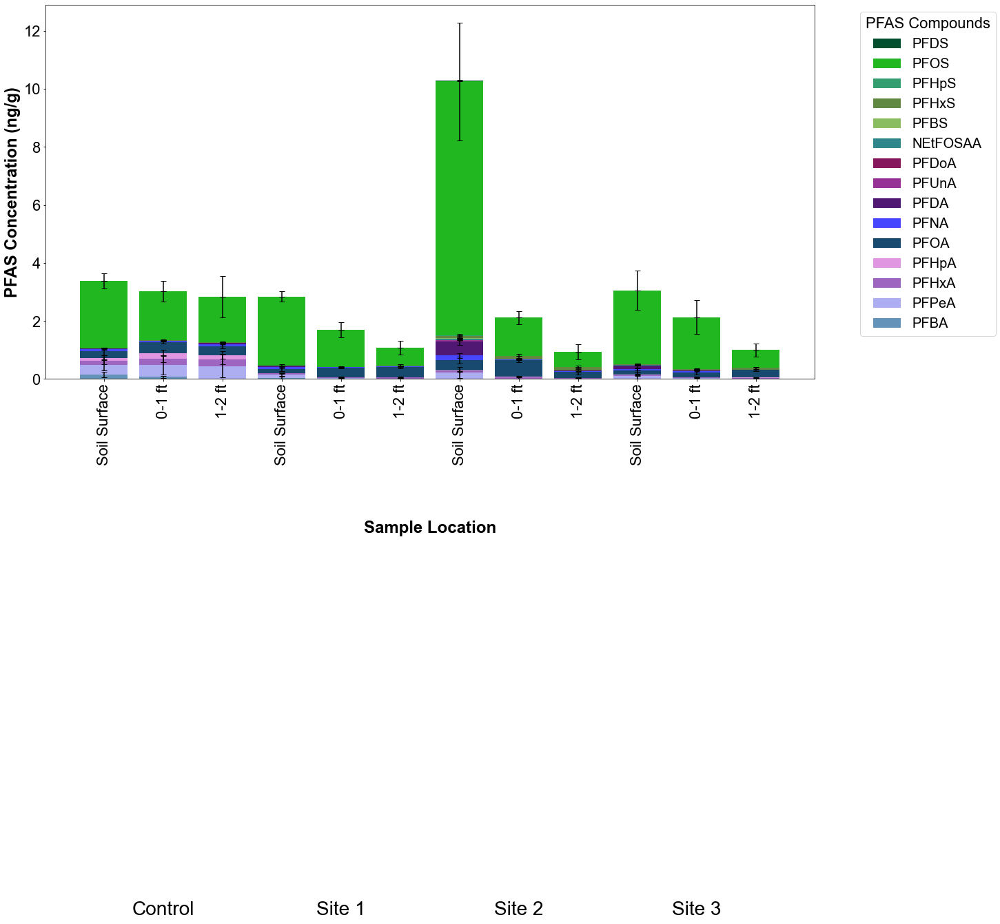

In [219]:
create_stacked_bar_chart_with_errors(summary_df=summary_with_categories,pfas_colors_dict=compound_colors_dict_abbrev, figsize=(20, 10), figuretitle='')

### Thomas Dairy Sample Events as a Stacked Bar

#### Functions

In [ ]:
def create_pivot_table(data_df, qual_summary_filter=None, field_filter=None, type_filter=None, sample_location_filter=None,
                       start_date=None, end_date=None, pfas_compound_filter=None, column_name='Quant Incl Estimates Incl Qual Flags'):
    """
    Create a pivot table from a dataframe with optional filtering and averaging specified values.

    Args:
    data_df (pd.DataFrame): Input dataframe.
    qual_summary_filter (list, optional): Quality summary filter values.
    field_filter (list, optional): Field filter values.
    type_filter (list, optional): Type filter values.
    sample_location_filter (list, optional): Sample location filter values.
    start_date (str, optional): Start date for filtering 'Sample Date' in format 'yyyy-mm-dd'.
    end_date (str, optional): End date for filtering 'Sample Date' in format 'yyyy-mm-dd'.
    pfas_compound_filter (list, optional): PFAS compound filter values.
    column_name (str): Column name to average for pivot table values.

    Returns:
    pd.DataFrame: Pivot table based on filters and averaging specified column.
    """
    # Convert 'Sample Date' to datetime format if not already done
    if 'Sample Date' in data_df.columns:
        data_df['Sample Date'] = pd.to_datetime(data_df['Sample Date'])
    
    # Apply filters based on provided lists
    filtered_data = data_df
    if qual_summary_filter is not None:
        filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(qual_summary_filter)]
    if field_filter is not None:
        filtered_data = filtered_data[filtered_data['Field'].isin(field_filter)]
    if type_filter is not None:
        filtered_data = filtered_data[filtered_data['Type'].isin(type_filter)]
    if sample_location_filter is not None:
        filtered_data = filtered_data[filtered_data['Sample Location'].isin(sample_location_filter)]
    if pfas_compound_filter is not None:
        filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(pfas_compound_filter)]
    if start_date and end_date:  # Apply date range filter if both start and end dates are provided
        filtered_data = filtered_data[
            (filtered_data['Sample Date'] >= start_date) & (filtered_data['Sample Date'] <= end_date)
        ]

    # Create the pivot table
    pivot_table = pd.pivot_table(
        filtered_data,
        values=column_name,
        index=['PFAS Compound'],
        columns=['Sample Location', 'Sample Date'],
        aggfunc='mean'
    )
    
    return pivot_table

In [ ]:
import datetime

def create_grouped_stacked_bar_chart(data_df, compound_colors_dict_abbrev, figsize=(14, 8), plot_title="PFAS Concentration by Sample Location and Date"):
    if not isinstance(data_df.index, pd.MultiIndex):
        raise ValueError("The DataFrame index must be a MultiIndex with 'Sample Location' and 'Sample Date' levels.")

    data_unstacked = data_df.unstack(level='Sample Date')
    data_unstacked.columns = [' '.join(map(str, col)).strip() for col in data_unstacked.columns.values]

    unique_compounds = pd.Index([col.split()[0] for col in data_unstacked.columns]).unique()
    color_map = {comp: compound_colors_dict_abbrev.get(comp, 'gray') for comp in unique_compounds}

    fig, ax = plt.subplots(figsize=figsize)
    position_offset = 0.0
    width = 0.8
    group_labels = []
    tick_positions = []
    all_labels = []
    max_height = 0
    legend_handles = {}

    for loc, group_df in data_unstacked.groupby(level='Sample Location', sort=False):
        num_dates = len(group_df.columns) // len(unique_compounds)
        group_pos = np.arange(num_dates) + position_offset
        tick_positions.extend(group_pos)

        # Format date strings with abbreviated month and day without leading zero
        all_labels.extend([datetime.datetime.strptime(date.split(' ')[1], '%Y-%m-%d').strftime('%b-%d-%y').replace(' 0', ' ') for date in group_df.columns[0:num_dates]])

        bottom = np.zeros(num_dates)
        for compound in unique_compounds:
            comp_columns = [col for col in group_df.columns if col.startswith(compound)]
            heights = group_df[comp_columns].values[0] if comp_columns else [0] * num_dates
            if any(heights):
                bars = ax.bar(group_pos, heights, bottom=bottom, color=color_map[compound], width=width, align='center')
                bottom += heights
                if compound not in legend_handles:
                    legend_handles[compound] = bars[0]

        max_height = max(max_height, bottom.max())
        group_labels.append((loc, np.mean(group_pos)))
        position_offset += num_dates + 0.5

    ax.set_title(plot_title)
    #For soil only
    ax.set_ylabel('PFAS Concentration (ng/g)')
    #For groundwater only
    ax.set_ylabel('PFAS Concentration (ng/L)')
    ax.set_xticks(tick_positions)
    ax.set_xticklabels(all_labels, rotation=90, ha='center')

    ax.set_ylim(0, max_height * 1.1 if max_height > 0 else 1)
    # Set y-axis limits
    #ax.set_ylim(0, 17)  # Start primary y-axis at 0

    ax2 = ax.twiny()
    ax2.set_xlim(ax.get_xlim())
    ax2.set_xticks([label[1] for label in group_labels])
    ax2.set_xticklabels([label[0] for label in group_labels], rotation=45, ha='center')
    ax2.xaxis.set_ticks_position('bottom')
    ax2.xaxis.set_label_position('bottom')
    ax2.spines['bottom'].set_position(('outward', 130))
    ax2.tick_params(axis='x', which='both', length=0)
    ax2.set_xlabel('Sample Locations')
    ax2.spines['top'].set_visible(False)
    ax2.spines['bottom'].set_visible(False)
    ax2.spines['left'].set_visible(False)
    ax2.spines['right'].set_visible(False)

    if legend_handles:
        reversed_handles = [legend_handles[comp] for comp in reversed(list(legend_handles.keys()))]
        ax.legend(reversed_handles, reversed(list(legend_handles.keys())), title='PFAS Compounds', loc='upper left', bbox_to_anchor=(1.05, 1))

    plt.tight_layout()
    plt.show()

# Example usage
# create_grouped_stacked_bar_chart(transposed_pivot_table, compound_colors_dict_abbrev, figsize=(20, 12), plot_title="Custom Plot Title")


#### Filters and Settings

In [ ]:
#qual_summary_filter (list): Filter values for 'Qual Summary (Grade for filtering)'.
qual_summary_filter = ['Good', 'Probably Ok', 'Probably ok']

#field_filter (list): Filter values for 'Field'.
field_filter=None

#type_filter (list): Filter values for 'Type'.
type_filter=['Soils']

#sample_location_filter (list): Filter values for 'Sample Location'.
sample_location_filter= ['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2',
                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 0',
                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
                          'Thomas Dairy Site 3 Soil - 2']
#soil surface
sample_location_filter= ['Thomas Dairy Control Site Soil - 0','Thomas Dairy Site 1 Soil - 0','Thomas Dairy Site 2 Soil - 0','Thomas Dairy Site 3 Soil - 0']

#start_date (str): Start date for filtering 'Sample Date'.
start_date = '2023-01-01'
#end_date (str): End date for filtering 'Sample Date'.
end_date = '2024-12-30'

#pfas_compound_filter (list): Filter values for 'PFAS Compound'.
pfas_compound_filter=['NEtFOSAA',
 'Perfluorobutanesulfonic acid',
 'Perfluorobutanoic acid',
 'Perfluorodecanesulfonic acid',
 'Perfluorodecanoic acid',
 'Perfluorododecanoic acid',
 'Perfluoroheptanesulfonic acid',
 'Perfluoroheptanoic acid',
 'Perfluorohexanesulfonic acid',
 'Perfluorohexanoic acid',
 'Perfluorononanoic acid',
 'Perfluorooctanesulfonic acid (PFOS)',
 'Perfluorooctanoic acid (PFOA)',
 'Perfluoropentanoic acid',
 'Perfluoroundecanoic acid']

#column_name (str): The column name to average values for.
column_name= 'Quant Incl Estimates Incl Qual Flags'

#### Groundwater Over Time

In [ ]:
sample_location_filter= ['Thomas Dairy Control Site Well', 'Thomas Dairy Site 1 Well', 
       'Thomas Dairy Site 2 Well','Thomas Dairy Site 3 Well']

#type_filter (list): Filter values for 'Type'.
type_filter=['Groundwater']

pivot_table=create_pivot_table(data_df, qual_summary_filter, field_filter, type_filter, sample_location_filter,
                                       start_date, end_date, pfas_compound_filter, column_name)

desired_order = df['Database'].tolist()  # Convert to list if not already
filtered_order = [comp for comp in desired_order if comp in pivot_table.index]
# Reorder columns by indexing df with the desired order
pivot_table = pivot_table.loc[filtered_order]

pivot_table.index=pivot_table.index.map(pfas_mapping)
pivot_table

Sample Location Thomas Dairy Control Site Well                        \
Sample Date                         2023-07-14 2023-09-08 2023-10-06   
PFAS Compound                                                          
PFBA                                      1.30       7.60       7.00   
PFPeA                                     0.89       6.20       6.80   
PFHxA                                     0.00       8.80       6.60   
PFHpA                                     0.26       1.90       1.80   
PFOA                                      1.00       7.90       7.90   
PFNA                                      0.00       0.37       0.28   
PFDA                                      0.00       0.00       0.00   
PFUnA                                     0.00       0.00       0.00   
PFDoA                                     0.00       0.00       0.00   
NEtFOSAA                                  0.00       0.00       0.00   
PFBS                                      2.30       8.30       6.70   
PFHxS                                     7.80      11.00      11.00   
PFHpS                                     0.00       0.00       0.25   
PFOS                                      3.10       5.50       4.80   
PFDS                                      0.00       0.00       0.00   

Sample Location                       Thomas Dairy Site 1 Well             \
Sample Date     2024-03-29 2024-04-23               2023-07-14 2023-09-08   
PFAS Compound                                                               
PFBA                  3.40        5.2                     6.70       3.70   
PFPeA                 3.20        5.0                     1.60       2.20   
PFHxA                 3.70        5.2                     2.20       2.00   
PFHpA                 0.89        1.1                     0.81       0.76   
PFOA                  5.50        6.6                     5.20       3.30   
PFNA                  0.00        0.0                     0.44       0.22   
PFDA                  0.00        0.0                     0.40       0.00   
PFUnA                 0.00        0.0                     0.00       0.00   
PFDoA                 0.00        0.0                     0.00       0.00   
NEtFOSAA              0.00        0.0                     0.00       0.00   
PFBS                  4.00        5.2                     2.90       4.20   
PFHxS                10.00        8.4                     4.50       6.10   
PFHpS                 0.00        0.0                     0.00       0.00   
PFOS                  5.50        5.2                     8.00       4.90   
PFDS                  0.00        0.0                     0.00       0.00   

Sample Location                                  Thomas Dairy Site 2 Well  \
Sample Date     2023-10-06 2024-03-29 2024-04-23               2023-07-14   
PFAS Compound                                                               
PFBA                  3.70       3.90        3.6                     3.70   
PFPeA                 1.60       2.10        2.3                     0.28   
PFHxA                 1.10       2.10        2.7                     0.00   
PFHpA                 0.51       0.65        0.8                     0.00   
PFOA                  2.80       4.40        3.8                     2.00   
PFNA                  0.19       0.00        0.0                     0.00   
PFDA                  0.00       0.00        0.0                     0.00   
PFUnA                 0.00       0.00        0.0                     0.00   
PFDoA                 0.00       0.00        0.0                     0.00   
NEtFOSAA              0.00       0.00        0.0                     0.00   
PFBS                  3.30       5.20        4.4                     2.50   
PFHxS                 5.10       6.10        5.9                     5.40   
PFHpS                 0.00       0.00        0.0                     0.00   
PFOS                  4.80       5.80        4.7                     6.10   
PFDS   

In [ ]:
# 'name_mapping' is a dictionary with old names as keys and new names as values. This will be used for renaming the columns.
name_mapping = {
    'Thomas Dairy Control Site Well': 'Control',
    'Thomas Dairy Site 1 Well': 'Site 1',
    'Thomas Dairy Site 2 Well': 'Site 2',
    'Thomas Dairy Site 3 Well': 'Site 3'
}

# Rename the first level of the columns
pivot_table.columns = pivot_table.columns.set_levels(
    pivot_table.columns.levels[0].map(name_mapping.get), level=0
)
pivot_table

Sample Location    Control                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-03-29 2024-04-23   
PFAS Compound                                                            
PFBA                  1.30       7.60       7.00       3.40        5.2   
PFPeA                 0.89       6.20       6.80       3.20        5.0   
PFHxA                 0.00       8.80       6.60       3.70        5.2   
PFHpA                 0.26       1.90       1.80       0.89        1.1   
PFOA                  1.00       7.90       7.90       5.50        6.6   
PFNA                  0.00       0.37       0.28       0.00        0.0   
PFDA                  0.00       0.00       0.00       0.00        0.0   
PFUnA                 0.00       0.00       0.00       0.00        0.0   
PFDoA                 0.00       0.00       0.00       0.00        0.0   
NEtFOSAA              0.00       0.00       0.00       0.00        0.0   
PFBS                  2.30       8.30       6.70       4.00        5.2   
PFHxS                 7.80      11.00      11.00      10.00        8.4   
PFHpS                 0.00       0.00       0.25       0.00        0.0   
PFOS                  3.10       5.50       4.80       5.50        5.2   
PFDS                  0.00       0.00       0.00       0.00        0.0   

Sample Location     Site 1                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-03-29 2024-04-23   
PFAS Compound                                                            
PFBA                  6.70       3.70       3.70       3.90        3.6   
PFPeA                 1.60       2.20       1.60       2.10        2.3   
PFHxA                 2.20       2.00       1.10       2.10        2.7   
PFHpA                 0.81       0.76       0.51       0.65        0.8   
PFOA                  5.20       3.30       2.80       4.40        3.8   
PFNA                  0.44       0.22       0.19       0.00        0.0   
PFDA                  0.40       0.00       0.00       0.00        0.0   
PFUnA                 0.00       0.00       0.00       0.00        0.0   
PFDoA                 0.00       0.00       0.00       0.00        0.0   
NEtFOSAA              0.00       0.00       0.00       0.00        0.0   
PFBS                  2.90       4.20       3.30       5.20        4.4   
PFHxS                 4.50       6.10       5.10       6.10        5.9   
PFHpS                 0.00       0.00       0.00       0.00        0.0   
PFOS                  8.00       4.90       4.80       5.80        4.7   
PFDS                  0.00       0.00       0.00       0.00        0.0   

Sample Location     Site 2                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-03-29 2024-04-23   
PFAS Compound                                                            
PFBA                  3.70       5.70       6.00        2.0        2.2   
PFPeA                 0.28       0.49       0.51        0.0        0.0   
PFHxA                 0.00       1.30       0.00        0.0        0.0   
PFHpA                 0.00       0.00       0.00        0.0        0.0   
PFOA                  2.00       2.20       3.00        5.1        3.9   
PFNA                  0.00       0.23       0.21        0.0        0.0   
PFDA                  0.00       0.00       0.00        0.0        0.0   
PFUnA                 0.00       0.00       0.00        0.0        0.0   
PFDoA                 0.00       0.00       0.00        0.0        0.0   
NEtFOSAA              0.00       0.00       0.00        0.0        0.0   
PFBS                  2.50       5.20       3.90        4.2        3.9   
PFHxS                 5.40       6.40       7.00       12.0        8.6   
PFHpS                 0.00       0.00       0.00        0.0        0.0   
PFOS                  6.10       4.30       4.40        4.8        4.5   
PFDS                  0.00       0.00       0.00        0.0        0.0   

S

In [ ]:
transposed_pivot_table = pivot_table.T

transposed_pivot_table

PFAS Compound                PFBA  PFPeA  PFHxA  PFHpA  PFOA  PFNA  PFDA  \
Sample Location Sample Date                                                
Control         2023-07-14    1.3   0.89    0.0   0.26   1.0  0.00   0.0   
                2023-09-08    7.6   6.20    8.8   1.90   7.9  0.37   0.0   
                2023-10-06    7.0   6.80    6.6   1.80   7.9  0.28   0.0   
                2024-03-29    3.4   3.20    3.7   0.89   5.5  0.00   0.0   
                2024-04-23    5.2   5.00    5.2   1.10   6.6  0.00   0.0   
Site 1          2023-07-14    6.7   1.60    2.2   0.81   5.2  0.44   0.4   
                2023-09-08    3.7   2.20    2.0   0.76   3.3  0.22   0.0   
                2023-10-06    3.7   1.60    1.1   0.51   2.8  0.19   0.0   
                2024-03-29    3.9   2.10    2.1   0.65   4.4  0.00   0.0   
                2024-04-23    3.6   2.30    2.7   0.80   3.8  0.00   0.0   
Site 2          2023-07-14    3.7   0.28    0.0   0.00   2.0  0.00   0.0   
                2023-09-08    5.7   0.49    1.3   0.00   2.2  0.23   0.0   
                2023-10-06    6.0   0.51    0.0   0.00   3.0  0.21   0.0   
                2024-03-29    2.0   0.00    0.0   0.00   5.1  0.00   0.0   
                2024-04-23    2.2   0.00    0.0   0.00   3.9  0.00   0.0   
Site 3          2023-07-14    4.2   5.20    4.3   1.30   6.1  0.00   0.0   
                2023-09-08    4.6   6.60    4.7   1.80   6.0  0.20   0.0   
                2023-10-06    5.5   6.90    5.9   1.80   7.2  0.23   0.0   
                2024-03-29    6.9   8.40    7.1   1.90  10.0  0.00   0.0   
                2024-04-23    6.6   7.30    6.2   1.60   7.9  0.00   0.0   

PFAS Compound                PFUnA  PFDoA  NEtFOSAA  PFBS  PFHxS  PFHpS  PFOS  \
Sample Location Sample Date                                                     
Control         2023-07-14     0.0    0.0       0.0   2.3    7.8   0.00   3.1   
                2023-09-08     0.0    0.0       0.0   8.3   11.0   0.00   5.5   
                2023-10-06     0.0    0.0       0.0   6.7   11.0   0.25   4.8   
                2024-03-29     0.0    0.0       0.0   4.0   10.0   0.00   5.5   
                2024-04-23     0.0    0.0       0.0   5.2    8.4   0.00   5.2   
Site 1          2023-07-14     0.0    0.0       0.0   2.9    4.5   0.00   8.0   
                2023-09-08     0.0    0.0       0.0   4.2    6.1   0.00   4.9   
                2023-10-06     0.0    0.0       0.0   3.3    5.1   0.00   4.8   
                2024-03-29     0.0    0.0       0.0   5.2    6.1   0.00   5.8   
                2024-04-23     0.0    0.0       0.0   4.4    5.9   0.00   4.7   
Site 2          2023-07-14     0.0    0.0       0.0   2.5    5.4   0.00   6.1   
                2023-09-08     0.0    0.0       0.0   5.2    6.4   0.00   4.3   
                2023-10-06     0.0    0.0       0.0   3.9    7.0   0.00   4.4   
                2024-03-29     0.0    0.0       0.0   4.2   12.0   0.00   4.8   
                2024-04-23     0.0    0.0       0.0   3.9    8.6   0.00   4.5   
Site 3          2023-07-14     0.0    0.0       0.0   3.5    5.6   0.00   4.4   
                2023-09-08     0.0    0.0       0.0   4.6    6.5   0.00   2.8   
                2023-10-06     0.0    0.0       0.0   5.2    7.6   0.00   3.0   
                2024-03-29     0.0    0.0       0.0   6.3    9.9   0.00   3.9   
                2024-04-23     0.0    0.0       0.0   4.9    7.7   0.00   3.5   

PFAS Compound                PFDS  
Sample Location Sample Date        
Control         2023-07-14    0.0  
                2023-09-08    0.0  
                2023-10-06    0.0  
                2024-03-29    0.0  
                2024-04-23    0.0  
Site 1          2023-07-14    0.0  
                2023-09-08    0.0  
                2023-10-06    0.0  
                2024-03-29    0.0  
                2024-04-23    0.0  
Site 2          2023-07-14    0.0  
                2023-09-08    0.0  
                2023-10-06    0.0  
    

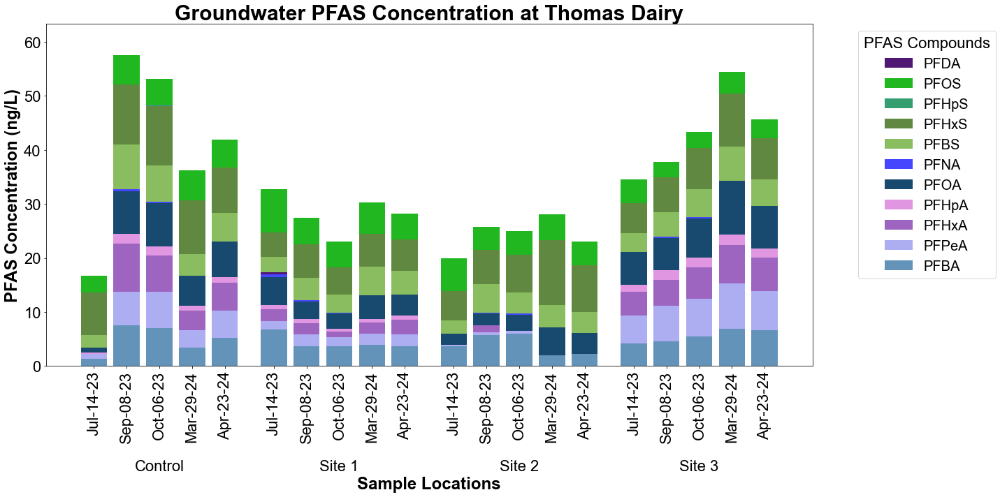

In [ ]:
create_grouped_stacked_bar_chart(transposed_pivot_table, figsize=(20, 10),plot_title="Groundwater PFAS Concentration at Thomas Dairy",compound_colors_dict_abbrev=compound_colors_dict_abbrev)

#### Soil Surface

In [ ]:
#qual_summary_filter (list): Filter values for 'Qual Summary (Grade for filtering)'.
qual_summary_filter = ['Good', 'Probably Ok', 'Probably ok']
#field_filter (list): Filter values for 'Field'.
field_filter=None
#type_filter (list): Filter values for 'Type'.
type_filter=['Soils']
#soil surface
sample_location_filter= ['Thomas Dairy Control Site Soil - 0','Thomas Dairy Site 1 Soil - 0','Thomas Dairy Site 2 Soil - 0','Thomas Dairy Site 3 Soil - 0']

pivot_table=create_pivot_table(data_df, qual_summary_filter, field_filter, type_filter, sample_location_filter,
                                       start_date, end_date, pfas_compound_filter, column_name)

desired_order = df['Database'].tolist()  # Convert to list if not already
filtered_order = [comp for comp in desired_order if comp in pivot_table.index]
# Reorder columns by indexing df with the desired order
pivot_table = pivot_table.loc[filtered_order]

pivot_table.index=pivot_table.index.map(pfas_mapping)
pivot_table

Sample Location Thomas Dairy Control Site Soil - 0                        \
Sample Date                             2023-07-14 2023-09-08 2023-10-06   
PFAS Compound                                                              
PFBA                                          0.00        0.0       0.00   
PFPeA                                         0.00        0.0       0.49   
PFHxA                                         0.00        0.0       0.00   
PFHpA                                         0.00        0.0       0.00   
PFOA                                          0.71        0.0       0.00   
PFNA                                          0.00        0.0       0.00   
PFDA                                          0.00        0.0       0.00   
PFUnA                                         0.00        0.0       0.00   
PFDoA                                         0.00        0.0       0.00   
NEtFOSAA                                      0.00        0.0       0.00   
PFBS                                          0.00        0.0       0.00   
PFHxS                                         0.00        0.0       0.00   
PFHpS                                         0.00        0.0       0.00   
PFOS                                          1.70        2.7       2.40   
PFDS                                          0.00        0.0       0.00   

Sample Location                       Thomas Dairy Site 1 Soil - 0             \
Sample Date     2024-04-23 2024-05-31                   2023-07-14 2023-09-08   
PFAS Compound                                                                   
PFBA                 0.230      0.520                          0.0       0.00   
PFPeA                0.140      1.000                          0.0       0.30   
PFHxA                0.120      0.680                          0.0       0.00   
PFHpA                0.094      0.390                          0.0       0.00   
PFOA                 0.180      0.230                          0.0       0.34   
PFNA                 0.170      0.160                          0.0       0.00   
PFDA                 0.130      0.073                          0.0       0.00   
PFUnA                0.000      0.000                          0.0       0.00   
PFDoA                0.000      0.000                          0.0       0.00   
NEtFOSAA             0.000      0.000                          0.0       0.00   
PFBS                 0.000      0.000                          0.0       0.00   
PFHxS                0.000      0.000                          0.0       0.00   
PFHpS                0.000      0.000                          0.0       0.00   
PFOS                 3.000      1.800                          2.4       3.00   
PFDS                 0.000      0.000                          0.0       0.00   

Sample Location                                  Thomas Dairy Site 2 Soil - 0  \
Sample Date     2023-10-06 2024-04-23 2024-05-31                   2023-07-14   
PFAS Compound                                                                   
PFBA                   0.0      0.120       0.11                         0.00   
PFPeA                  0.0      0.140       0.13                         0.00   
PFHxA                  0.0      0.093       0.11                         0.00   
PFHpA                  0.0      0.000       0.00                         0.00   
PFOA                   0.0      0.150       0.27                         0.29   
PFNA                   0.0      0.110       0.20                         0.00   
PFDA                   0.0      0.130       0.13                         0.33   
PFUnA                  0.0      0.000       0.00                         0.00   
PFDoA                  0.0      0.000       0.00                         0.00   
NEtFOSAA               0.0      0.000       0.00                         0.00   
PFBS                   0.0      0.000       0.00                         0.00   
PFHxS                  0.0      0.000 

In [ ]:
# 'name_mapping' is a dictionary with old names as keys and new names as values. This will be used for renaming the columns.
name_mapping = {
    'Thomas Dairy Control Site Soil - 0': 'Control',
    'Thomas Dairy Site 1 Soil - 0': 'Site 1',
    'Thomas Dairy Site 2 Soil - 0': 'Site 2',
    'Thomas Dairy Site 3 Soil - 0': 'Site 3'
}

# Rename the first level of the columns
pivot_table.columns = pivot_table.columns.set_levels(
    pivot_table.columns.levels[0].map(name_mapping.get), level=0
)
pivot_table

Sample Location    Control                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                  0.00        0.0       0.00      0.230      0.520   
PFPeA                 0.00        0.0       0.49      0.140      1.000   
PFHxA                 0.00        0.0       0.00      0.120      0.680   
PFHpA                 0.00        0.0       0.00      0.094      0.390   
PFOA                  0.71        0.0       0.00      0.180      0.230   
PFNA                  0.00        0.0       0.00      0.170      0.160   
PFDA                  0.00        0.0       0.00      0.130      0.073   
PFUnA                 0.00        0.0       0.00      0.000      0.000   
PFDoA                 0.00        0.0       0.00      0.000      0.000   
NEtFOSAA              0.00        0.0       0.00      0.000      0.000   
PFBS                  0.00        0.0       0.00      0.000      0.000   
PFHxS                 0.00        0.0       0.00      0.000      0.000   
PFHpS                 0.00        0.0       0.00      0.000      0.000   
PFOS                  1.70        2.7       2.40      3.000      1.800   
PFDS                  0.00        0.0       0.00      0.000      0.000   

Sample Location     Site 1                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   0.0       0.00        0.0      0.120       0.11   
PFPeA                  0.0       0.30        0.0      0.140       0.13   
PFHxA                  0.0       0.00        0.0      0.093       0.11   
PFHpA                  0.0       0.00        0.0      0.000       0.00   
PFOA                   0.0       0.34        0.0      0.150       0.27   
PFNA                   0.0       0.00        0.0      0.110       0.20   
PFDA                   0.0       0.00        0.0      0.130       0.13   
PFUnA                  0.0       0.00        0.0      0.000       0.00   
PFDoA                  0.0       0.00        0.0      0.000       0.00   
NEtFOSAA               0.0       0.00        0.0      0.000       0.00   
PFBS                   0.0       0.00        0.0      0.000       0.00   
PFHxS                  0.0       0.00        0.0      0.000       0.00   
PFHpS                  0.0       0.00        0.0      0.000       0.00   
PFOS                   2.4       3.00        2.2      2.000       2.30   
PFDS                   0.0       0.00        0.0      0.000       0.00   

Sample Location     Site 2                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                  0.00       0.00       0.00      0.000      0.000   
PFPeA                 0.00       0.00       0.98      0.150      0.000   
PFHxA                 0.00       0.00       0.00      0.260      0.000   
PFHpA                 0.00       0.00       0.00      0.130      0.000   
PFOA                  0.29       0.69       0.00      0.560      0.190   
PFNA                  0.00       0.38       0.00      0.330      0.110   
PFDA                  0.33       1.00       0.46      0.500      0.160   
PFUnA                 0.00       0.00       0.00      0.130      0.000   
PFDoA                 0.00       0.00       0.00      0.084      0.000   
NEtFOSAA              0.00       0.00       0.00      0.170      0.000   
PFBS                  0.00       0.00       0.00      0.100      0.000   
PFHxS                 0.00       0.00       0.00      0.330      0.099   
PFHpS                 0.00       0.00       0.00      0.069      0.000   
PFOS                  6.50      14.00       8.80     12.000      2.500   
PFDS                  0.00       0.00       0.00      0.120      0.000   

S

In [ ]:
transposed_pivot_table = pivot_table.T

transposed_pivot_table

PFAS Compound                PFBA  PFPeA  PFHxA  PFHpA   PFOA   PFNA   PFDA  \
Sample Location Sample Date                                                   
Control         2023-07-14   0.00   0.00  0.000  0.000  0.710  0.000  0.000   
                2023-09-08   0.00   0.00  0.000  0.000  0.000  0.000  0.000   
                2023-10-06   0.00   0.49  0.000  0.000  0.000  0.000  0.000   
                2024-04-23   0.23   0.14  0.120  0.094  0.180  0.170  0.130   
                2024-05-31   0.52   1.00  0.680  0.390  0.230  0.160  0.073   
Site 1          2023-07-14   0.00   0.00  0.000  0.000  0.000  0.000  0.000   
                2023-09-08   0.00   0.30  0.000  0.000  0.340  0.000  0.000   
                2023-10-06   0.00   0.00  0.000  0.000  0.000  0.000  0.000   
                2024-04-23   0.12   0.14  0.093  0.000  0.150  0.110  0.130   
                2024-05-31   0.11   0.13  0.110  0.000  0.270  0.200  0.130   
Site 2          2023-07-14   0.00   0.00  0.000  0.000  0.290  0.000  0.330   
                2023-09-08   0.00   0.00  0.000  0.000  0.690  0.380  1.000   
                2023-10-06   0.00   0.98  0.000  0.000  0.000  0.000  0.460   
                2024-04-23   0.00   0.15  0.260  0.130  0.560  0.330  0.500   
                2024-05-31   0.00   0.00  0.000  0.000  0.190  0.110  0.160   
Site 3          2023-07-14   0.00   0.00  0.000  0.000  0.000  0.000  0.000   
                2023-09-08   0.00   0.00  0.000  0.000  0.280  0.000  0.280   
                2023-10-06   0.00   0.54  0.000  0.000  0.000  0.000  0.000   
                2024-04-23   0.00   0.00  0.150  0.056  0.330  0.190  0.310   
                2024-05-31   0.00   0.00  0.000  0.000  0.086  0.052  0.000   

PFAS Compound                PFUnA  PFDoA  NEtFOSAA  PFBS  PFHxS  PFHpS  \
Sample Location Sample Date                                               
Control         2023-07-14   0.000  0.000      0.00   0.0  0.000  0.000   
                2023-09-08   0.000  0.000      0.00   0.0  0.000  0.000   
                2023-10-06   0.000  0.000      0.00   0.0  0.000  0.000   
                2024-04-23   0.000  0.000      0.00   0.0  0.000  0.000   
                2024-05-31   0.000  0.000      0.00   0.0  0.000  0.000   
Site 1          2023-07-14   0.000  0.000      0.00   0.0  0.000  0.000   
                2023-09-08   0.000  0.000      0.00   0.0  0.000  0.000   
                2023-10-06   0.000  0.000      0.00   0.0  0.000  0.000   
                2024-04-23   0.000  0.000      0.00   0.0  0.000  0.000   
                2024-05-31   0.000  0.000      0.00   0.0  0.000  0.000   
Site 2          2023-07-14   0.000  0.000      0.00   0.0  0.000  0.000   
                2023-09-08   0.000  0.000      0.00   0.0  0.000  0.000   
                2023-10-06   0.000  0.000      0.00   0.0  0.000  0.000   
                2024-04-23   0.130  0.084      0.17   0.1  0.330  0.069   
                2024-05-31   0.000  0.000      0.00   0.0  0.099  0.000   
Site 3          2023-07-14   0.000  0.000      0.00   0.0  0.000  0.000   
                2023-09-08   0.000  0.000      0.00   0.0  0.000  0.000   
                2023-10-06   0.000  0.000      0.00   0.0  0.000  0.000   
                2024-04-23   0.057  0.000      0.11   0.0  0.140  0.000   
                2024-05-31   0.000  0.000      0.00   0.0  0.000  0.000   

PFAS Compound                 PFOS  PFDS  
Sample Location Sample Date               
Control         2023-07-14    1.70  0.00  
                2023-09-08    2.70  0.00  
                2023-10-06    2.40  0.00  
                2024-04-23    3.00  0.00  
                2024-05-31    1.80  0.00  
Site 1          2023-07-14    2.40  0.00  
                2023-09-08    3.00  0.00  
                2023-10-06    2.20  0.00  
                2024-04-23    2.00  0.00  
                2024-05-31    2.30  0.00  
Site 2          2023-07-14    6.50  0.00  
                2023-09-08   14.00  0.00  
        

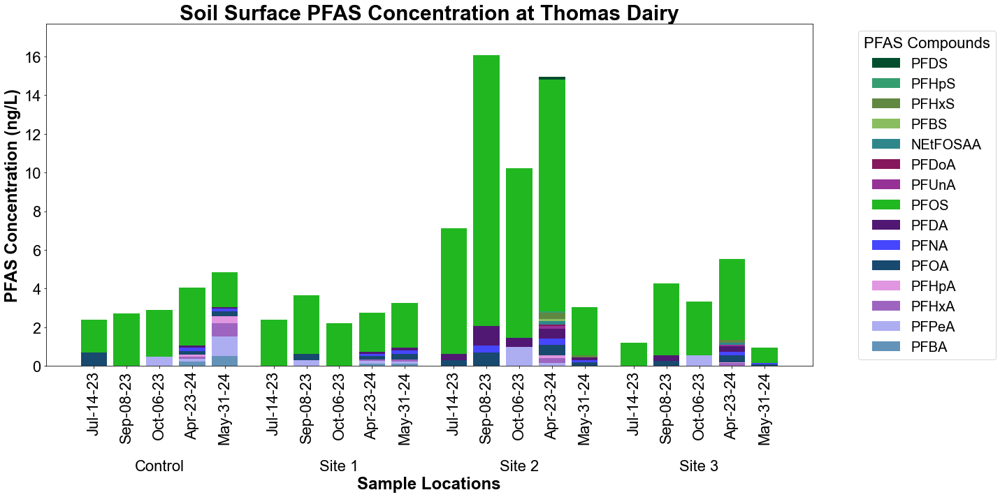

In [ ]:
create_grouped_stacked_bar_chart(transposed_pivot_table, figsize=(20, 10),plot_title="Soil Surface PFAS Concentration at Thomas Dairy",compound_colors_dict_abbrev=compound_colors_dict_abbrev)

#### 0-1 ft Depth

In [ ]:
#soil surface
sample_location_filter= ['Thomas Dairy Control Site Soil - 1','Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 3 Soil - 1']

pivot_table=create_pivot_table(data_df, qual_summary_filter, field_filter, type_filter, sample_location_filter,
                                       start_date, end_date, pfas_compound_filter, column_name)

desired_order = df['Database'].tolist()  # Convert to list if not already
filtered_order = [comp for comp in desired_order if comp in pivot_table.index]
# Reorder columns by indexing df with the desired order
pivot_table = pivot_table.loc[filtered_order]

pivot_table.index=pivot_table.index.map(pfas_mapping)
pivot_table

Sample Location Thomas Dairy Control Site Soil - 1                        \
Sample Date                             2023-07-14 2023-09-08 2023-10-06   
PFAS Compound                                                              
PFBA                                          0.00        0.0       0.00   
PFPeA                                         0.00        0.0       1.70   
PFHxA                                         0.00        0.0       0.59   
PFHpA                                         0.00        0.0       0.56   
PFOA                                          0.32        0.3       0.31   
PFNA                                          0.00        0.0       0.00   
PFDA                                          0.00        0.0       0.00   
PFUnA                                         0.00        0.0       0.00   
PFDoA                                         0.00        0.0       0.00   
NEtFOSAA                                      0.00        0.0       0.00   
PFBS                                          0.00        0.0       0.00   
PFHxS                                         0.00        0.0       0.00   
PFHpS                                         0.00        0.0       0.00   
PFOS                                          3.10        1.2       1.30   
PFDS                                          0.00        0.0       0.00   

Sample Location                       Thomas Dairy Site 1 Soil - 1             \
Sample Date     2024-04-23 2024-05-31                   2023-07-14 2023-09-08   
PFAS Compound                                                                   
PFBA                 0.180      0.180                         0.00        0.0   
PFPeA                0.110      0.250                         0.00        0.0   
PFHxA                0.120      0.410                         0.00        0.0   
PFHpA                0.074      0.330                         0.00        0.0   
PFOA                 0.330      0.610                         0.29        0.4   
PFNA                 0.130      0.130                         0.00        0.0   
PFDA                 0.000      0.000                         0.00        0.0   
PFUnA                0.000      0.000                         0.00        0.0   
PFDoA                0.000      0.000                         0.00        0.0   
NEtFOSAA             0.000      0.000                         0.00        0.0   
PFBS                 0.000      0.000                         0.00        0.0   
PFHxS                0.000      0.052                         0.00        0.0   
PFHpS                0.000      0.000                         0.00        0.0   
PFOS                 1.400      1.400                         1.60        1.2   
PFDS                 0.000      0.000                         0.00        0.0   

Sample Location                                  Thomas Dairy Site 2 Soil - 1  \
Sample Date     2023-10-06 2024-04-23 2024-05-31                   2023-07-14   
PFAS Compound                                                                   
PFBA                  0.00      0.000      0.110                         0.00   
PFPeA                 0.00      0.000      0.099                         0.00   
PFHxA                 0.00      0.066      0.000                         0.00   
PFHpA                 0.00      0.066      0.000                         0.00   
PFOA                  0.37      0.270      0.250                         0.75   
PFNA                  0.00      0.000      0.100                         0.00   
PFDA                  0.00      0.000      0.000                         0.00   
PFUnA                 0.00      0.000      0.000                         0.00   
PFDoA                 0.00      0.000      0.000                         0.00   
NEtFOSAA              0.00      0.000      0.000                         0.00   
PFBS                  0.00      0.000      0.000                         0.00   
PFHxS                 0.00      0.059 

In [ ]:
# 'name_mapping' is a dictionary with old names as keys and new names as values. This will be used for renaming the columns.
name_mapping = {
    'Thomas Dairy Control Site Soil - 1': 'Control',
    'Thomas Dairy Site 1 Soil - 1': 'Site 1',
    'Thomas Dairy Site 2 Soil - 1': 'Site 2',
    'Thomas Dairy Site 3 Soil - 1': 'Site 3'
}

# Rename the first level of the columns
pivot_table.columns = pivot_table.columns.set_levels(
    pivot_table.columns.levels[0].map(name_mapping.get), level=0
)
pivot_table

Sample Location    Control                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                  0.00        0.0       0.00      0.180      0.180   
PFPeA                 0.00        0.0       1.70      0.110      0.250   
PFHxA                 0.00        0.0       0.59      0.120      0.410   
PFHpA                 0.00        0.0       0.56      0.074      0.330   
PFOA                  0.32        0.3       0.31      0.330      0.610   
PFNA                  0.00        0.0       0.00      0.130      0.130   
PFDA                  0.00        0.0       0.00      0.000      0.000   
PFUnA                 0.00        0.0       0.00      0.000      0.000   
PFDoA                 0.00        0.0       0.00      0.000      0.000   
NEtFOSAA              0.00        0.0       0.00      0.000      0.000   
PFBS                  0.00        0.0       0.00      0.000      0.000   
PFHxS                 0.00        0.0       0.00      0.000      0.052   
PFHpS                 0.00        0.0       0.00      0.000      0.000   
PFOS                  3.10        1.2       1.30      1.400      1.400   
PFDS                  0.00        0.0       0.00      0.000      0.000   

Sample Location     Site 1                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                  0.00        0.0       0.00      0.000      0.110   
PFPeA                 0.00        0.0       0.00      0.000      0.099   
PFHxA                 0.00        0.0       0.00      0.066      0.000   
PFHpA                 0.00        0.0       0.00      0.066      0.000   
PFOA                  0.29        0.4       0.37      0.270      0.250   
PFNA                  0.00        0.0       0.00      0.000      0.100   
PFDA                  0.00        0.0       0.00      0.000      0.000   
PFUnA                 0.00        0.0       0.00      0.000      0.000   
PFDoA                 0.00        0.0       0.00      0.000      0.000   
NEtFOSAA              0.00        0.0       0.00      0.000      0.000   
PFBS                  0.00        0.0       0.00      0.000      0.000   
PFHxS                 0.00        0.0       0.00      0.059      0.000   
PFHpS                 0.00        0.0       0.00      0.000      0.000   
PFOS                  1.60        1.2       2.10      0.630      0.900   
PFDS                  0.00        0.0       0.00      0.000      0.000   

Sample Location     Site 2                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                  0.00       0.00       0.00      0.000      0.000   
PFPeA                 0.00       0.00       0.00      0.000      0.000   
PFHxA                 0.00       0.00       0.00      0.190      0.092   
PFHpA                 0.00       0.00       0.00      0.075      0.000   
PFOA                  0.75       0.45       0.65      0.630      0.370   
PFNA                  0.00       0.00       0.00      0.053      0.110   
PFDA                  0.00       0.00       0.00      0.000      0.065   
PFUnA                 0.00       0.00       0.00      0.000      0.000   
PFDoA                 0.00       0.00       0.00      0.000      0.000   
NEtFOSAA              0.00       0.00       0.00      0.000      0.000   
PFBS                  0.00       0.00       0.00      0.000      0.000   
PFHxS                 0.00       0.00       0.00      0.390      0.098   
PFHpS                 0.00       0.00       0.00      0.000      0.000   
PFOS                  1.50       0.75       2.10      1.000      1.300   
PFDS                  0.00       0.00       0.00      0.000      0.000   

S

In [ ]:
transposed_pivot_table = pivot_table.T

transposed_pivot_table

PFAS Compound                PFBA  PFPeA  PFHxA  PFHpA  PFOA   PFNA   PFDA  \
Sample Location Sample Date                                                  
Control         2023-07-14   0.00  0.000  0.000  0.000  0.32  0.000  0.000   
                2023-09-08   0.00  0.000  0.000  0.000  0.30  0.000  0.000   
                2023-10-06   0.00  1.700  0.590  0.560  0.31  0.000  0.000   
                2024-04-23   0.18  0.110  0.120  0.074  0.33  0.130  0.000   
                2024-05-31   0.18  0.250  0.410  0.330  0.61  0.130  0.000   
Site 1          2023-07-14   0.00  0.000  0.000  0.000  0.29  0.000  0.000   
                2023-09-08   0.00  0.000  0.000  0.000  0.40  0.000  0.000   
                2023-10-06   0.00  0.000  0.000  0.000  0.37  0.000  0.000   
                2024-04-23   0.00  0.000  0.066  0.066  0.27  0.000  0.000   
                2024-05-31   0.11  0.099  0.000  0.000  0.25  0.100  0.000   
Site 2          2023-07-14   0.00  0.000  0.000  0.000  0.75  0.000  0.000   
                2023-09-08   0.00  0.000  0.000  0.000  0.45  0.000  0.000   
                2023-10-06   0.00  0.000  0.000  0.000  0.65  0.000  0.000   
                2024-04-23   0.00  0.000  0.190  0.075  0.63  0.053  0.000   
                2024-05-31   0.00  0.000  0.092  0.000  0.37  0.110  0.065   
Site 3          2023-07-14   0.00  0.000  0.000  0.000  0.33  0.000  0.000   
                2023-09-08   0.00  0.000  0.000  0.000  0.00  0.000  0.000   
                2023-10-06   0.00  0.000  0.000  0.000  0.00  0.000  0.000   
                2024-04-23   0.00  0.120  0.140  0.081  0.37  0.170  0.160   
                2024-05-31   0.00  0.000  0.000  0.000  0.10  0.000  0.000   

PFAS Compound                PFUnA  PFDoA  NEtFOSAA  PFBS  PFHxS  PFHpS  PFOS  \
Sample Location Sample Date                                                     
Control         2023-07-14     0.0    0.0       0.0   0.0  0.000    0.0  3.10   
                2023-09-08     0.0    0.0       0.0   0.0  0.000    0.0  1.20   
                2023-10-06     0.0    0.0       0.0   0.0  0.000    0.0  1.30   
                2024-04-23     0.0    0.0       0.0   0.0  0.000    0.0  1.40   
                2024-05-31     0.0    0.0       0.0   0.0  0.052    0.0  1.40   
Site 1          2023-07-14     0.0    0.0       0.0   0.0  0.000    0.0  1.60   
                2023-09-08     0.0    0.0       0.0   0.0  0.000    0.0  1.20   
                2023-10-06     0.0    0.0       0.0   0.0  0.000    0.0  2.10   
                2024-04-23     0.0    0.0       0.0   0.0  0.059    0.0  0.63   
                2024-05-31     0.0    0.0       0.0   0.0  0.000    0.0  0.90   
Site 2          2023-07-14     0.0    0.0       0.0   0.0  0.000    0.0  1.50   
                2023-09-08     0.0    0.0       0.0   0.0  0.000    0.0  0.75   
                2023-10-06     0.0    0.0       0.0   0.0  0.000    0.0  2.10   
                2024-04-23     0.0    0.0       0.0   0.0  0.390    0.0  1.00   
                2024-05-31     0.0    0.0       0.0   0.0  0.098    0.0  1.30   
Site 3          2023-07-14     0.0    0.0       0.0   0.0  0.000    0.0  0.78   
                2023-09-08     0.0    0.0       0.0   0.0  0.000    0.0  2.50   
                2023-10-06     0.0    0.0       0.0   0.0  0.000    0.0  2.80   
                2024-04-23     0.0    0.0       0.0   0.0  0.150    0.0  2.90   
                2024-05-31     0.0    0.0       0.0   0.0  0.065    0.0  0.00   

PFAS Compound                PFDS  
Sample Location Sample Date        
Control         2023-07-14    0.0  
                2023-09-08    0.0  
                2023-10-06    0.0  
                2024-04-23    0.0  
                2024-05-31    0.0  
Site 1          2023-07-14    0.0  
                2023-09-08    0.0  
                2023-10-06    0.0  
                2024-04-23    0.0  
                2024-05-31    0.0  
Site 2          2023-07-14    0.0  
                2023-09-08    0.

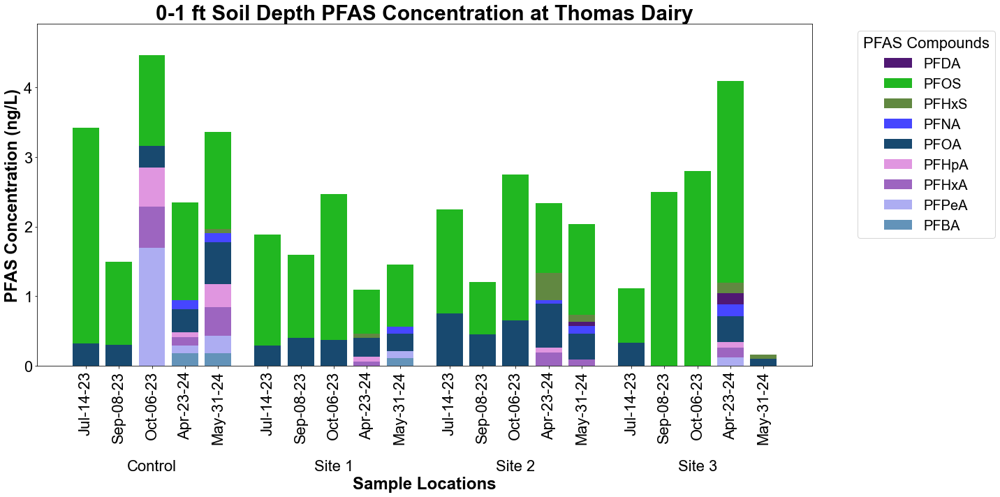

In [ ]:
create_grouped_stacked_bar_chart(transposed_pivot_table, figsize=(20, 10),plot_title="0-1 ft Soil Depth PFAS Concentration at Thomas Dairy",compound_colors_dict_abbrev=compound_colors_dict_abbrev)

### 1-2 ft Soil Depth

In [ ]:
#soil surface
sample_location_filter= ['Thomas Dairy Control Site Soil - 2','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 2']

pivot_table=create_pivot_table(data_df, qual_summary_filter, field_filter, type_filter, sample_location_filter,
                                       start_date, end_date, pfas_compound_filter, column_name)

desired_order = df['Database'].tolist()  # Convert to list if not already
filtered_order = [comp for comp in desired_order if comp in pivot_table.index]
# Reorder columns by indexing df with the desired order
pivot_table = pivot_table.loc[filtered_order]

pivot_table.index=pivot_table.index.map(pfas_mapping)
pivot_table

Sample Location Thomas Dairy Control Site Soil - 2                        \
Sample Date                             2023-07-14 2023-09-08 2023-10-06   
PFAS Compound                                                              
PFBA                                          0.00       0.00       0.00   
PFPeA                                         0.21       0.00       2.00   
PFHxA                                         0.00       0.00       0.95   
PFHpA                                         0.00       0.00       0.63   
PFOA                                          0.00       0.38       0.34   
PFNA                                          0.21       0.00       0.00   
PFDA                                          0.25       0.00       0.00   
PFUnA                                         0.00       0.00       0.00   
PFDoA                                         0.00       0.00       0.00   
NEtFOSAA                                      0.00       0.00       0.00   
PFBS                                          0.00       0.00       0.00   
PFHxS                                         0.00       0.00       0.00   
PFHpS                                         0.00       0.00       0.00   
PFOS                                          4.40       0.69       1.20   
PFDS                                          0.00       0.00       0.00   

Sample Location                       Thomas Dairy Site 1 Soil - 2             \
Sample Date     2024-04-23 2024-05-31                   2023-07-14 2023-09-08   
PFAS Compound                                                                   
PFBA                 0.000      0.000                         0.00       0.00   
PFPeA                0.000      0.000                         0.00       0.00   
PFHxA                0.081      0.150                         0.00       0.00   
PFHpA                0.000      0.110                         0.00       0.00   
PFOA                 0.390      0.420                         0.41       0.28   
PFNA                 0.069      0.057                         0.00       0.00   
PFDA                 0.000      0.000                         0.00       0.00   
PFUnA                0.000      0.000                         0.00       0.00   
PFDoA                0.000      0.000                         0.00       0.00   
NEtFOSAA             0.000      0.000                         0.00       0.00   
PFBS                 0.000      0.000                         0.00       0.00   
PFHxS                0.060      0.000                         0.00       0.00   
PFHpS                0.000      0.000                         0.00       0.00   
PFOS                 0.990      0.610                         1.40       0.00   
PFDS                 0.000      0.000                         0.00       0.00   

Sample Location                                  Thomas Dairy Site 2 Soil - 2  \
Sample Date     2023-10-06 2024-04-23 2024-05-31                   2023-07-14   
PFAS Compound                                                                   
PFBA                  0.00      0.000      0.110                         0.00   
PFPeA                 0.00      0.000      0.000                         0.00   
PFHxA                 0.00      0.099      0.092                         0.00   
PFHpA                 0.00      0.000      0.000                         0.00   
PFOA                  0.47      0.240      0.370                         0.51   
PFNA                  0.00      0.000      0.060                         0.00   
PFDA                  0.00      0.000      0.000                         0.00   
PFUnA                 0.00      0.000      0.000                         0.00   
PFDoA                 0.00      0.000      0.000                         0.00   
NEtFOSAA              0.00      0.000      0.000                         0.00   
PFBS                  0.00      0.000      0.000                         0.00   
PFHxS                 0.00      0.150 

In [ ]:
# 'name_mapping' is a dictionary with old names as keys and new names as values. This will be used for renaming the columns.
name_mapping = {
    'Thomas Dairy Control Site Soil - 2': 'Control',
    'Thomas Dairy Site 1 Soil - 2': 'Site 1',
    'Thomas Dairy Site 2 Soil - 2': 'Site 2',
    'Thomas Dairy Site 3 Soil - 2': 'Site 3'
}

# Rename the first level of the columns
pivot_table.columns = pivot_table.columns.set_levels(
    pivot_table.columns.levels[0].map(name_mapping.get), level=0
)
pivot_table

Sample Location    Control                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                  0.00       0.00       0.00      0.000      0.000   
PFPeA                 0.21       0.00       2.00      0.000      0.000   
PFHxA                 0.00       0.00       0.95      0.081      0.150   
PFHpA                 0.00       0.00       0.63      0.000      0.110   
PFOA                  0.00       0.38       0.34      0.390      0.420   
PFNA                  0.21       0.00       0.00      0.069      0.057   
PFDA                  0.25       0.00       0.00      0.000      0.000   
PFUnA                 0.00       0.00       0.00      0.000      0.000   
PFDoA                 0.00       0.00       0.00      0.000      0.000   
NEtFOSAA              0.00       0.00       0.00      0.000      0.000   
PFBS                  0.00       0.00       0.00      0.000      0.000   
PFHxS                 0.00       0.00       0.00      0.060      0.000   
PFHpS                 0.00       0.00       0.00      0.000      0.000   
PFOS                  4.40       0.69       1.20      0.990      0.610   
PFDS                  0.00       0.00       0.00      0.000      0.000   

Sample Location     Site 1                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                  0.00       0.00       0.00      0.000      0.110   
PFPeA                 0.00       0.00       0.00      0.000      0.000   
PFHxA                 0.00       0.00       0.00      0.099      0.092   
PFHpA                 0.00       0.00       0.00      0.000      0.000   
PFOA                  0.41       0.28       0.47      0.240      0.370   
PFNA                  0.00       0.00       0.00      0.000      0.060   
PFDA                  0.00       0.00       0.00      0.000      0.000   
PFUnA                 0.00       0.00       0.00      0.000      0.000   
PFDoA                 0.00       0.00       0.00      0.000      0.000   
NEtFOSAA              0.00       0.00       0.00      0.000      0.000   
PFBS                  0.00       0.00       0.00      0.000      0.000   
PFHxS                 0.00       0.00       0.00      0.150      0.071   
PFHpS                 0.00       0.00       0.00      0.000      0.000   
PFOS                  1.40       0.00       0.81      0.260      0.580   
PFDS                  0.00       0.00       0.00      0.000      0.000   

Sample Location     Site 2                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                  0.00       0.00        0.0      0.000      0.000   
PFPeA                 0.00       0.00        0.0      0.000      0.000   
PFHxA                 0.00       0.00        0.0      0.059      0.110   
PFHpA                 0.00       0.00        0.0      0.000      0.000   
PFOA                  0.51       0.00        0.0      0.180      0.380   
PFNA                  0.00       0.00        0.0      0.000      0.110   
PFDA                  0.00       0.00        0.0      0.000      0.081   
PFUnA                 0.00       0.00        0.0      0.000      0.000   
PFDoA                 0.00       0.00        0.0      0.000      0.000   
NEtFOSAA              0.00       0.00        0.0      0.000      0.000   
PFBS                  0.00       0.00        0.0      0.000      0.000   
PFHxS                 0.25       0.00        0.0      0.260      0.120   
PFHpS                 0.00       0.00        0.0      0.000      0.000   
PFOS                  0.83       0.27        0.0      0.140      1.400   
PFDS                  0.00       0.00        0.0      0.000      0.000   

S

In [ ]:
transposed_pivot_table = pivot_table.T

transposed_pivot_table

PFAS Compound                PFBA  PFPeA  PFHxA  PFHpA   PFOA   PFNA   PFDA  \
Sample Location Sample Date                                                   
Control         2023-07-14   0.00   0.21  0.000  0.000  0.000  0.210  0.250   
                2023-09-08   0.00   0.00  0.000  0.000  0.380  0.000  0.000   
                2023-10-06   0.00   2.00  0.950  0.630  0.340  0.000  0.000   
                2024-04-23   0.00   0.00  0.081  0.000  0.390  0.069  0.000   
                2024-05-31   0.00   0.00  0.150  0.110  0.420  0.057  0.000   
Site 1          2023-07-14   0.00   0.00  0.000  0.000  0.410  0.000  0.000   
                2023-09-08   0.00   0.00  0.000  0.000  0.280  0.000  0.000   
                2023-10-06   0.00   0.00  0.000  0.000  0.470  0.000  0.000   
                2024-04-23   0.00   0.00  0.099  0.000  0.240  0.000  0.000   
                2024-05-31   0.11   0.00  0.092  0.000  0.370  0.060  0.000   
Site 2          2023-07-14   0.00   0.00  0.000  0.000  0.510  0.000  0.000   
                2023-09-08   0.00   0.00  0.000  0.000  0.000  0.000  0.000   
                2023-10-06   0.00   0.00  0.000  0.000  0.000  0.000  0.000   
                2024-04-23   0.00   0.00  0.059  0.000  0.180  0.000  0.000   
                2024-05-31   0.00   0.00  0.110  0.000  0.380  0.110  0.081   
Site 3          2023-07-14   0.00   0.00  0.000  0.000  0.310  0.000  0.000   
                2023-09-08   0.00   0.00  0.000  0.000  0.260  0.000  0.000   
                2023-10-06   0.00   0.00  0.000  0.000  0.370  0.000  0.000   
                2024-04-23   0.00   0.00  0.150  0.093  0.400  0.000  0.000   
                2024-05-31   0.00   0.00  0.000  0.000  0.071  0.000  0.000   

PFAS Compound                PFUnA  PFDoA  NEtFOSAA  PFBS  PFHxS  PFHpS  PFOS  \
Sample Location Sample Date                                                     
Control         2023-07-14     0.0    0.0       0.0   0.0  0.000    0.0  4.40   
                2023-09-08     0.0    0.0       0.0   0.0  0.000    0.0  0.69   
                2023-10-06     0.0    0.0       0.0   0.0  0.000    0.0  1.20   
                2024-04-23     0.0    0.0       0.0   0.0  0.060    0.0  0.99   
                2024-05-31     0.0    0.0       0.0   0.0  0.000    0.0  0.61   
Site 1          2023-07-14     0.0    0.0       0.0   0.0  0.000    0.0  1.40   
                2023-09-08     0.0    0.0       0.0   0.0  0.000    0.0  0.00   
                2023-10-06     0.0    0.0       0.0   0.0  0.000    0.0  0.81   
                2024-04-23     0.0    0.0       0.0   0.0  0.150    0.0  0.26   
                2024-05-31     0.0    0.0       0.0   0.0  0.071    0.0  0.58   
Site 2          2023-07-14     0.0    0.0       0.0   0.0  0.250    0.0  0.83   
                2023-09-08     0.0    0.0       0.0   0.0  0.000    0.0  0.27   
                2023-10-06     0.0    0.0       0.0   0.0  0.000    0.0  0.00   
                2024-04-23     0.0    0.0       0.0   0.0  0.260    0.0  0.14   
                2024-05-31     0.0    0.0       0.0   0.0  0.120    0.0  1.40   
Site 3          2023-07-14     0.0    0.0       0.0   0.0  0.000    0.0  0.46   
                2023-09-08     0.0    0.0       0.0   0.0  0.000    0.0  0.59   
                2023-10-06     0.0    0.0       0.0   0.0  0.000    0.0  1.40   
                2024-04-23     0.0    0.0       0.0   0.0  0.210    0.0  0.65   
                2024-05-31     0.0    0.0       0.0   0.0  0.055    0.0  0.00   

PFAS Compound                PFDS  
Sample Location Sample Date        
Control         2023-07-14    0.0  
                2023-09-08    0.0  
                2023-10-06    0.0  
                2024-04-23    0.0  
                2024-05-31    0.0  
Site 1          2023-07-14    0.0  
                2023-09-08    0.0  
                2023-10-06    0.0  
                2024-04-23    0.0  
                2024-05-31    0.0  
Site 2          2023-07-14    0.0  
          

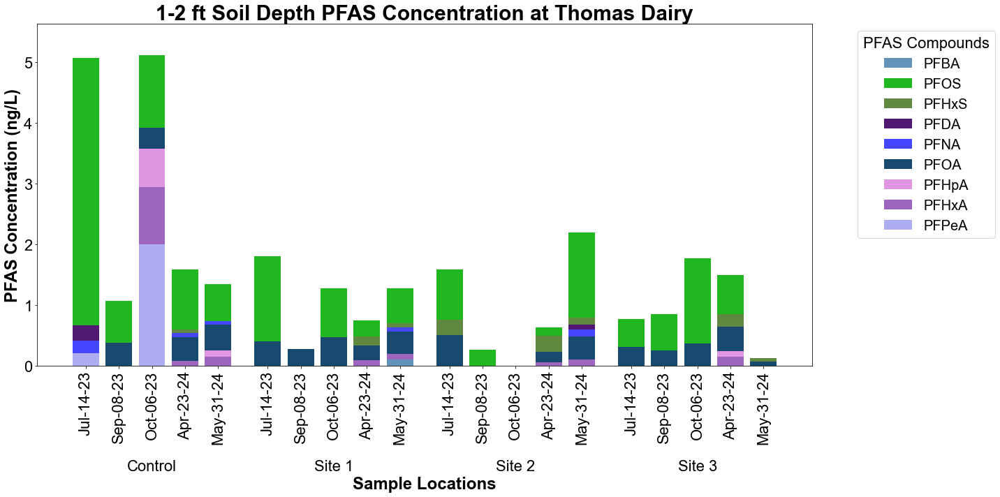

In [ ]:
create_grouped_stacked_bar_chart(transposed_pivot_table, figsize=(20, 10),plot_title="1-2 ft Soil Depth PFAS Concentration at Thomas Dairy",compound_colors_dict_abbrev=compound_colors_dict_abbrev)

### Data Request

#### Functions

In [ ]:
def create_custom_pivot_table(data_df, value_column='Quant Incl Estimates Incl Qual Flags', filter_qual_summary=None, start_date=None, end_date=None, filter_pfas_compounds=None, filter_sample_location=None):
    """
    Create a custom pivot table with filters based on 'Qual Summary (Grade for filtering)', 'Sample Location',
    'Sample Date', 'PFAS Compounds', and 'Sample Location'.

    Args:
        data_df (pd.DataFrame): The DataFrame containing the data.
        value_column (str, optional): The column to use as pivot table values (default is 'Quant Incl Estimates Incl Qual Flags').
        filter_qual_summary (list of str, optional): List of 'Qual Summary (Grade for filtering)' values to filter the data (default is None).
        start_date (str, optional): Start date for the date range filter (default is None).
        end_date (str, optional): End date for the date range filter (default is None).
        filter_pfas_compounds (list of str, optional): List of 'PFAS Compounds' values to filter the data (default is None).
        filter_sample_location (list of str, optional): List of 'Sample Location' values to filter the data (default is None).

    Returns:
        pd.DataFrame: The custom pivot table with average values.
    """
    try:
        # Apply filters based on 'Qual Summary (Grade for filtering)'
        filtered_data = data_df
        if filter_qual_summary:
            filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

        # Apply date range filter based on 'Sample Date'
        if start_date and end_date:
            filtered_data = filtered_data[(filtered_data['Sample Date'] >= start_date) & (filtered_data['Sample Date'] <= end_date)]

        # Apply filters based on 'PFAS Compounds'
        if filter_pfas_compounds:
            filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(filter_pfas_compounds)]

        # Apply filter based on 'Sample Location'
        if filter_sample_location:
            filtered_data = filtered_data[filtered_data['Sample Location'].isin(filter_sample_location)]

        # Create a pivot table with 'Sample Date' as columns, 'PFAS Compound' as rows, and specified value column as values
        pivot_table = pd.pivot_table(filtered_data, values=value_column,
                                     index='PFAS Compound', columns='Sample Date',
                                     aggfunc='mean', fill_value=np.nan)

        return pivot_table

    except Exception as e:
        print(f"An error occurred: {str(e)}")
        return None

In [ ]:
def create_combined_pivot(Quat, QuatInc, MDL):
    # Create an empty DataFrame with the same structure as the input tables
    combined_pivot = pd.DataFrame(index=Quat.index, columns=Quat.columns)
    
    # Iterate through rows and columns
    for row in Quat.index:
        for col in Quat.columns:
            Quat_value = Quat.loc[row, col] if row in Quat.index and col in Quat.columns else np.nan
            QuatInc_value = QuatInc.loc[row, col] if row in QuatInc.index and col in QuatInc.columns else np.nan
            MDL_value = MDL.loc[row, col] if row in MDL.index and col in MDL.columns else np.nan
            
            # Check if the values are numeric
            if pd.notna(Quat_value):
                Quat_value = float(Quat_value)  # Convert to float
                QuatInc_value = float(QuatInc_value)  # Convert to float
                MDL_value = float(MDL_value)  # Convert to float
                
                if Quat_value > 0:
                    combined_pivot.loc[row, col] = str(Quat_value)
                elif QuatInc_value > 0:
                    combined_pivot.loc[row, col] = str(QuatInc_value) + " E"
                else:
                    combined_pivot.loc[row, col] = "< " + str(MDL_value)
            else:
                combined_pivot.loc[row, col] = ""
    
    return combined_pivot

In [ ]:
# Filter criteria
#filter_qual_summary (list of str, optional): List of 'Qual Summary (Grade for filtering)' values to filter the data (default is None).
filter_qual_summary = ['Good','Probably Ok','Probably ok']
# filter_sample_location (list of str, optional): List of 'Sample Location' values to filter the data (default is None).
filter_sample_location=['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2',
                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 0',
                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
                          'Thomas Dairy Site 3 Soil - 2']
filter_sample_location=['Thomas Dairy Control Site Soil - 1']
start_date='2023-01-01'
end_date='2024-12-30'

In [ ]:
quant_pivot=create_custom_pivot_table(data_df,value_column='Quant Only Incl Qual Flags', filter_qual_summary=filter_qual_summary, filter_pfas_compounds=None, filter_sample_location=filter_sample_location)
quant_pivot

Sample Date,2023-07-14,2023-09-08,2023-10-06,2024-04-23,2024-05-31
PFAS Compound,,,,,
10:2Fluorotelomersulfonic acid,0.0,0.0,0.0,NaN,NaN
11Cl-PF3OUdS,0.0,0.0,0.0,0.00,0.000
3:3 FTCA,NaN,NaN,NaN,0.00,0.000
4:2 Fluorotelomersulfonic acid,0.0,0.0,0.0,0.00,0.000
5:3 FTCA,NaN,NaN,NaN,0.00,0.000
6:2 Fluorotelomersulfonic acid,0.0,0.0,0.0,0.00,0.000
7:3 FTCA,NaN,NaN,NaN,0.00,0.000
8:2 Fluorotelomersulfonic acid,0.0,0.0,0.0,0.00,0.000
9Cl-PF3ONS,0.0,0.0,0.0,0.00,0.000


In [ ]:
QuatInc_Pivot = create_custom_pivot_table(data_df,value_column='Quant Incl Estimates Incl Qual Flags', filter_qual_summary=filter_qual_summary, filter_pfas_compounds=None, filter_sample_location=filter_sample_location)
QuatInc_Pivot

Sample Date,2023-07-14,2023-09-08,2023-10-06,2024-04-23,2024-05-31
PFAS Compound,,,,,
10:2Fluorotelomersulfonic acid,0.00,0.0,0.00,NaN,NaN
11Cl-PF3OUdS,0.00,0.0,0.00,0.000,0.000
3:3 FTCA,NaN,NaN,NaN,0.000,0.000
4:2 Fluorotelomersulfonic acid,0.00,0.0,0.00,0.000,0.000
5:3 FTCA,NaN,NaN,NaN,0.000,0.000
6:2 Fluorotelomersulfonic acid,0.00,0.0,0.00,0.000,0.000
7:3 FTCA,NaN,NaN,NaN,0.000,0.000
8:2 Fluorotelomersulfonic acid,0.00,0.0,0.00,0.000,0.000
9Cl-PF3ONS,0.00,0.0,0.00,0.000,0.000


In [ ]:
MDL_Pivot=create_custom_pivot_table(data_df,value_column='MDL', filter_qual_summary=filter_qual_summary,  filter_pfas_compounds=None, filter_sample_location=filter_sample_location)
MDL_Pivot

Sample Date,2023-07-14,2023-09-08,2023-10-06,2024-04-23,2024-05-31
PFAS Compound,,,,,
10:2Fluorotelomersulfonic acid,0.63,0.67,0.70,NaN,NaN
11Cl-PF3OUdS,0.21,0.22,0.23,0.200,0.200
3:3 FTCA,NaN,NaN,NaN,0.250,0.250
4:2 Fluorotelomersulfonic acid,0.63,0.67,0.70,0.200,0.200
5:3 FTCA,NaN,NaN,NaN,1.000,0.990
6:2 Fluorotelomersulfonic acid,0.63,0.67,0.70,0.350,0.350
7:3 FTCA,NaN,NaN,NaN,1.000,0.990
8:2 Fluorotelomersulfonic acid,0.63,0.67,0.70,0.350,0.350
9Cl-PF3ONS,0.21,0.22,0.23,0.200,0.200


In [ ]:
# Call function and provide previous tables as inputs
PFAS_Results_Location = create_combined_pivot(Quat=quant_pivot, QuatInc=QuatInc_Pivot, MDL=MDL_Pivot)

# Create a dictionary mapping PFAS Compounds to their corresponding Abbreviation (No need to change)
pfas_mapping = dict(zip(df_PFAS_Attributes['Database'], df_PFAS_Attributes['Abbrev']))

# Rename the index of data_df using the mapping (No need to change)
PFAS_Results_Location.index = PFAS_Results_Location.index.map(pfas_mapping)

PFAS_Results_Location

Sample Date,2023-07-14,2023-09-08,2023-10-06,2024-04-23,2024-05-31
PFAS Compound,,,,,
10:2FTS,< 0.63,< 0.67,< 0.7,,
11Cl-PF3OUdS,< 0.21,< 0.22,< 0.23,< 0.2,< 0.2
3:3FTCA,,,,< 0.25,< 0.25
4:2FTS,< 0.63,< 0.67,< 0.7,< 0.2,< 0.2
5:3FTCA,,,,< 1.0,< 0.99
6:2FTS,< 0.63,< 0.67,< 0.7,< 0.35,< 0.35
7:3FTCA,,,,< 1.0,< 0.99
8:2FTS,< 0.63,< 0.67,< 0.7,< 0.35,< 0.35
9Cl-PF3ONS,< 0.21,< 0.22,< 0.23,< 0.2,< 0.2


In [ ]:
#dfs: A dictionary where keys are the tab names and values are the DataFrames to write.
dfs = {'Quant': quant_pivot,
       'QuantIncEstimate' :QuatInc_Pivot,
       'MDLs' : MDL_Pivot,
       'PFAS Report' : PFAS_Results_Location}

#filename: The name of the Excel file to write to.
filename= 'ThomasDairy_Control_0-1 ft.xlsx'
dfs_to_excel(dfs, filename)

File 'ThomasDairy_Control_0-1 ft.xlsx' has been written with 4 tabs.


### Compare Past Average to New Samples

#### Functions

In [ ]:
def PivotTable_AvgPFASCompound_FilterByCompoundSamplingDatesLocation(data_df, filter_qual_summary=None, filter_pfas_compound=None,
                              filter_sample_location=None, start_date=None, end_date=None,col_name= 'Quant Incl Estimates Incl Qual Flags'):
    """
    Create a custom pivot table with filters based on 'Qual Summary (Grade for filtering)', 'PFAS Compound',
    'Sample Location', and a date range for 'Sample Date'.

    Args:
        data_df (pd.DataFrame): The DataFrame containing the data.
        filter_qual_summary (list of str, optional): List of 'Qual Summary (Grade for filtering)' values to filter the data (default is None).
        filter_pfas_compound (list of str, optional): List of 'PFAS Compound' values to filter the data (default is None).
        filter_sample_location (list of str, optional): List of 'Sample Location' values to filter the data (default is None).
        start_date (str, optional): Start date for the date range filter (default is None).
        end_date (str, optional): End date for the date range filter (default is None).

    Returns:
        pd.DataFrame: The custom pivot table.
    """
    try:
        # Apply filters based on 'Qual Summary (Grade for filtering)'
        filtered_data = data_df
        if filter_qual_summary:
            filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

        # Apply filters based on 'PFAS Compound'
        if len(filter_pfas_compound) > 0:
            filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(filter_pfas_compound)]

        # Apply filters based on 'Sample Location'
        if len(filter_sample_location) >0:
            filtered_data = filtered_data[filtered_data['Sample Location'].isin(filter_sample_location)]

        # Apply date range filter based on 'Sample Date'
        if start_date and end_date:
            filtered_data = filtered_data[(filtered_data['Sample Date'] >= start_date) & (filtered_data['Sample Date'] <= end_date)]

        # Create a pivot table with 'Sample Location' as rows, 'PFAS Compound' as columns, and average of 'Quant Incl Estimates Incl Qual Flags' as values
        pivot_table = pd.pivot_table(filtered_data, values=col_name,
                                     index='Sample Location', columns='PFAS Compound', aggfunc='mean', fill_value=0)

        return pivot_table

    except Exception as e:
        print(f"An error occurred: {str(e)}")
        return None

In [ ]:
def split_label(label):
        if len(label) > 9:
            split_point = label.find(' ', 9)  # Find next space after 14th character
            if split_point != -1:
                return label[:split_point] + '\n' + label[split_point + 1:]
        return label  # Return label unmodified if it's short enough or no space found

In [ ]:
def create_seasonal_stacked_bar_chart(season_1_data, season_2_data, figsize=(12, 8), title='Seasonal PFAS Concentrations by Sample Location', compound_colors_dict=None,
                                      title_fontsize=20, axis_label_fontsize=16, tick_label_fontsize=14, legend_fontsize=12, bar_width=0.35, rows_order=[]):
    try:
        font_bold = FontProperties(family='Arial', weight='bold')
        
        # Convert zeros to NaNs to avoid plotting zero-height bars
        season_1_data = season_1_data.replace(0, np.nan)
        season_2_data = season_2_data.replace(0, np.nan)
        
        # Prepare figure and axes
        fig, ax = plt.subplots(figsize=figsize)
        locations = set(season_1_data.index).union(season_2_data.index)
        locations = sorted(locations, key=lambda x: rows_order.index(x) if x in rows_order else len(rows_order))
        
        # Position indices for the bars, adjusted to include gaps and three seasons
        x_indices = np.arange(len(locations))
        gap = 0.02  # This is the gap between bars
        adjusted_width = (bar_width - 2 * gap) / 3  # Adjust bar width to accommodate three bars
        
        season_bottoms = [{loc: 0 for loc in locations} for _ in range(3)]  # Tracking bottoms for each bar stack in three seasons
        legend_entries = {}  # Dictionary to manage legend entries

        # Iterate through each compound defined in the color dictionary
        for compound in compound_colors_dict:
            color = compound_colors_dict[compound]
            for i, season_data in enumerate([season_1_data, season_2_data]):
                heights = [season_data.at[loc, compound] if compound in season_data.columns and pd.notna(season_data.at[loc, compound]) else 0 for loc in locations]
                # Plot bars for each season with adjusted positions
                bars = ax.bar(x_indices + i * (adjusted_width + gap) - bar_width / 2, heights, width=adjusted_width,
                       bottom=[season_bottoms[i][loc] for loc in locations], color=color, align='edge')
                # Update bottom heights for stacking
                season_bottoms[i] = {loc: season_bottoms[i][loc] + height for loc, height in zip(locations, heights)}
                # Manage legend entries
                if compound not in legend_entries and any(heights):
                    legend_entries[compound] = bars[0]  # Use the first bar artist as the legend handle for this compound

        # Calculate the maximum stack height for setting y-axis limits
        max_stack_height = max(max(bottoms.values()) for bottoms in season_bottoms)
        ax.set_ylim(0, max_stack_height * 1.10 if max_stack_height > 0 else 1)  # Adjusting y-axis
        #ax.set_ylim(0, 180)  # Adjusting y-axis
        # Set y-axis ticks every 25 units
        #ax.set_yticks(np.arange(0, 181, 25))

        ax.set_xticks(x_indices)
        ax.set_xticklabels([split_label(label) for label in locations], rotation=45, ha='right', fontsize=tick_label_fontsize)
        ax.set_xlabel('Sample Location', fontsize=axis_label_fontsize, fontproperties=font_bold)
        ax.set_ylabel('PFAS Concentration (ng/g)', fontsize=axis_label_fontsize, fontproperties=font_bold)
        ax.set_title(title, fontsize=title_fontsize, fontproperties=font_bold)

        # Set the legend using the managed entries
        ax.legend(legend_entries.values(), legend_entries.keys(), title='PFAS Compounds', loc='lower center', bbox_to_anchor=(0.5, -0.6), ncol=6, fontsize=legend_fontsize,title_fontsize=legend_fontsize)

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"An error occurred: {e}")

In [ ]:
def align_dataframes(df_list):
    """ Ensure all dataframes in the list have the same columns by adding dummy columns with 0s where needed. """
    # Union all columns from all dataframes
    all_columns = sorted(set.union(*(set(df.columns) for df in df_list)))
    
    # Add missing columns with default values of 0
    for df in df_list:
        missing_cols = set(all_columns) - set(df.columns)
        for col in missing_cols:
            df[col] = 0  # Add missing columns with 0s
    
    # Reorder all columns to match the union of all columns
    for i in range(len(df_list)):
        df_list[i] = df_list[i][all_columns]
        
    return df_list

#### Define Periods

In [ ]:
# Specify start_date (str, optional): Start date for the date range filter (default is None).
start_date_past='2023-01-01'
#Specify end_date (str, optional): End date for the date range filter (default is None).
end_date_past='2024-04-30'

# Specify start_date (str, optional): Start date for the date range filter (default is None).
start_date_new='2024-05-01'
#Specify end_date (str, optional): End date for the date range filter (default is None).
end_date_new='2024-05-31'

In [ ]:
filter_sample_location=['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2',
                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 0',
                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
                          'Thomas Dairy Site 3 Soil - 2']

#### Control

In [ ]:
# All Ambient Locations

# Specify filter_qual_summary (list of str, optional): List of 'Qual Summary (Grade for filtering)' values to filter the data (default is None).
# (Eg. 'Good', 'Questionable', etc)
filter_qual_summary=['Good','Probably Ok','Probably ok']

#Specify filter_pfas_compound (list of str, optional): List of 'PFAS Compound' values to filter the data (default is None).
filter_pfas_compound= data_df['PFAS Compound'].unique()

#Specify filter_sample_location (list of str, optional): List of 'Sample Location' values to filter the data (default is None).
filter_sample_location= ['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2']

#filter_sample_location=['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2',
#                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 0',
#                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
#                          'Thomas Dairy Site 3 Soil - 2']
#For 2024 Data

rows_order= ['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2']
rows_order_reverse=['Thomas Dairy Control Site Soil - 2','Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 0']

col_name= 'Quant Incl Estimates Incl Qual Flags'

In [ ]:
# Example usage with filters: Create pivot table for avg. PFAS Compound values at various locations, 
# filtered by type of PFAS compound and sampling dates

avg_pivot_table_past = PivotTable_AvgPFASCompound_FilterByCompoundSamplingDatesLocation(data_df=data_df_filtered_agg,filter_qual_summary=filter_qual_summary,filter_pfas_compound=filter_pfas_compound,filter_sample_location=filter_sample_location, 
                                                                                   start_date=start_date_past, end_date=end_date_past,col_name=col_name)

#Reorder Compounds Based on PFAS Class and Chain Length
# Assuming df is your original DataFrame and df_PFAS_Attributes['Database'] contains the desired column order
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in avg_pivot_table_past.columns]

#Reorder rows based on sample location going downstream
# Reorder rows by indexing df with the filtered index order
#avg_pivot_table_past = avg_pivot_table_past.loc[rows_order]

# Reorder columns by indexing df with the desired order
#avg_pivot_table_past = avg_pivot_table_past[filtered_order]

avg_pivot_table_past = avg_pivot_table_past.rename(columns=pfas_mapping)

rename_dict = {
    'Thomas Dairy Control Site Soil - 0': 'Surface',
    'Thomas Dairy Control Site Soil - 1': '0-1 ft',
    'Thomas Dairy Control Site Soil - 2': '1-2 ft'
}
avg_pivot_table_past.index = avg_pivot_table_past.index.map(rename_dict)

avg_pivot_table_past

PFAS Compound,10:2FTS,11Cl-PF3OUdS,3:3FTCA,4:2FTS,5:3FTCA,6:2FTS,7:3FTCA,8:2FTS,9Cl-PF3ONS,ADONA,...,PFNA,PFODA,FOSA,PFOS,PFOA,PFPeS,PFPeA,PFTeDA,PFTrDA,PFUnA
Sample Location,,,,,,,,,,,,,,,,,,,,,
Surface,0,0,0,0,0,0,0,0,0,0,...,0.04250,0,0,2.45,0.2225,0,0.1575,0,0,0
0-1 ft,0,0,0,0,0,0,0,0,0,0,...,0.03250,0,0,1.75,0.3150,0,0.4525,0,0,0
1-2 ft,0,0,0,0,0,0,0,0,0,0,...,0.06975,0,0,1.82,0.2775,0,0.5525,0,0,0


In [ ]:
# Example usage with filters: Create pivot table for avg. PFAS Compound values at various locations, 
# filtered by type of PFAS compound and sampling dates

avg_pivot_table_new = PivotTable_AvgPFASCompound_FilterByCompoundSamplingDatesLocation(data_df=data_df_filtered_agg,filter_qual_summary=filter_qual_summary,filter_pfas_compound=filter_pfas_compound,filter_sample_location=filter_sample_location, 
                                                                                   start_date=start_date_new, end_date=end_date_new,col_name=col_name)

#Reorder Compounds Based on PFAS Class and Chain Length
# Assuming df is your original DataFrame and df_PFAS_Attributes['Database'] contains the desired column order
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in avg_pivot_table_new.columns]

#Reorder rows based on sample location going downstream
# Reorder rows by indexing df with the filtered index order
#avg_pivot_table_new = avg_pivot_table_new.loc[rows_order]

# Reorder columns by indexing df with the desired order
#avg_pivot_table_new = avg_pivot_table_new[filtered_order]

avg_pivot_table_new = avg_pivot_table_new.rename(columns=pfas_mapping)

rename_dict = {
    'Thomas Dairy Control Site Soil - 0': 'Surface',
    'Thomas Dairy Control Site Soil - 1': '0-1 ft',
    'Thomas Dairy Control Site Soil - 2': '1-2 ft'
}
avg_pivot_table_new.index = avg_pivot_table_new.index.map(rename_dict)

avg_pivot_table_new

PFAS Compound,11Cl-PF3OUdS,3:3FTCA,4:2FTS,5:3FTCA,6:2FTS,7:3FTCA,8:2FTS,9Cl-PF3ONS,ADONA,HFPO-DA,...,PFNS,PFNA,FOSA,PFOS,PFOA,PFPeS,PFPeA,PFTeDA,PFTrDA,PFUnA
Sample Location,,,,,,,,,,,,,,,,,,,,,
Surface,0,0,0,0,0,0,0,0,0,0,...,0,0.160,0,1.80,0.23,0,1.00,0,0,0
0-1 ft,0,0,0,0,0,0,0,0,0,0,...,0,0.130,0,1.40,0.61,0,0.25,0,0,0
1-2 ft,0,0,0,0,0,0,0,0,0,0,...,0,0.057,0,0.61,0.42,0,0.00,0,0,0


In [ ]:
# Assuming avg_pivot_table_Before, avg_pivot_table_During, avg_pivot_table_After are your datasets
dataframes = [avg_pivot_table_past,avg_pivot_table_new]
aligned_dataframes = align_dataframes(dataframes)

# Now aligned_dataframes[0], aligned_dataframes[1], and aligned_dataframes[2] have the same columns
avg_pivot_table_past, avg_pivot_table_new = aligned_dataframes

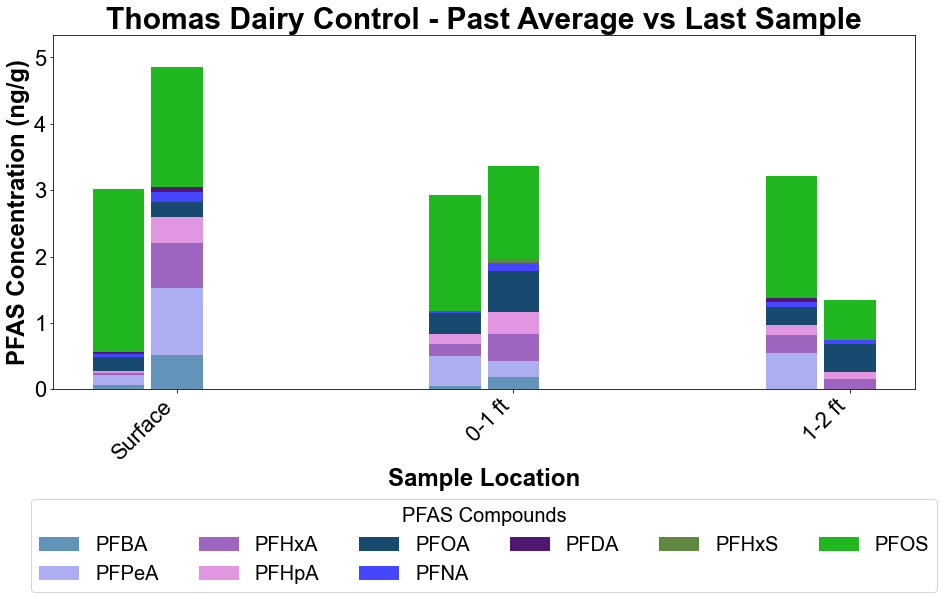

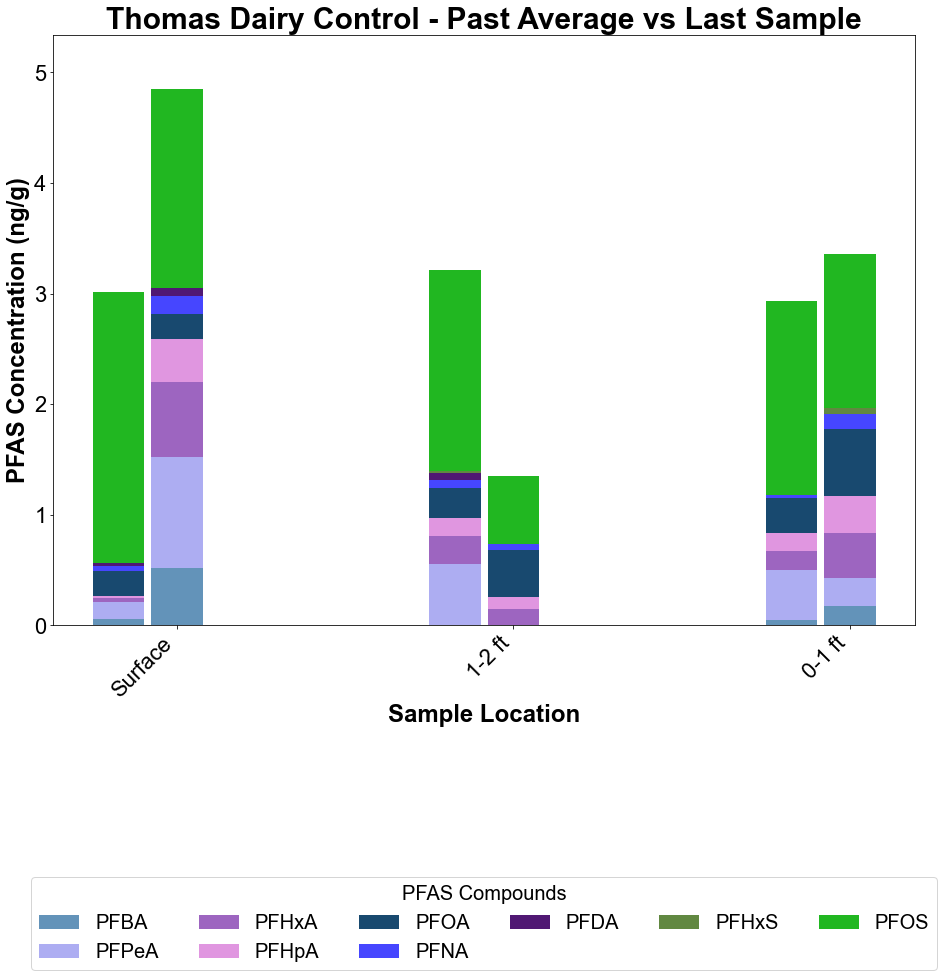

In [ ]:
create_seasonal_stacked_bar_chart(season_1_data=avg_pivot_table_past,season_2_data=avg_pivot_table_new, figsize=(14,10), compound_colors_dict=compound_colors_dict_abbrev,
                                   title_fontsize=30, axis_label_fontsize=24, tick_label_fontsize=22, legend_fontsize=20, bar_width=0.5,
                                   title='Thomas Dairy Control - Past Average vs Last Sample',rows_order=['Surface', '0-1 ft','1-2 ft'])
create_seasonal_stacked_bar_chart(season_1_data=avg_pivot_table_past,season_2_data=avg_pivot_table_new, figsize=(14,16), compound_colors_dict=compound_colors_dict_abbrev,
                                   title_fontsize=30, axis_label_fontsize=24, tick_label_fontsize=22, legend_fontsize=20, bar_width=0.5,
                                   title='Thomas Dairy Control - Past Average vs Last Sample')

#### Site 1

In [ ]:
# All Ambient Locations

# Specify filter_qual_summary (list of str, optional): List of 'Qual Summary (Grade for filtering)' values to filter the data (default is None).
# (Eg. 'Good', 'Questionable', etc)
filter_qual_summary=['Good','Probably Ok','Probably ok']

#Specify filter_pfas_compound (list of str, optional): List of 'PFAS Compound' values to filter the data (default is None).
filter_pfas_compound= data_df['PFAS Compound'].unique()

#Specify filter_sample_location (list of str, optional): List of 'Sample Location' values to filter the data (default is None).
filter_sample_location= ['Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2']

#For 2024 Data

rows_order= ['Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2']
rows_order_reverse=['Thomas Dairy Control Site Soil - 0','Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2']

col_name= 'Quant Incl Estimates Incl Qual Flags'

In [ ]:
# Example usage with filters: Create pivot table for avg. PFAS Compound values at various locations, 
# filtered by type of PFAS compound and sampling dates

avg_pivot_table_past = PivotTable_AvgPFASCompound_FilterByCompoundSamplingDatesLocation(data_df=data_df_filtered_agg,filter_qual_summary=filter_qual_summary,filter_pfas_compound=filter_pfas_compound,filter_sample_location=filter_sample_location, 
                                                                                   start_date=start_date_past, end_date=end_date_past,col_name=col_name)

#Reorder Compounds Based on PFAS Class and Chain Length
# Assuming df is your original DataFrame and df_PFAS_Attributes['Database'] contains the desired column order
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in avg_pivot_table_past.columns]

#Reorder rows based on sample location going downstream
# Reorder rows by indexing df with the filtered index order
avg_pivot_table_past = avg_pivot_table_past.loc[rows_order]

# Reorder columns by indexing df with the desired order
avg_pivot_table_past = avg_pivot_table_past[filtered_order]

avg_pivot_table_past = avg_pivot_table_past.rename(columns=pfas_mapping)

rename_dict = {
    'Thomas Dairy Site 1 Soil - 0': 'Surface',
    'Thomas Dairy Site 1 Soil - 1': '0-1 ft',
    'Thomas Dairy Site 1 Soil - 2': '1-2 ft'
}
avg_pivot_table_past.index = avg_pivot_table_past.index.map(rename_dict)

avg_pivot_table_past

PFAS Compound,3:3FTCA,5:3FTCA,7:3FTCA,PFBA,PFPeA,PFHxA,PFHpA,PFOA,PFNA,PFDA,...,8:2FTS,10:2FTS,NEtFOSA,NMeFOSA,FOSA,NEtFOSE,NMeFOSE,PFEESA,9Cl-PF3ONS,11Cl-PF3OUdS
Sample Location,,,,,,,,,,,,,,,,,,,,,
Surface,0,0,0,0.03,0.11,0.02325,0.0000,0.1225,0.0275,0.0325,...,0,0,0,0,0,0,0,0,0,0
0-1 ft,0,0,0,0.00,0.00,0.01650,0.0165,0.3325,0.0000,0.0000,...,0,0,0,0,0,0,0,0,0,0
1-2 ft,0,0,0,0.00,0.00,0.02475,0.0000,0.3500,0.0000,0.0000,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Example usage with filters: Create pivot table for avg. PFAS Compound values at various locations, 
# filtered by type of PFAS compound and sampling dates

avg_pivot_table_new = PivotTable_AvgPFASCompound_FilterByCompoundSamplingDatesLocation(data_df=data_df_filtered_agg,filter_qual_summary=filter_qual_summary,filter_pfas_compound=filter_pfas_compound,filter_sample_location=filter_sample_location, 
                                                                                   start_date=start_date_new, end_date=end_date_new,col_name=col_name)

#Reorder Compounds Based on PFAS Class and Chain Length
# Assuming df is your original DataFrame and df_PFAS_Attributes['Database'] contains the desired column order
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in avg_pivot_table_new.columns]

#Reorder rows based on sample location going downstream
# Reorder rows by indexing df with the filtered index order
avg_pivot_table_new = avg_pivot_table_new.loc[rows_order]

# Reorder columns by indexing df with the desired order
avg_pivot_table_new = avg_pivot_table_new[filtered_order]

avg_pivot_table_new = avg_pivot_table_new.rename(columns=pfas_mapping)

rename_dict = {
    'Thomas Dairy Site 1 Soil - 0': 'Surface',
    'Thomas Dairy Site 1 Soil - 1': '0-1 ft',
    'Thomas Dairy Site 1 Soil - 2': '1-2 ft'
}
avg_pivot_table_new.index = avg_pivot_table_new.index.map(rename_dict)

avg_pivot_table_new

PFAS Compound,3:3FTCA,5:3FTCA,7:3FTCA,PFBA,PFPeA,PFHxA,PFHpA,PFOA,PFNA,PFDA,...,6:2FTS,8:2FTS,NEtFOSA,NMeFOSA,FOSA,NEtFOSE,NMeFOSE,PFEESA,9Cl-PF3ONS,11Cl-PF3OUdS
Sample Location,,,,,,,,,,,,,,,,,,,,,
Surface,0,0,0,0.11,0.130,0.110,0,0.27,0.20,0.13,...,0,0,0,0,0,0,0,0,0,0
0-1 ft,0,0,0,0.11,0.099,0.000,0,0.25,0.10,0.00,...,0,0,0,0,0,0,0,0,0,0
1-2 ft,0,0,0,0.11,0.000,0.092,0,0.37,0.06,0.00,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Assuming avg_pivot_table_Before, avg_pivot_table_During, avg_pivot_table_After are your datasets
dataframes = [avg_pivot_table_past,avg_pivot_table_new]
aligned_dataframes = align_dataframes(dataframes)

# Now aligned_dataframes[0], aligned_dataframes[1], and aligned_dataframes[2] have the same columns
avg_pivot_table_past, avg_pivot_table_new = aligned_dataframes

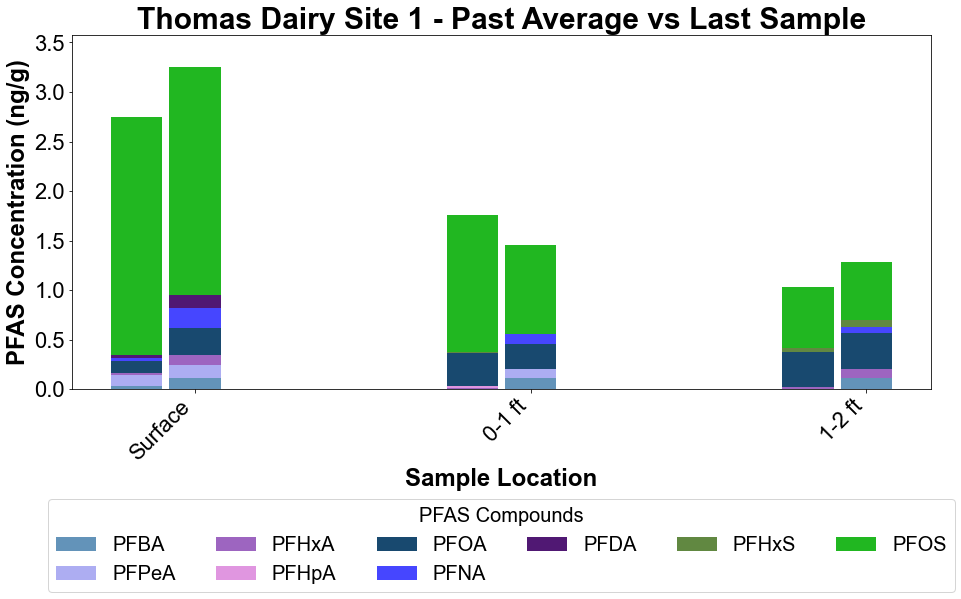

In [ ]:
create_seasonal_stacked_bar_chart(season_1_data=avg_pivot_table_past,season_2_data=avg_pivot_table_new, figsize=(14,10), compound_colors_dict=compound_colors_dict_abbrev,
                                   title_fontsize=30, axis_label_fontsize=24, tick_label_fontsize=22, legend_fontsize=20, bar_width=0.5,
                                   title='Thomas Dairy Site 1 - Past Average vs Last Sample',rows_order=['Surface', '0-1 ft','1-2 ft'])

#### Site 2

In [ ]:
# All Ambient Locations

# Specify filter_qual_summary (list of str, optional): List of 'Qual Summary (Grade for filtering)' values to filter the data (default is None).
# (Eg. 'Good', 'Questionable', etc)
filter_qual_summary=['Good','Probably Ok','Probably ok']

#Specify filter_pfas_compound (list of str, optional): List of 'PFAS Compound' values to filter the data (default is None).
filter_pfas_compound= data_df['PFAS Compound'].unique()

#Specify filter_sample_location (list of str, optional): List of 'Sample Location' values to filter the data (default is None).
filter_sample_location= ['Thomas Dairy Site 2 Soil - 0', 'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2']

#For 2024 Data

rows_order= ['Thomas Dairy Site 2 Soil - 0', 'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2']

col_name= 'Quant Incl Estimates Incl Qual Flags'

In [ ]:
# Example usage with filters: Create pivot table for avg. PFAS Compound values at various locations, 
# filtered by type of PFAS compound and sampling dates

avg_pivot_table_past = PivotTable_AvgPFASCompound_FilterByCompoundSamplingDatesLocation(data_df=data_df_filtered_agg,filter_qual_summary=filter_qual_summary,filter_pfas_compound=filter_pfas_compound,filter_sample_location=filter_sample_location, 
                                                                                   start_date=start_date_past, end_date=end_date_past,col_name=col_name)

#Reorder Compounds Based on PFAS Class and Chain Length
# Assuming df is your original DataFrame and df_PFAS_Attributes['Database'] contains the desired column order
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in avg_pivot_table_past.columns]

#Reorder rows based on sample location going downstream
# Reorder rows by indexing df with the filtered index order
avg_pivot_table_past = avg_pivot_table_past.loc[rows_order]

# Reorder columns by indexing df with the desired order
avg_pivot_table_past = avg_pivot_table_past[filtered_order]

avg_pivot_table_past = avg_pivot_table_past.rename(columns=pfas_mapping)

rename_dict = {
    'Thomas Dairy Site 2 Soil - 0': 'Surface',
    'Thomas Dairy Site 2 Soil - 1': '0-1 ft',
    'Thomas Dairy Site 2 Soil - 2': '1-2 ft'
}
avg_pivot_table_past.index = avg_pivot_table_past.index.map(rename_dict)

avg_pivot_table_past

PFAS Compound,3:3FTCA,5:3FTCA,7:3FTCA,PFBA,PFPeA,PFHxA,PFHpA,PFOA,PFNA,PFDA,...,8:2FTS,10:2FTS,NEtFOSA,NMeFOSA,FOSA,NEtFOSE,NMeFOSE,PFEESA,9Cl-PF3ONS,11Cl-PF3OUdS
Sample Location,,,,,,,,,,,,,,,,,,,,,
Surface,0,0,0,0,0.2825,0.06500,0.03250,0.3850,0.17750,0.5725,...,0,0,0,0,0,0,0,0,0,0
0-1 ft,0,0,0,0,0.0000,0.04750,0.01875,0.6200,0.01325,0.0000,...,0,0,0,0,0,0,0,0,0,0
1-2 ft,0,0,0,0,0.0000,0.01475,0.00000,0.1725,0.00000,0.0000,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Example usage with filters: Create pivot table for avg. PFAS Compound values at various locations, 
# filtered by type of PFAS compound and sampling dates

avg_pivot_table_new = PivotTable_AvgPFASCompound_FilterByCompoundSamplingDatesLocation(data_df=data_df_filtered_agg,filter_qual_summary=filter_qual_summary,filter_pfas_compound=filter_pfas_compound,filter_sample_location=filter_sample_location, 
                                                                                   start_date=start_date_new, end_date=end_date_new,col_name=col_name)

#Reorder Compounds Based on PFAS Class and Chain Length
# Assuming df is your original DataFrame and df_PFAS_Attributes['Database'] contains the desired column order
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in avg_pivot_table_new.columns]

#Reorder rows based on sample location going downstream
# Reorder rows by indexing df with the filtered index order
avg_pivot_table_new = avg_pivot_table_new.loc[rows_order]

# Reorder columns by indexing df with the desired order
avg_pivot_table_new = avg_pivot_table_new[filtered_order]

avg_pivot_table_new = avg_pivot_table_new.rename(columns=pfas_mapping)

rename_dict = {
    'Thomas Dairy Site 2 Soil - 0': 'Surface',
    'Thomas Dairy Site 2 Soil - 1': '0-1 ft',
    'Thomas Dairy Site 2 Soil - 2': '1-2 ft'
}
avg_pivot_table_new.index = avg_pivot_table_new.index.map(rename_dict)

avg_pivot_table_new

PFAS Compound,3:3FTCA,5:3FTCA,7:3FTCA,PFBA,PFPeA,PFHxA,PFHpA,PFOA,PFNA,PFDA,...,6:2FTS,8:2FTS,NEtFOSA,NMeFOSA,FOSA,NEtFOSE,NMeFOSE,PFEESA,9Cl-PF3ONS,11Cl-PF3OUdS
Sample Location,,,,,,,,,,,,,,,,,,,,,
Surface,0,0,0,0,0,0.000,0,0.19,0.11,0.160,...,0,0,0,0,0,0,0,0,0,0
0-1 ft,0,0,0,0,0,0.092,0,0.37,0.11,0.065,...,0,0,0,0,0,0,0,0,0,0
1-2 ft,0,0,0,0,0,0.110,0,0.38,0.11,0.081,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Assuming avg_pivot_table_Before, avg_pivot_table_During, avg_pivot_table_After are your datasets
dataframes = [avg_pivot_table_past,avg_pivot_table_new]
aligned_dataframes = align_dataframes(dataframes)

# Now aligned_dataframes[0], aligned_dataframes[1], and aligned_dataframes[2] have the same columns
avg_pivot_table_past, avg_pivot_table_new = aligned_dataframes

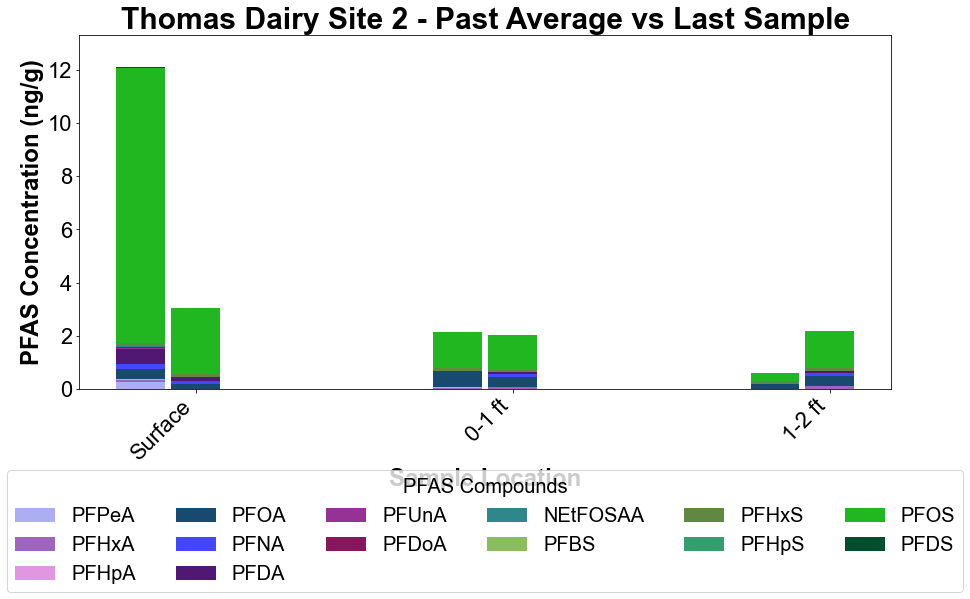

In [ ]:
create_seasonal_stacked_bar_chart(season_1_data=avg_pivot_table_past,season_2_data=avg_pivot_table_new, figsize=(14,10), compound_colors_dict=compound_colors_dict_abbrev,
                                   title_fontsize=30, axis_label_fontsize=24, tick_label_fontsize=22, legend_fontsize=20, bar_width=0.5,
                                   title='Thomas Dairy Site 2 - Past Average vs Last Sample',rows_order=['Surface', '0-1 ft','1-2 ft'])

#### Site 3

In [ ]:
# All Ambient Locations

# Specify filter_qual_summary (list of str, optional): List of 'Qual Summary (Grade for filtering)' values to filter the data (default is None).
# (Eg. 'Good', 'Questionable', etc)
filter_qual_summary=['Good','Probably Ok','Probably ok']

#Specify filter_pfas_compound (list of str, optional): List of 'PFAS Compound' values to filter the data (default is None).
filter_pfas_compound= data_df['PFAS Compound'].unique()

#Specify filter_sample_location (list of str, optional): List of 'Sample Location' values to filter the data (default is None).
filter_sample_location= ['Thomas Dairy Site 3 Soil - 0', 'Thomas Dairy Site 3 Soil - 1','Thomas Dairy Site 3 Soil - 2']

#For 2024 Data

rows_order= ['Thomas Dairy Site 3 Soil - 0', 'Thomas Dairy Site 3 Soil - 1','Thomas Dairy Site 3 Soil - 2']

col_name= 'Quant Incl Estimates Incl Qual Flags'

In [ ]:
# Example usage with filters: Create pivot table for avg. PFAS Compound values at various locations, 
# filtered by type of PFAS compound and sampling dates

avg_pivot_table_past = PivotTable_AvgPFASCompound_FilterByCompoundSamplingDatesLocation(data_df=data_df_filtered_agg,filter_qual_summary=filter_qual_summary,filter_pfas_compound=filter_pfas_compound,filter_sample_location=filter_sample_location, 
                                                                                   start_date=start_date_past, end_date=end_date_past,col_name=col_name)

#Reorder Compounds Based on PFAS Class and Chain Length
# Assuming df is your original DataFrame and df_PFAS_Attributes['Database'] contains the desired column order
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in avg_pivot_table_past.columns]

#Reorder rows based on sample location going downstream
# Reorder rows by indexing df with the filtered index order
avg_pivot_table_past = avg_pivot_table_past.loc[rows_order]

# Reorder columns by indexing df with the desired order
avg_pivot_table_past = avg_pivot_table_past[filtered_order]

avg_pivot_table_past = avg_pivot_table_past.rename(columns=pfas_mapping)

rename_dict = {
    'Thomas Dairy Site 3 Soil - 0': 'Surface',
    'Thomas Dairy Site 3 Soil - 1': '0-1 ft',
    'Thomas Dairy Site 3 Soil - 2': '1-2 ft'
}
avg_pivot_table_past.index = avg_pivot_table_past.index.map(rename_dict)

avg_pivot_table_past

PFAS Compound,3:3FTCA,5:3FTCA,7:3FTCA,PFBA,PFPeA,PFHxA,PFHpA,PFOA,PFNA,PFDA,...,8:2FTS,10:2FTS,NEtFOSA,NMeFOSA,FOSA,NEtFOSE,NMeFOSE,PFEESA,9Cl-PF3ONS,11Cl-PF3OUdS
Sample Location,,,,,,,,,,,,,,,,,,,,,
Surface,0,0,0,0,0.135,0.0375,0.01400,0.1525,0.0475,0.1475,...,0,0,0,0,0,0,0,0,0,0
0-1 ft,0,0,0,0,0.030,0.0350,0.02025,0.1750,0.0425,0.0400,...,0,0,0,0,0,0,0,0,0,0
1-2 ft,0,0,0,0,0.000,0.0375,0.02325,0.3350,0.0000,0.0000,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Example usage with filters: Create pivot table for avg. PFAS Compound values at various locations, 
# filtered by type of PFAS compound and sampling dates

avg_pivot_table_new = PivotTable_AvgPFASCompound_FilterByCompoundSamplingDatesLocation(data_df=data_df_filtered_agg,filter_qual_summary=filter_qual_summary,filter_pfas_compound=filter_pfas_compound,filter_sample_location=filter_sample_location, 
                                                                                   start_date=start_date_new, end_date=end_date_new,col_name=col_name)

#Reorder Compounds Based on PFAS Class and Chain Length
# Assuming df is your original DataFrame and df_PFAS_Attributes['Database'] contains the desired column order
desired_order = df['Database'].tolist()  # Convert to list if not already
# Filter the desired_order to only include columns that exist in df
filtered_order = [comp for comp in desired_order if comp in avg_pivot_table_new.columns]

#Reorder rows based on sample location going downstream
# Reorder rows by indexing df with the filtered index order
avg_pivot_table_new = avg_pivot_table_new.loc[rows_order]

# Reorder columns by indexing df with the desired order
avg_pivot_table_new = avg_pivot_table_new[filtered_order]

avg_pivot_table_new = avg_pivot_table_new.rename(columns=pfas_mapping)

rename_dict = {
    'Thomas Dairy Site 3 Soil - 0': 'Surface',
    'Thomas Dairy Site 3 Soil - 1': '0-1 ft',
    'Thomas Dairy Site 3 Soil - 2': '1-2 ft'
}
avg_pivot_table_new.index = avg_pivot_table_new.index.map(rename_dict)

avg_pivot_table_new

PFAS Compound,3:3FTCA,5:3FTCA,7:3FTCA,PFBA,PFPeA,PFHxA,PFHpA,PFOA,PFNA,PFDA,...,6:2FTS,8:2FTS,NEtFOSA,NMeFOSA,FOSA,NEtFOSE,NMeFOSE,PFEESA,9Cl-PF3ONS,11Cl-PF3OUdS
Sample Location,,,,,,,,,,,,,,,,,,,,,
Surface,0,0,0,0,0,0,0,0.086,0.052,0,...,0,0,0,0,0,0,0,0,0,0
0-1 ft,0,0,0,0,0,0,0,0.100,0.000,0,...,0,0,0,0,0,0,0,0,0,0
1-2 ft,0,0,0,0,0,0,0,0.071,0.000,0,...,0,0,0,0,0,0,0,0,0,0


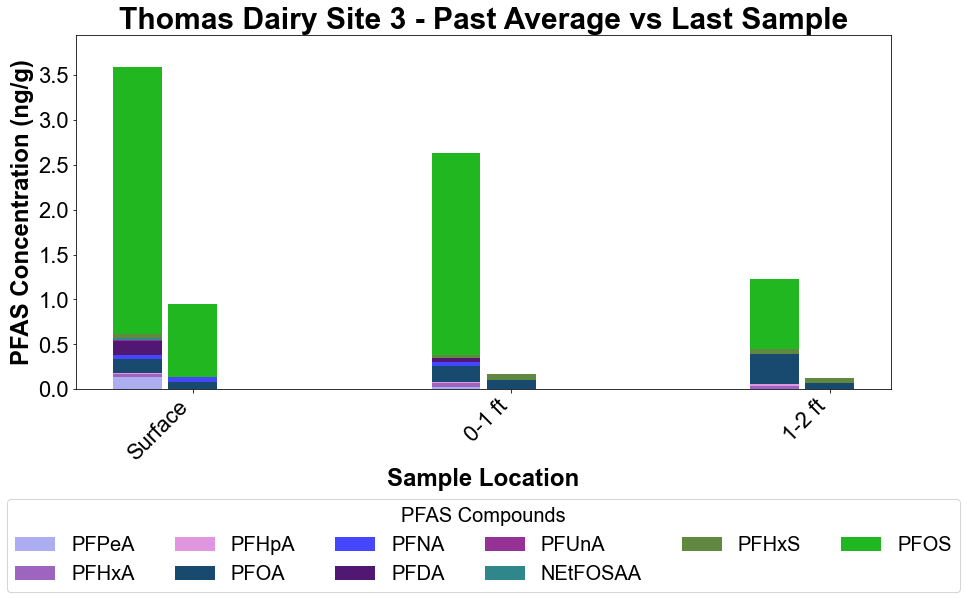

In [ ]:
create_seasonal_stacked_bar_chart(season_1_data=avg_pivot_table_past,season_2_data=avg_pivot_table_new, figsize=(14,10), compound_colors_dict=compound_colors_dict_abbrev,
                                   title_fontsize=30, axis_label_fontsize=24, tick_label_fontsize=22, legend_fontsize=20, bar_width=0.5,
                                   title='Thomas Dairy Site 3 - Past Average vs Last Sample',rows_order=['Surface', '0-1 ft','1-2 ft'])

### Enrichment Factors

#### Functions

In [ ]:
def create_pivot_table(data_df, qual_summary_filter=None, field_filter=None, type_filter=None, sample_location_filter=None,
                       start_date=None, end_date=None, pfas_compound_filter=None, column_name='Quant Incl Estimates Incl Qual Flags'):
    """
    Create a pivot table from a dataframe with optional filtering and averaging specified values.

    Args:
    data_df (pd.DataFrame): Input dataframe.
    qual_summary_filter (list, optional): Quality summary filter values.
    field_filter (list, optional): Field filter values.
    type_filter (list, optional): Type filter values.
    sample_location_filter (list, optional): Sample location filter values.
    start_date (str, optional): Start date for filtering 'Sample Date' in format 'yyyy-mm-dd'.
    end_date (str, optional): End date for filtering 'Sample Date' in format 'yyyy-mm-dd'.
    pfas_compound_filter (list, optional): PFAS compound filter values.
    column_name (str): Column name to average for pivot table values.

    Returns:
    pd.DataFrame: Pivot table based on filters and averaging specified column.
    """
    # Convert 'Sample Date' to datetime format if not already done
    if 'Sample Date' in data_df.columns:
        data_df['Sample Date'] = pd.to_datetime(data_df['Sample Date'])
    
    # Apply filters based on provided lists
    filtered_data = data_df
    if qual_summary_filter is not None:
        filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(qual_summary_filter)]
    if field_filter is not None:
        filtered_data = filtered_data[filtered_data['Field'].isin(field_filter)]
    if type_filter is not None:
        filtered_data = filtered_data[filtered_data['Type'].isin(type_filter)]
    if sample_location_filter is not None:
        filtered_data = filtered_data[filtered_data['Sample Location'].isin(sample_location_filter)]
    if pfas_compound_filter is not None:
        filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(pfas_compound_filter)]
    if start_date and end_date:  # Apply date range filter if both start and end dates are provided
        filtered_data = filtered_data[
            (filtered_data['Sample Date'] >= start_date) & (filtered_data['Sample Date'] <= end_date)
        ]

    # Create the pivot table
    pivot_table = pd.pivot_table(
        filtered_data,
        values=column_name,
        index=['PFAS Compound'],
        columns=['Sample Location', 'Sample Date'],
        aggfunc='mean'
    )
    
    return pivot_table

In [ ]:
def calculate_enrichment_factors_by_index(surface_df, depth_df):
    # Initialize an empty DataFrame for enrichment factors with the same index and columns as surface_df
    enrichment_factors = pd.DataFrame(index=surface_df.index, columns=surface_df.columns)

    # Calculate enrichment factors where possible using column index
    for compound in surface_df.index:
        for i, col in enumerate(surface_df.columns):
            surface_concentration = surface_df.iloc[surface_df.index.get_loc(compound), i]
            depth_concentration = depth_df.iloc[depth_df.index.get_loc(compound), i]

            # Calculate enrichment factor only if both concentrations are non-zero
            if surface_concentration > 0 and depth_concentration > 0:
                enrichment_factor = depth_concentration / surface_concentration
                enrichment_factors.iloc[enrichment_factors.index.get_loc(compound), i] = enrichment_factor
            else:
                enrichment_factors.iloc[enrichment_factors.index.get_loc(compound), i] = np.nan  # or np.nan

    return enrichment_factors


#### Filters and Settings

In [ ]:
#qual_summary_filter (list): Filter values for 'Qual Summary (Grade for filtering)'.
qual_summary_filter = ['Good', 'Probably Ok', 'Probably ok']

#field_filter (list): Filter values for 'Field'.
field_filter=None

#type_filter (list): Filter values for 'Type'.
type_filter=['Soils']

#sample_location_filter (list): Filter values for 'Sample Location'.
sample_location_filter= ['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2',
                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 0',
                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
                          'Thomas Dairy Site 3 Soil - 2']
#soil surface
sample_location_filter= ['Thomas Dairy Control Site Soil - 0','Thomas Dairy Site 1 Soil - 0','Thomas Dairy Site 2 Soil - 0','Thomas Dairy Site 3 Soil - 0']

#start_date (str): Start date for filtering 'Sample Date'.
start_date = '2023-01-01'
#end_date (str): End date for filtering 'Sample Date'.
end_date = '2024-12-30'

#pfas_compound_filter (list): Filter values for 'PFAS Compound'.
pfas_compound_filter=['NEtFOSAA',
 'Perfluorobutanesulfonic acid',
 'Perfluorobutanoic acid',
 'Perfluorodecanesulfonic acid',
 'Perfluorodecanoic acid',
 'Perfluorododecanoic acid',
 'Perfluoroheptanesulfonic acid',
 'Perfluoroheptanoic acid',
 'Perfluorohexanesulfonic acid',
 'Perfluorohexanoic acid',
 'Perfluorononanoic acid',
 'Perfluorooctanesulfonic acid (PFOS)',
 'Perfluorooctanoic acid (PFOA)',
 'Perfluoropentanoic acid',
 'Perfluoroundecanoic acid']

#column_name (str): The column name to average values for.
column_name= 'Quant Incl Estimates Incl Qual Flags'

#### Tables for Different Depths

In [ ]:
#soil surface
sample_location_filter= ['Thomas Dairy Control Site Soil - 0','Thomas Dairy Site 1 Soil - 0','Thomas Dairy Site 2 Soil - 0','Thomas Dairy Site 3 Soil - 0']

pivot_table_Surface=create_pivot_table(data_df, qual_summary_filter, field_filter, type_filter, sample_location_filter,
                                       start_date, end_date, pfas_compound_filter, column_name)

desired_order = df['Database'].tolist()  # Convert to list if not already
filtered_order = [comp for comp in desired_order if comp in pivot_table_Surface.index]
# Reorder columns by indexing df with the desired order
pivot_table_Surface = pivot_table_Surface.loc[filtered_order]

pivot_table_Surface.index=pivot_table_Surface.index.map(pfas_mapping)
pivot_table_Surface.loc['Total PFAS'] = pivot_table_Surface.sum()
pivot_table_Surface

Sample Location Thomas Dairy Control Site Soil - 0                        \
Sample Date                             2023-07-14 2023-09-08 2023-10-06   
PFAS Compound                                                              
PFBA                                          0.00        0.0       0.00   
PFPeA                                         0.00        0.0       0.49   
PFHxA                                         0.00        0.0       0.00   
PFHpA                                         0.00        0.0       0.00   
PFOA                                          0.71        0.0       0.00   
PFNA                                          0.00        0.0       0.00   
PFDA                                          0.00        0.0       0.00   
PFUnA                                         0.00        0.0       0.00   
PFDoA                                         0.00        0.0       0.00   
NEtFOSAA                                      0.00        0.0       0.00   
PFBS                                          0.00        0.0       0.00   
PFHxS                                         0.00        0.0       0.00   
PFHpS                                         0.00        0.0       0.00   
PFOS                                          1.70        2.7       2.40   
PFDS                                          0.00        0.0       0.00   
Total PFAS                                    2.41        2.7       2.89   

Sample Location                       Thomas Dairy Site 1 Soil - 0             \
Sample Date     2024-04-23 2024-05-31                   2023-07-14 2023-09-08   
PFAS Compound                                                                   
PFBA                 0.230      0.520                          0.0       0.00   
PFPeA                0.140      1.000                          0.0       0.30   
PFHxA                0.120      0.680                          0.0       0.00   
PFHpA                0.094      0.390                          0.0       0.00   
PFOA                 0.180      0.230                          0.0       0.34   
PFNA                 0.170      0.160                          0.0       0.00   
PFDA                 0.130      0.073                          0.0       0.00   
PFUnA                0.000      0.000                          0.0       0.00   
PFDoA                0.000      0.000                          0.0       0.00   
NEtFOSAA             0.000      0.000                          0.0       0.00   
PFBS                 0.000      0.000                          0.0       0.00   
PFHxS                0.000      0.000                          0.0       0.00   
PFHpS                0.000      0.000                          0.0       0.00   
PFOS                 3.000      1.800                          2.4       3.00   
PFDS                 0.000      0.000                          0.0       0.00   
Total PFAS           4.064      4.853                          2.4       3.64   

Sample Location                                  Thomas Dairy Site 2 Soil - 0  \
Sample Date     2023-10-06 2024-04-23 2024-05-31                   2023-07-14   
PFAS Compound                                                                   
PFBA                   0.0      0.120       0.11                         0.00   
PFPeA                  0.0      0.140       0.13                         0.00   
PFHxA                  0.0      0.093       0.11                         0.00   
PFHpA                  0.0      0.000       0.00                         0.00   
PFOA                   0.0      0.150       0.27                         0.29   
PFNA                   0.0      0.110       0.20                         0.00   
PFDA                   0.0      0.130       0.13                         0.33   
PFUnA                  0.0      0.000       0.00                         0.00   
PFDoA                  0.0      0.000       0.00                         0.00   
NEtFOSAA               0.0      0.000      

In [ ]:
#soil surface
sample_location_filter= ['Thomas Dairy Control Site Soil - 1','Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 3 Soil - 1']

pivot_table_1ft=create_pivot_table(data_df, qual_summary_filter, field_filter, type_filter, sample_location_filter,
                                       start_date, end_date, pfas_compound_filter, column_name)

desired_order = df['Database'].tolist()  # Convert to list if not already
filtered_order = [comp for comp in desired_order if comp in pivot_table_1ft.index]
# Reorder columns by indexing df with the desired order
pivot_table_1ft = pivot_table_1ft.loc[filtered_order]

pivot_table_1ft.index=pivot_table_1ft.index.map(pfas_mapping)
pivot_table_1ft.loc['Total PFAS'] = pivot_table_1ft.sum()
pivot_table_1ft

Sample Location Thomas Dairy Control Site Soil - 1                        \
Sample Date                             2023-07-14 2023-09-08 2023-10-06   
PFAS Compound                                                              
PFBA                                          0.00        0.0       0.00   
PFPeA                                         0.00        0.0       1.70   
PFHxA                                         0.00        0.0       0.59   
PFHpA                                         0.00        0.0       0.56   
PFOA                                          0.32        0.3       0.31   
PFNA                                          0.00        0.0       0.00   
PFDA                                          0.00        0.0       0.00   
PFUnA                                         0.00        0.0       0.00   
PFDoA                                         0.00        0.0       0.00   
NEtFOSAA                                      0.00        0.0       0.00   
PFBS                                          0.00        0.0       0.00   
PFHxS                                         0.00        0.0       0.00   
PFHpS                                         0.00        0.0       0.00   
PFOS                                          3.10        1.2       1.30   
PFDS                                          0.00        0.0       0.00   
Total PFAS                                    3.42        1.5       4.46   

Sample Location                       Thomas Dairy Site 1 Soil - 1             \
Sample Date     2024-04-23 2024-05-31                   2023-07-14 2023-09-08   
PFAS Compound                                                                   
PFBA                 0.180      0.180                         0.00        0.0   
PFPeA                0.110      0.250                         0.00        0.0   
PFHxA                0.120      0.410                         0.00        0.0   
PFHpA                0.074      0.330                         0.00        0.0   
PFOA                 0.330      0.610                         0.29        0.4   
PFNA                 0.130      0.130                         0.00        0.0   
PFDA                 0.000      0.000                         0.00        0.0   
PFUnA                0.000      0.000                         0.00        0.0   
PFDoA                0.000      0.000                         0.00        0.0   
NEtFOSAA             0.000      0.000                         0.00        0.0   
PFBS                 0.000      0.000                         0.00        0.0   
PFHxS                0.000      0.052                         0.00        0.0   
PFHpS                0.000      0.000                         0.00        0.0   
PFOS                 1.400      1.400                         1.60        1.2   
PFDS                 0.000      0.000                         0.00        0.0   
Total PFAS           2.344      3.362                         1.89        1.6   

Sample Location                                  Thomas Dairy Site 2 Soil - 1  \
Sample Date     2023-10-06 2024-04-23 2024-05-31                   2023-07-14   
PFAS Compound                                                                   
PFBA                  0.00      0.000      0.110                         0.00   
PFPeA                 0.00      0.000      0.099                         0.00   
PFHxA                 0.00      0.066      0.000                         0.00   
PFHpA                 0.00      0.066      0.000                         0.00   
PFOA                  0.37      0.270      0.250                         0.75   
PFNA                  0.00      0.000      0.100                         0.00   
PFDA                  0.00      0.000      0.000                         0.00   
PFUnA                 0.00      0.000      0.000                         0.00   
PFDoA                 0.00      0.000      0.000                         0.00   
NEtFOSAA              0.00      0.000      

In [ ]:
#soil surface
sample_location_filter= ['Thomas Dairy Control Site Soil - 2','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 2']

pivot_table_2ft=create_pivot_table(data_df, qual_summary_filter, field_filter, type_filter, sample_location_filter,
                                       start_date, end_date, pfas_compound_filter, column_name)

desired_order = df['Database'].tolist()  # Convert to list if not already
filtered_order = [comp for comp in desired_order if comp in pivot_table_2ft.index]
# Reorder columns by indexing df with the desired order
pivot_table_2ft = pivot_table_2ft.loc[filtered_order]

pivot_table_2ft.index=pivot_table_2ft.index.map(pfas_mapping)
pivot_table_2ft.loc['Total PFAS'] = pivot_table_2ft.sum()
pivot_table_2ft

Sample Location Thomas Dairy Control Site Soil - 2                        \
Sample Date                             2023-07-14 2023-09-08 2023-10-06   
PFAS Compound                                                              
PFBA                                          0.00       0.00       0.00   
PFPeA                                         0.21       0.00       2.00   
PFHxA                                         0.00       0.00       0.95   
PFHpA                                         0.00       0.00       0.63   
PFOA                                          0.00       0.38       0.34   
PFNA                                          0.21       0.00       0.00   
PFDA                                          0.25       0.00       0.00   
PFUnA                                         0.00       0.00       0.00   
PFDoA                                         0.00       0.00       0.00   
NEtFOSAA                                      0.00       0.00       0.00   
PFBS                                          0.00       0.00       0.00   
PFHxS                                         0.00       0.00       0.00   
PFHpS                                         0.00       0.00       0.00   
PFOS                                          4.40       0.69       1.20   
PFDS                                          0.00       0.00       0.00   
Total PFAS                                    5.07       1.07       5.12   

Sample Location                       Thomas Dairy Site 1 Soil - 2             \
Sample Date     2024-04-23 2024-05-31                   2023-07-14 2023-09-08   
PFAS Compound                                                                   
PFBA                 0.000      0.000                         0.00       0.00   
PFPeA                0.000      0.000                         0.00       0.00   
PFHxA                0.081      0.150                         0.00       0.00   
PFHpA                0.000      0.110                         0.00       0.00   
PFOA                 0.390      0.420                         0.41       0.28   
PFNA                 0.069      0.057                         0.00       0.00   
PFDA                 0.000      0.000                         0.00       0.00   
PFUnA                0.000      0.000                         0.00       0.00   
PFDoA                0.000      0.000                         0.00       0.00   
NEtFOSAA             0.000      0.000                         0.00       0.00   
PFBS                 0.000      0.000                         0.00       0.00   
PFHxS                0.060      0.000                         0.00       0.00   
PFHpS                0.000      0.000                         0.00       0.00   
PFOS                 0.990      0.610                         1.40       0.00   
PFDS                 0.000      0.000                         0.00       0.00   
Total PFAS           1.590      1.347                         1.81       0.28   

Sample Location                                  Thomas Dairy Site 2 Soil - 2  \
Sample Date     2023-10-06 2024-04-23 2024-05-31                   2023-07-14   
PFAS Compound                                                                   
PFBA                  0.00      0.000      0.110                         0.00   
PFPeA                 0.00      0.000      0.000                         0.00   
PFHxA                 0.00      0.099      0.092                         0.00   
PFHpA                 0.00      0.000      0.000                         0.00   
PFOA                  0.47      0.240      0.370                         0.51   
PFNA                  0.00      0.000      0.060                         0.00   
PFDA                  0.00      0.000      0.000                         0.00   
PFUnA                 0.00      0.000      0.000                         0.00   
PFDoA                 0.00      0.000      0.000                         0.00   
NEtFOSAA              0.00      0.000      

### Enrichment Factors Surface to 0-1 ft

In [ ]:
EF_1toSurface = calculate_enrichment_factors_by_index(surface_df=pivot_table_Surface, depth_df=pivot_table_1ft)

# Dictionary to map old column names to new ones
rename_dict = {
    'Thomas Dairy Control Site Soil - 0': 'TD Control',
    'Thomas Dairy Site 1 Soil - 0': 'TD Site 1',
    'Thomas Dairy Site 2 Soil - 0': 'TD Site 2',
    'Thomas Dairy Site 3 Soil - 0': 'TD Site 3'
}

# Map the renaming dictionary to the top level of the columns
new_levels = EF_1toSurface.columns.levels[0].map(lambda x: rename_dict.get(x, x))

# Set the modified levels back without changing other levels
EF_1toSurface.columns.set_levels(new_levels, level=0, inplace=True)

EF_1toSurface



<ipython-input-90-598debf93285>:15: FutureWarning: inplace is deprecated and will be removed in a future version.
  EF_1toSurface.columns.set_levels(new_levels, level=0, inplace=True)


Sample Location TD Control                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN   0.782609   0.346154   
PFPeA                  NaN        NaN   3.469388   0.785714       0.25   
PFHxA                  NaN        NaN        NaN        1.0   0.602941   
PFHpA                  NaN        NaN        NaN   0.787234   0.846154   
PFOA              0.450704        NaN        NaN   1.833333   2.652174   
PFNA                   NaN        NaN        NaN   0.764706     0.8125   
PFDA                   NaN        NaN        NaN        NaN        NaN   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN        NaN        NaN   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PFOS              1.823529   0.444444   0.541667   0.466667   0.777778   
PFDS                   NaN        NaN        NaN        NaN        NaN   
Total PFAS        1.419087   0.555556   1.543253   0.576772   0.692767   

Sample Location  TD Site 1                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN        NaN        1.0   
PFPeA                  NaN        NaN        NaN        NaN   0.761538   
PFHxA                  NaN        NaN        NaN   0.709677        NaN   
PFHpA                  NaN        NaN        NaN        NaN        NaN   
PFOA                   NaN   1.176471        NaN        1.8   0.925926   
PFNA                   NaN        NaN        NaN        NaN        0.5   
PFDA                   NaN        NaN        NaN        NaN        NaN   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN        NaN        NaN   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PFOS              0.666667        0.4   0.954545      0.315   0.391304   
PFDS                   NaN        NaN        NaN        NaN        NaN   
Total PFAS          0.7875    0.43956   1.122727    0.39774   0.448923   

Sample Location  TD Site 2                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN        NaN        NaN   
PFPeA                  NaN        NaN        NaN        NaN        NaN   
PFHxA                  NaN        NaN        NaN   0.730769        NaN   
PFHpA                  NaN        NaN        NaN   0.576923        NaN   
PFOA              2.586207   0.652174        NaN      1.125   1.947368   
PFNA                   NaN        NaN        NaN   0.160606        1.0   
PFDA                   NaN        NaN        NaN        NaN    0.40625   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN   1.181818   0.989899   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PF

In [ ]:
# Assuming EF_1toSurface is your DataFrame and 'TD Control', 'TD Site 1', 'TD Site 2', 'TD Site 3' are your columns
# Calculate enrichment factors for each site
EF_Site1 = EF_1toSurface['TD Site 1'] / EF_1toSurface['TD Control']
EF_Site2 = EF_1toSurface['TD Site 2'] / EF_1toSurface['TD Control']
EF_Site3 = EF_1toSurface['TD Site 3'] / EF_1toSurface['TD Control']

# Combine into a single DataFrame with MultiIndex columns
enrichment_factors_combined = pd.concat({
    'TD Site 1': EF_Site1,
    'TD Site 2': EF_Site2,
    'TD Site 3': EF_Site3
}, axis=1)

# Optionally, if you need to reset the index for any reason:
# enrichment_factors_combined.columns = pd.MultiIndex.from_product([['TD Site 1', 'TD Site 2', 'TD Site 3'], EF_1toSurface.columns])
enrichment_factors_combined


TD Site 1                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN   2.888889   
PFPeA                NaN        NaN        NaN        NaN   3.046154   
PFHxA                NaN        NaN        NaN   0.709677        NaN   
PFHpA                NaN        NaN        NaN        NaN        NaN   
PFOA                 NaN        NaN        NaN   0.981818    0.34912   
PFNA                 NaN        NaN        NaN        NaN   0.615385   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            0.365591        0.9   1.762238      0.675   0.503106   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      0.554934   0.791209   0.727507   0.689596   0.648014   

               TD Site 2                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN        NaN   
PFPeA                NaN        NaN        NaN        NaN        NaN   
PFHxA                NaN        NaN        NaN   0.730769        NaN   
PFHpA                NaN        NaN        NaN   0.732848        NaN   
PFOA            5.738147        NaN        NaN   0.613636   0.734254   
PFNA                 NaN        NaN        NaN   0.210023   1.230769   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            0.126551   0.120536   0.440559   0.178571   0.668571   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      0.222686   0.134412   0.174019   0.271452   0.960279   

               TD Site 3                                              
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31  
PFAS Compound                                                         
PFBA                 NaN        NaN        NaN        NaN        NaN  
PFPeA                NaN        NaN        NaN        NaN        NaN  
PFHxA                NaN        NaN        NaN   0.933333        NaN  
PFHpA                NaN        NaN        NaN   1.837355        NaN  
PFOA                 NaN        NaN        NaN    0.61157   0.438429  
PFNA                 NaN        NaN        NaN    1.17004        NaN  
PFDA                 NaN        NaN        NaN        NaN        NaN  
PFUnA                NaN        NaN        NaN        NaN        NaN  
PFDoA                NaN        NaN        NaN        NaN        NaN  
NEtFOSAA             NaN        NaN        NaN        NaN        NaN  
PFBS                 NaN        NaN        NaN        NaN        NaN  
PFHxS                NaN        NaN        NaN        NaN        NaN  
PFHpS                NaN        NaN        NaN        NaN        NaN  
PFOS            0.356452    1.52027   1.846154   1.479592        NaN  
PFDS                 NaN        NaN        NaN        NaN        NaN  

### Enrichment Factors Surface to 1-2 ft

In [ ]:
EF_2toSurface = calculate_enrichment_factors_by_index(surface_df=pivot_table_Surface, depth_df=pivot_table_2ft)

# Dictionary to map old column names to new ones
rename_dict = {
    'Thomas Dairy Control Site Soil - 0': 'TD Control',
    'Thomas Dairy Site 1 Soil - 0': 'TD Site 1',
    'Thomas Dairy Site 2 Soil - 0': 'TD Site 2',
    'Thomas Dairy Site 3 Soil - 0': 'TD Site 3'
}

# Map the renaming dictionary to the top level of the columns
new_levels = EF_2toSurface.columns.levels[0].map(lambda x: rename_dict.get(x, x))

# Set the modified levels back without changing other levels
EF_2toSurface.columns.set_levels(new_levels, level=0, inplace=True)

EF_2toSurface

<ipython-input-92-5468b3363139>:15: FutureWarning: inplace is deprecated and will be removed in a future version.
  EF_2toSurface.columns.set_levels(new_levels, level=0, inplace=True)


Sample Location TD Control                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN        NaN        NaN   
PFPeA                  NaN        NaN   4.081633        NaN        NaN   
PFHxA                  NaN        NaN        NaN      0.675   0.220588   
PFHpA                  NaN        NaN        NaN        NaN   0.282051   
PFOA                   NaN        NaN        NaN   2.166667   1.826087   
PFNA                   NaN        NaN        NaN   0.405882    0.35625   
PFDA                   NaN        NaN        NaN        NaN        NaN   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN        NaN        NaN   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PFOS              2.588235   0.255556        0.5       0.33   0.338889   
PFDS                   NaN        NaN        NaN        NaN        NaN   
Total PFAS        2.103734   0.396296   1.771626    0.39124    0.27756   

Sample Location  TD Site 1                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN        NaN        1.0   
PFPeA                  NaN        NaN        NaN        NaN        NaN   
PFHxA                  NaN        NaN        NaN   1.064516   0.836364   
PFHpA                  NaN        NaN        NaN        NaN        NaN   
PFOA                   NaN   0.823529        NaN        1.6    1.37037   
PFNA                   NaN        NaN        NaN        NaN        0.3   
PFDA                   NaN        NaN        NaN        NaN        NaN   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN        NaN        NaN   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PFOS              0.583333        NaN   0.368182       0.13   0.252174   
PFDS                   NaN        NaN        NaN        NaN        NaN   
Total PFAS        0.754167   0.076923   0.581818   0.273059   0.394769   

Sample Location  TD Site 2                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN        NaN        NaN   
PFPeA                  NaN        NaN        NaN        NaN        NaN   
PFHxA                  NaN        NaN        NaN   0.226923        NaN   
PFHpA                  NaN        NaN        NaN        NaN        NaN   
PFOA              1.758621        NaN        NaN   0.321429        2.0   
PFNA                   NaN        NaN        NaN        NaN        1.0   
PFDA                   NaN        NaN        NaN        NaN    0.50625   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN   0.787879   1.212121   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PF

In [ ]:
# Assuming EF_1toSurface is your DataFrame and 'TD Control', 'TD Site 1', 'TD Site 2', 'TD Site 3' are your columns
# Calculate enrichment factors for each site
EF_Site1 = EF_2toSurface['TD Site 1'] / EF_2toSurface['TD Control']
EF_Site2 = EF_2toSurface['TD Site 2'] / EF_2toSurface['TD Control']
EF_Site3 = EF_2toSurface['TD Site 3'] / EF_2toSurface['TD Control']

# Combine into a single DataFrame with MultiIndex columns
enrichment_factors_combined_2 = pd.concat({
    'TD Site 1': EF_Site1,
    'TD Site 2': EF_Site2,
    'TD Site 3': EF_Site3
}, axis=1)

# Optionally, if you need to reset the index for any reason:
# enrichment_factors_combined.columns = pd.MultiIndex.from_product([['TD Site 1', 'TD Site 2', 'TD Site 3'], EF_1toSurface.columns])
enrichment_factors_combined_2

TD Site 1                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN        NaN   
PFPeA                NaN        NaN        NaN        NaN        NaN   
PFHxA                NaN        NaN        NaN   1.577061   3.791515   
PFHpA                NaN        NaN        NaN        NaN        NaN   
PFOA                 NaN        NaN        NaN   0.738462   0.750441   
PFNA                 NaN        NaN        NaN        NaN   0.842105   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            0.225379        NaN   0.736364   0.393939    0.74412   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      0.358489   0.194105   0.328409   0.697931   1.422283   

               TD Site 2                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN        NaN   
PFPeA                NaN        NaN        NaN        NaN        NaN   
PFHxA                NaN        NaN        NaN   0.336182        NaN   
PFHpA                NaN        NaN        NaN        NaN        NaN   
PFOA                 NaN        NaN        NaN   0.148352   1.095238   
PFNA                 NaN        NaN        NaN        NaN   2.807018   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            0.049336   0.075466        NaN   0.035354   1.652459   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      0.106152   0.042396        NaN   0.109373   2.592288   

               TD Site 3                                              
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31  
PFAS Compound                                                         
PFBA                 NaN        NaN        NaN        NaN        NaN  
PFPeA                NaN        NaN        NaN        NaN        NaN  
PFHxA                NaN        NaN        NaN   1.481481        NaN  
PFHpA                NaN        NaN        NaN        NaN        NaN  
PFOA                 NaN        NaN        NaN   0.559441   0.452104  
PFNA                 NaN        NaN        NaN        NaN        NaN  
PFDA                 NaN        NaN        NaN        NaN        NaN  
PFUnA                NaN        NaN        NaN        NaN        NaN  
PFDoA                NaN        NaN        NaN        NaN        NaN  
NEtFOSAA             NaN        NaN        NaN        NaN        NaN  
PFBS                 NaN        NaN        NaN        NaN        NaN  
PFHxS                NaN        NaN        NaN        NaN        NaN  
PFHpS                NaN        NaN        NaN        NaN        NaN  
PFOS            0.148106   0.623972        1.0   0.468975        NaN  
PFDS                 NaN        NaN        NaN        NaN        NaN  

### Enrichment Factors 

### Plot Enrichment Factors

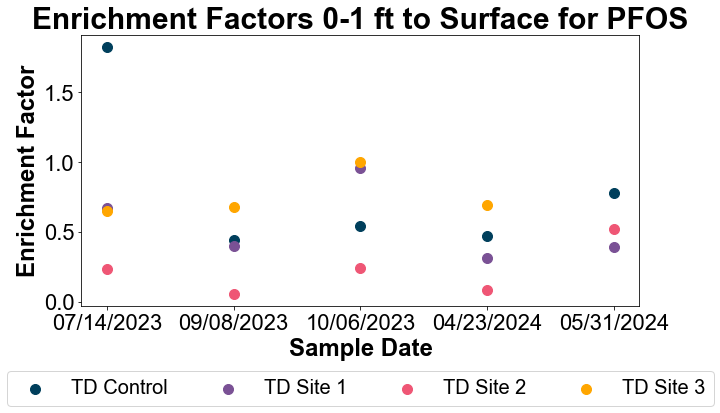

In [ ]:
# Assuming enrichment_factors is your DataFrame
enrichment_factors = EF_1toSurface

# Filter for 'PFOS' compound data
pfos_data = enrichment_factors.loc['PFOS']

# Create the scatter plot
fig, ax = plt.subplots(figsize=(10, 5))
color_map = {}  # To store colors for each location
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']  # Original color scheme
label_added = set()  # To track labels added to the legend

# Collect unique sample dates and sort them
unique_dates = sorted({pd.to_datetime(date) for _, date in pfos_data.index})
date_mapping = {date: i for i, date in enumerate(unique_dates)}  # Map dates to sequential integers

for ((sample_location, sample_date), value) in pfos_data.items():
    if pd.notna(value):
        simple_location = sample_location
        if simple_location not in color_map:
            color_map[simple_location] = colors[len(color_map) % len(colors)]  # Assign colors in a cycle
        
        # Plot using mapped date index to ensure they appear sequentially
        date_index = date_mapping[pd.to_datetime(sample_date)]
        ax.scatter(date_index, value, color=color_map[simple_location],s=100, label=simple_location if simple_location not in label_added else "")
        label_added.add(simple_location)

# Set custom x-ticks
ax.set_xticks(list(date_mapping.values()))  # Set x-ticks at each integer index
ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in unique_dates], rotation=0)  # Label them with corresponding dates

ax.set_title('Enrichment Factors 0-1 ft to Surface for PFOS')
ax.set_xlabel('Sample Date')
ax.set_ylabel('Enrichment Factor')
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),  ncol=4)
plt.setp(legend.get_title(), fontweight='bold')

plt.show()


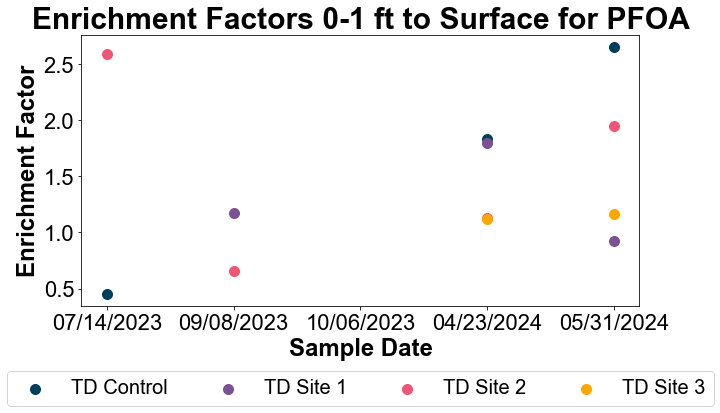

In [ ]:
# Assuming enrichment_factors is your DataFrame
enrichment_factors = EF_1toSurface

# Filter for 'PFOS' compound data
pfos_data = enrichment_factors.loc['PFOA']

# Create the scatter plot
fig, ax = plt.subplots(figsize=(10, 5))
color_map = {}  # To store colors for each location
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']  # Original color scheme
label_added = set()  # To track labels added to the legend

# Collect unique sample dates and sort them
unique_dates = sorted({pd.to_datetime(date) for _, date in pfos_data.index})
date_mapping = {date: i for i, date in enumerate(unique_dates)}  # Map dates to sequential integers

for ((sample_location, sample_date), value) in pfos_data.items():
    if pd.notna(value):
        simple_location = sample_location
        if simple_location not in color_map:
            color_map[simple_location] = colors[len(color_map) % len(colors)]  # Assign colors in a cycle
        
        # Plot using mapped date index to ensure they appear sequentially
        date_index = date_mapping[pd.to_datetime(sample_date)]
        ax.scatter(date_index, value, color=color_map[simple_location],s=100, label=simple_location if simple_location not in label_added else "")
        label_added.add(simple_location)

# Set custom x-ticks
ax.set_xticks(list(date_mapping.values()))  # Set x-ticks at each integer index
ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in unique_dates], rotation=0)  # Label them with corresponding dates

ax.set_title('Enrichment Factors 0-1 ft to Surface for PFOA')
ax.set_xlabel('Sample Date')
ax.set_ylabel('Enrichment Factor')
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),  ncol=4)
plt.setp(legend.get_title(), fontweight='bold')

plt.show()


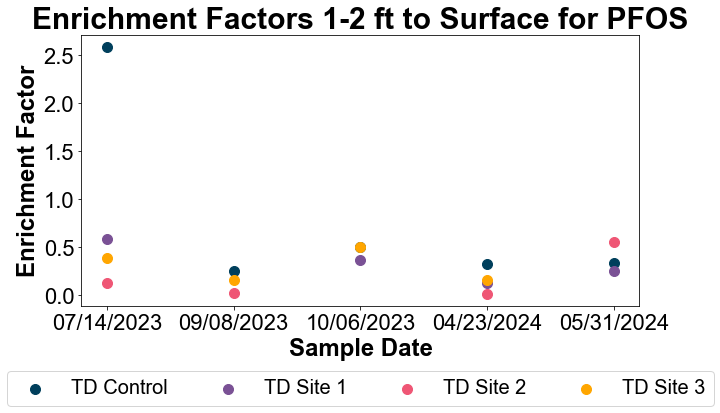

In [ ]:
# Assuming enrichment_factors is your DataFrame
enrichment_factors = EF_2toSurface

# Filter for 'PFOS' compound data
pfos_data = enrichment_factors.loc['PFOS']

# Create the scatter plot
fig, ax = plt.subplots(figsize=(10, 5))
color_map = {}  # To store colors for each location
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']  # Original color scheme
label_added = set()  # To track labels added to the legend

# Collect unique sample dates and sort them
unique_dates = sorted({pd.to_datetime(date) for _, date in pfos_data.index})
date_mapping = {date: i for i, date in enumerate(unique_dates)}  # Map dates to sequential integers

for ((sample_location, sample_date), value) in pfos_data.items():
    if pd.notna(value):
        simple_location = sample_location
        if simple_location not in color_map:
            color_map[simple_location] = colors[len(color_map) % len(colors)]  # Assign colors in a cycle
        
        # Plot using mapped date index to ensure they appear sequentially
        date_index = date_mapping[pd.to_datetime(sample_date)]
        ax.scatter(date_index, value, color=color_map[simple_location],s=100, label=simple_location if simple_location not in label_added else "")
        label_added.add(simple_location)

# Set custom x-ticks
ax.set_xticks(list(date_mapping.values()))  # Set x-ticks at each integer index
ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in unique_dates], rotation=0)  # Label them with corresponding dates

ax.set_title('Enrichment Factors 1-2 ft to Surface for PFOS')
ax.set_xlabel('Sample Date')
ax.set_ylabel('Enrichment Factor')
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),  ncol=4)
plt.setp(legend.get_title(), fontweight='bold')

plt.show()

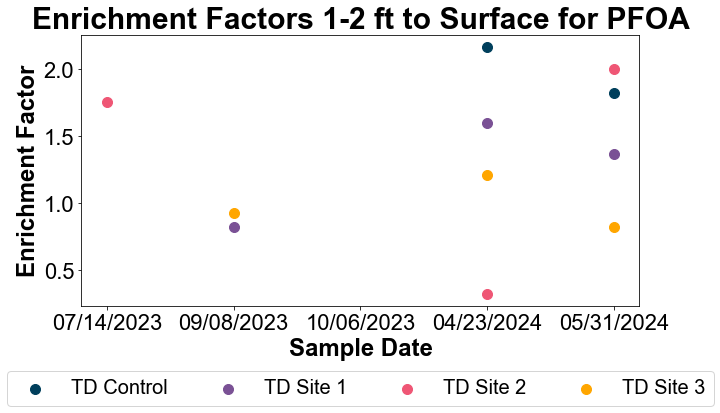

In [ ]:
# Assuming enrichment_factors is your DataFrame
enrichment_factors = EF_2toSurface

# Filter for 'PFOS' compound data
pfos_data = enrichment_factors.loc['PFOA']

# Create the scatter plot
fig, ax = plt.subplots(figsize=(10, 5))
color_map = {}  # To store colors for each location
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']  # Original color scheme
label_added = set()  # To track labels added to the legend

# Collect unique sample dates and sort them
unique_dates = sorted({pd.to_datetime(date) for _, date in pfos_data.index})
date_mapping = {date: i for i, date in enumerate(unique_dates)}  # Map dates to sequential integers

for ((sample_location, sample_date), value) in pfos_data.items():
    if pd.notna(value):
        simple_location = sample_location
        if simple_location not in color_map:
            color_map[simple_location] = colors[len(color_map) % len(colors)]  # Assign colors in a cycle
        
        # Plot using mapped date index to ensure they appear sequentially
        date_index = date_mapping[pd.to_datetime(sample_date)]
        ax.scatter(date_index, value, color=color_map[simple_location],s=100, label=simple_location if simple_location not in label_added else "")
        label_added.add(simple_location)

# Set custom x-ticks
ax.set_xticks(list(date_mapping.values()))  # Set x-ticks at each integer index
ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in unique_dates], rotation=0)  # Label them with corresponding dates

ax.set_title('Enrichment Factors 1-2 ft to Surface for PFOA')
ax.set_xlabel('Sample Date')
ax.set_ylabel('Enrichment Factor')
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),  ncol=4)
plt.setp(legend.get_title(), fontweight='bold')

plt.show()

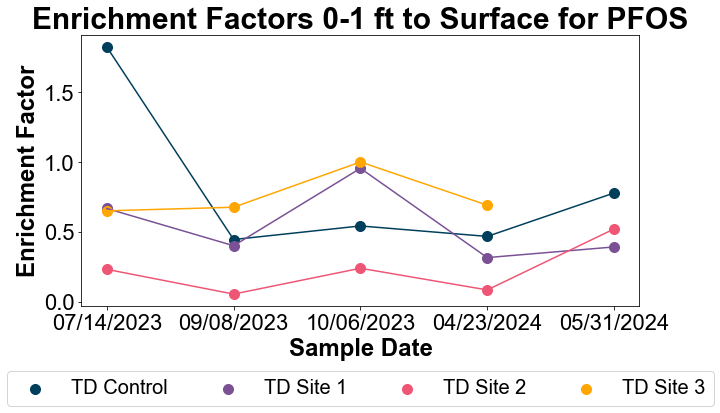

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming enrichment_factors is your DataFrame
enrichment_factors = EF_1toSurface

# Filter for 'PFOS' compound data
pfos_data = enrichment_factors.loc['PFOS']

# Create the scatter plot
fig, ax = plt.subplots(figsize=(10, 5))
color_map = {}  # To store colors for each location
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']  # Original color scheme
label_added = set()  # To track labels added to the legend

# Collect unique sample dates and sort them
unique_dates = sorted({pd.to_datetime(date) for _, date in pfos_data.index})
date_mapping = {date: i for i, date in enumerate(unique_dates)}  # Map dates to sequential integers

# Prepare data for line plotting by location
line_data = {}

for ((sample_location, sample_date), value) in pfos_data.items():
    if pd.notna(value):
        simple_location = sample_location
        if simple_location not in color_map:
            color_map[simple_location] = colors[len(color_map) % len(colors)]  # Assign colors in a cycle
        
        date_index = date_mapping[pd.to_datetime(sample_date)]
        
        # Collect data for line plotting
        if simple_location not in line_data:
            line_data[simple_location] = {'x': [], 'y': []}
        line_data[simple_location]['x'].append(date_index)
        line_data[simple_location]['y'].append(value)

        # Plot scatter
        ax.scatter(date_index, value, color=color_map[simple_location], s=100, label=simple_location if simple_location not in label_added else "")
        label_added.add(simple_location)

# Plot lines
for location, data in line_data.items():
    ax.plot(data['x'], data['y'], color=color_map[location], label=f'Line for {location}' if location not in label_added else "")

# Set custom x-ticks
ax.set_xticks(list(date_mapping.values()))  # Set x-ticks at each integer index
ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in unique_dates], rotation=0)  # Label them with corresponding dates

ax.set_title('Enrichment Factors 0-1 ft to Surface for PFOS')
ax.set_xlabel('Sample Date')
ax.set_ylabel('Enrichment Factor')
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=4)
plt.setp(legend.get_title(), fontweight='bold')

plt.show()


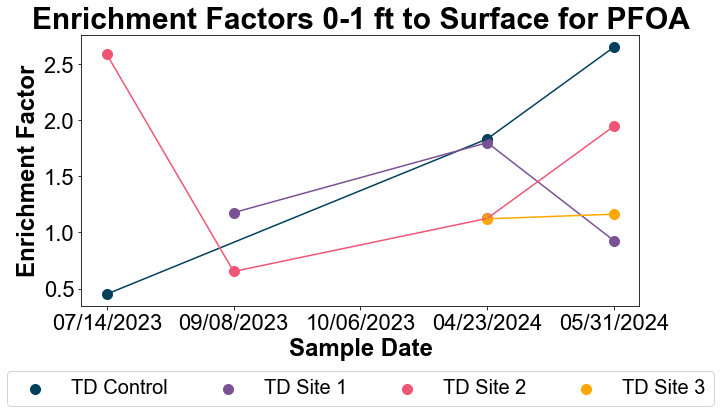

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming enrichment_factors is your DataFrame
enrichment_factors = EF_1toSurface

# Filter for 'PFOS' compound data
pfos_data = enrichment_factors.loc['PFOA']

# Create the scatter plot
fig, ax = plt.subplots(figsize=(10, 5))
color_map = {}  # To store colors for each location
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']  # Original color scheme
label_added = set()  # To track labels added to the legend

# Collect unique sample dates and sort them
unique_dates = sorted({pd.to_datetime(date) for _, date in pfos_data.index})
date_mapping = {date: i for i, date in enumerate(unique_dates)}  # Map dates to sequential integers

# Prepare data for line plotting by location
line_data = {}

for ((sample_location, sample_date), value) in pfos_data.items():
    if pd.notna(value):
        simple_location = sample_location
        if simple_location not in color_map:
            color_map[simple_location] = colors[len(color_map) % len(colors)]  # Assign colors in a cycle
        
        date_index = date_mapping[pd.to_datetime(sample_date)]
        
        # Collect data for line plotting
        if simple_location not in line_data:
            line_data[simple_location] = {'x': [], 'y': []}
        line_data[simple_location]['x'].append(date_index)
        line_data[simple_location]['y'].append(value)

        # Plot scatter
        ax.scatter(date_index, value, color=color_map[simple_location], s=100, label=simple_location if simple_location not in label_added else "")
        label_added.add(simple_location)

# Plot lines
for location, data in line_data.items():
    ax.plot(data['x'], data['y'], color=color_map[location], label=f'Line for {location}' if location not in label_added else "")

# Set custom x-ticks
ax.set_xticks(list(date_mapping.values()))  # Set x-ticks at each integer index
ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in unique_dates], rotation=0)  # Label them with corresponding dates

ax.set_title('Enrichment Factors 0-1 ft to Surface for PFOA')
ax.set_xlabel('Sample Date')
ax.set_ylabel('Enrichment Factor')
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=4)
plt.setp(legend.get_title(), fontweight='bold')

plt.show()

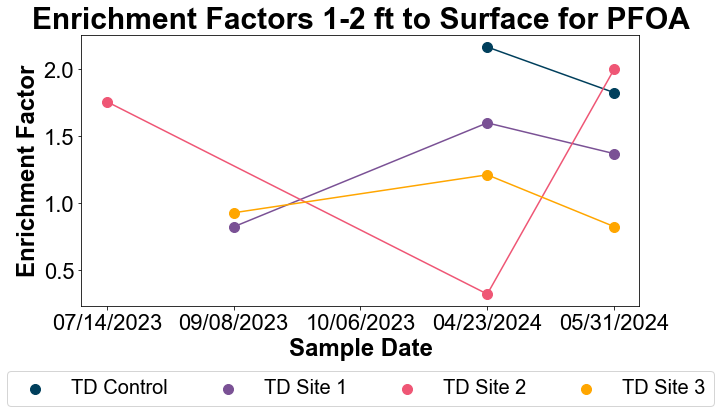

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming enrichment_factors is your DataFrame
enrichment_factors = EF_2toSurface

# Filter for 'PFOS' compound data
pfos_data = enrichment_factors.loc['PFOA']

# Create the scatter plot
fig, ax = plt.subplots(figsize=(10, 5))
color_map = {}  # To store colors for each location
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']  # Original color scheme
label_added = set()  # To track labels added to the legend

# Collect unique sample dates and sort them
unique_dates = sorted({pd.to_datetime(date) for _, date in pfos_data.index})
date_mapping = {date: i for i, date in enumerate(unique_dates)}  # Map dates to sequential integers

# Prepare data for line plotting by location
line_data = {}

for ((sample_location, sample_date), value) in pfos_data.items():
    if pd.notna(value):
        simple_location = sample_location
        if simple_location not in color_map:
            color_map[simple_location] = colors[len(color_map) % len(colors)]  # Assign colors in a cycle
        
        date_index = date_mapping[pd.to_datetime(sample_date)]
        
        # Collect data for line plotting
        if simple_location not in line_data:
            line_data[simple_location] = {'x': [], 'y': []}
        line_data[simple_location]['x'].append(date_index)
        line_data[simple_location]['y'].append(value)

        # Plot scatter
        ax.scatter(date_index, value, color=color_map[simple_location], s=100, label=simple_location if simple_location not in label_added else "")
        label_added.add(simple_location)

# Plot lines
for location, data in line_data.items():
    ax.plot(data['x'], data['y'], color=color_map[location], label=f'Line for {location}' if location not in label_added else "")

# Set custom x-ticks
ax.set_xticks(list(date_mapping.values()))  # Set x-ticks at each integer index
ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in unique_dates], rotation=0)  # Label them with corresponding dates

ax.set_title('Enrichment Factors 1-2 ft to Surface for PFOA')
ax.set_xlabel('Sample Date')
ax.set_ylabel('Enrichment Factor')
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=4)
plt.setp(legend.get_title(), fontweight='bold')

plt.show()

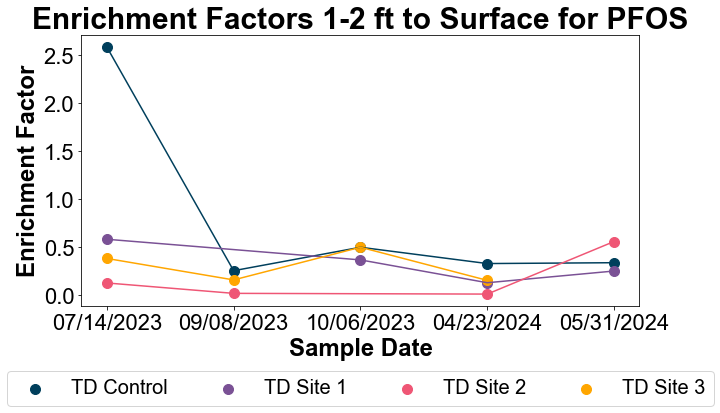

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming enrichment_factors is your DataFrame
enrichment_factors = EF_2toSurface

# Filter for 'PFOS' compound data
pfos_data = enrichment_factors.loc['PFOS']

# Create the scatter plot
fig, ax = plt.subplots(figsize=(10, 5))
color_map = {}  # To store colors for each location
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']  # Original color scheme
label_added = set()  # To track labels added to the legend

# Collect unique sample dates and sort them
unique_dates = sorted({pd.to_datetime(date) for _, date in pfos_data.index})
date_mapping = {date: i for i, date in enumerate(unique_dates)}  # Map dates to sequential integers

# Prepare data for line plotting by location
line_data = {}

for ((sample_location, sample_date), value) in pfos_data.items():
    if pd.notna(value):
        simple_location = sample_location
        if simple_location not in color_map:
            color_map[simple_location] = colors[len(color_map) % len(colors)]  # Assign colors in a cycle
        
        date_index = date_mapping[pd.to_datetime(sample_date)]
        
        # Collect data for line plotting
        if simple_location not in line_data:
            line_data[simple_location] = {'x': [], 'y': []}
        line_data[simple_location]['x'].append(date_index)
        line_data[simple_location]['y'].append(value)

        # Plot scatter
        ax.scatter(date_index, value, color=color_map[simple_location], s=100, label=simple_location if simple_location not in label_added else "")
        label_added.add(simple_location)

# Plot lines
for location, data in line_data.items():
    ax.plot(data['x'], data['y'], color=color_map[location], label=f'Line for {location}' if location not in label_added else "")

# Set custom x-ticks
ax.set_xticks(list(date_mapping.values()))  # Set x-ticks at each integer index
ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in unique_dates], rotation=0)  # Label them with corresponding dates

ax.set_title('Enrichment Factors 1-2 ft to Surface for PFOS')
ax.set_xlabel('Sample Date')
ax.set_ylabel('Enrichment Factor')
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=4)
plt.setp(legend.get_title(), fontweight='bold')

plt.show()

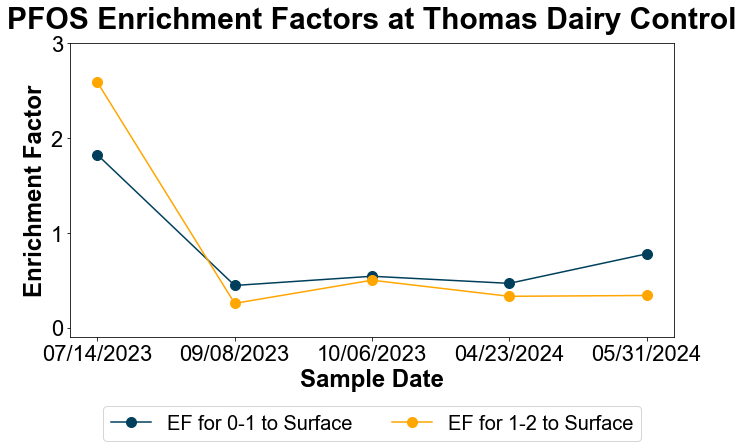

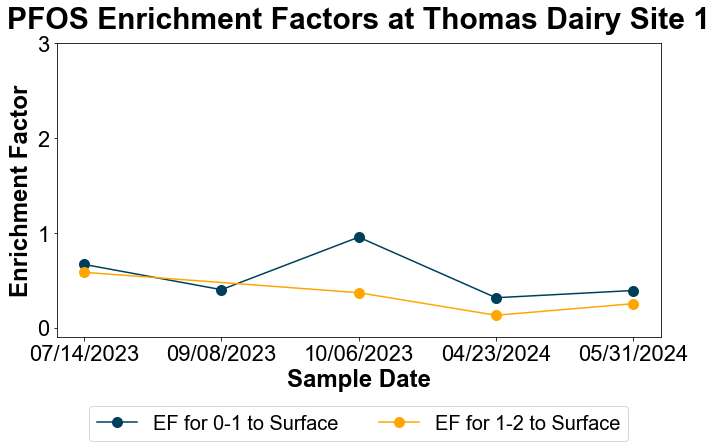

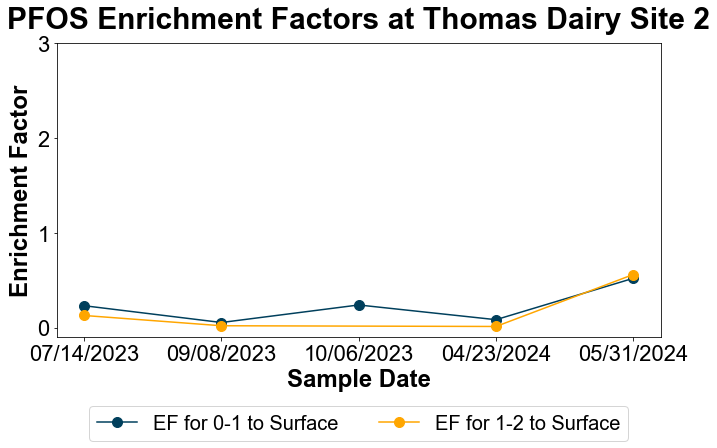

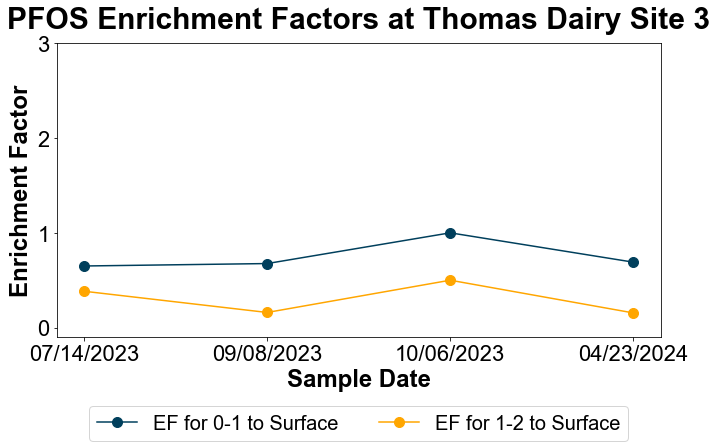

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Define colors for the plots
colors = {'0-1 ft': '#003f5c', '1-2 ft': '#ffa600'}

# Extract the names of all sample locations
sample_locations = sorted(set([loc for loc, _ in EF_1toSurface.columns]))

# Create a figure and axes for each sample location
for sample_location in sample_locations:
    fig, ax = plt.subplots(figsize=(10, 6.5))

    # Format sample location name for title
    formatted_location = sample_location.replace("TD", "Thomas Dairy")

    # Collect all relevant dates for the plots
    dates_0to1 = EF_1toSurface.loc['PFOS'][sample_location].dropna().index
    dates_1to2 = EF_2toSurface.loc['PFOS'][sample_location].dropna().index
    all_dates = sorted(set(dates_0to1).union(set(dates_1to2)))
    date_indices = range(len(all_dates))
    date_map = {date: i for i, date in enumerate(all_dates)}

    # Plot enrichment factors for 0-1 ft to Surface
    ef_0to1 = EF_1toSurface.loc['PFOS', sample_location].dropna()
    if not ef_0to1.empty:
        ax.plot([date_map[date] for date in ef_0to1.index], ef_0to1.values, color=colors['0-1 ft'], marker='o', markersize=10,label='EF for 0-1 to Surface')

    # Plot enrichment factors for 1-2 ft to Surface
    ef_1to2 = EF_2toSurface.loc['PFOS', sample_location].dropna()
    if not ef_1to2.empty:
        ax.plot([date_map[date] for date in ef_1to2.index], ef_1to2.values, color=colors['1-2 ft'], marker='o',markersize=10, label='EF for 1-2 to Surface')

    # Setting plot details
    ax.set_title(f'PFOS Enrichment Factors at {formatted_location}',pad=15)
    ax.set_xlabel('Sample Date')
    ax.set_ylabel('Enrichment Factor')
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)

    # Set custom x-ticks to show only the dates with data, avoiding gaps
    ax.set_xticks(date_indices)
    ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in all_dates], rotation=0)
    ax.set_ylim(-.1, 3)

    plt.tight_layout()
    plt.show()


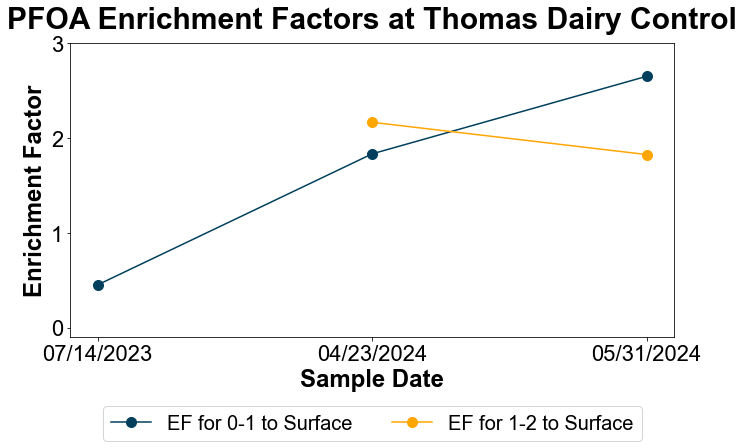

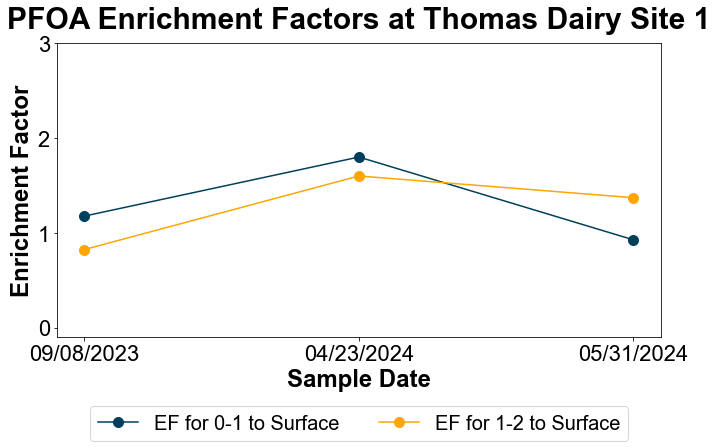

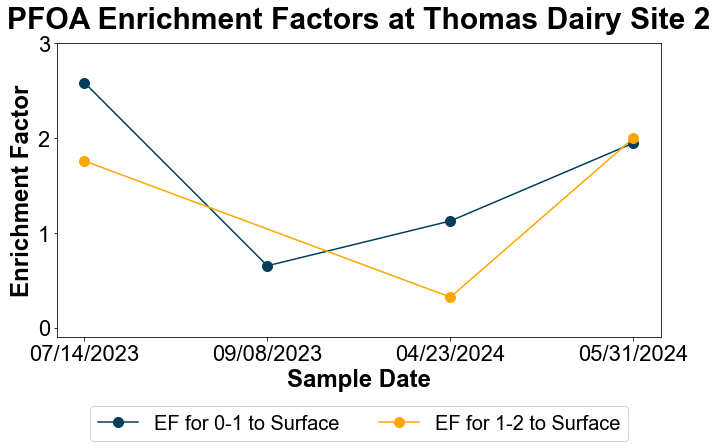

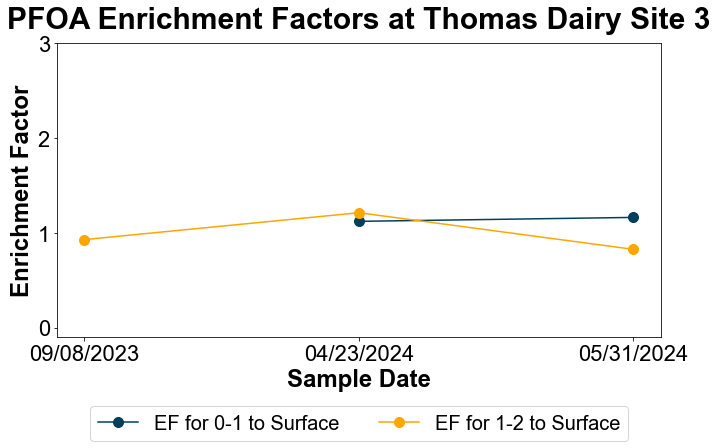

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Define colors for the plots
colors = {'0-1 ft': '#003f5c', '1-2 ft': '#ffa600'}

# Extract the names of all sample locations
sample_locations = sorted(set([loc for loc, _ in EF_1toSurface.columns]))

# Create a figure and axes for each sample location
for sample_location in sample_locations:
    fig, ax = plt.subplots(figsize=(10, 6.5))

    # Format sample location name for title
    formatted_location = sample_location.replace("TD", "Thomas Dairy")

    # Collect all relevant dates for the plots
    dates_0to1 = EF_1toSurface.loc['PFOA'][sample_location].dropna().index
    dates_1to2 = EF_2toSurface.loc['PFOA'][sample_location].dropna().index
    all_dates = sorted(set(dates_0to1).union(set(dates_1to2)))
    date_indices = range(len(all_dates))
    date_map = {date: i for i, date in enumerate(all_dates)}

    # Plot enrichment factors for 0-1 ft to Surface
    ef_0to1 = EF_1toSurface.loc['PFOA', sample_location].dropna()
    if not ef_0to1.empty:
        ax.plot([date_map[date] for date in ef_0to1.index], ef_0to1.values, color=colors['0-1 ft'], marker='o', markersize=10,label='EF for 0-1 to Surface')

    # Plot enrichment factors for 1-2 ft to Surface
    ef_1to2 = EF_2toSurface.loc['PFOA', sample_location].dropna()
    if not ef_1to2.empty:
        ax.plot([date_map[date] for date in ef_1to2.index], ef_1to2.values, color=colors['1-2 ft'], marker='o',markersize=10, label='EF for 1-2 to Surface')

    # Setting plot details
    ax.set_title(f'PFOA Enrichment Factors at {formatted_location}',pad=15)
    ax.set_xlabel('Sample Date')
    ax.set_ylabel('Enrichment Factor')
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)

    # Set custom x-ticks to show only the dates with data, avoiding gaps
    ax.set_xticks(date_indices)
    ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in all_dates], rotation=0)
    ax.set_ylim(-.1, 3)

    plt.tight_layout()
    plt.show()

<ipython-input-104-0ad025aa2924>:46: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


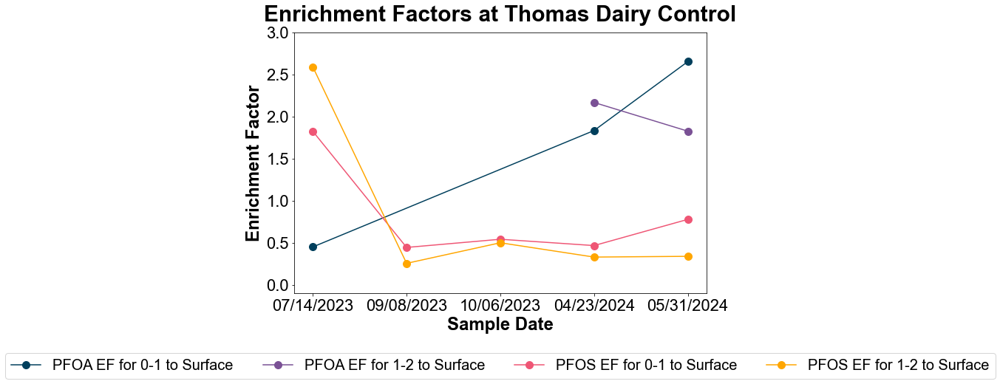

<ipython-input-104-0ad025aa2924>:46: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


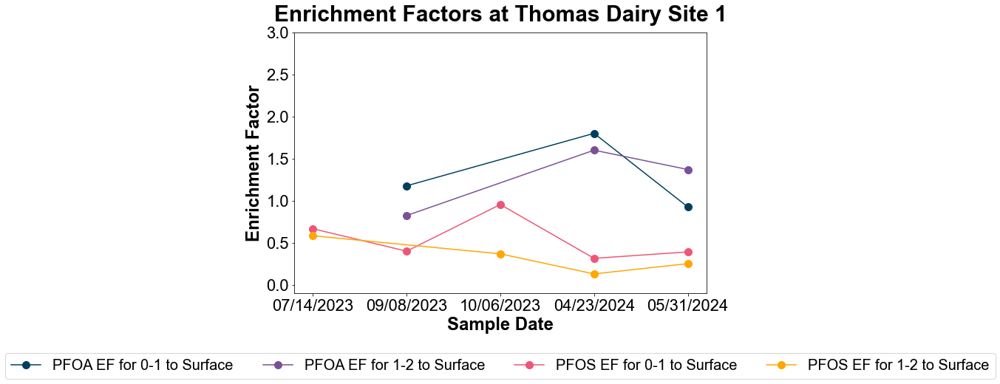

<ipython-input-104-0ad025aa2924>:46: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


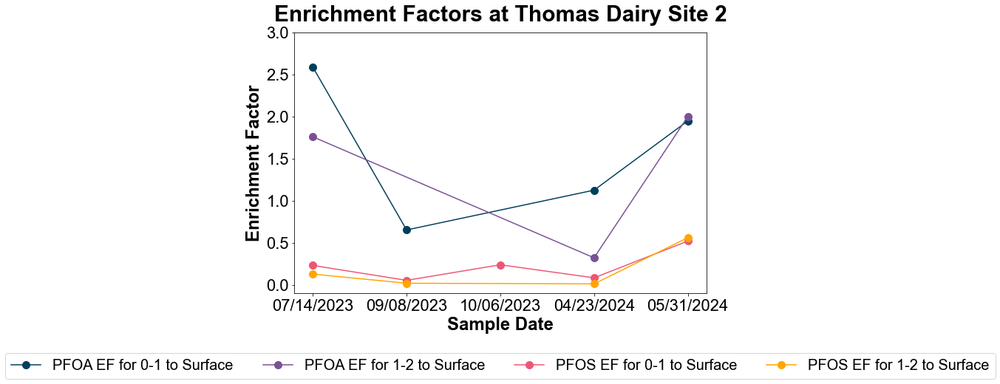

<ipython-input-104-0ad025aa2924>:46: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


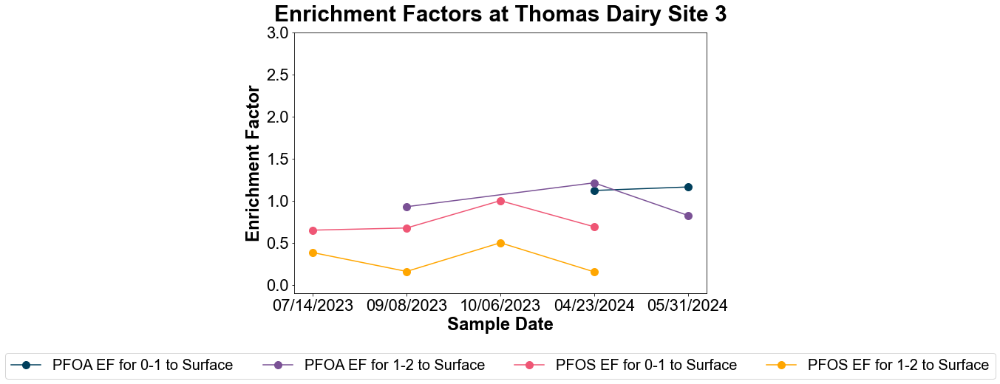

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Define colors for each plot series
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']

# Extract the names of all sample locations
sample_locations = sorted(set([loc for loc, _ in EF_1toSurface.columns]))

# Create a figure and axes for each sample location
for sample_location in sample_locations:
    fig, ax = plt.subplots(figsize=(10, 6.5))

    # Format sample location name for title
    formatted_location = sample_location.replace("TD", "Thomas Dairy")

    # Collect all relevant dates for the plots
    dates_0to1_PFOA = EF_1toSurface.loc['PFOA'][sample_location].dropna().index
    dates_1to2_PFOA = EF_2toSurface.loc['PFOA'][sample_location].dropna().index
    dates_0to1_PFAS = EF_1toSurface.loc['PFOS'][sample_location].dropna().index
    dates_1to2_PFAS = EF_2toSurface.loc['PFOS'][sample_location].dropna().index
    all_dates = sorted(set(dates_0to1_PFOA).union(dates_1to2_PFOA).union(dates_0to1_PFAS).union(dates_1to2_PFAS))
    date_indices = range(len(all_dates))
    date_map = {date: i for i, date in enumerate(all_dates)}

    # Plotting PFOA and PFAS enrichment factors
    for idx, compound in enumerate(['PFOA', 'PFOS']):
        ef_0to1 = EF_1toSurface.loc[compound, sample_location].dropna()
        ef_1to2 = EF_2toSurface.loc[compound, sample_location].dropna()
        if not ef_0to1.empty:
            ax.plot([date_map[date] for date in ef_0to1.index], ef_0to1.values, color=colors[idx*2], marker='o', markersize=10, label=f'{compound} EF for 0-1 to Surface')
        if not ef_1to2.empty:
            ax.plot([date_map[date] for date in ef_1to2.index], ef_1to2.values, color=colors[idx*2+1], marker='o', markersize=10, label=f'{compound} EF for 1-2 to Surface')

    # Setting plot details
    ax.set_title(f'Enrichment Factors at {formatted_location}', pad=15)
    ax.set_xlabel('Sample Date')
    ax.set_ylabel('Enrichment Factor')
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=4)

    # Set custom x-ticks to show only the dates with data, avoiding gaps
    ax.set_xticks(date_indices)
    ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in all_dates], rotation=0)
    ax.set_ylim(-.1, 3)

    plt.tight_layout()
    plt.show()


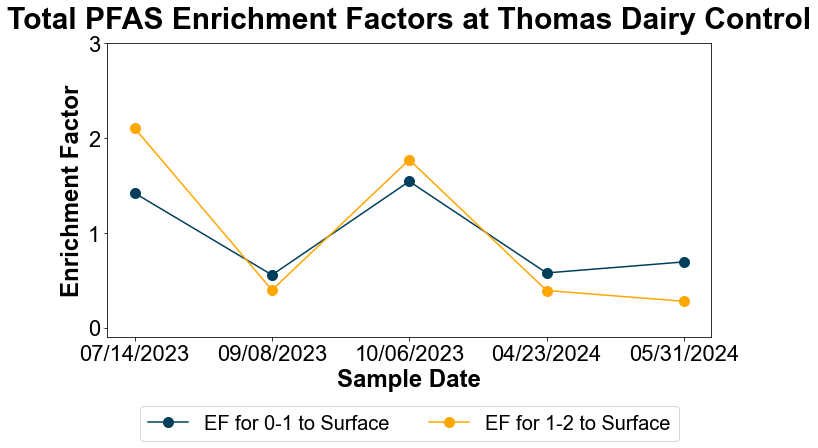

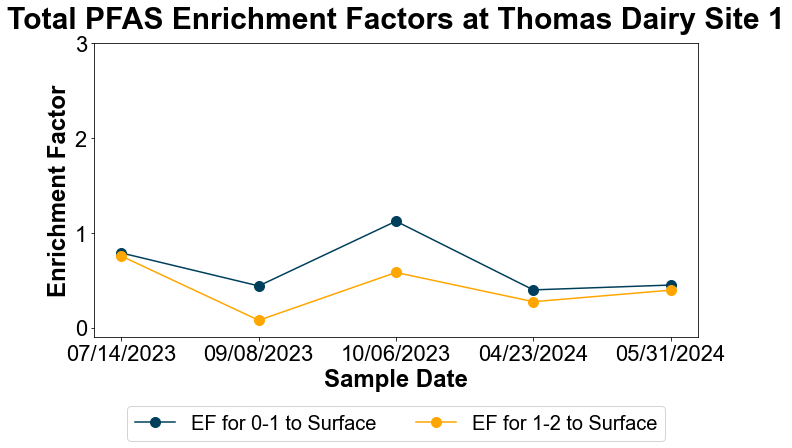

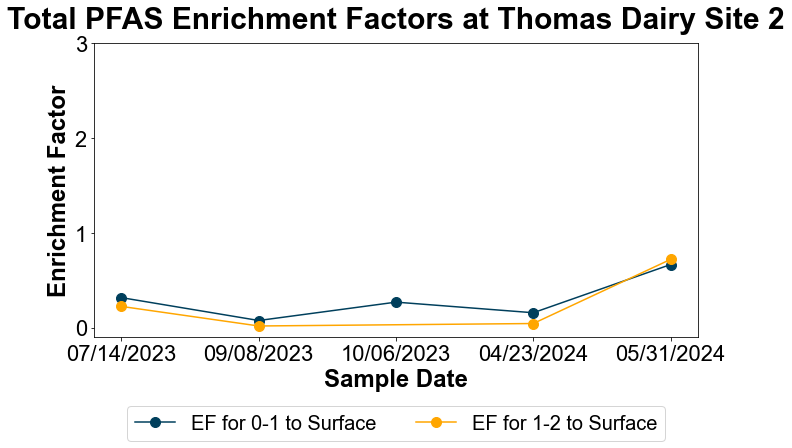

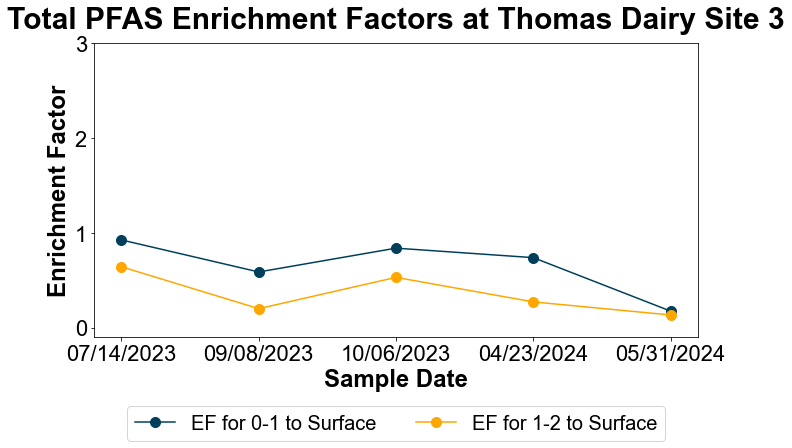

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Define colors for the plots
colors = {'0-1 ft': '#003f5c', '1-2 ft': '#ffa600'}

# Extract the names of all sample locations
sample_locations = sorted(set([loc for loc, _ in EF_1toSurface.columns]))

# Create a figure and axes for each sample location
for sample_location in sample_locations:
    fig, ax = plt.subplots(figsize=(10, 6.5))

    # Format sample location name for title
    formatted_location = sample_location.replace("TD", "Thomas Dairy")

    # Collect all relevant dates for the plots
    dates_0to1 = EF_1toSurface.loc['Total PFAS'][sample_location].dropna().index
    dates_1to2 = EF_2toSurface.loc['Total PFAS'][sample_location].dropna().index
    all_dates = sorted(set(dates_0to1).union(set(dates_1to2)))
    date_indices = range(len(all_dates))
    date_map = {date: i for i, date in enumerate(all_dates)}

    # Plot enrichment factors for 0-1 ft to Surface
    ef_0to1 = EF_1toSurface.loc['Total PFAS', sample_location].dropna()
    if not ef_0to1.empty:
        ax.plot([date_map[date] for date in ef_0to1.index], ef_0to1.values, color=colors['0-1 ft'], marker='o', markersize=10,label='EF for 0-1 to Surface')

    # Plot enrichment factors for 1-2 ft to Surface
    ef_1to2 = EF_2toSurface.loc['Total PFAS', sample_location].dropna()
    if not ef_1to2.empty:
        ax.plot([date_map[date] for date in ef_1to2.index], ef_1to2.values, color=colors['1-2 ft'], marker='o',markersize=10, label='EF for 1-2 to Surface')

    # Setting plot details
    ax.set_title(f'Total PFAS Enrichment Factors at {formatted_location}',pad=15)
    ax.set_xlabel('Sample Date')
    ax.set_ylabel('Enrichment Factor')
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)

    # Set custom x-ticks to show only the dates with data, avoiding gaps
    ax.set_xticks(date_indices)
    ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in all_dates], rotation=0)
    ax.set_ylim(-.1, 3)

    plt.tight_layout()
    plt.show()


### Re-calculate Enrichment Factors with Normalization

In [ ]:
enrichment_factors_combined

TD Site 1                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN   2.888889   
PFPeA                NaN        NaN        NaN        NaN   3.046154   
PFHxA                NaN        NaN        NaN   0.709677        NaN   
PFHpA                NaN        NaN        NaN        NaN        NaN   
PFOA                 NaN        NaN        NaN   0.981818    0.34912   
PFNA                 NaN        NaN        NaN        NaN   0.615385   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            0.365591        0.9   1.762238      0.675   0.503106   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      0.554934   0.791209   0.727507   0.689596   0.648014   

               TD Site 2                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN        NaN   
PFPeA                NaN        NaN        NaN        NaN        NaN   
PFHxA                NaN        NaN        NaN   0.730769        NaN   
PFHpA                NaN        NaN        NaN   0.732848        NaN   
PFOA            5.738147        NaN        NaN   0.613636   0.734254   
PFNA                 NaN        NaN        NaN   0.210023   1.230769   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            0.126551   0.120536   0.440559   0.178571   0.668571   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      0.222686   0.134412   0.174019   0.271452   0.960279   

               TD Site 3                                              
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31  
PFAS Compound                                                         
PFBA                 NaN        NaN        NaN        NaN        NaN  
PFPeA                NaN        NaN        NaN        NaN        NaN  
PFHxA                NaN        NaN        NaN   0.933333        NaN  
PFHpA                NaN        NaN        NaN   1.837355        NaN  
PFOA                 NaN        NaN        NaN    0.61157   0.438429  
PFNA                 NaN        NaN        NaN    1.17004        NaN  
PFDA                 NaN        NaN        NaN        NaN        NaN  
PFUnA                NaN        NaN        NaN        NaN        NaN  
PFDoA                NaN        NaN        NaN        NaN        NaN  
NEtFOSAA             NaN        NaN        NaN        NaN        NaN  
PFBS                 NaN        NaN        NaN        NaN        NaN  
PFHxS                NaN        NaN        NaN        NaN        NaN  
PFHpS                NaN        NaN        NaN        NaN        NaN  
PFOS            0.356452    1.52027   1.846154   1.479592        NaN  
PFDS                 NaN        NaN        NaN        NaN        NaN  

In [ ]:
enrichment_factors_combined_2

TD Site 1                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN        NaN   
PFPeA                NaN        NaN        NaN        NaN        NaN   
PFHxA                NaN        NaN        NaN   1.577061   3.791515   
PFHpA                NaN        NaN        NaN        NaN        NaN   
PFOA                 NaN        NaN        NaN   0.738462   0.750441   
PFNA                 NaN        NaN        NaN        NaN   0.842105   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            0.225379        NaN   0.736364   0.393939    0.74412   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      0.358489   0.194105   0.328409   0.697931   1.422283   

               TD Site 2                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN        NaN   
PFPeA                NaN        NaN        NaN        NaN        NaN   
PFHxA                NaN        NaN        NaN   0.336182        NaN   
PFHpA                NaN        NaN        NaN        NaN        NaN   
PFOA                 NaN        NaN        NaN   0.148352   1.095238   
PFNA                 NaN        NaN        NaN        NaN   2.807018   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            0.049336   0.075466        NaN   0.035354   1.652459   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      0.106152   0.042396        NaN   0.109373   2.592288   

               TD Site 3                                              
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31  
PFAS Compound                                                         
PFBA                 NaN        NaN        NaN        NaN        NaN  
PFPeA                NaN        NaN        NaN        NaN        NaN  
PFHxA                NaN        NaN        NaN   1.481481        NaN  
PFHpA                NaN        NaN        NaN        NaN        NaN  
PFOA                 NaN        NaN        NaN   0.559441   0.452104  
PFNA                 NaN        NaN        NaN        NaN        NaN  
PFDA                 NaN        NaN        NaN        NaN        NaN  
PFUnA                NaN        NaN        NaN        NaN        NaN  
PFDoA                NaN        NaN        NaN        NaN        NaN  
NEtFOSAA             NaN        NaN        NaN        NaN        NaN  
PFBS                 NaN        NaN        NaN        NaN        NaN  
PFHxS                NaN        NaN        NaN        NaN        NaN  
PFHpS                NaN        NaN        NaN        NaN        NaN  
PFOS            0.148106   0.623972        1.0   0.468975        NaN  
PFDS                 NaN        NaN        NaN        NaN        NaN  

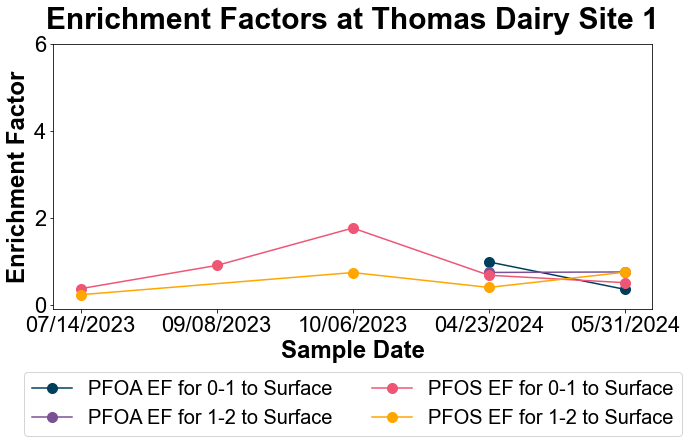

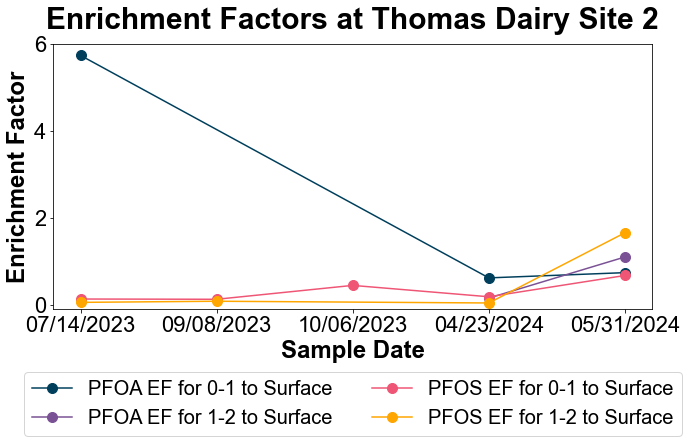

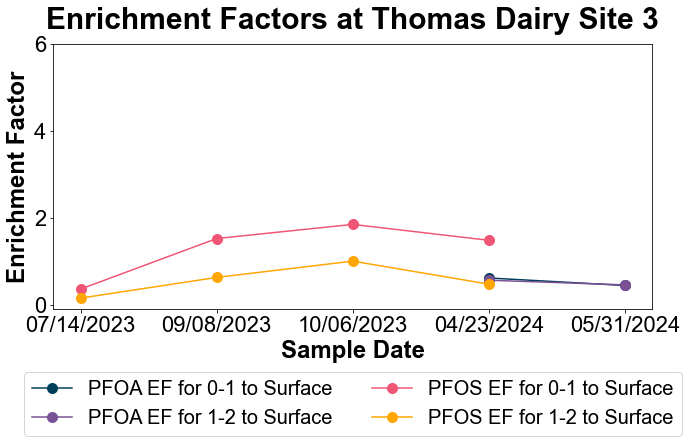

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Define colors for each plot series
colors = ['#003f5c', '#7a5195', '#ef5675', '#ffa600']

# Extract the names of all sample locations
sample_locations = sorted(set([loc for loc, _ in enrichment_factors_combined.columns]))

# Create a figure and axes for each sample location
for sample_location in sample_locations:
    fig, ax = plt.subplots(figsize=(10, 6.5))

    # Format sample location name for title
    formatted_location = sample_location.replace("TD", "Thomas Dairy")

    # Collect all relevant dates for the plots
    dates_0to1_PFOA = enrichment_factors_combined.loc['PFOA'][sample_location].dropna().index
    dates_1to2_PFOA = enrichment_factors_combined_2.loc['PFOA'][sample_location].dropna().index
    dates_0to1_PFAS = enrichment_factors_combined.loc['PFOS'][sample_location].dropna().index
    dates_1to2_PFAS = enrichment_factors_combined_2.loc['PFOS'][sample_location].dropna().index
    all_dates = sorted(set(dates_0to1_PFOA).union(dates_1to2_PFOA).union(dates_0to1_PFAS).union(dates_1to2_PFAS))
    date_indices = range(len(all_dates))
    date_map = {date: i for i, date in enumerate(all_dates)}

    # Plotting PFOA and PFAS enrichment factors
    for idx, compound in enumerate(['PFOA', 'PFOS']):
        ef_0to1 = enrichment_factors_combined.loc[compound, sample_location].dropna()
        ef_1to2 = enrichment_factors_combined_2.loc[compound, sample_location].dropna()
        if not ef_0to1.empty:
            ax.plot([date_map[date] for date in ef_0to1.index], ef_0to1.values, color=colors[idx*2], marker='o', markersize=10, label=f'{compound} EF for 0-1 to Surface')
        if not ef_1to2.empty:
            ax.plot([date_map[date] for date in ef_1to2.index], ef_1to2.values, color=colors[idx*2+1], marker='o', markersize=10, label=f'{compound} EF for 1-2 to Surface')

    # Setting plot details
    ax.set_title(f'Enrichment Factors at {formatted_location}', pad=15)
    ax.set_xlabel('Sample Date')
    ax.set_ylabel('Enrichment Factor')
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)

    # Set custom x-ticks to show only the dates with data, avoiding gaps
    ax.set_xticks(date_indices)
    ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in all_dates], rotation=0)
    ax.set_ylim(-.1, 6)

    plt.tight_layout()
    plt.show()

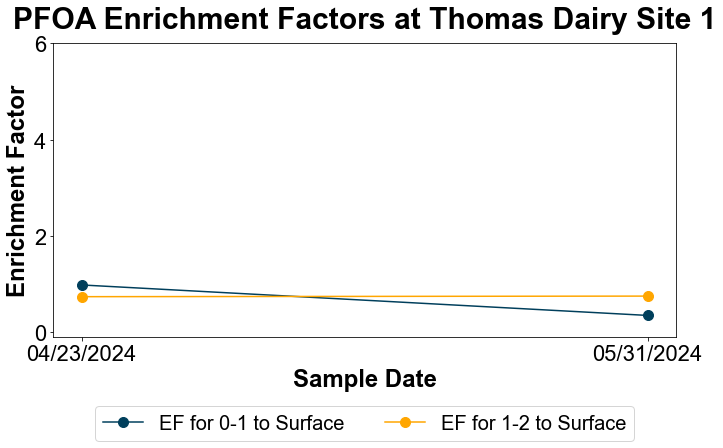

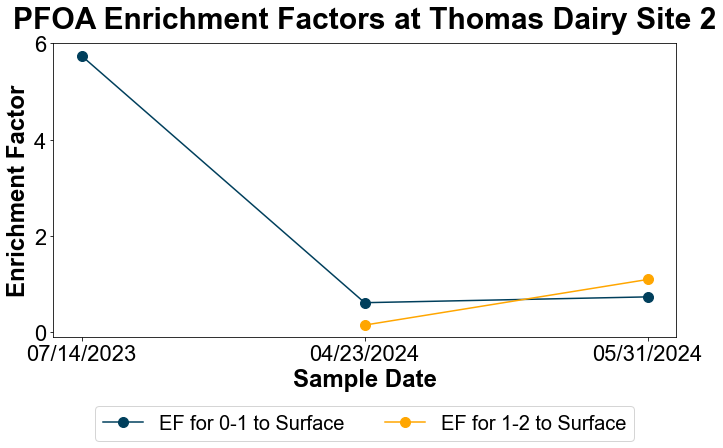

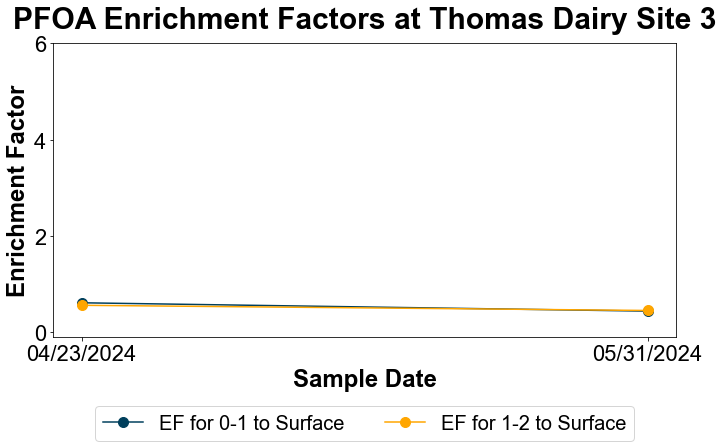

In [ ]:

# Define colors for the plots
colors = {'0-1 ft': '#003f5c', '1-2 ft': '#ffa600'}

# Extract the names of all sample locations
sample_locations = sorted(set([loc for loc, _ in enrichment_factors_combined.columns]))

# Create a figure and axes for each sample location
for sample_location in sample_locations:
    fig, ax = plt.subplots(figsize=(10, 6.5))

    # Format sample location name for title
    formatted_location = sample_location.replace("TD", "Thomas Dairy")

    # Collect all relevant dates for the plots
    dates_0to1 = enrichment_factors_combined.loc['PFOA'][sample_location].dropna().index
    dates_1to2 = enrichment_factors_combined_2.loc['PFOA'][sample_location].dropna().index
    all_dates = sorted(set(dates_0to1).union(set(dates_1to2)))
    date_indices = range(len(all_dates))
    date_map = {date: i for i, date in enumerate(all_dates)}

    # Plot enrichment factors for 0-1 ft to Surface
    ef_0to1 = enrichment_factors_combined.loc['PFOA', sample_location].dropna()
    if not ef_0to1.empty:
        ax.plot([date_map[date] for date in ef_0to1.index], ef_0to1.values, color=colors['0-1 ft'], marker='o', markersize=10,label='EF for 0-1 to Surface')

    # Plot enrichment factors for 1-2 ft to Surface
    ef_1to2 = enrichment_factors_combined_2.loc['PFOA', sample_location].dropna()
    if not ef_1to2.empty:
        ax.plot([date_map[date] for date in ef_1to2.index], ef_1to2.values, color=colors['1-2 ft'], marker='o',markersize=10, label='EF for 1-2 to Surface')

    # Setting plot details
    ax.set_title(f'PFOA Enrichment Factors at {formatted_location}',pad=15)
    ax.set_xlabel('Sample Date')
    ax.set_ylabel('Enrichment Factor')
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)

    # Set custom x-ticks to show only the dates with data, avoiding gaps
    ax.set_xticks(date_indices)
    ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in all_dates], rotation=0)
    ax.set_ylim(-.1, 6)

    plt.tight_layout()
    plt.show()

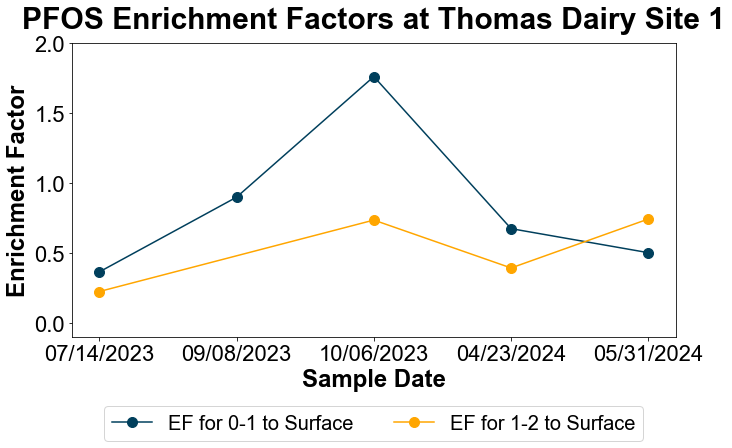

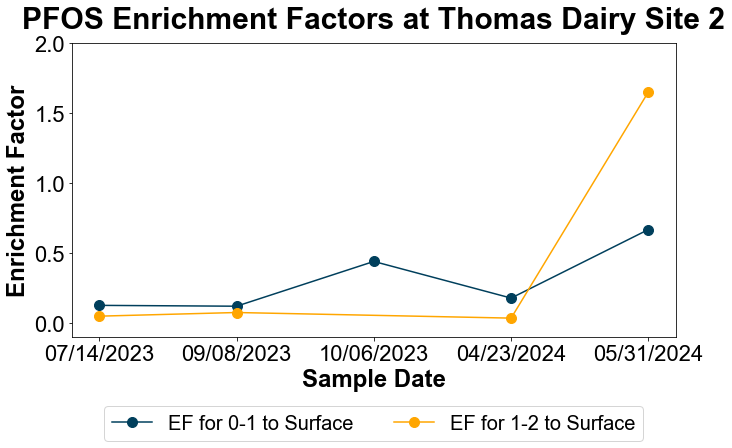

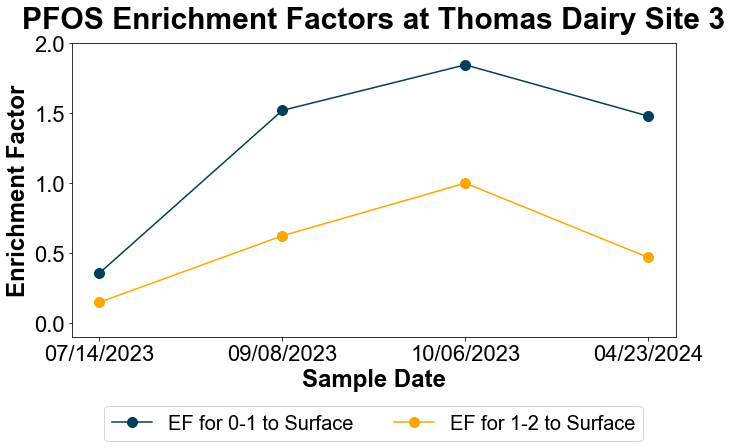

In [ ]:

# Define colors for the plots
colors = {'0-1 ft': '#003f5c', '1-2 ft': '#ffa600'}

# Extract the names of all sample locations
sample_locations = sorted(set([loc for loc, _ in enrichment_factors_combined.columns]))

# Create a figure and axes for each sample location
for sample_location in sample_locations:
    fig, ax = plt.subplots(figsize=(10, 6.5))

    # Format sample location name for title
    formatted_location = sample_location.replace("TD", "Thomas Dairy")

    # Collect all relevant dates for the plots
    dates_0to1 = enrichment_factors_combined.loc['PFOS'][sample_location].dropna().index
    dates_1to2 = enrichment_factors_combined_2.loc['PFOS'][sample_location].dropna().index
    all_dates = sorted(set(dates_0to1).union(set(dates_1to2)))
    date_indices = range(len(all_dates))
    date_map = {date: i for i, date in enumerate(all_dates)}

    # Plot enrichment factors for 0-1 ft to Surface
    ef_0to1 = enrichment_factors_combined.loc['PFOS', sample_location].dropna()
    if not ef_0to1.empty:
        ax.plot([date_map[date] for date in ef_0to1.index], ef_0to1.values, color=colors['0-1 ft'], marker='o', markersize=10,label='EF for 0-1 to Surface')

    # Plot enrichment factors for 1-2 ft to Surface
    ef_1to2 = enrichment_factors_combined_2.loc['PFOS', sample_location].dropna()
    if not ef_1to2.empty:
        ax.plot([date_map[date] for date in ef_1to2.index], ef_1to2.values, color=colors['1-2 ft'], marker='o',markersize=10, label='EF for 1-2 to Surface')

    # Setting plot details
    ax.set_title(f'PFOS Enrichment Factors at {formatted_location}',pad=15)
    ax.set_xlabel('Sample Date')
    ax.set_ylabel('Enrichment Factor')
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)

    # Set custom x-ticks to show only the dates with data, avoiding gaps
    ax.set_xticks(date_indices)
    ax.set_xticklabels([date.strftime('%m/%d/%Y') for date in all_dates], rotation=0)
    ax.set_ylim(-.1, 2)

    plt.tight_layout()
    plt.show()

### Enrichment Factors Normalized - Plot version 2

In [ ]:
numerator_1toSurface=EF_1toSurface[['TD Site 1','TD Site 2','TD Site 3']]
numerator_1toSurface

Sample Location  TD Site 1                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN        NaN        1.0   
PFPeA                  NaN        NaN        NaN        NaN   0.761538   
PFHxA                  NaN        NaN        NaN   0.709677        NaN   
PFHpA                  NaN        NaN        NaN        NaN        NaN   
PFOA                   NaN   1.176471        NaN        1.8   0.925926   
PFNA                   NaN        NaN        NaN        NaN        0.5   
PFDA                   NaN        NaN        NaN        NaN        NaN   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN        NaN        NaN   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PFOS              0.666667        0.4   0.954545      0.315   0.391304   
PFDS                   NaN        NaN        NaN        NaN        NaN   
Total PFAS          0.7875    0.43956   1.122727    0.39774   0.448923   

Sample Location  TD Site 2                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN        NaN        NaN   
PFPeA                  NaN        NaN        NaN        NaN        NaN   
PFHxA                  NaN        NaN        NaN   0.730769        NaN   
PFHpA                  NaN        NaN        NaN   0.576923        NaN   
PFOA              2.586207   0.652174        NaN      1.125   1.947368   
PFNA                   NaN        NaN        NaN   0.160606        1.0   
PFDA                   NaN        NaN        NaN        NaN    0.40625   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN   1.181818   0.989899   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PFOS              0.230769   0.053571   0.238636   0.083333       0.52   
PFDS                   NaN        NaN        NaN        NaN        NaN   
Total PFAS        0.316011   0.074673   0.268555   0.156566    0.66525   

Sample Location  TD Site 3                                              
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31  
PFAS Compound                                                           
PFBA                   NaN        NaN        NaN        NaN        NaN  
PFPeA                  NaN        NaN        NaN        NaN        NaN  
PFHxA                  NaN        NaN        NaN   0.933333        NaN  
PFHpA                  NaN        NaN        NaN   1.446429        NaN  
PFOA                   NaN        NaN        NaN   1.121212   1.162791  
PFNA                   NaN        NaN        NaN   0.894737        NaN  
PFDA                   NaN        NaN        NaN   0.516129        NaN  
PFUnA                  NaN        NaN        NaN        NaN        NaN  
PFDoA                  NaN        NaN        NaN        NaN        NaN  
NEtFOSAA               NaN        NaN        NaN        NaN        NaN  
PFBS                   NaN        NaN        NaN        NaN        NaN  
PFHxS                  NaN        NaN        NaN   1.071429        NaN  
PFHpS                  NaN        NaN        NaN        NaN        NaN  
PFOS              

In [ ]:
numerator_2toSurface=EF_2toSurface[['TD Site 1','TD Site 2','TD Site 3']]
numerator_2toSurface

Sample Location  TD Site 1                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN        NaN        1.0   
PFPeA                  NaN        NaN        NaN        NaN        NaN   
PFHxA                  NaN        NaN        NaN   1.064516   0.836364   
PFHpA                  NaN        NaN        NaN        NaN        NaN   
PFOA                   NaN   0.823529        NaN        1.6    1.37037   
PFNA                   NaN        NaN        NaN        NaN        0.3   
PFDA                   NaN        NaN        NaN        NaN        NaN   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN        NaN        NaN   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PFOS              0.583333        NaN   0.368182       0.13   0.252174   
PFDS                   NaN        NaN        NaN        NaN        NaN   
Total PFAS        0.754167   0.076923   0.581818   0.273059   0.394769   

Sample Location  TD Site 2                                              \
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                            
PFBA                   NaN        NaN        NaN        NaN        NaN   
PFPeA                  NaN        NaN        NaN        NaN        NaN   
PFHxA                  NaN        NaN        NaN   0.226923        NaN   
PFHpA                  NaN        NaN        NaN        NaN        NaN   
PFOA              1.758621        NaN        NaN   0.321429        2.0   
PFNA                   NaN        NaN        NaN        NaN        1.0   
PFDA                   NaN        NaN        NaN        NaN    0.50625   
PFUnA                  NaN        NaN        NaN        NaN        NaN   
PFDoA                  NaN        NaN        NaN        NaN        NaN   
NEtFOSAA               NaN        NaN        NaN        NaN        NaN   
PFBS                   NaN        NaN        NaN        NaN        NaN   
PFHxS                  NaN        NaN        NaN   0.787879   1.212121   
PFHpS                  NaN        NaN        NaN        NaN        NaN   
PFOS              0.127692   0.019286        NaN   0.011667       0.56   
PFDS                   NaN        NaN        NaN        NaN        NaN   
Total PFAS        0.223315   0.016801        NaN   0.042791   0.719516   

Sample Location  TD Site 3                                              
Sample Date     2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31  
PFAS Compound                                                           
PFBA                   NaN        NaN        NaN        NaN        NaN  
PFPeA                  NaN        NaN        NaN        NaN        NaN  
PFHxA                  NaN        NaN        NaN        1.0        NaN  
PFHpA                  NaN        NaN        NaN   1.660714        NaN  
PFOA                   NaN   0.928571        NaN   1.212121   0.825581  
PFNA                   NaN        NaN        NaN        NaN        NaN  
PFDA                   NaN        NaN        NaN        NaN        NaN  
PFUnA                  NaN        NaN        NaN        NaN        NaN  
PFDoA                  NaN        NaN        NaN        NaN        NaN  
NEtFOSAA               NaN        NaN        NaN        NaN        NaN  
PFBS                   NaN        NaN        NaN        NaN        NaN  
PFHxS                  NaN        NaN        NaN        1.5        NaN  
PFHpS                  NaN        NaN        NaN        NaN        NaN  
PFOS              

In [ ]:
# Combine into a single DataFrame with MultiIndex columns
denominator_1toSurface = pd.concat({
    'TD Site 1': EF_1toSurface['TD Control'],
    'TD Site 2': EF_1toSurface['TD Control'],
    'TD Site 3': EF_1toSurface['TD Control']
}, axis=1)

# Optionally, if you need to reset the index for any reason:
# enrichment_factors_combined.columns = pd.MultiIndex.from_product([['TD Site 1', 'TD Site 2', 'TD Site 3'], EF_1toSurface.columns])
denominator_1toSurface

TD Site 1                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN   0.782609   0.346154   
PFPeA                NaN        NaN   3.469388   0.785714       0.25   
PFHxA                NaN        NaN        NaN        1.0   0.602941   
PFHpA                NaN        NaN        NaN   0.787234   0.846154   
PFOA            0.450704        NaN        NaN   1.833333   2.652174   
PFNA                 NaN        NaN        NaN   0.764706     0.8125   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            1.823529   0.444444   0.541667   0.466667   0.777778   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      1.419087   0.555556   1.543253   0.576772   0.692767   

               TD Site 2                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN   0.782609   0.346154   
PFPeA                NaN        NaN   3.469388   0.785714       0.25   
PFHxA                NaN        NaN        NaN        1.0   0.602941   
PFHpA                NaN        NaN        NaN   0.787234   0.846154   
PFOA            0.450704        NaN        NaN   1.833333   2.652174   
PFNA                 NaN        NaN        NaN   0.764706     0.8125   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            1.823529   0.444444   0.541667   0.466667   0.777778   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      1.419087   0.555556   1.543253   0.576772   0.692767   

               TD Site 3                                              
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31  
PFAS Compound                                                         
PFBA                 NaN        NaN        NaN   0.782609   0.346154  
PFPeA                NaN        NaN   3.469388   0.785714       0.25  
PFHxA                NaN        NaN        NaN        1.0   0.602941  
PFHpA                NaN        NaN        NaN   0.787234   0.846154  
PFOA            0.450704        NaN        NaN   1.833333   2.652174  
PFNA                 NaN        NaN        NaN   0.764706     0.8125  
PFDA                 NaN        NaN        NaN        NaN        NaN  
PFUnA                NaN        NaN        NaN        NaN        NaN  
PFDoA                NaN        NaN        NaN        NaN        NaN  
NEtFOSAA             NaN        NaN        NaN        NaN        NaN  
PFBS                 NaN        NaN        NaN        NaN        NaN  
PFHxS                NaN        NaN        NaN        NaN        NaN  
PFHpS                NaN        NaN        NaN        NaN        NaN  
PFOS            1.823529   0.444444   0.541667   0.466667   0.777778  
PFDS                 NaN        NaN        NaN        NaN        NaN  

In [ ]:
# Combine into a single DataFrame with MultiIndex columns
denominator_2toSurface = pd.concat({
    'TD Site 1': EF_2toSurface['TD Control'],
    'TD Site 2': EF_2toSurface['TD Control'],
    'TD Site 3': EF_2toSurface['TD Control']
}, axis=1)

# Optionally, if you need to reset the index for any reason:
# enrichment_factors_combined.columns = pd.MultiIndex.from_product([['TD Site 1', 'TD Site 2', 'TD Site 3'], EF_1toSurface.columns])
denominator_2toSurface

TD Site 1                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN        NaN   
PFPeA                NaN        NaN   4.081633        NaN        NaN   
PFHxA                NaN        NaN        NaN      0.675   0.220588   
PFHpA                NaN        NaN        NaN        NaN   0.282051   
PFOA                 NaN        NaN        NaN   2.166667   1.826087   
PFNA                 NaN        NaN        NaN   0.405882    0.35625   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            2.588235   0.255556        0.5       0.33   0.338889   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      2.103734   0.396296   1.771626    0.39124    0.27756   

               TD Site 2                                              \
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31   
PFAS Compound                                                          
PFBA                 NaN        NaN        NaN        NaN        NaN   
PFPeA                NaN        NaN   4.081633        NaN        NaN   
PFHxA                NaN        NaN        NaN      0.675   0.220588   
PFHpA                NaN        NaN        NaN        NaN   0.282051   
PFOA                 NaN        NaN        NaN   2.166667   1.826087   
PFNA                 NaN        NaN        NaN   0.405882    0.35625   
PFDA                 NaN        NaN        NaN        NaN        NaN   
PFUnA                NaN        NaN        NaN        NaN        NaN   
PFDoA                NaN        NaN        NaN        NaN        NaN   
NEtFOSAA             NaN        NaN        NaN        NaN        NaN   
PFBS                 NaN        NaN        NaN        NaN        NaN   
PFHxS                NaN        NaN        NaN        NaN        NaN   
PFHpS                NaN        NaN        NaN        NaN        NaN   
PFOS            2.588235   0.255556        0.5       0.33   0.338889   
PFDS                 NaN        NaN        NaN        NaN        NaN   
Total PFAS      2.103734   0.396296   1.771626    0.39124    0.27756   

               TD Site 3                                              
Sample Date   2023-07-14 2023-09-08 2023-10-06 2024-04-23 2024-05-31  
PFAS Compound                                                         
PFBA                 NaN        NaN        NaN        NaN        NaN  
PFPeA                NaN        NaN   4.081633        NaN        NaN  
PFHxA                NaN        NaN        NaN      0.675   0.220588  
PFHpA                NaN        NaN        NaN        NaN   0.282051  
PFOA                 NaN        NaN        NaN   2.166667   1.826087  
PFNA                 NaN        NaN        NaN   0.405882    0.35625  
PFDA                 NaN        NaN        NaN        NaN        NaN  
PFUnA                NaN        NaN        NaN        NaN        NaN  
PFDoA                NaN        NaN        NaN        NaN        NaN  
NEtFOSAA             NaN        NaN        NaN        NaN        NaN  
PFBS                 NaN        NaN        NaN        NaN        NaN  
PFHxS                NaN        NaN        NaN        NaN        NaN  
PFHpS                NaN        NaN        NaN        NaN        NaN  
PFOS            2.588235   0.255556        0.5       0.33   0.338889  
PFDS                 NaN        NaN        NaN        NaN        NaN  

In [ ]:

def plot_enrichment_factors(numerator_df, denominator_df, compound='PFOA', custom_title=None):
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Move spines to cross at (1,1) for quadrant visualization
    ax.spines['left'].set_position(('data', 1))
    ax.spines['bottom'].set_position(('data', 1))
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')

    # Colors and markers for each site
    colors = {'TD Site 1': '#003f5c', 'TD Site 2': '#7a5195', 'TD Site 3': '#ef5675'}
    markers = ['o', '^', 's']  # Different markers for visual diversity
    
    # Calculate maximum bound for axes based on deviations from 1
    max_num = numerator_df.loc[compound].abs().max().max() 
    max_den = denominator_df.loc[compound].abs().max().max()
    max_bound = max(max_num, max_den)

    # Iterate through each site and sample date to plot data
    labels_added = set()
    for site in numerator_df.columns.get_level_values(0).unique():
        for date in numerator_df.columns.get_level_values(1).unique():
            if (site, date) in numerator_df.loc[compound] and (site, date) in denominator_df.loc[compound]:
                num_value = numerator_df.loc[compound][site, date]
                den_value = denominator_df.loc[compound][site, date]
                if pd.notna(num_value) and pd.notna(den_value):
                    label = site if site not in labels_added else ""
                    labels_added.add(site)
                    ax.scatter(den_value, num_value, color=colors[site], marker=markers[list(colors.keys()).index(site)], label=label, s=200)
                    ax.text(den_value, num_value, pd.to_datetime(date).strftime('%m/%d/%y'), fontsize=20, ha='right')

    # Add reference lines at y=1 and x=1
    ax.axhline(1, color='gray', linewidth=0.8, linestyle='--')
    ax.axvline(1, color='gray', linewidth=0.8, linestyle='--')

    # Set the range for axes
    ax.set_xlim(1 - max_bound, 1 + max_bound)
    ax.set_ylim(1 - max_bound, 1 + max_bound)

    # Enhance labels and title
    ax.set_xlabel('Control Site Concentration Ratio', labelpad=250)
    ax.set_ylabel('Target Depth Concentration Ratio', labelpad=250)
    ax.set_title(custom_title if custom_title else f'Enrichment Factor Quadrant Plot for {compound}')

    # Adjust legend to show only unique sites
    ax.legend(title="Sites", loc='best', fancybox=True, framealpha=0.5)

    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.show()

# Call this function with your actual data frames and compound
# plot_enrichment_factors(numerator_1toSurface, denominator_1toSurface, compound='PFOA', custom_title='Custom Plot Title')


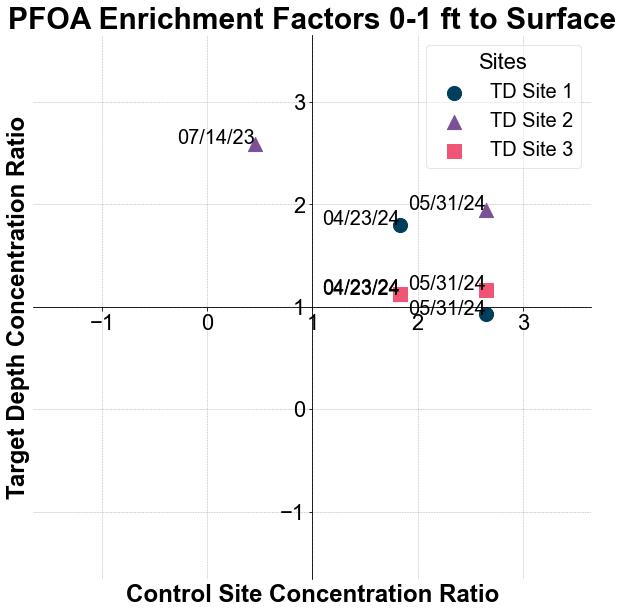

In [ ]:
plot_enrichment_factors(numerator_1toSurface, denominator_1toSurface,compound='PFOA',custom_title='PFOA Enrichment Factors 0-1 ft to Surface')

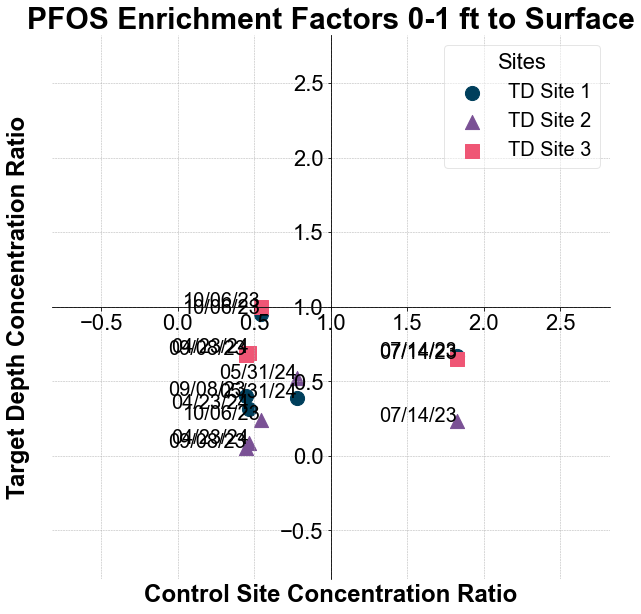

In [ ]:
plot_enrichment_factors(numerator_1toSurface, denominator_1toSurface,compound='PFOS',custom_title='PFOS Enrichment Factors 0-1 ft to Surface')

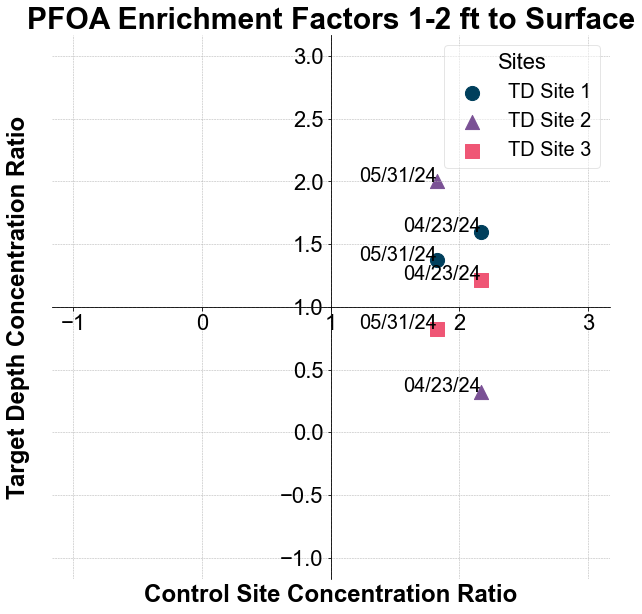

In [ ]:
plot_enrichment_factors(numerator_2toSurface, denominator_2toSurface,compound='PFOA',custom_title='PFOA Enrichment Factors 1-2 ft to Surface')

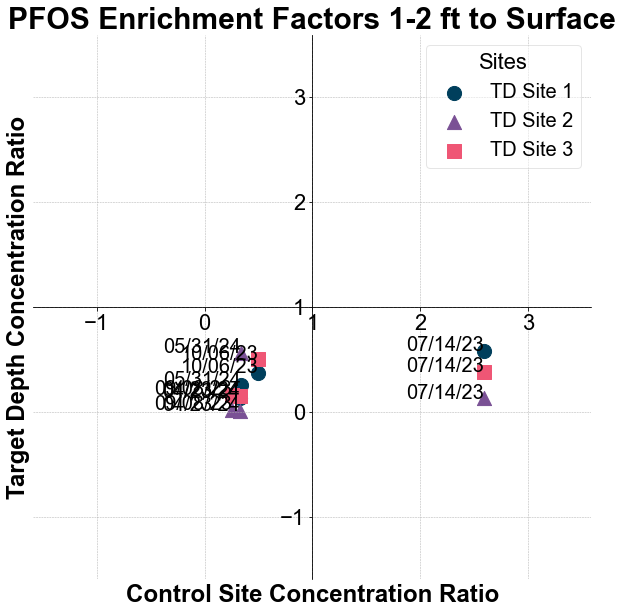

In [ ]:
plot_enrichment_factors(numerator_2toSurface, denominator_2toSurface,compound='PFOS',custom_title='PFOS Enrichment Factors 1-2 ft to Surface')

## Biosolids and Land-applied soils

### Functions

In [ ]:
def create_pivot_table(data_df, filter_type=None, filter_qual_summary=None, field_filter=None, pfas_compound_filter=None, aggfunc='mean', region_prefix=None):
    """
    Create a pivot table from the given dataframe with user-defined filters and optional region prefix.

    Args:
        data_df (pd.DataFrame): The input dataframe.
        filter_type (list, optional): Filter values for 'Type'.
        filter_qual_summary (list, optional): Filter values for 'Qual Summary (Grade for filtering)'.
        field_filter (list, optional): Filter values for 'Field'.
        pfas_compound_filter (list, optional): Filter values for 'PFAS Compound'.
        aggfunc (str, optional): The aggregation function to apply to the values in the pivot table (default is 'mean').
        region_prefix (str, optional): Prefix to be added to the second level column names.

    Returns:
        pd.DataFrame: The resulting pivot table.
    """
    # Apply filters based on user-provided values
    filtered_data = data_df

    if filter_type:
        filtered_data = filtered_data[filtered_data['Type'].isin(filter_type)]

    if filter_qual_summary:
        filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

    if field_filter:
        filtered_data = filtered_data[filtered_data['Field'].isin(field_filter)]

    if pfas_compound_filter:
        filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(pfas_compound_filter)]

    pivot_table = pd.pivot_table(
        filtered_data,
        values='Quant Incl Estimates Incl Qual Flags',
        index='PFAS Compound',
        columns=['Type', 'Region', 'Depth'],
        aggfunc=aggfunc,
        fill_value=np.nan
    )

    # Add prefix to the second level column names if prefix is provided
    if region_prefix:
        pivot_table.columns = pd.MultiIndex.from_tuples(
            [(col[0], f'{region_prefix} {col[1]}' if col[0] != 'Type' and col[0] != 'Depth' else col[1], col[2]) for col in pivot_table.columns]
        )

    return pivot_table

In [ ]:
def calculate_standard_error(average_pivot, std_dev_pivot, count_pivot):
    """
    Calculate the standard error pivot table, aligning structures if necessary.

    Args:
        average_pivot (pd.DataFrame): Pivot table of averages.
        std_dev_pivot (pd.DataFrame): Pivot table of standard deviations.
        count_pivot (pd.DataFrame): Pivot table of counts.

    Returns:
        pd.DataFrame: Pivot table of standard errors.
    """
    # Align the structure of the std_dev_pivot with average_pivot and count_pivot
    std_dev_pivot_aligned = std_dev_pivot.reindex_like(average_pivot).fillna(np.NaN)

    # Calculate the standard error
    standard_error_pivot = std_dev_pivot_aligned / np.sqrt(count_pivot)

    return standard_error_pivot

In [ ]:
def combine_pivot_tables(pivot_table1, pivot_table2, prefix1=None, prefix2=None):
    """
    Combine two pivot tables side by side.

    Args:
        pivot_table1 (pd.DataFrame): First pivot table.
        pivot_table2 (pd.DataFrame): Second pivot table.
        prefix1 (str, optional): Prefix for the columns of the first pivot table.
        prefix2 (str, optional): Prefix for the columns of the second pivot table.

    Returns:
        pd.DataFrame: Combined pivot table.
    """
    # Add prefixes to the column names if provided
    if prefix1:
        pivot_table1 = pivot_table1.add_prefix(f"{prefix1} ")
    if prefix2:
        pivot_table2 = pivot_table2.add_prefix(f"{prefix2} ")

    # Combine the pivot tables side by side
    combined_pivot_table = pd.concat([pivot_table1, pivot_table2], axis=1)

    return combined_pivot_table

### Settings and Filters

In [ ]:
#qual_summary_filter (list): Filter values for 'Qual Summary (Grade for filtering)'.
filter_qual_summary = ['Good','Probably Ok','']
#field_filter (list): Filter values for 'Field'.
field_filter = ['nan', 'LINPMM21-31','SHRMMR07-HE','SHRJHD16-BD', 'LINPMM19-40', 'SHRBTG30-AX', 'SHRBTG30-DX','SHRMMR30-CX', 'SHRMMR31-AX']
#type_filter (list): Filter values for 'Type'.
filter_type= ['Biosolids','Soils']
#pfas_compound_filter (list): Filter values for 'PFAS Compound'.
pfas_compound_filter=['Perfluorooctanesulfonic acid (PFOS)','Perfluorooctanoic acid (PFOA)']

### Biosolids Pivot Tables

In [ ]:
filter_type=['Biosolids']
field_filter=None
aggfunc='mean'
filtered_data = data_df

if filter_type:
    filtered_data = filtered_data[filtered_data['Type'].isin(filter_type)]

if filter_qual_summary:
    filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

if field_filter:
    filtered_data = filtered_data[filtered_data['Field'].isin(field_filter)]

if pfas_compound_filter:
    filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(pfas_compound_filter)]

Biosolids_Avg_Pivot = pd.pivot_table(
    filtered_data,
    values='Quant Incl Estimates Incl Qual Flags',
    index='PFAS Compound',
    columns=['Type'],
    aggfunc=aggfunc,
    fill_value=np.nan
)


Biosolids_Avg_Pivot.index = Biosolids_Avg_Pivot.index.map(pfas_mapping)

desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in Biosolids_Avg_Pivot.index]
# Reorder the DataFrame
Biosolids_Avg_Pivot = Biosolids_Avg_Pivot.loc[filtered_order]
Biosolids_Avg_Pivot

Type,Biosolids
PFAS Compound,
PFOA,1.356154
PFOS,13.996154


In [ ]:
filter_type=['Biosolids']
field_filter=None
aggfunc='std'
filtered_data = data_df

if filter_type:
    filtered_data = filtered_data[filtered_data['Type'].isin(filter_type)]

if filter_qual_summary:
    filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

if field_filter:
    filtered_data = filtered_data[filtered_data['Field'].isin(field_filter)]

if pfas_compound_filter:
    filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(pfas_compound_filter)]

Biosolids_Std_Pivot = pd.pivot_table(
    filtered_data,
    values='Quant Incl Estimates Incl Qual Flags',
    index='PFAS Compound',
    columns=['Type'],
    aggfunc=aggfunc,
    fill_value=np.nan
)

Biosolids_Std_Pivot.index = Biosolids_Std_Pivot.index.map(pfas_mapping)

desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in Biosolids_Std_Pivot.index]
# Reorder the DataFrame
Biosolids_Std_Pivot = Biosolids_Std_Pivot.loc[filtered_order]
Biosolids_Std_Pivot

Type,Biosolids
PFAS Compound,
PFOA,1.505975
PFOS,4.286955


In [ ]:
filter_type=['Biosolids']
field_filter=None
aggfunc='count'
filtered_data = data_df

if filter_type:
    filtered_data = filtered_data[filtered_data['Type'].isin(filter_type)]

if filter_qual_summary:
    filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

if field_filter:
    filtered_data = filtered_data[filtered_data['Field'].isin(field_filter)]

if pfas_compound_filter:
    filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(pfas_compound_filter)]

Biosolids_Count_Pivot = pd.pivot_table(
    filtered_data,
    values='Quant Incl Estimates Incl Qual Flags',
    index='PFAS Compound',
    columns=['Type'],
    aggfunc=aggfunc,
    fill_value=np.nan
)


Biosolids_Count_Pivot.index = Biosolids_Count_Pivot.index.map(pfas_mapping)

desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in Biosolids_Count_Pivot.index]
# Reorder the DataFrame
Biosolids_Count_Pivot = Biosolids_Count_Pivot.loc[filtered_order]
Biosolids_Count_Pivot

Type,Biosolids
PFAS Compound,
PFOA,26
PFOS,26


In [ ]:
Biosolids_error_pivot=calculate_standard_error(Biosolids_Avg_Pivot, Biosolids_Std_Pivot, Biosolids_Count_Pivot)
Biosolids_error_pivot

Type,Biosolids
PFAS Compound,
PFOA,0.295346
PFOS,0.840741


###  Create Pivot Table for Average PFAS Concentrations

In [ ]:
#field_filter (list): Filter values for 'Field'.
field_filter = ['nan', 'LINPMM21-31','SHRMMR07-HE','SHRJHD16-BD', 'LINPMM19-40', 'SHRBTG30-AX', 'SHRBTG30-DX','SHRMMR30-CX', 'SHRMMR31-AX']
#type_filter (list): Filter values for 'Type'.
filter_type= ['Biosolids','Soils']

In [ ]:
average_pivot=create_pivot_table(data_df, filter_type=filter_type, filter_qual_summary=filter_qual_summary, field_filter=field_filter, pfas_compound_filter=pfas_compound_filter, aggfunc='mean')
average_pivot.index = average_pivot.index.map(pfas_mapping)

desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in average_pivot.index]
# Reorder the DataFrame
average_pivot = average_pivot.loc[filtered_order]

average_pivot

Type                   Soils                                                  \
Region        Eastern Oregon                     Willamette Valley             
Depth                 0-1 ft    1-2 ft   Surface            0-1 ft    1-2 ft   
PFAS Compound                                                                  
PFOA                1.480000  0.194545  2.581429          1.035556  1.117778   
PFOS                0.291364  0.064727  2.727143          3.960000  2.007778   

Type                     
Region                   
Depth           Surface  
PFAS Compound            
PFOA           0.613333  
PFOS           4.883333

In [ ]:
std_dev_pivot=create_pivot_table(data_df, filter_type=filter_type, filter_qual_summary=filter_qual_summary, field_filter=field_filter, pfas_compound_filter=pfas_compound_filter, aggfunc='std')

std_dev_pivot.index = std_dev_pivot.index.map(pfas_mapping)
desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in std_dev_pivot.index]
# Reorder the DataFrame
std_dev_pivot = std_dev_pivot.loc[filtered_order]

std_dev_pivot

Type                   Soils                                                  \
Region        Eastern Oregon                     Willamette Valley             
Depth                 0-1 ft    1-2 ft   Surface            0-1 ft    1-2 ft   
PFAS Compound                                                                  
PFOA                1.548774  0.200218  2.238485          0.350218  1.333293   
PFOS                0.365377  0.125051  1.733404          3.345792  2.490491   

Type                     
Region                   
Depth           Surface  
PFAS Compound            
PFOA           0.195516  
PFOS           1.321237

In [ ]:
count_pivot=create_pivot_table(data_df, filter_type=filter_type, filter_qual_summary=filter_qual_summary, field_filter=field_filter, pfas_compound_filter=pfas_compound_filter, aggfunc='count')

count_pivot.index = count_pivot.index.map(pfas_mapping)
desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in count_pivot.index]
# Reorder the DataFrame
count_pivot = count_pivot.loc[filtered_order]

count_pivot

Type                   Soils                                                
Region        Eastern Oregon                Willamette Valley               
Depth                 0-1 ft 1-2 ft Surface            0-1 ft 1-2 ft Surface
PFAS Compound                                                               
PFOA                      11     11       7                 9      9       6
PFOS                      11     11       7                 9      9       6

In [ ]:
error_pivot=calculate_standard_error(average_pivot, std_dev_pivot, count_pivot)
error_pivot

Type                   Soils                                                  \
Region        Eastern Oregon                     Willamette Valley             
Depth                 0-1 ft    1-2 ft   Surface            0-1 ft    1-2 ft   
PFAS Compound                                                                  
PFOA                0.466973  0.060368  0.846068          0.116739  0.444431   
PFOS                0.110165  0.037704  0.655165          1.115264  0.830164   

Type                     
Region                   
Depth           Surface  
PFAS Compound            
PFOA           0.079819  
PFOS           0.539393

###  Create Pivot Tables for Control Site for Average PFAS Concentrations

In [ ]:
control_avg_pivot=create_pivot_table(data_df, filter_type=filter_type, filter_qual_summary=filter_qual_summary, field_filter=['Control'], pfas_compound_filter=pfas_compound_filter, aggfunc='mean',region_prefix='Control')

control_avg_pivot.index = control_avg_pivot.index.map(pfas_mapping)
desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in control_avg_pivot.index]
# Reorder the DataFrame
control_avg_pivot = control_avg_pivot.loc[filtered_order]

control_avg_pivot

Soils                                           \
              Control Eastern Oregon                Control Willamette Valley   
                              0-1 ft 1-2 ft Surface                    0-1 ft   
PFAS Compound                                                                   
PFOA                        0.031667      0   0.017                      0.00   
PFOS                        0.000000      0   0.018                      0.54   

                              
                              
              1-2 ft Surface  
PFAS Compound                 
PFOA               0   0.320  
PFOS               0   0.685

In [ ]:
control_std_pivot=create_pivot_table(data_df, filter_type=filter_type, filter_qual_summary=filter_qual_summary, field_filter=['Control'], pfas_compound_filter=pfas_compound_filter, aggfunc='std',region_prefix='Control')

control_std_pivot.index = control_std_pivot.index.map(pfas_mapping)
desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in control_std_pivot.index]
# Reorder the DataFrame
control_std_pivot = control_std_pivot.loc[filtered_order]

control_std_pivot

Soils                   \
              Control Eastern Oregon                    
                              0-1 ft 1-2 ft   Surface   
PFAS Compound                                           
PFOA                        0.054848      0  0.029445   
PFOS                        0.000000      0  0.031177   

                                         
              Control Willamette Valley  
                                Surface  
PFAS Compound                            
PFOA                           0.452548  
PFOS                           0.586899

In [ ]:
control_count_pivot=create_pivot_table(data_df, filter_type=filter_type, filter_qual_summary=filter_qual_summary, field_filter=['Control'], pfas_compound_filter=pfas_compound_filter, aggfunc='count',region_prefix='Control')

control_count_pivot.index = control_count_pivot.index.map(pfas_mapping)
desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in control_count_pivot.index]
# Reorder the DataFrame
control_count_pivot = control_count_pivot.loc[filtered_order]

control_count_pivot

Soils                                           \
              Control Eastern Oregon                Control Willamette Valley   
                              0-1 ft 1-2 ft Surface                    0-1 ft   
PFAS Compound                                                                   
PFOA                               3      3       3                         1   
PFOS                               3      3       3                         1   

                              
                              
              1-2 ft Surface  
PFAS Compound                 
PFOA               1       2  
PFOS               1       2

In [ ]:
control_error_pivot=calculate_standard_error(control_avg_pivot, control_std_pivot, control_count_pivot)
control_error_pivot

Soils                                           \
              Control Eastern Oregon                Control Willamette Valley   
                              0-1 ft 1-2 ft Surface                    0-1 ft   
PFAS Compound                                                                   
PFOA                        0.031667    0.0   0.017                       NaN   
PFOS                        0.000000    0.0   0.018                       NaN   

                              
                              
              1-2 ft Surface  
PFAS Compound                 
PFOA             NaN   0.320  
PFOS             NaN   0.415

### Combine Pivot Tables for Comparision with Control Site

In [ ]:
avg_all_pivot=combine_pivot_tables(pivot_table1=average_pivot, pivot_table2=control_avg_pivot, prefix1=None, prefix2=None)
avg_all_pivot

Type                   Soils                                                  \
Region        Eastern Oregon                     Willamette Valley             
Depth                 0-1 ft    1-2 ft   Surface            0-1 ft    1-2 ft   
PFAS Compound                                                                  
PFOA                1.480000  0.194545  2.581429          1.035556  1.117778   
PFOS                0.291364  0.064727  2.727143          3.960000  2.007778   

Type                                                           \
Region                  Control Eastern Oregon                  
Depth           Surface                 0-1 ft 1-2 ft Surface   
PFAS Compound                                                   
PFOA           0.613333               0.031667      0   0.017   
PFOS           4.883333               0.000000      0   0.018   

Type                                                    
Region        Control Willamette Valley                 
Depth                            0-1 ft 1-2 ft Surface  
PFAS Compound                                           
PFOA                               0.00      0   0.320  
PFOS                               0.54      0   0.685

In [ ]:
# Add two new levels to df_single
new_levels = [(col,'', 'Biosolids') for col in Biosolids_Avg_Pivot.columns]
Biosolids_Avg_Pivot.columns = pd.MultiIndex.from_tuples(new_levels)
Biosolids_Avg_Pivot

,Biosolids
,
,Biosolids
PFAS Compound,
PFOA,1.356154
PFOS,13.996154


In [ ]:
def reorder_columns(df):
    # Define custom order for regions and depths
    region_order = {
        "Control Eastern Oregon": 1, 
        "Eastern Oregon": 2, 
        "Control Willamette Valley": 3, 
        "Willamette Valley": 4
    }
    depth_order = {
        'Surface': 1,
        '0-1 ft': 2,
        '1-2 ft': 3
    }

    # Function to create a sort key for each column based on custom order
    def sort_key(col):
        type_, region, depth = col
        # Assign a large number to regions or depths not in the custom order to keep them at the end
        region_rank = region_order.get(region, 999)
        depth_rank = depth_order.get(depth, 999)
        return (region_rank, depth_rank)

    # Sort columns using the custom sort key
    sorted_columns = sorted(df.columns, key=sort_key)

    # Reindex the DataFrame with the sorted columns
    return df.reindex(columns=sorted_columns)

# Assume avg_all_pivot is your DataFrame loaded with the multi-level columns
avg_all_pivot = reorder_columns(avg_all_pivot)

# Print the reordered DataFrame to verify the new column order
avg_all_pivot

Type                           Soils                                  \
Region        Control Eastern Oregon                  Eastern Oregon   
Depth                        Surface    0-1 ft 1-2 ft        Surface   
PFAS Compound                                                          
PFOA                           0.017  0.031667      0       2.581429   
PFOS                           0.018  0.000000      0       2.727143   

Type                                                                       \
Region                            Control Willamette Valley                 
Depth            0-1 ft    1-2 ft                   Surface 0-1 ft 1-2 ft   
PFAS Compound                                                               
PFOA           1.480000  0.194545                     0.320   0.00      0   
PFOS           0.291364  0.064727                     0.685   0.54      0   

Type                                                 
Region        Willamette Valley                      
Depth                   Surface    0-1 ft    1-2 ft  
PFAS Compound                                        
PFOA                   0.613333  1.035556  1.117778  
PFOS                   4.883333  3.960000  2.007778

In [ ]:
# Combine the pivot tables side by side
avg_all_pivot = pd.concat([Biosolids_Avg_Pivot,avg_all_pivot], axis=1)

avg_all_pivot

Biosolids                  Soils                   \
                         Control Eastern Oregon                    
               Biosolids                Surface    0-1 ft 1-2 ft   
PFAS Compound                                                      
PFOA            1.356154                  0.017  0.031667      0   
PFOS           13.996154                  0.018  0.000000      0   

                                                                            \
              Eastern Oregon                     Control Willamette Valley   
                     Surface    0-1 ft    1-2 ft                   Surface   
PFAS Compound                                                                
PFOA                2.581429  1.480000  0.194545                     0.320   
PFOS                2.727143  0.291364  0.064727                     0.685   

                                                                   
                            Willamette Valley                      
              0-1 ft 1-2 ft           Surface    0-1 ft    1-2 ft  
PFAS Compound                                                      
PFOA            0.00      0          0.613333  1.035556  1.117778  
PFOS            0.54      0          4.883333  3.960000  2.007778

In [ ]:
error_all_pivot=combine_pivot_tables(pivot_table1=error_pivot, pivot_table2=control_error_pivot, prefix1=None, prefix2=None)
error_all_pivot

Type                   Soils                                                  \
Region        Eastern Oregon                     Willamette Valley             
Depth                 0-1 ft    1-2 ft   Surface            0-1 ft    1-2 ft   
PFAS Compound                                                                  
PFOA                0.466973  0.060368  0.846068          0.116739  0.444431   
PFOS                0.110165  0.037704  0.655165          1.115264  0.830164   

Type                                                           \
Region                  Control Eastern Oregon                  
Depth           Surface                 0-1 ft 1-2 ft Surface   
PFAS Compound                                                   
PFOA           0.079819               0.031667    0.0   0.017   
PFOS           0.539393               0.000000    0.0   0.018   

Type                                                    
Region        Control Willamette Valley                 
Depth                            0-1 ft 1-2 ft Surface  
PFAS Compound                                           
PFOA                                NaN    NaN   0.320  
PFOS                                NaN    NaN   0.415

In [ ]:
# Add two new levels to df_single
new_levels = [(col,'', 'Biosolids') for col in Biosolids_error_pivot.columns]
Biosolids_error_pivot.columns = pd.MultiIndex.from_tuples(new_levels)
Biosolids_error_pivot

,Biosolids
,
,Biosolids
PFAS Compound,
PFOA,0.295346
PFOS,0.840741


In [ ]:
# Assume avg_all_pivot is your DataFrame loaded with the multi-level columns
error_all_pivot = reorder_columns(error_all_pivot)

# Print the reordered DataFrame to verify the new column order
error_all_pivot


Type                           Soils                                  \
Region        Control Eastern Oregon                  Eastern Oregon   
Depth                        Surface    0-1 ft 1-2 ft        Surface   
PFAS Compound                                                          
PFOA                           0.017  0.031667    0.0       0.846068   
PFOS                           0.018  0.000000    0.0       0.655165   

Type                                                                       \
Region                            Control Willamette Valley                 
Depth            0-1 ft    1-2 ft                   Surface 0-1 ft 1-2 ft   
PFAS Compound                                                               
PFOA           0.466973  0.060368                     0.320    NaN    NaN   
PFOS           0.110165  0.037704                     0.415    NaN    NaN   

Type                                                 
Region        Willamette Valley                      
Depth                   Surface    0-1 ft    1-2 ft  
PFAS Compound                                        
PFOA                   0.079819  0.116739  0.444431  
PFOS                   0.539393  1.115264  0.830164

In [ ]:
# Combine the pivot tables side by side
error_all_pivot = pd.concat([Biosolids_error_pivot,error_all_pivot], axis=1)

error_all_pivot

Biosolids                  Soils                   \
                        Control Eastern Oregon                    
              Biosolids                Surface    0-1 ft 1-2 ft   
PFAS Compound                                                     
PFOA           0.295346                  0.017  0.031667    0.0   
PFOS           0.840741                  0.018  0.000000    0.0   

                                                                            \
              Eastern Oregon                     Control Willamette Valley   
                     Surface    0-1 ft    1-2 ft                   Surface   
PFAS Compound                                                                
PFOA                0.846068  0.466973  0.060368                     0.320   
PFOS                0.655165  0.110165  0.037704                     0.415   

                                                                   
                            Willamette Valley                      
              0-1 ft 1-2 ft           Surface    0-1 ft    1-2 ft  
PFAS Compound                                                      
PFOA             NaN    NaN          0.079819  0.116739  0.444431  
PFOS             NaN    NaN          0.539393  1.115264  0.830164

### Create Bar Chart

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.transforms import Bbox

def plot_pfas_by_depth(df,error_df, pfas_colors_dict, figsize=(15, 10), lower_ylim=(0, 30), upper_ylim=(800, 900)):
    """
    Plots a bar chart of PFAS concentrations with a broken y-axis, modified to adjust the positioning of the split and legend.

    Args:
    df (pd.DataFrame): DataFrame with PFAS concentrations. Index should be PFAS compounds.
    pfas_colors_dict (dict): Dictionary mapping PFAS compounds to specific colors.
    figsize (tuple): Figure size for the plot.
    lower_ylim (tuple): The y-axis range for the lower subplot.
    upper_ylim (tuple): The y-axis range for the upper subplot.
    """
    # Create the plot with two vertical axes
    fig, (ax, ax2) = plt.subplots(2, 1, sharex=True, figsize=figsize, gridspec_kw={'height_ratios': [1, 5], 'hspace': 0.1})
    
    # Number of PFAS compounds
    num_pfas = len(df.index)
    # Width of each individual bar
    total_width = 0.8
    bar_width = total_width / num_pfas
    offsets = np.arange(len(df.columns))

    # Loop over each PFAS compound
    for i, compound in enumerate(df.index):
        # Calculate offset for each compound
        compound_offsets = offsets + (i - num_pfas / 2) * bar_width + bar_width / 2
        color = pfas_colors_dict.get(compound, 'grey')  # Default to grey if not specified

        # Plot on both upper and lower axes
        ax.bar(compound_offsets, df.loc[compound], width=bar_width, label=compound, color=color,yerr=error_df.loc[compound], capsize=5)
        ax2.bar(compound_offsets, df.loc[compound], width=bar_width, color=color,yerr=error_df.loc[compound], capsize=5)

    # Set the limits for the two y-axes
    ax.set_ylim(upper_ylim)  # Upper axis
    ax2.set_ylim(lower_ylim)  # Lower axis

    # Hide the spines between ax and ax2
    ax.spines['bottom'].set_visible(False)
    ax2.spines['top'].set_visible(False)
    ax.tick_params(labelbottom=False, bottom=False) 

    # Diagonal lines to indicate the break
    d = .005  # size of diagonal lines
    kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
                linestyle="none", color='k', mec='k', mew=3, clip_on=False)
    ax.plot([0, 1], [0, 0], transform=ax.transAxes, **kwargs)
    ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
    
    # Fill the gap between breaks
    gap_start = lower_ylim[1]  # Start of the gap
    gap_end = upper_ylim[0]    # End of the gap
    ax2.fill_betweenx(y=[gap_start, 800], x1=ax2.get_xlim()[0], x2=ax2.get_xlim()[1], color='gray', alpha=0.5)

    # Set x-ticks to be in the middle of the group of bars for each column
    ax2.set_xticks(np.arange(len(df.columns)))
    ax2.set_xticklabels([col[-1] for col in df.columns], rotation=90)  # Set labels for columns

    # Labelling axes
    ax.set_title('')
    fig.text(0.07, 0.5, 'PFAS Concentration (ng/g)', va='center', rotation='vertical', fontsize=28,fontweight='bold')
    
     # Consolidating legend from all subplots
    handles, labels = [], []
    for ax in fig.axes:
        for handle, label in zip(*ax.get_legend_handles_labels()):
            handles.append(handle)
            labels.append(label)
    fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -.25), ncol=3, title="PFAS Compounds")

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.savefig("Biosolids.jpeg",transparent =False) 
    plt.show()

# Example usage:
# Assuming df is your DataFrame and pfas_colors_dict is your dictionary of colors
# plot_pfas_by_depth(df, pfas_colors_dict)

c:\Users\rodriguezc\Anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
c:\Users\rodriguezc\Anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
c:\Users\rodriguezc\Anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
c:\Users\rodriguezc\Anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
c:\Users\rodriguezc\Anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
c:\Users\rodriguezc\Anaconda3\

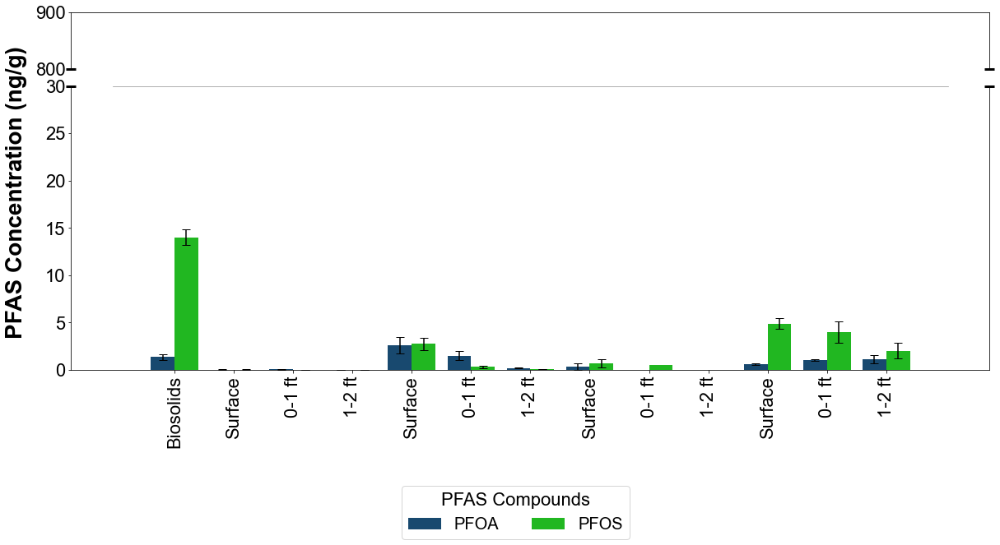

In [ ]:
plot_pfas_by_depth(df=avg_all_pivot,error_df=error_all_pivot,pfas_colors_dict=compound_colors_dict_abbrev,figsize=(20,8), lower_ylim=(0, 30), upper_ylim=(800, 900))


## Radar Plots

### Eastern Oregon and Willamette Valley Tables

In [33]:
def combine_pivot_tables(pivot_table1, pivot_table2, prefix1=None, prefix2=None):
    """
    Combine two pivot tables side by side.

    Args:
        pivot_table1 (pd.DataFrame): First pivot table.
        pivot_table2 (pd.DataFrame): Second pivot table.
        prefix1 (str, optional): Prefix for the columns of the first pivot table.
        prefix2 (str, optional): Prefix for the columns of the second pivot table.

    Returns:
        pd.DataFrame: Combined pivot table.
    """
    # Add prefixes to the column names if provided
    if prefix1:
        pivot_table1 = pivot_table1.add_prefix(f"{prefix1} ")
    if prefix2:
        pivot_table2 = pivot_table2.add_prefix(f"{prefix2} ")

    # Combine the pivot tables side by side
    combined_pivot_table = pd.concat([pivot_table1, pivot_table2], axis=1)

    return combined_pivot_table

In [34]:
def create_pivot_table(data_df, filter_type=None, filter_qual_summary=None, field_filter=None, pfas_compound_filter=None, aggfunc='mean', region_prefix=None):
    """
    Create a pivot table from the given dataframe with user-defined filters and optional region prefix.

    Args:
        data_df (pd.DataFrame): The input dataframe.
        filter_type (list, optional): Filter values for 'Type'.
        filter_qual_summary (list, optional): Filter values for 'Qual Summary (Grade for filtering)'.
        field_filter (list, optional): Filter values for 'Field'.
        pfas_compound_filter (list, optional): Filter values for 'PFAS Compound'.
        aggfunc (str, optional): The aggregation function to apply to the values in the pivot table (default is 'mean').
        region_prefix (str, optional): Prefix to be added to the second level column names.

    Returns:
        pd.DataFrame: The resulting pivot table.
    """
    # Apply filters based on user-provided values
    filtered_data = data_df

    if filter_type:
        filtered_data = filtered_data[filtered_data['Type'].isin(filter_type)]

    if filter_qual_summary:
        filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

    if field_filter:
        filtered_data = filtered_data[filtered_data['Field'].isin(field_filter)]

    if pfas_compound_filter:
        filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(pfas_compound_filter)]

    pivot_table = pd.pivot_table(
        filtered_data,
        values='Quant Incl Estimates Incl Qual Flags',
        index='PFAS Compound',
        columns=['Type', 'Region', 'Depth'],
        aggfunc=aggfunc,
        fill_value=np.nan
    )

    # Add prefix to the second level column names if prefix is provided
    if region_prefix:
        pivot_table.columns = pd.MultiIndex.from_tuples(
            [(col[0], f'{region_prefix} {col[1]}' if col[0] != 'Type' and col[0] != 'Depth' else col[1], col[2]) for col in pivot_table.columns]
        )

    return pivot_table

In [35]:
filter_type=['Biosolids']
field_filter=None
aggfunc='mean'
filtered_data = data_df
filter_qual_summary=['Good','Probably Ok','Probably ok']
pfas_compound_filter=['NEtFOSAA',
 'Perfluorobutanesulfonic acid',
 'Perfluorobutanoic acid',
 'Perfluorodecanesulfonic acid',
 'Perfluorodecanoic acid',
 'Perfluorododecanoic acid',
 'Perfluoroheptanesulfonic acid',
 'Perfluoroheptanoic acid',
 'Perfluorohexanesulfonic acid',
 'Perfluorohexanoic acid',
 'Perfluorononanoic acid',
 'Perfluorooctanesulfonic acid (PFOS)',
 'Perfluorooctanoic acid (PFOA)',
 'Perfluoropentanoic acid',
 'Perfluoroundecanoic acid']

if filter_type:
    filtered_data = filtered_data[filtered_data['Type'].isin(filter_type)]

if filter_qual_summary:
    filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

if field_filter:
    filtered_data = filtered_data[filtered_data['Field'].isin(field_filter)]

if pfas_compound_filter:
    filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(pfas_compound_filter)]

Biosolids_Avg_Pivot = pd.pivot_table(
    filtered_data,
    values='Quant Incl Estimates Incl Qual Flags',
    index='PFAS Compound',
    columns=['Type'],
    aggfunc=aggfunc,
    fill_value=np.nan
)


Biosolids_Avg_Pivot.index = Biosolids_Avg_Pivot.index.map(pfas_mapping)

desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in Biosolids_Avg_Pivot.index]
# Reorder the DataFrame
Biosolids_Avg_Pivot = Biosolids_Avg_Pivot.loc[filtered_order]
Biosolids_Avg_Pivot

Type,Biosolids
PFAS Compound,
PFBA,0.000000
PFPeA,0.020741
PFHxA,0.883704
PFHpA,0.023704
PFOA,1.354074
PFNA,1.394074
PFDA,4.122222
PFUnA,2.959259
PFDoA,2.533333


In [36]:
# Add two new levels to df_single
new_levels = [(col,'', 'Biosolids') for col in Biosolids_Avg_Pivot.columns]
Biosolids_Avg_Pivot.columns = pd.MultiIndex.from_tuples(new_levels)
Biosolids_Avg_Pivot

,Biosolids
,
,Biosolids
PFAS Compound,
PFBA,0.000000
PFPeA,0.020741
PFHxA,0.883704
PFHpA,0.023704
PFOA,1.354074
PFNA,1.394074
PFDA,4.122222


In [37]:
#field_filter (list): Filter values for 'Field'.
field_filter = ['nan', 'LINPMM21-31','SHRMMR07-HE','SHRJHD16-BD', 'LINPMM19-40', 'SHRBTG30-AX', 'SHRBTG30-DX','SHRMMR30-CX', 'SHRMMR31-AX']
#type_filter (list): Filter values for 'Type'.
filter_type= ['Biosolids','Soils']
pfas_compound_filter=['NEtFOSAA',
 'Perfluorobutanesulfonic acid',
 'Perfluorobutanoic acid',
 'Perfluorodecanesulfonic acid',
 'Perfluorodecanoic acid',
 'Perfluorododecanoic acid',
 'Perfluoroheptanesulfonic acid',
 'Perfluoroheptanoic acid',
 'Perfluorohexanesulfonic acid',
 'Perfluorohexanoic acid',
 'Perfluorononanoic acid',
 'Perfluorooctanesulfonic acid (PFOS)',
 'Perfluorooctanoic acid (PFOA)',
 'Perfluoropentanoic acid',
 'Perfluoroundecanoic acid']

In [38]:
average_pivot=create_pivot_table(data_df_radar, filter_type=filter_type, filter_qual_summary=filter_qual_summary, field_filter=field_filter, pfas_compound_filter=pfas_compound_filter, aggfunc='mean')
average_pivot.index = average_pivot.index.map(pfas_mapping)

desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in average_pivot.index]
# Reorder the DataFrame
average_pivot = average_pivot.loc[filtered_order]

average_pivot

Type                   Soils                                                  \
Region        Eastern Oregon                     Willamette Valley             
Depth                 0-1 ft    1-2 ft   Surface            0-1 ft    1-2 ft   
PFAS Compound                                                                  
PFBA                0.137273  0.154545  0.000000           0.00000  0.000000   
PFPeA               0.415455  0.654545  0.000000           0.17750  0.042222   
PFHxA               0.200000  0.403636  0.026286           0.11500  0.065556   
PFHpA               0.309091  0.221818  0.076286           0.07375  0.097778   
PFOA                1.480000  0.194545  2.581429           1.06375  1.117778   
PFNA                0.149636  0.000000  1.065714           0.13500  0.088889   
PFDA                0.225545  0.036273  2.015714           0.17875  0.000000   
PFUnA               0.018182  0.000000  0.400000           0.00000  0.000000   
PFDoA               0.048182  0.000000  0.590000           0.00000  0.000000   
NEtFOSAA            0.153182  0.000000  1.338571           0.15625  0.000000   
PFBS                0.020000  0.116364  0.024714           0.00000  0.000000   
PFHxS               0.020818  0.000000  0.020571           0.00000  0.000000   
PFHpS               0.000000  0.000000  0.007571           0.00000  0.000000   
PFOS                0.291364  0.064727  2.727143           3.21750  2.007778   
PFDS                0.000000  0.000000  0.041143           0.00000  0.000000   

Type                     
Region                   
Depth           Surface  
PFAS Compound            
PFBA           0.000000  
PFPeA          0.315000  
PFHxA          0.038333  
PFHpA          0.000000  
PFOA           0.613333  
PFNA           0.256667  
PFDA           0.685000  
PFUnA          0.193333  
PFDoA          0.196667  
NEtFOSAA       0.496667  
PFBS           0.000000  
PFHxS          0.000000  
PFHpS          0.000000  
PFOS           4.883333  
PFDS           0.000000

In [39]:
control_avg_pivot=create_pivot_table(data_df_radar, filter_type=filter_type, filter_qual_summary=filter_qual_summary, field_filter=['Control'], pfas_compound_filter=pfas_compound_filter, aggfunc='mean',region_prefix='Control')

control_avg_pivot.index = control_avg_pivot.index.map(pfas_mapping)
desired_order = df['Abbrev'].tolist() 
# Filter desired_order to only include items that exist in df's index
filtered_order = [item for item in desired_order if item in control_avg_pivot.index]
# Reorder the DataFrame
control_avg_pivot = control_avg_pivot.loc[filtered_order]

control_avg_pivot

Soils                                           \
              Control Eastern Oregon                Control Willamette Valley   
                              0-1 ft 1-2 ft Surface                    0-1 ft   
PFAS Compound                                                                   
PFBA                        0.000000      0   0.000                      0.00   
PFPeA                       0.000000      0   0.000                      0.00   
PFHxA                       0.000000      0   0.000                      0.00   
PFHpA                       0.020000      0   0.000                      0.00   
PFOA                        0.031667      0   0.017                      0.00   
PFNA                        0.000000      0   0.000                      0.00   
PFDA                        0.000000      0   0.000                      0.00   
PFUnA                       0.000000      0   0.000                      0.00   
PFDoA                       0.000000      0   0.000                      0.00   
NEtFOSAA                    0.000000      0   0.000                      0.00   
PFBS                        0.000000      0   0.000                      0.00   
PFHxS                       0.000000      0   0.000                      0.00   
PFHpS                       0.000000      0   0.000                      0.00   
PFOS                        0.000000      0   0.018                      0.54   
PFDS                        0.000000      0   0.000                      0.00   

                              
                              
              1-2 ft Surface  
PFAS Compound                 
PFBA               0   0.000  
PFPeA              0   0.000  
PFHxA              0   0.000  
PFHpA              0   0.000  
PFOA               0   0.320  
PFNA               0   0.105  
PFDA               0   0.125  
PFUnA              0   0.000  
PFDoA              0   0.000  
NEtFOSAA           0   0.000  
PFBS               0   0.000  
PFHxS              0   0.000  
PFHpS              0   0.000  
PFOS               0   0.685  
PFDS               0   0.000

In [40]:
avg_all_pivot=combine_pivot_tables(pivot_table1=average_pivot, pivot_table2=control_avg_pivot, prefix1=None, prefix2=None)
avg_all_pivot

Soils                                                  \
              Eastern Oregon                     Willamette Valley             
                      0-1 ft    1-2 ft   Surface            0-1 ft    1-2 ft   
PFAS Compound                                                                  
PFBA                0.137273  0.154545  0.000000           0.00000  0.000000   
PFPeA               0.415455  0.654545  0.000000           0.17750  0.042222   
PFHxA               0.200000  0.403636  0.026286           0.11500  0.065556   
PFHpA               0.309091  0.221818  0.076286           0.07375  0.097778   
PFOA                1.480000  0.194545  2.581429           1.06375  1.117778   
PFNA                0.149636  0.000000  1.065714           0.13500  0.088889   
PFDA                0.225545  0.036273  2.015714           0.17875  0.000000   
PFUnA               0.018182  0.000000  0.400000           0.00000  0.000000   
PFDoA               0.048182  0.000000  0.590000           0.00000  0.000000   
NEtFOSAA            0.153182  0.000000  1.338571           0.15625  0.000000   
PFBS                0.020000  0.116364  0.024714           0.00000  0.000000   
PFHxS               0.020818  0.000000  0.020571           0.00000  0.000000   
PFHpS               0.000000  0.000000  0.007571           0.00000  0.000000   
PFOS                0.291364  0.064727  2.727143           3.21750  2.007778   
PFDS                0.000000  0.000000  0.041143           0.00000  0.000000   

                                                               \
                        Control Eastern Oregon                  
                Surface                 0-1 ft 1-2 ft Surface   
PFAS Compound                                                   
PFBA           0.000000               0.000000      0   0.000   
PFPeA          0.315000               0.000000      0   0.000   
PFHxA          0.038333               0.000000      0   0.000   
PFHpA          0.000000               0.020000      0   0.000   
PFOA           0.613333               0.031667      0   0.017   
PFNA           0.256667               0.000000      0   0.000   
PFDA           0.685000               0.000000      0   0.000   
PFUnA          0.193333               0.000000      0   0.000   
PFDoA          0.196667               0.000000      0   0.000   
NEtFOSAA       0.496667               0.000000      0   0.000   
PFBS           0.000000               0.000000      0   0.000   
PFHxS          0.000000               0.000000      0   0.000   
PFHpS          0.000000               0.000000      0   0.000   
PFOS           4.883333               0.000000      0   0.018   
PFDS           0.000000               0.000000      0   0.000   

                                                        
              Control Willamette Valley                 
                                 0-1 ft 1-2 ft Surface  
PFAS Compound                                           
PFBA                               0.00      0   0.000  
PFPeA                              0.00      0   0.000  
PFHxA                              0.00      0   0.000  
PFHpA                              0.00      0   0.000  
PFOA                               0.00      0   0.320  
PFNA                               0.00      0   0.105  
PFDA                               0.00      0   0.125  
PFUnA                              0.00      0   0.000  
PFDoA                              0.00      0   0.000  
NEtFOSAA                           0.00      0   0.000  
PFBS                               0.00      0   0.000  
PFHxS                              0.00      0   0.000  
PFHpS                              0.00      0   0.000  
PFOS                               0.54      0   0.685  
PFDS                               0.00      0   0.000

In [41]:
# Combine the pivot tables side by side
avg_all_pivot = pd.concat([Biosolids_Avg_Pivot,avg_all_pivot], axis=1)

avg_all_pivot

Biosolids          Soils                                        \
                         Eastern Oregon                     Willamette Valley   
               Biosolids         0-1 ft    1-2 ft   Surface            0-1 ft   
PFAS Compound                                                                   
PFBA            0.000000       0.137273  0.154545  0.000000           0.00000   
PFPeA           0.020741       0.415455  0.654545  0.000000           0.17750   
PFHxA           0.883704       0.200000  0.403636  0.026286           0.11500   
PFHpA           0.023704       0.309091  0.221818  0.076286           0.07375   
PFOA            1.354074       1.480000  0.194545  2.581429           1.06375   
PFNA            1.394074       0.149636  0.000000  1.065714           0.13500   
PFDA            4.122222       0.225545  0.036273  2.015714           0.17875   
PFUnA           2.959259       0.018182  0.000000  0.400000           0.00000   
PFDoA           2.533333       0.048182  0.000000  0.590000           0.00000   
NEtFOSAA        4.911538       0.153182  0.000000  1.338571           0.15625   
PFBS            0.050000       0.020000  0.116364  0.024714           0.00000   
PFHxS           0.253704       0.020818  0.000000  0.020571           0.00000   
PFHpS           0.144815       0.000000  0.000000  0.007571           0.00000   
PFOS           13.996296       0.291364  0.064727  2.727143           3.21750   
PFDS            1.009630       0.000000  0.000000  0.041143           0.00000   

                                                                         \
                                  Control Eastern Oregon                  
                 1-2 ft   Surface                 0-1 ft 1-2 ft Surface   
PFAS Compound                                                             
PFBA           0.000000  0.000000               0.000000      0   0.000   
PFPeA          0.042222  0.315000               0.000000      0   0.000   
PFHxA          0.065556  0.038333               0.000000      0   0.000   
PFHpA          0.097778  0.000000               0.020000      0   0.000   
PFOA           1.117778  0.613333               0.031667      0   0.017   
PFNA           0.088889  0.256667               0.000000      0   0.000   
PFDA           0.000000  0.685000               0.000000      0   0.000   
PFUnA          0.000000  0.193333               0.000000      0   0.000   
PFDoA          0.000000  0.196667               0.000000      0   0.000   
NEtFOSAA       0.000000  0.496667               0.000000      0   0.000   
PFBS           0.000000  0.000000               0.000000      0   0.000   
PFHxS          0.000000  0.000000               0.000000      0   0.000   
PFHpS          0.000000  0.000000               0.000000      0   0.000   
PFOS           2.007778  4.883333               0.000000      0   0.018   
PFDS           0.000000  0.000000               0.000000      0   0.000   

                                                        
              Control Willamette Valley                 
                                 0-1 ft 1-2 ft Surface  
PFAS Compound                                           
PFBA                               0.00      0   0.000  
PFPeA                              0.00      0   0.000  
PFHxA                              0.00      0   0.000  
PFHpA                              0.00      0   0.000  
PFOA                               0.00      0   0.320  
PFNA                               0.00      0   0.105  
PFDA                               0.00      0   0.125  
PFUnA                              0.00      0   0.000  
PFDoA                              0.00      0   0.000  
NEtFOSAA                           0.00      0   0.000  
PFBS                               0.00      0   0.000  
PFHxS                              0.00      0   0.000  
PFHpS                              0.00      0   0.000  
PFOS                               0.54      0   0.685  
PFDS                   

In [42]:
# Assuming 'df' is your DataFrame with the MultiIndex columns shown
# First, make sure your DataFrame's columns are a MultiIndex
if not isinstance(avg_all_pivot.columns, pd.MultiIndex):
    raise ValueError("DataFrame does not have a MultiIndex column.")

# Create a new single-level index for the columns
new_columns = [f"{Region} ({Depth})" for _, Region, Depth in avg_all_pivot.columns]

# Assign these new column names to the DataFrame
avg_all_pivot.columns = new_columns
avg_all_pivot.rename(columns={' (Biosolids)':'Biosolids'},inplace=True)
avg_all_pivot


,Biosolids,Eastern Oregon (0-1 ft),Eastern Oregon (1-2 ft),Eastern Oregon (Surface),Willamette Valley (0-1 ft),Willamette Valley (1-2 ft),Willamette Valley (Surface),Control Eastern Oregon (0-1 ft),Control Eastern Oregon (1-2 ft),Control Eastern Oregon (Surface),Control Willamette Valley (0-1 ft),Control Willamette Valley (1-2 ft),Control Willamette Valley (Surface)
PFAS Compound,,,,,,,,,,,,,
PFBA,0.000000,0.137273,0.154545,0.000000,0.00000,0.000000,0.000000,0.000000,0,0.000,0.00,0,0.000
PFPeA,0.020741,0.415455,0.654545,0.000000,0.17750,0.042222,0.315000,0.000000,0,0.000,0.00,0,0.000
PFHxA,0.883704,0.200000,0.403636,0.026286,0.11500,0.065556,0.038333,0.000000,0,0.000,0.00,0,0.000
PFHpA,0.023704,0.309091,0.221818,0.076286,0.07375,0.097778,0.000000,0.020000,0,0.000,0.00,0,0.000
PFOA,1.354074,1.480000,0.194545,2.581429,1.06375,1.117778,0.613333,0.031667,0,0.017,0.00,0,0.320
PFNA,1.394074,0.149636,0.000000,1.065714,0.13500,0.088889,0.256667,0.000000,0,0.000,0.00,0,0.105
PFDA,4.122222,0.225545,0.036273,2.015714,0.17875,0.000000,0.685000,0.000000,0,0.000,0.00,0,0.125
PFUnA,2.959259,0.018182,0.000000,0.400000,0.00000,0.000000,0.193333,0.000000,0,0.000,0.00,0,0.000
PFDoA,2.533333,0.048182,0.000000,0.590000,0.00000,0.000000,0.196667,0.000000,0,0.000,0.00,0,0.000


In [43]:
avg_all_pivot.columns

Index(['Biosolids', 'Eastern Oregon (0-1 ft)', 'Eastern Oregon (1-2 ft)',
       'Eastern Oregon (Surface)', 'Willamette Valley (0-1 ft)',
       'Willamette Valley (1-2 ft)', 'Willamette Valley (Surface)',
       'Control Eastern Oregon (0-1 ft)', 'Control Eastern Oregon (1-2 ft)',
       'Control Eastern Oregon (Surface)',
       'Control Willamette Valley (0-1 ft)',
       'Control Willamette Valley (1-2 ft)',
       'Control Willamette Valley (Surface)'],
      dtype='object')

In [44]:
# Identify unique regions
unique_regions = avg_all_pivot.columns

# Create a dictionary to hold each region's DataFrame
region_avg_dfs = {}

# Split the DataFrame by region
for region in unique_regions:
    # Filter columns for the current region
    columns_for_region = [col for col in avg_all_pivot.columns if col.startswith(region)]
    # Create a DataFrame for the current region
    region_avg_dfs[region] = avg_all_pivot[columns_for_region]

In [45]:
region_avg_dfs['Eastern Oregon (0-1 ft)']

,Eastern Oregon (0-1 ft)
PFAS Compound,
PFBA,0.137273
PFPeA,0.415455
PFHxA,0.200000
PFHpA,0.309091
PFOA,1.480000
PFNA,0.149636
PFDA,0.225545
PFUnA,0.018182
PFDoA,0.048182


In [46]:
# Step 1: Calculate total PFAS concentrations for each column
avg_all_pivot.loc['Total PFAS'] = avg_all_pivot.sum()

# Step 2: Calculate percentage of each PFAS concentration
df_percentage = avg_all_pivot.div(avg_all_pivot.loc['Total PFAS']) * 100

# Step 3: Remove the Total PFAS row from the percentage DataFrame
df_percentage = df_percentage.drop('Total PFAS')
df_percentage

,Biosolids,Eastern Oregon (0-1 ft),Eastern Oregon (1-2 ft),Eastern Oregon (Surface),Willamette Valley (0-1 ft),Willamette Valley (1-2 ft),Willamette Valley (Surface),Control Eastern Oregon (0-1 ft),Control Eastern Oregon (1-2 ft),Control Eastern Oregon (Surface),Control Willamette Valley (0-1 ft),Control Willamette Valley (1-2 ft),Control Willamette Valley (Surface)
PFAS Compound,,,,,,,,,,,,,
PFBA,0.000000,3.957438,8.369849,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.0,NaN,0.000000
PFPeA,0.061624,11.977146,35.448772,0.000000,3.468490,1.234568,4.102453,0.000000,NaN,0.000000,0.0,NaN,0.000000
PFHxA,2.625609,5.765804,21.860076,0.240819,2.247191,1.916829,0.499240,0.000000,NaN,0.000000,0.0,NaN,0.000000
PFHpA,0.070427,8.910787,12.013195,0.698898,1.441133,2.858999,0.000000,38.709677,NaN,0.000000,0.0,NaN,0.000000
PFOA,4.023146,42.666946,10.536163,23.649975,20.786517,32.683561,7.987845,61.290323,NaN,48.571429,0.0,NaN,25.910931
PFNA,4.141992,4.313869,0.000000,9.763631,2.638007,2.599090,3.342739,0.000000,NaN,0.000000,0.0,NaN,8.502024
PFDA,12.247707,6.502254,1.964453,18.467136,3.492916,0.000000,8.921207,0.000000,NaN,0.000000,0.0,NaN,10.121457
PFUnA,8.792379,0.524164,0.000000,3.664634,0.000000,0.000000,2.517908,0.000000,NaN,0.000000,0.0,NaN,0.000000
PFDoA,7.526893,1.389034,0.000000,5.405335,0.000000,0.000000,2.561320,0.000000,NaN,0.000000,0.0,NaN,0.000000


In [47]:
# Identify unique regions
unique_regions = df_percentage.columns

# Create a dictionary to hold each region's DataFrame
region_percent_dfs = {}

# Split the DataFrame by region
for region in unique_regions:
    # Filter columns for the current region
    columns_for_region = [col for col in df_percentage.columns if col.startswith(region)]
    # Create a DataFrame for the current region
    region_percent_dfs[region] = df_percentage[columns_for_region]


In [48]:
region_percent_dfs['Eastern Oregon (0-1 ft)']

,Eastern Oregon (0-1 ft)
PFAS Compound,
PFBA,3.957438
PFPeA,11.977146
PFHxA,5.765804
PFHpA,8.910787
PFOA,42.666946
PFNA,4.313869
PFDA,6.502254
PFUnA,0.524164
PFDoA,1.389034


### Thomas Dairy Soils and Groundwater Tables

In [49]:
def create_multilevel_pivot_table(data_df, filter_type=None, filter_qual_summary=None, filter_sample_location=None, filter_dominant_contributor=None, start_date=None, end_date=None,pfas_compound_filter=None):
    """
    Create a multilevel pivot table with filters based on 'Type', 'Qual Summary (Grade for filtering)',
    'Sample Location', 'Dominant Contributor', and 'Sample Date' columns.

    Args:
        data_df (pd.DataFrame): The DataFrame containing the data.
        filter_type (list of str, optional): List of 'Type' values to filter the data (default is None).
        filter_qual_summary (list of str, optional): List of 'Qual Summary (Grade for filtering)' values to filter the data (default is None).
        filter_sample_location (list of str, optional): List of 'Sample Location' values to filter the data (default is None).
        filter_dominant_contributor (list of str, optional): List of 'Dominant Contributor' values to filter the data (default is None).
        start_date (str, optional): Start date in 'YYYY-MM-DD' format (default is None).
        end_date (str, optional): End date in 'YYYY-MM-DD' format (default is None).

    Returns:
        pd.DataFrame: The multilevel pivot table with average values.
    """
    try:
        # Apply filters based on user-provided values
        filtered_data = data_df

        if filter_type:
            filtered_data = filtered_data[filtered_data['Type'].isin(filter_type)]

        if filter_qual_summary:
            filtered_data = filtered_data[filtered_data['Qual Summary (Grade for filtering)'].isin(filter_qual_summary)]

        if filter_sample_location:
            filtered_data = filtered_data[filtered_data['Sample Location'].isin(filter_sample_location)]

        if filter_dominant_contributor:
            filtered_data = filtered_data[filtered_data['Dominant Contributor'].isin(filter_dominant_contributor)]

        if start_date and end_date:
            filtered_data = filtered_data[(filtered_data['Sample Date'] >= start_date) & (filtered_data['Sample Date'] <= end_date)]
            
        if pfas_compound_filter:
            filtered_data = filtered_data[filtered_data['PFAS Compound'].isin(pfas_compound_filter)]

        # Create the pivot table with multilevel rows
        pivot_table = pd.pivot_table(filtered_data, values='Quant Incl Estimates Incl Qual Flags',
                                     index=['Sample Location'],
                                     columns='PFAS Compound', aggfunc='mean',fill_value=np.nan)

        return pivot_table

    except Exception as e:
        print(f"An error occurred: {str(e)}")
        return None

In [50]:
#filter_type (list of str, optional): List of 'Type' values to filter the data (default is None).
filter_type=['Soils','Groundwater']
#qual_summary_filter (list): Filter values for 'Qual Summary (Grade for filtering)'.
filter_qual_summary = ['Good','Probably Ok','','Probably ok','Probably okay','probably ok']

#sample_location_filter (list): Filter values for 'Sample Location'.
filter_sample_location = ['Thomas Dairy Control Site Soil - 0', 'Thomas Dairy Control Site Soil - 1','Thomas Dairy Control Site Soil - 2',
                          'Thomas Dairy Site 1 Soil - 0', 'Thomas Dairy Site 1 Soil - 1','Thomas Dairy Site 1 Soil - 2','Thomas Dairy Site 2 Soil - 0',
                          'Thomas Dairy Site 2 Soil - 1','Thomas Dairy Site 2 Soil - 2','Thomas Dairy Site 3 Soil - 0','Thomas Dairy Site 3 Soil - 1',
                          'Thomas Dairy Site 3 Soil - 2','Thomas Dairy Control Site Well', 'Thomas Dairy Site 1 Well', 'Thomas Dairy Site 2 Well','Thomas Dairy Site 3 Well']  
pfas_compound_filter=['NEtFOSAA',
 'Perfluorobutanesulfonic acid',
 'Perfluorobutanoic acid',
 'Perfluorodecanesulfonic acid',
 'Perfluorodecanoic acid',
 'Perfluorododecanoic acid',
 'Perfluoroheptanesulfonic acid',
 'Perfluoroheptanoic acid',
 'Perfluorohexanesulfonic acid',
 'Perfluorohexanoic acid',
 'Perfluorononanoic acid',
 'Perfluorooctanesulfonic acid (PFOS)',
 'Perfluorooctanoic acid (PFOA)',
 'Perfluoropentanoic acid',
 'Perfluoroundecanoic acid']
#start_date (str): Start date for filtering 'Sample Date', in 'YYYY-MM-DD' format.
start_date = '2023-03-01'  
#end_date (str): End date for filtering 'Sample Date', in 'YYYY-MM-DD' format.
end_date = '2024-12-30' 
#filter_dominant_contributor (list of str, optional): List of 'Dominant Contributor' values to filter the data (default is None).
filter_dominant_contributor = None

In [51]:
pivot_table = create_multilevel_pivot_table(data_df_radar, filter_type=filter_type, filter_qual_summary=filter_qual_summary, filter_sample_location=filter_sample_location, filter_dominant_contributor=None, 
                                            start_date=start_date, end_date=end_date,pfas_compound_filter=pfas_compound_filter)
# Rename the index of data_df using the mapping (No need to change)
pivot_table.columns = pivot_table.columns.map(pfas_mapping)
pivot_table

PFAS Compound,NEtFOSAA,PFBS,PFBA,PFDS,PFDA,PFDoA,PFHpS,PFHpA,PFHxS,PFHxA,PFNA,PFOS,PFOA,PFPeA,PFUnA
Sample Location,,,,,,,,,,,,,,,
Thomas Dairy Control Site Soil - 0,0.0000,0.000,0.150,0.00,0.0406,0.000,0.00000,0.0968,0.00000,0.1600,0.0660,2.320,0.2240,0.3260,0.0000
Thomas Dairy Control Site Soil - 1,0.0000,0.000,0.072,0.00,0.0000,0.000,0.00000,0.1928,0.01040,0.2240,0.0520,1.680,0.3740,0.4120,0.0000
Thomas Dairy Control Site Soil - 2,0.0000,0.000,0.000,0.00,0.0500,0.000,0.00000,0.1480,0.01200,0.2362,0.0672,1.578,0.3060,0.4420,0.0000
Thomas Dairy Control Site Well,0.0000,6.050,5.800,0.00,0.0000,0.000,0.06250,1.4225,10.10000,6.0750,0.1625,5.250,6.9750,5.3000,0.0000
Thomas Dairy Site 1 Soil - 0,0.0000,0.000,0.046,0.00,0.0520,0.000,0.00000,0.0000,0.00000,0.0406,0.0620,2.380,0.1520,0.1140,0.0000
Thomas Dairy Site 1 Soil - 1,0.0000,0.000,0.022,0.00,0.0000,0.000,0.00000,0.0132,0.01180,0.0132,0.0200,1.286,0.3160,0.0198,0.0000
Thomas Dairy Site 1 Soil - 2,0.0000,0.000,0.022,0.00,0.0000,0.000,0.00000,0.0000,0.04420,0.0382,0.0120,0.610,0.3540,0.0000,0.0000
Thomas Dairy Site 1 Well,0.0000,4.000,4.320,0.00,0.0800,0.000,0.00000,0.7060,5.54000,2.0200,0.1700,5.640,3.9000,1.9600,0.0000
Thomas Dairy Site 2 Soil - 0,0.0425,0.025,0.000,0.03,0.3625,0.021,0.01725,0.0325,0.10725,0.0650,0.1100,7.450,0.2600,0.2825,0.0325


In [52]:
# Dictionary mapping index to new values
index_to_value = {
    'Thomas Dairy Control Site Soil - 0': 'TD Control (Surface)',
    'Thomas Dairy Control Site Soil - 1': 'TD Control (0-1 ft)',
    'Thomas Dairy Control Site Soil - 2': 'TD Control (1-2 ft)',
    'Thomas Dairy Control Site Well': 'TD Control (Groundwater)',
    'Thomas Dairy Site 1 Soil - 0': 'TD Site 1 (Surface)',
    'Thomas Dairy Site 1 Soil - 1': 'TD Site 1 (0-1 ft)',
    'Thomas Dairy Site 1 Soil - 2': 'TD Site 1 (1-2 ft)',
    'Thomas Dairy Site 1 Well': 'TD Site 1 (Groundwater)',
    'Thomas Dairy Site 2 Soil - 0': 'TD Site 2 (Surface)',
    'Thomas Dairy Site 2 Soil - 1': 'TD Site 2 (0-1 ft)',
    'Thomas Dairy Site 2 Soil - 2': 'TD Site 2 (1-2 ft)',
    'Thomas Dairy Site 2 Well': 'TD Site 2 (Groundwater)',
    'Thomas Dairy Site 3 Soil - 0': 'TD Site 3 (Surface)',
    'Thomas Dairy Site 3 Soil - 1': 'TD Site 3 (0-1 ft)',
    'Thomas Dairy Site 3 Soil - 2':'TD Site 3 (1-2 ft)',
    'Thomas Dairy Site 3 Well': 'TD Site 3 (Groundwater)'
}

# Create a new column 'Category' by mapping the index using the dictionary
pivot_table['Sample Location'] = pivot_table.index.map(index_to_value)
# Set 'Sample Location' as the new index
pivot_table.set_index('Sample Location', inplace=True)
pivot_table

PFAS Compound,NEtFOSAA,PFBS,PFBA,PFDS,PFDA,PFDoA,PFHpS,PFHpA,PFHxS,PFHxA,PFNA,PFOS,PFOA,PFPeA,PFUnA
Sample Location,,,,,,,,,,,,,,,
TD Control (Surface),0.0000,0.000,0.150,0.00,0.0406,0.000,0.00000,0.0968,0.00000,0.1600,0.0660,2.320,0.2240,0.3260,0.0000
TD Control (0-1 ft),0.0000,0.000,0.072,0.00,0.0000,0.000,0.00000,0.1928,0.01040,0.2240,0.0520,1.680,0.3740,0.4120,0.0000
TD Control (1-2 ft),0.0000,0.000,0.000,0.00,0.0500,0.000,0.00000,0.1480,0.01200,0.2362,0.0672,1.578,0.3060,0.4420,0.0000
TD Control (Groundwater),0.0000,6.050,5.800,0.00,0.0000,0.000,0.06250,1.4225,10.10000,6.0750,0.1625,5.250,6.9750,5.3000,0.0000
TD Site 1 (Surface),0.0000,0.000,0.046,0.00,0.0520,0.000,0.00000,0.0000,0.00000,0.0406,0.0620,2.380,0.1520,0.1140,0.0000
TD Site 1 (0-1 ft),0.0000,0.000,0.022,0.00,0.0000,0.000,0.00000,0.0132,0.01180,0.0132,0.0200,1.286,0.3160,0.0198,0.0000
TD Site 1 (1-2 ft),0.0000,0.000,0.022,0.00,0.0000,0.000,0.00000,0.0000,0.04420,0.0382,0.0120,0.610,0.3540,0.0000,0.0000
TD Site 1 (Groundwater),0.0000,4.000,4.320,0.00,0.0800,0.000,0.00000,0.7060,5.54000,2.0200,0.1700,5.640,3.9000,1.9600,0.0000
TD Site 2 (Surface),0.0425,0.025,0.000,0.03,0.3625,0.021,0.01725,0.0325,0.10725,0.0650,0.1100,7.450,0.2600,0.2825,0.0325


In [53]:
pivot_TD_Soils = pivot_table.T
pivot_TD_Soils

Sample Location,TD Control (Surface),TD Control (0-1 ft),TD Control (1-2 ft),TD Control (Groundwater),TD Site 1 (Surface),TD Site 1 (0-1 ft),TD Site 1 (1-2 ft),TD Site 1 (Groundwater),TD Site 2 (Surface),TD Site 2 (0-1 ft),TD Site 2 (1-2 ft),TD Site 2 (Groundwater),TD Site 3 (Surface),TD Site 3 (0-1 ft),TD Site 3 (1-2 ft),TD Site 3 (Groundwater)
PFAS Compound,,,,,,,,,,,,,,,,
NEtFOSAA,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.000,0.04250,0.0000,0.0000,0.000,0.0220,0.0000,0.0000,0.000
PFBS,0.0000,0.0000,0.0000,6.0500,0.0000,0.0000,0.0000,4.000,0.02500,0.0000,0.0000,3.940,0.0000,0.0000,0.0000,4.900
PFBA,0.1500,0.0720,0.0000,5.8000,0.0460,0.0220,0.0220,4.320,0.00000,0.0000,0.0000,3.920,0.0000,0.0000,0.0000,5.560
PFDS,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.000,0.03000,0.0000,0.0000,0.000,0.0000,0.0000,0.0000,0.000
PFDA,0.0406,0.0000,0.0500,0.0000,0.0520,0.0000,0.0000,0.080,0.36250,0.0130,0.0162,0.000,0.1180,0.0320,0.0000,0.000
PFDoA,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.000,0.02100,0.0000,0.0000,0.000,0.0000,0.0000,0.0000,0.000
PFHpS,0.0000,0.0000,0.0000,0.0625,0.0000,0.0000,0.0000,0.000,0.01725,0.0000,0.0000,0.000,0.0000,0.0000,0.0000,0.000
PFHpA,0.0968,0.1928,0.1480,1.4225,0.0000,0.0132,0.0000,0.706,0.03250,0.0150,0.0000,0.000,0.0112,0.0162,0.0186,1.680
PFHxS,0.0000,0.0104,0.0120,10.1000,0.0000,0.0118,0.0442,5.540,0.10725,0.0976,0.1260,7.880,0.0280,0.0430,0.0530,7.460


In [54]:
# Identify unique regions
unique_TDSites = pivot_TD_Soils.columns

# Create a dictionary to hold each region's DataFrame
TD_avg_dfs = {}

# Split the DataFrame by region
for region in unique_TDSites:
    # Filter columns for the current region
    columns_for_region = [col for col in pivot_TD_Soils.columns if col.startswith(region)]
    # Create a DataFrame for the current region
    TD_avg_dfs[region] = pivot_TD_Soils[columns_for_region]

In [55]:
TD_avg_dfs['TD Control (Surface)']

Sample Location,TD Control (Surface)
PFAS Compound,
NEtFOSAA,0.0000
PFBS,0.0000
PFBA,0.1500
PFDS,0.0000
PFDA,0.0406
PFDoA,0.0000
PFHpS,0.0000
PFHpA,0.0968
PFHxS,0.0000


In [56]:
# Step 1: Calculate total PFAS concentrations for each column
pivot_TD_Soils.loc['Total PFAS'] = pivot_TD_Soils.sum()

# Step 2: Calculate percentage of each PFAS concentration
df_percentage = pivot_TD_Soils.div(pivot_TD_Soils.loc['Total PFAS']) * 100

# Step 3: Remove the Total PFAS row from the percentage DataFrame
df_percentage = df_percentage.drop('Total PFAS')
df_percentage

Sample Location,TD Control (Surface),TD Control (0-1 ft),TD Control (1-2 ft),TD Control (Groundwater),TD Site 1 (Surface),TD Site 1 (0-1 ft),TD Site 1 (1-2 ft),TD Site 1 (Groundwater),TD Site 2 (Surface),TD Site 2 (0-1 ft),TD Site 2 (1-2 ft),TD Site 2 (Groundwater),TD Site 3 (Surface),TD Site 3 (0-1 ft),TD Site 3 (1-2 ft),TD Site 3 (Groundwater)
PFAS Compound,,,,,,,,,,,,,,,,
NEtFOSAA,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.480878,0.000000,0.000000,0.000000,0.719377,0.000000,0.000000,0.000000
PFBS,0.000000,0.000000,0.000000,12.818476,0.000000,0.000000,0.000000,14.116318,0.282869,0.000000,0.000000,16.144894,0.000000,0.000000,0.000000,11.351527
PFBA,4.433410,2.386318,0.000000,12.288786,1.615963,1.292597,2.036283,15.245624,0.000000,0.000000,0.000000,16.062941,0.000000,0.000000,0.000000,12.880508
PFDS,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.339443,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
PFDA,1.199976,0.000000,1.760935,0.000000,1.826741,0.000000,0.000000,0.282326,4.101607,0.614773,1.723404,0.000000,3.858479,1.500094,0.000000,0.000000
PFDoA,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.237610,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
PFHpS,0.000000,0.000000,0.000000,0.132422,0.000000,0.000000,0.000000,0.000000,0.195180,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
PFHpA,2.861027,6.390030,5.212369,3.013931,0.000000,0.775558,0.000000,2.491530,0.367730,0.709354,0.000000,0.000000,0.366229,0.759422,1.852959,3.891952
PFHxS,0.000000,0.344690,0.422624,21.399439,0.000000,0.693302,4.091077,19.551101,1.213510,4.615530,13.404255,32.289789,0.915571,2.015751,5.279936,17.282120


In [57]:
# Identify unique regions
unique_TDSites = df_percentage.columns

# Create a dictionary to hold each region's DataFrame
TD_percent_dfs = {}

# Split the DataFrame by region
for region in unique_TDSites:
    # Filter columns for the current region
    columns_for_region = [col for col in df_percentage.columns if col.startswith(region)]
    # Create a DataFrame for the current region
    TD_percent_dfs[region] = df_percentage[columns_for_region]

In [58]:
TD_percent_dfs['TD Control (Surface)']

Sample Location,TD Control (Surface)
PFAS Compound,
NEtFOSAA,0.000000
PFBS,0.000000
PFBA,4.433410
PFDS,0.000000
PFDA,1.199976
PFDoA,0.000000
PFHpS,0.000000
PFHpA,2.861027
PFHxS,0.000000


### Combine dataframe dictionary

In [59]:
region_avg_dfs.update(TD_avg_dfs)
keys_in_region_dfs = list(region_avg_dfs.keys())
keys_in_region_dfs


['Biosolids',
 'Eastern Oregon (0-1 ft)',
 'Eastern Oregon (1-2 ft)',
 'Eastern Oregon (Surface)',
 'Willamette Valley (0-1 ft)',
 'Willamette Valley (1-2 ft)',
 'Willamette Valley (Surface)',
 'Control Eastern Oregon (0-1 ft)',
 'Control Eastern Oregon (1-2 ft)',
 'Control Eastern Oregon (Surface)',
 'Control Willamette Valley (0-1 ft)',
 'Control Willamette Valley (1-2 ft)',
 'Control Willamette Valley (Surface)',
 'TD Control (Surface)',
 'TD Control (0-1 ft)',
 'TD Control (1-2 ft)',
 'TD Control (Groundwater)',
 'TD Site 1 (Surface)',
 'TD Site 1 (0-1 ft)',
 'TD Site 1 (1-2 ft)',
 'TD Site 1 (Groundwater)',
 'TD Site 2 (Surface)',
 'TD Site 2 (0-1 ft)',
 'TD Site 2 (1-2 ft)',
 'TD Site 2 (Groundwater)',
 'TD Site 3 (Surface)',
 'TD Site 3 (0-1 ft)',
 'TD Site 3 (1-2 ft)',
 'TD Site 3 (Groundwater)']

In [60]:
region_percent_dfs.update(TD_percent_dfs)
keys_in_region_dfs = list(region_percent_dfs.keys())
keys_in_region_dfs


['Biosolids',
 'Eastern Oregon (0-1 ft)',
 'Eastern Oregon (1-2 ft)',
 'Eastern Oregon (Surface)',
 'Willamette Valley (0-1 ft)',
 'Willamette Valley (1-2 ft)',
 'Willamette Valley (Surface)',
 'Control Eastern Oregon (0-1 ft)',
 'Control Eastern Oregon (1-2 ft)',
 'Control Eastern Oregon (Surface)',
 'Control Willamette Valley (0-1 ft)',
 'Control Willamette Valley (1-2 ft)',
 'Control Willamette Valley (Surface)',
 'TD Control (Surface)',
 'TD Control (0-1 ft)',
 'TD Control (1-2 ft)',
 'TD Control (Groundwater)',
 'TD Site 1 (Surface)',
 'TD Site 1 (0-1 ft)',
 'TD Site 1 (1-2 ft)',
 'TD Site 1 (Groundwater)',
 'TD Site 2 (Surface)',
 'TD Site 2 (0-1 ft)',
 'TD Site 2 (1-2 ft)',
 'TD Site 2 (Groundwater)',
 'TD Site 3 (Surface)',
 'TD Site 3 (0-1 ft)',
 'TD Site 3 (1-2 ft)',
 'TD Site 3 (Groundwater)']

### Percent Radar figure

In [61]:
import matplotlib.pyplot as plt
import numpy as np

def create_percent_radar_plot(data_dict, color_list, figsize=(10, 10), legend_pos=(1.4, 1.1), ymax=100, percent_angle=260, title='Relative Abundance of Each PFAS by Location'):
    # Assuming all dataframes in the dictionary have the same index and columns
    labels = list(data_dict[next(iter(data_dict))].index)  # Get index from the first dataframe
    num_vars = len(labels)  # Number of PFAS compounds

    # Compute angle for each axis
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    angles += angles[:1]  # Complete the circle

    fig, ax = plt.subplots(figsize=figsize, subplot_kw=dict(polar=True))
    
    # Draw one axe per variable and add labels
    ax.set_thetagrids(np.degrees(angles[:-1]), labels, fontsize=24, color='black')

    # Check if the number of colors matches the number of locations
    if len(color_list) != len(data_dict):
        raise ValueError("The number of colors must match the number of locations provided in data_dict.")

    for (location, df), color in zip(data_dict.items(), color_list):
        values = df.iloc[:, 0].tolist()  # Assume each dataframe has one column of data per PFAS compound
        values += values[:1]  # Complete the circle to close the radar plot
        ax.plot(angles, values, linewidth=3, linestyle='solid', label=location, color=color, marker='o', markersize=8)
        ax.fill(angles, values, alpha=0.25, color=color)

    # Adjusting the angle position for the radial grid labels (percentages)
    ax.set_rgrids(np.arange(20, 90, 20), labels=[f"{r}%" for r in range(20, 90, 20)], angle=percent_angle, fontsize=20)

    # Set the limits for radial grids
    ax.set_ylim(0, ymax)  # Assuming percentages are normalized to 100%

    # Add legend to the right side with custom position
    plt.legend(loc='upper right', bbox_to_anchor=legend_pos, title="Locations")
    
    plt.title(title, size=30, color='black', y=1.1)
    plt.show()

# Usage example:
# colors = ['red', 'blue', 'green', 'yellow']  # Define your color list
# create_percent_radar_plot(region_dfs, colors, figsize=(12, 12), legend_pos=(1.5, 1.2))


In [62]:
#Create color dictionary for radar plots
color_dic_radar = {
  'Biosolids':(119,119,119),
  'Eastern Oregon (Surface)':	(102,255,102),
  'Eastern Oregon (0-1 ft)': (51,204,51),
  'Eastern Oregon (1-2 ft)': (0,128,0),
  'Willamette Valley (Surface)': (0,255,255),
  'Willamette Valley (0-1 ft)': (51,204,204),
  'Willamette Valley (1-2 ft)':	(0,102,153),
  'Control Eastern Oregon (Surface)': (255,102,255),
  'Control Eastern Oregon (0-1 ft)': (255,0,255),
  'Control Eastern Oregon (1-2 ft)': (204,0,204),
  'Control Willamette Valley (Surface)': (255,124,128),
  'Control Willamette Valley (0-1 ft)': (255,80,80),
  'Control Willamette Valley (1-2 ft)': (204,0,0),
  'TD Control (Surface)': (102,153,255),
  'TD Control (0-1 ft)': (51,102,255), 
  'TD Control (1-2 ft)':	(51,51,255),
  'TD Control (Groundwater)': (0,0,102), 
  'TD Site 1 (Surface)': (255,250,0),
  'TD Site 1 (0-1 ft)': (255,204,0), 
  'TD Site 1 (1-2 ft)':	(255,153,51),
  'TD Site 1 (Groundwater)': (204,153,0), 
  'TD Site 2 (Surface)': (255,153,153),
  'TD Site 2 (0-1 ft)':	(255,102,153),
  'TD Site 2 (1-2 ft)':	(255,51,153), 
  'TD Site 2 (Groundwater)': (214,0,147), 
  'TD Site 3 (Surface)': (133,255,206),
  'TD Site 3 (0-1 ft)':	(0,255,153), 
  'TD Site 3 (1-2 ft)':	(0,204,153),
  'TD Site 3 (Groundwater)': (51,153,102)
}

In [63]:
# Adjusting RGB values to be between 0 and 1 for Matplotlib
color_dic_radar_normalized = {key: (r/255, g/255, b/255) for key, (r, g, b) in color_dic_radar.items()}

color_dic_radar_normalized

{'Biosolids': (0.4666666666666667, 0.4666666666666667, 0.4666666666666667),
 'Eastern Oregon (Surface)': (0.4, 1.0, 0.4),
 'Eastern Oregon (0-1 ft)': (0.2, 0.8, 0.2),
 'Eastern Oregon (1-2 ft)': (0.0, 0.5019607843137255, 0.0),
 'Willamette Valley (Surface)': (0.0, 1.0, 1.0),
 'Willamette Valley (0-1 ft)': (0.2, 0.8, 0.8),
 'Willamette Valley (1-2 ft)': (0.0, 0.4, 0.6),
 'Control Eastern Oregon (Surface)': (1.0, 0.4, 1.0),
 'Control Eastern Oregon (0-1 ft)': (1.0, 0.0, 1.0),
 'Control Eastern Oregon (1-2 ft)': (0.8, 0.0, 0.8),
 'Control Willamette Valley (Surface)': (1.0,
  0.48627450980392156,
  0.5019607843137255),
 'Control Willamette Valley (0-1 ft)': (1.0,
  0.3137254901960784,
  0.3137254901960784),
 'Control Willamette Valley (1-2 ft)': (0.8, 0.0, 0.0),
 'TD Control (Surface)': (0.4, 0.6, 1.0),
 'TD Control (0-1 ft)': (0.2, 0.4, 1.0),
 'TD Control (1-2 ft)': (0.2, 0.2, 1.0),
 'TD Control (Groundwater)': (0.0, 0.0, 0.4),
 'TD Site 1 (Surface)': (1.0, 0.9803921568627451, 0.0),
 'TD

In [64]:
def rgb_to_hex(rgb):
    return '#{:02x}{:02x}{:02x}'.format(*rgb)

# Create a new dictionary converting RGB to HEX
color_dic_radar_hex = {key: rgb_to_hex(value) for key, value in color_dic_radar.items()}

color_dic_radar_hex

{'Biosolids': '#777777',
 'Eastern Oregon (Surface)': '#66ff66',
 'Eastern Oregon (0-1 ft)': '#33cc33',
 'Eastern Oregon (1-2 ft)': '#008000',
 'Willamette Valley (Surface)': '#00ffff',
 'Willamette Valley (0-1 ft)': '#33cccc',
 'Willamette Valley (1-2 ft)': '#006699',
 'Control Eastern Oregon (Surface)': '#ff66ff',
 'Control Eastern Oregon (0-1 ft)': '#ff00ff',
 'Control Eastern Oregon (1-2 ft)': '#cc00cc',
 'Control Willamette Valley (Surface)': '#ff7c80',
 'Control Willamette Valley (0-1 ft)': '#ff5050',
 'Control Willamette Valley (1-2 ft)': '#cc0000',
 'TD Control (Surface)': '#6699ff',
 'TD Control (0-1 ft)': '#3366ff',
 'TD Control (1-2 ft)': '#3333ff',
 'TD Control (Groundwater)': '#000066',
 'TD Site 1 (Surface)': '#fffa00',
 'TD Site 1 (0-1 ft)': '#ffcc00',
 'TD Site 1 (1-2 ft)': '#ff9933',
 'TD Site 1 (Groundwater)': '#cc9900',
 'TD Site 2 (Surface)': '#ff9999',
 'TD Site 2 (0-1 ft)': '#ff6699',
 'TD Site 2 (1-2 ft)': '#ff3399',
 'TD Site 2 (Groundwater)': '#d60093',
 'TD Si

### Individual Radar Plots (Average)

In [65]:
def create_percent_radar_plot(data_dict, color_list, figsize=(10, 10), legend_pos=(1.4, 1.1), ymax=100, percent_angle=260, title='Relative Abundance of Each PFAS by Location'):
    # Assuming all dataframes in the dictionary have the same index and columns
    labels = list(data_dict[next(iter(data_dict))].index)  # Get index from the first dataframe
    num_vars = len(labels)  # Number of PFAS compounds

    # Compute angle for each axis
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    angles += angles[:1]  # Complete the circle

    fig, ax = plt.subplots(figsize=figsize, subplot_kw=dict(polar=True))
    
    # Draw one axe per variable and add labels
    ax.set_thetagrids(np.degrees(angles[:-1]), labels, fontsize=24, color='black')
    for label, angle in zip(ax.get_xticklabels(), angles):
        if angle in (1.5, 4.5):
            label.set_horizontalalignment('center')
        elif 1.5 < angle < 4.5:
            label.set_horizontalalignment('right')
        else:
            label.set_horizontalalignment('left')

    # Check if the number of colors matches the number of locations
    if len(color_list) != len(data_dict):
        raise ValueError("The number of colors must match the number of locations provided in data_dict.")

    for (location, df), color in zip(data_dict.items(), color_list):
        values = df.iloc[:, 0].tolist()  # Assume each dataframe has one column of data per PFAS compound
        values += values[:1]  # Complete the circle to close the radar plot
        ax.plot(angles, values, linewidth=3, linestyle='solid', label=location, color=color, marker='o', markersize=8)
        ax.fill(angles, values, alpha=0.25, color=color)

    # Adjusting the angle position for the radial grid labels (percentages)
    if ymax < 9:
        ax.set_rgrids(np.arange(2, 50, 2), labels=[f"{r} ng/g" for r in range(2, 50, 2)], angle=percent_angle, fontsize=20)
    elif ymax > 9 and ymax < 20:
        ax.set_rgrids(np.arange(5, 50, 5), labels=[f"{r} ng/g" for r in range(5, 50, 5)], angle=percent_angle, fontsize=20)
    elif ymax <5:
        ax.set_rgrids(np.arange(1, 5, 1), labels=[f"{r} ng/g" for r in range(1, 5, 1)], angle=percent_angle, fontsize=20)
    else:
        ax.set_rgrids(np.arange(5, 100, 10), labels=[f"{r} ng/g" for r in range(5, 100, 10)], angle=percent_angle, fontsize=20)
        
    # Set the limits for radial grids
    ax.set_ylim(0, ymax)  # Assuming percentages are normalized to 100%

    # Add legend to the right side with custom position
    #plt.legend(loc='upper right', bbox_to_anchor=legend_pos, title="Locations")
    
    plt.title(title, size=30, color='black', y=1.1)
    plt.show()


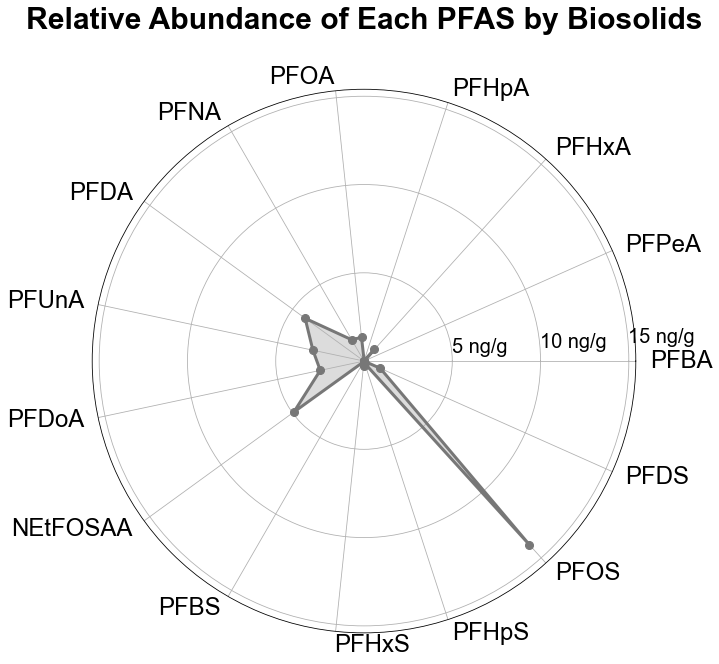

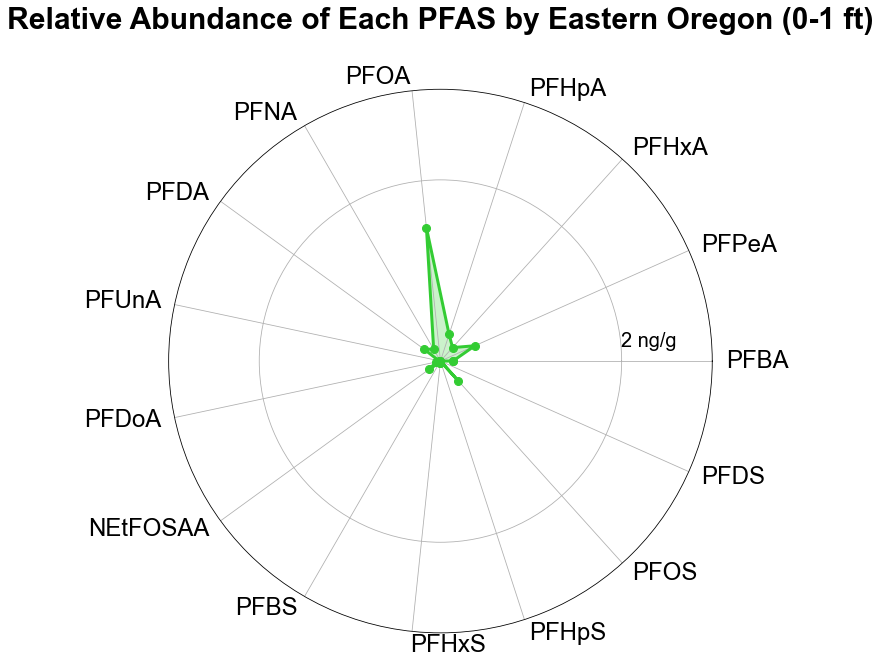

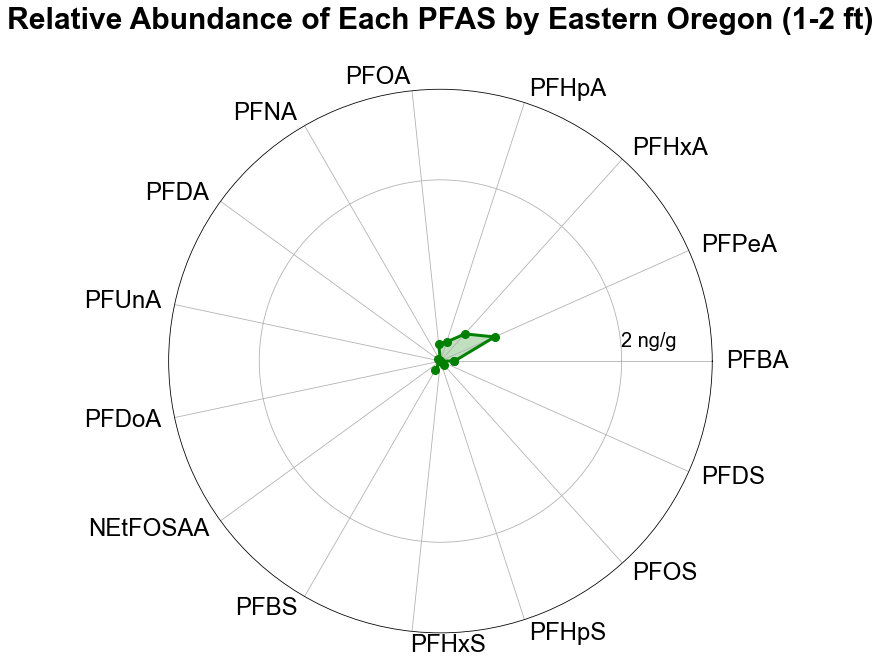

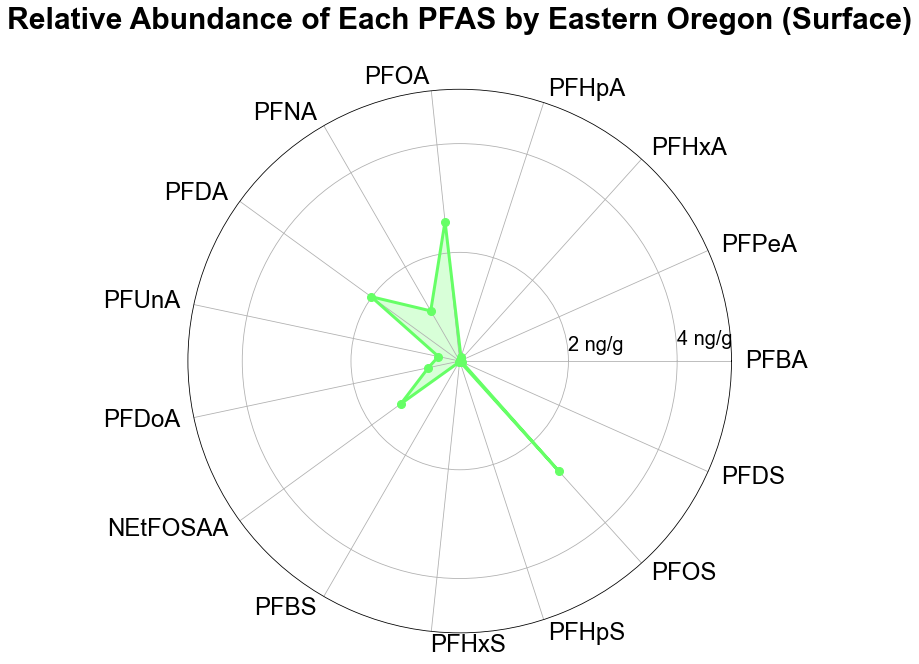

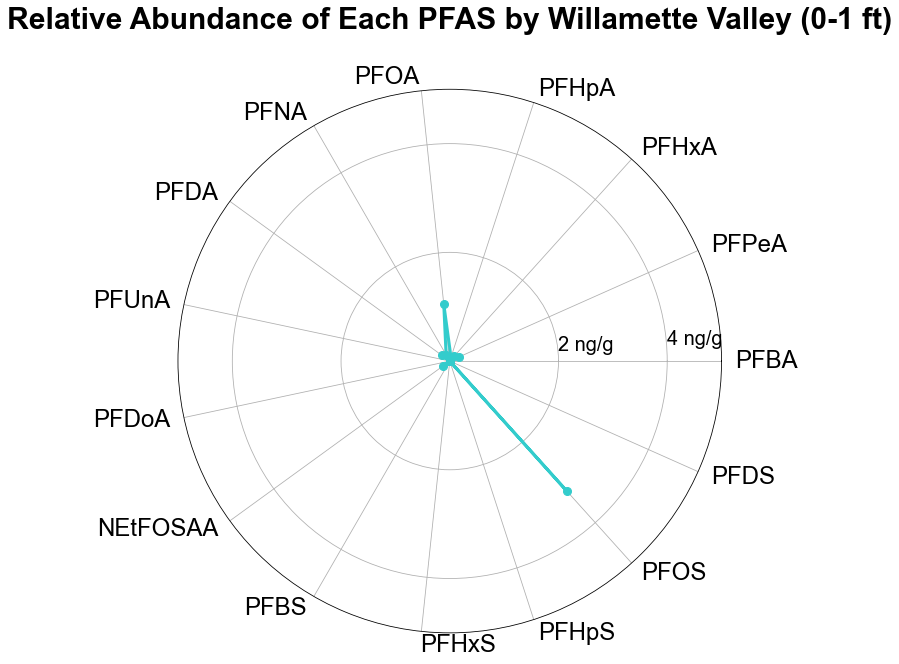

...

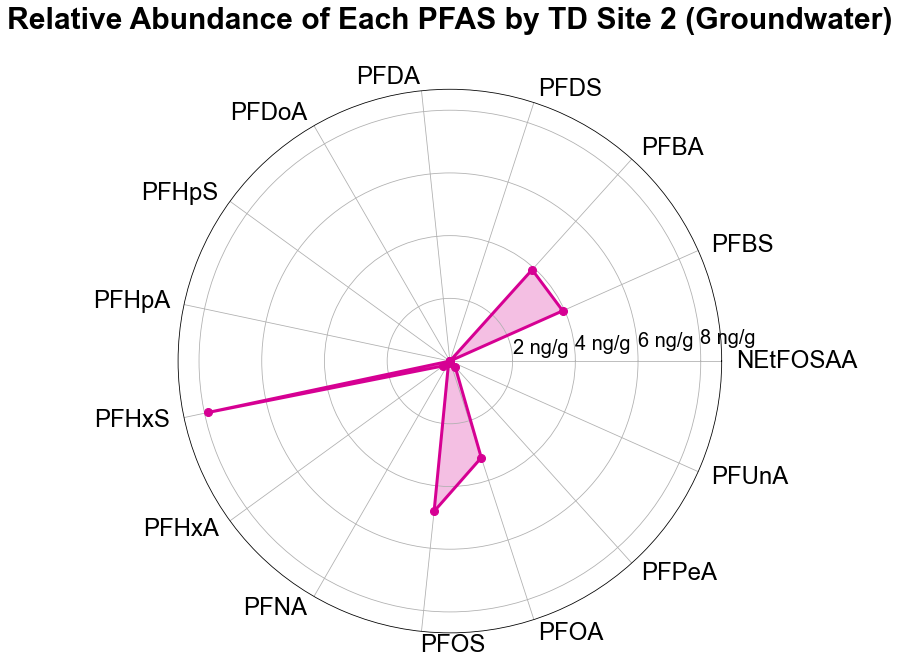

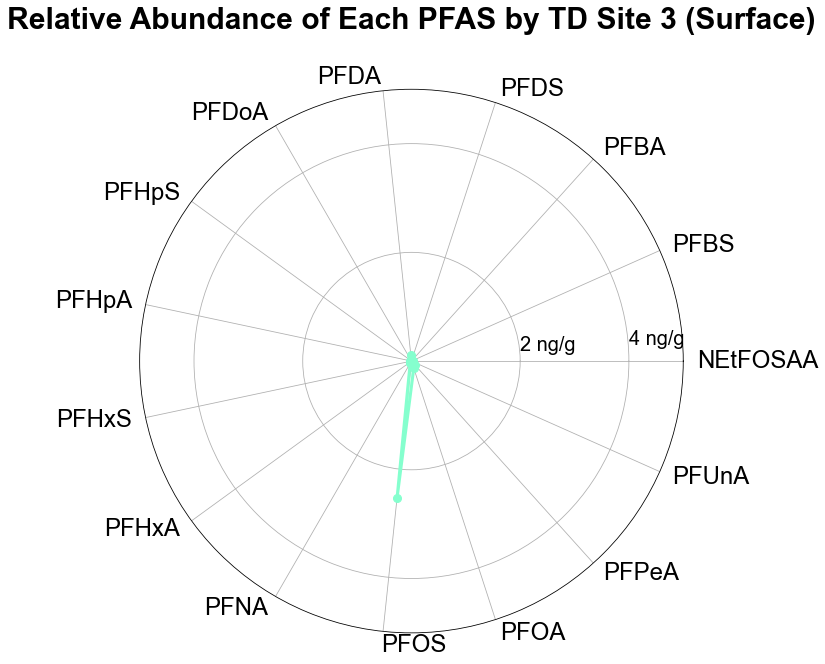

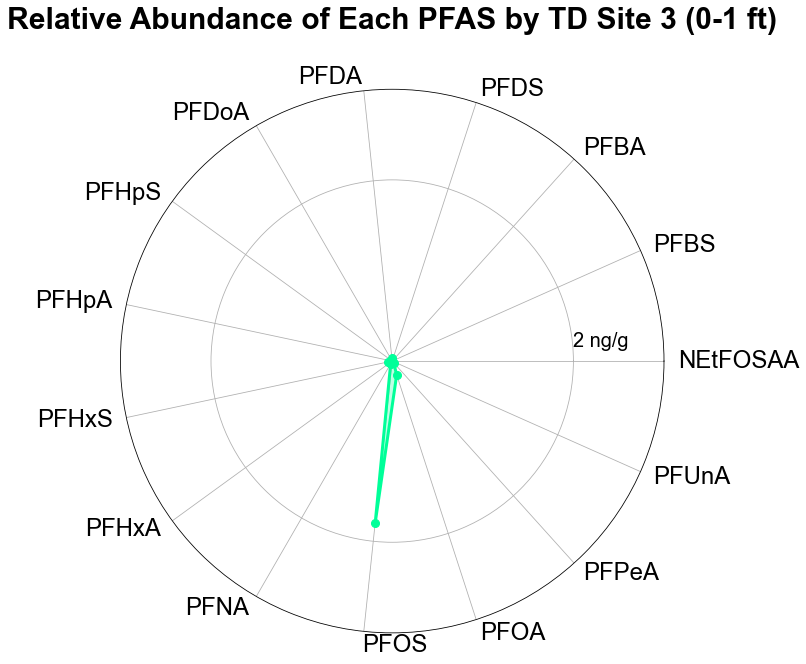

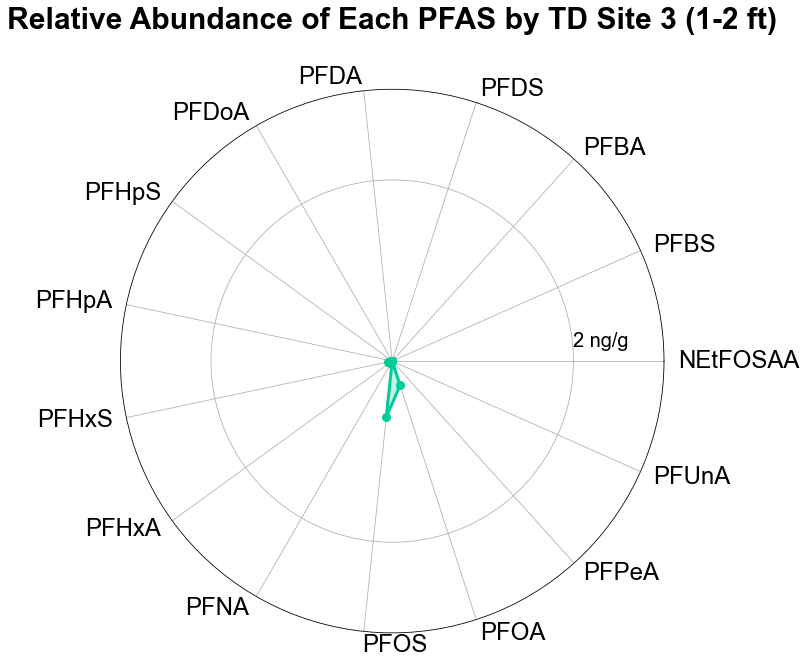

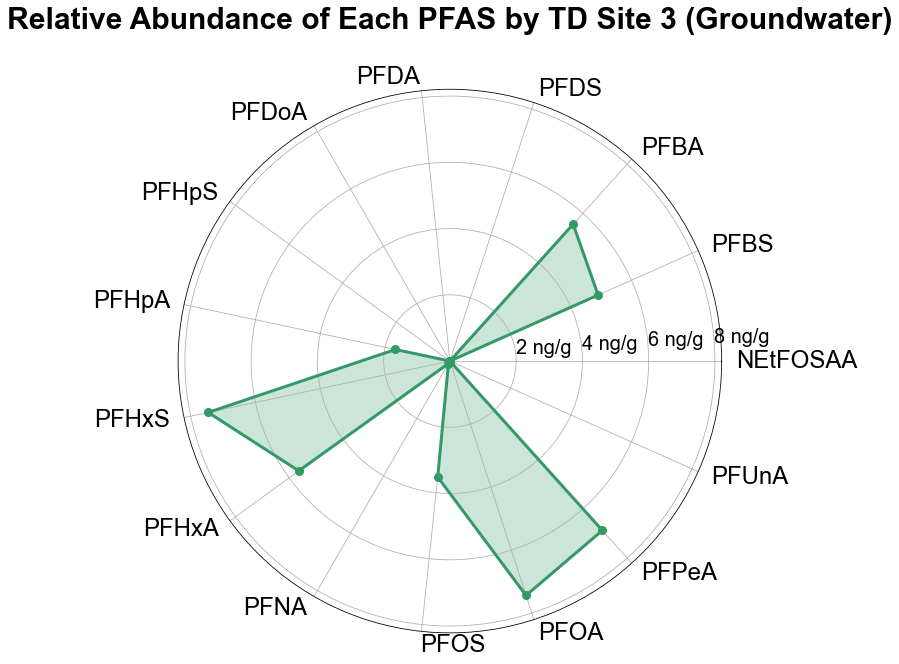

In [66]:
color_list=['#003f5c','#ffa600','gray','#a05195']
percent_angle=260 # default
percent_angle=180
# Assuming 'create_percent_radar_plot' is the function you are using to create the radar plots.
for key, dataframe in region_avg_dfs.items():
    # Create a temporary dictionary with just the current dataframe
    temp_dict = {key: dataframe}
    y_max= dataframe.max()[0]*1.10
    
    if np.isnan(y_max):
        y_max = 100
    elif y_max < 2:
        y_max=3
    elif y_max < 5:
        y_max=5
    else:
        y_max=y_max
    # Generate the radar plot for the current dataframe
    create_percent_radar_plot(temp_dict, figsize=(10, 10), legend_pos=(1.7, 1), color_list=[color_dic_radar_normalized[key]], title=f'Relative Abundance of Each PFAS by {key}', ymax=y_max,percent_angle=np.pi)

### Individual Radar Plots (Percentage)

In [67]:
def create_percent_radar_plot(data_dict, color_list, figsize=(10, 10), legend_pos=(1.4, 1.1), ymax=100, percent_angle=260, title='Relative Abundance of Each PFAS by Location'):
    # Assuming all dataframes in the dictionary have the same index and columns
    labels = list(data_dict[next(iter(data_dict))].index)  # Get index from the first dataframe
    num_vars = len(labels)  # Number of PFAS compounds

    # Compute angle for each axis
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    angles += angles[:1]  # Complete the circle

    fig, ax = plt.subplots(figsize=figsize, subplot_kw=dict(polar=True))
    
    # Draw one axe per variable and add labels
    ax.set_thetagrids(np.degrees(angles[:-1]), labels, fontsize=24, color='black')
    for label, angle in zip(ax.get_xticklabels(), angles):
        if angle in (1.5, 4.5):
            label.set_horizontalalignment('center')
        elif 1.5 < angle < 4.5:
            label.set_horizontalalignment('right')
        else:
            label.set_horizontalalignment('left')

    # Check if the number of colors matches the number of locations
    if len(color_list) != len(data_dict):
        raise ValueError("The number of colors must match the number of locations provided in data_dict.")

    for (location, df), color in zip(data_dict.items(), color_list):
        values = df.iloc[:, 0].tolist()  # Assume each dataframe has one column of data per PFAS compound
        values += values[:1]  # Complete the circle to close the radar plot
        ax.plot(angles, values, linewidth=3, linestyle='solid', label=location, color=color, marker='o', markersize=8)
        ax.fill(angles, values, alpha=0.25, color=color)

    # Adjusting the angle position for the radial grid labels (percentages)
    ax.set_rgrids(np.arange(20, 90, 20), labels=[f"{r}%" for r in range(20, 90, 20)], angle=percent_angle, fontsize=20)

    # Set the limits for radial grids
    ax.set_ylim(0, ymax)  # Assuming percentages are normalized to 100%

    # Add legend to the right side with custom position
    #plt.legend(loc='upper right', bbox_to_anchor=legend_pos, title="Locations")
    
    plt.title(title, size=30, color='black', y=1.1)
    plt.show()

# Usage example:
# colors = ['red', 'blue', 'green', 'yellow']  # Define your color list
# create_percent_radar_plot(region_dfs, colors, figsize=(12, 12), legend_pos=(1.5, 1.2))

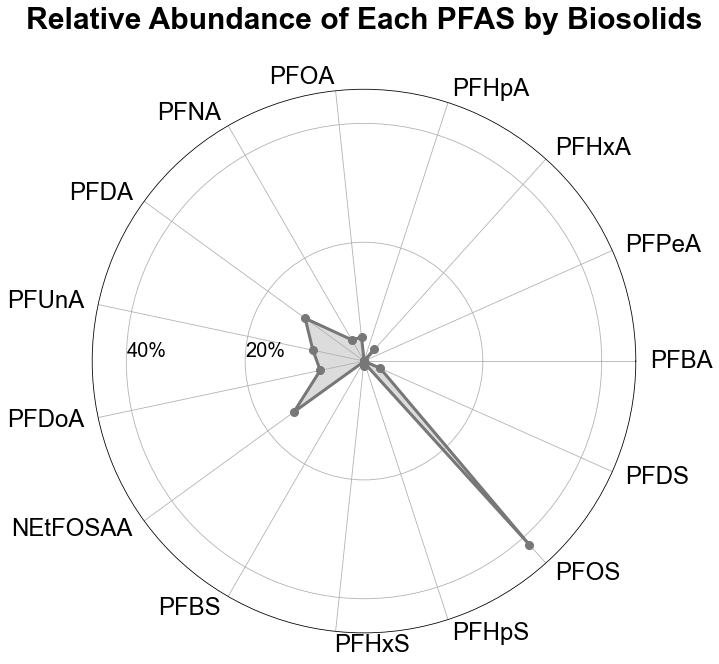

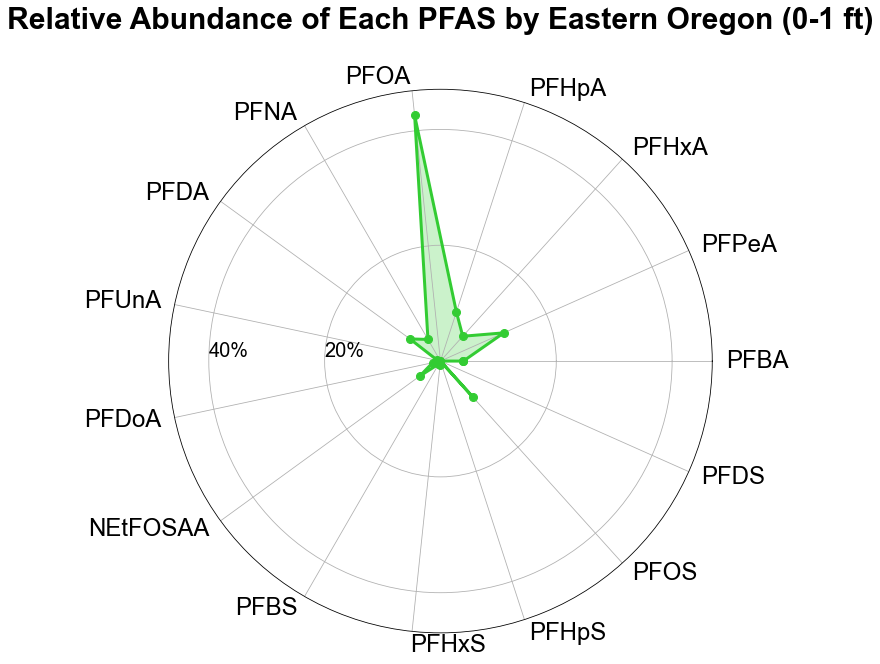

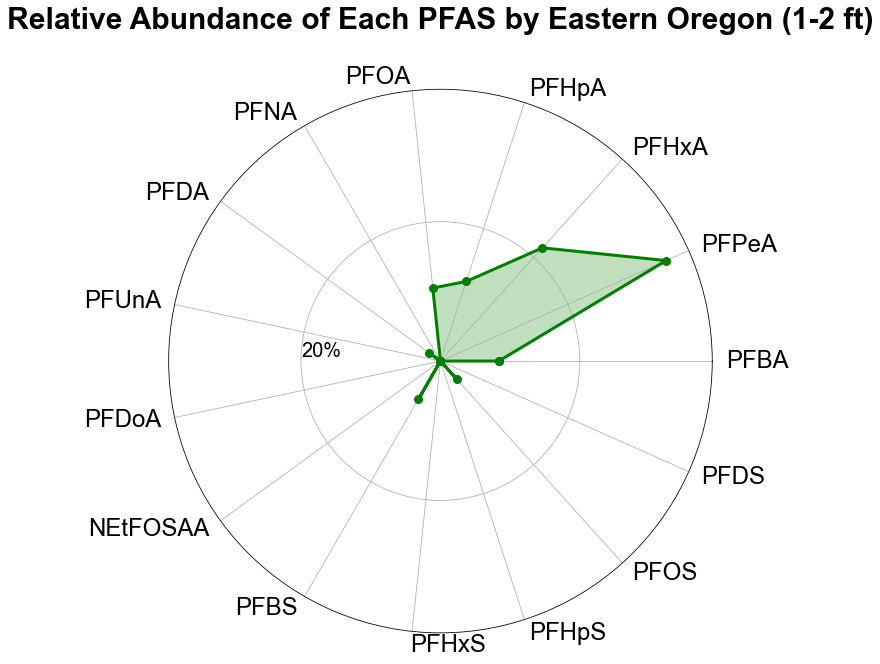

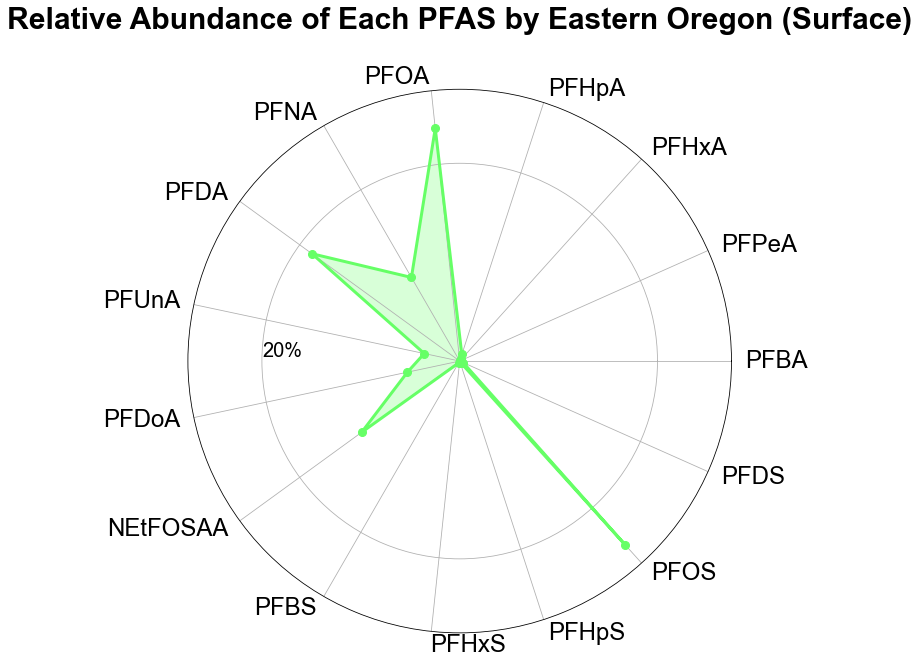

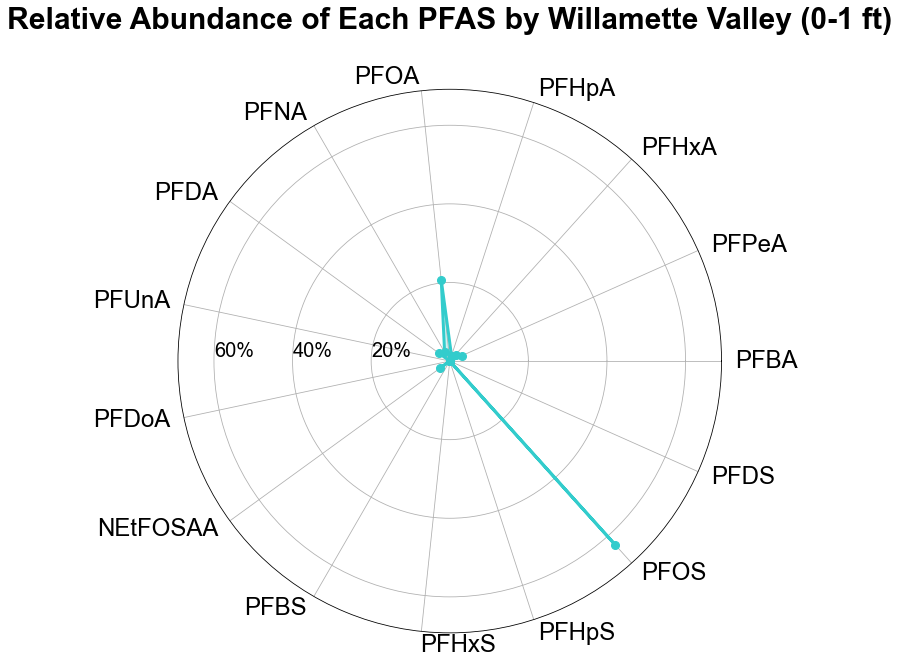

...

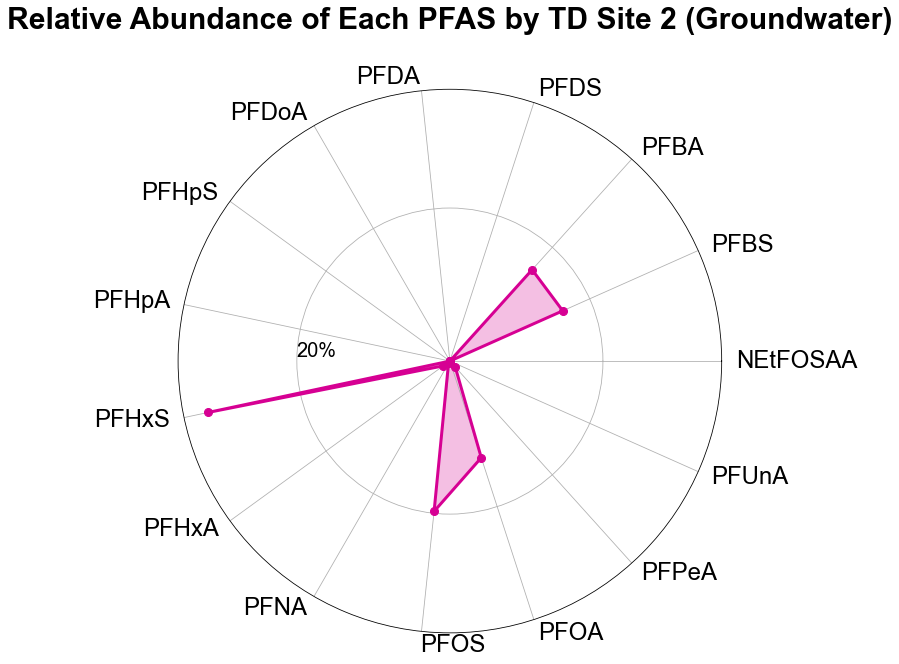

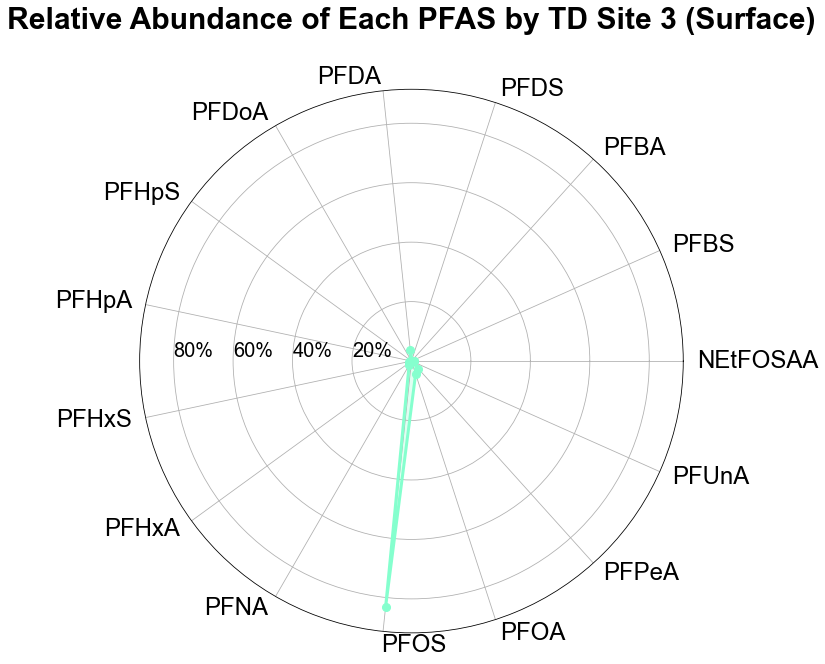

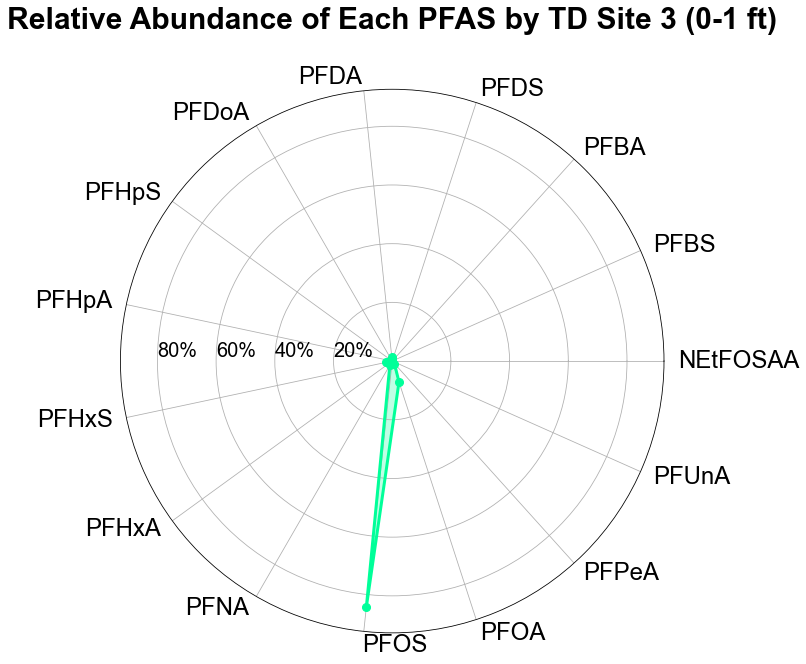

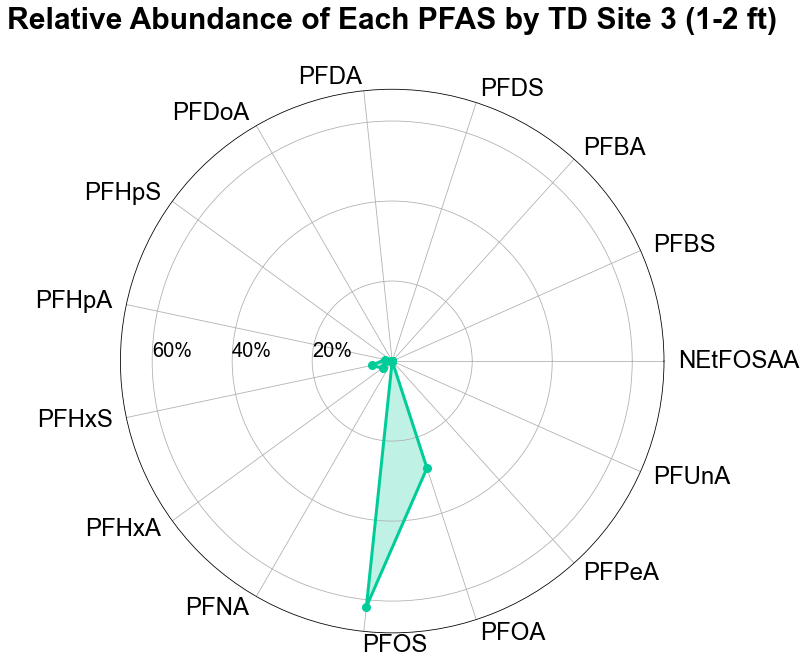

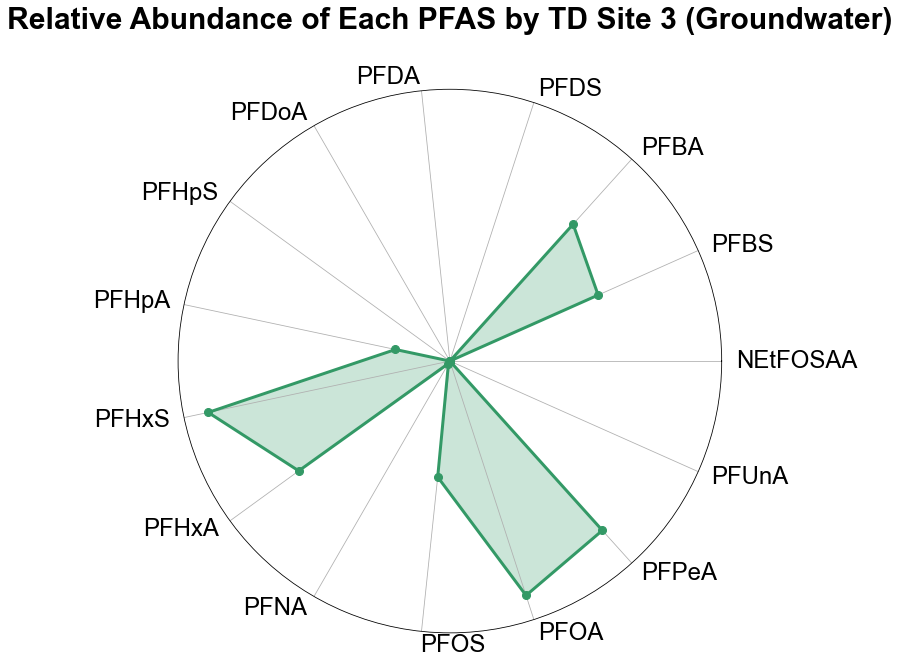

In [68]:
color_list=['#003f5c','#ffa600','gray','#a05195']
percent_angle=260 # default
percent_angle=300
# Assuming 'create_percent_radar_plot' is the function you are using to create the radar plots.
for key, dataframe in region_percent_dfs.items():
    # Create a temporary dictionary with just the current dataframe
    temp_dict = {key: dataframe}
    y_max= dataframe.max()[0]*1.10
    
    if y_max > 100:
        y_max=100
    elif np.isnan(y_max):
        y_max = 100
    else:
        y_max=y_max
    
    # Generate the radar plot for the current dataframe
    create_percent_radar_plot(temp_dict, figsize=(10, 10), legend_pos=(1.7, 1), color_list=[color_dic_radar_normalized[key]], title=f'Relative Abundance of Each PFAS by {key}', ymax=y_max,percent_angle=180)


### Average 

In [69]:
def create_percent_radar_plot(data_dict, color_list, figsize=(10, 10), legend_pos=(1.4, 1.1), ymax=100, percent_angle=260, title='Relative Abundance of Each PFAS by Location'):
    # Assuming all dataframes in the dictionary have the same index and columns
    labels = list(data_dict[next(iter(data_dict))].index)  # Get index from the first dataframe
    num_vars = len(labels)  # Number of PFAS compounds

    # Compute angle for each axis
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    angles += angles[:1]  # Complete the circle

    fig, ax = plt.subplots(figsize=figsize, subplot_kw=dict(polar=True))
    
    # Draw one axe per variable and add labels
    ax.set_thetagrids(np.degrees(angles[:-1]), labels, fontsize=24, color='black')
    for label, angle in zip(ax.get_xticklabels(), angles):
        if angle in (1.5, 4.5):
            label.set_horizontalalignment('center')
        elif 1.5 < angle < 4.5:
            label.set_horizontalalignment('right')
        else:
            label.set_horizontalalignment('left')

    # Check if the number of colors matches the number of locations
    if len(color_list) != len(data_dict):
        raise ValueError("The number of colors must match the number of locations provided in data_dict.")

    for (location, df), color in zip(data_dict.items(), color_list):
        values = df.iloc[:, 0].tolist()  # Assume each dataframe has one column of data per PFAS compound
        values += values[:1]  # Complete the circle to close the radar plot
        ax.plot(angles, values, linewidth=3, linestyle='solid', label=location, color=color, marker='o', markersize=7)
        #ax.fill(angles, values, alpha=0.1, color=color)

    # Adjusting the angle position for the radial grid labels (percentages)
    if ymax < 9:
        ax.set_rgrids(np.arange(2, 50, 2), labels=[f"{r} ng/g" for r in range(2, 50, 2)], angle=percent_angle, fontsize=20)
    elif ymax > 9 and ymax < 20:
        ax.set_rgrids(np.arange(5, 50, 5), labels=[f"{r} ng/g" for r in range(5, 50, 5)], angle=percent_angle, fontsize=20)
    elif ymax <5:
        ax.set_rgrids(np.arange(1, 5, 1), labels=[f"{r} ng/g" for r in range(1, 5, 1)], angle=percent_angle, fontsize=20)
    else:
        ax.set_rgrids(np.arange(5, 100, 10), labels=[f"{r} ng/g" for r in range(5, 100, 10)], angle=percent_angle, fontsize=20)
        
    # Set the limits for radial grids
    ax.set_ylim(0, ymax)  # Assuming percentages are normalized to 100%

    # Add legend to the right side with custom position
    plt.legend(loc='upper right', bbox_to_anchor=legend_pos, title="Locations")
    
    plt.title(title, size=30, color='black', y=1.1)
    plt.show()

In [70]:
keys_list = list(region_avg_dfs.keys())

# Now 'keys_list' contains all the keys from 'my_dict'
keys_list

['Biosolids',
 'Eastern Oregon (0-1 ft)',
 'Eastern Oregon (1-2 ft)',
 'Eastern Oregon (Surface)',
 'Willamette Valley (0-1 ft)',
 'Willamette Valley (1-2 ft)',
 'Willamette Valley (Surface)',
 'Control Eastern Oregon (0-1 ft)',
 'Control Eastern Oregon (1-2 ft)',
 'Control Eastern Oregon (Surface)',
 'Control Willamette Valley (0-1 ft)',
 'Control Willamette Valley (1-2 ft)',
 'Control Willamette Valley (Surface)',
 'TD Control (Surface)',
 'TD Control (0-1 ft)',
 'TD Control (1-2 ft)',
 'TD Control (Groundwater)',
 'TD Site 1 (Surface)',
 'TD Site 1 (0-1 ft)',
 'TD Site 1 (1-2 ft)',
 'TD Site 1 (Groundwater)',
 'TD Site 2 (Surface)',
 'TD Site 2 (0-1 ft)',
 'TD Site 2 (1-2 ft)',
 'TD Site 2 (Groundwater)',
 'TD Site 3 (Surface)',
 'TD Site 3 (0-1 ft)',
 'TD Site 3 (1-2 ft)',
 'TD Site 3 (Groundwater)']

8.195


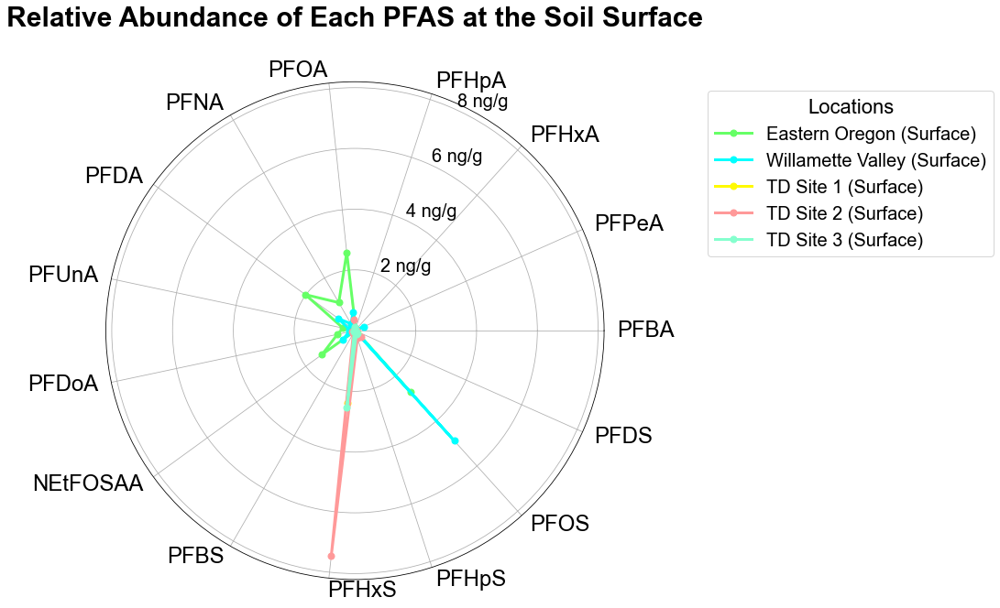

[(0.2, 0.6, 0.4)]

In [71]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087','#ff7c43','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (Surface)','Willamette Valley (Surface)','TD Site 1 (Surface)','TD Site 2 (Surface)','TD Site 3 (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the Soil Surface', ymax=y_max,percent_angle=65)

[color_dic_radar_normalized[key]]

5.371666666666668


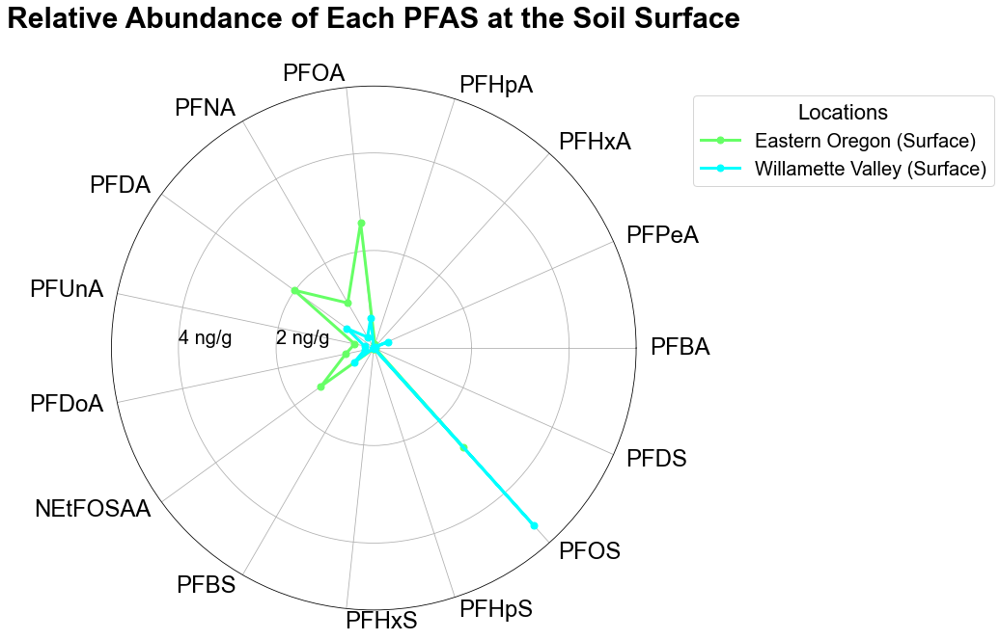

In [72]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087','#ff7c43','gray']
color_list=['#003f5c','#ff7c43']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (Surface)','Willamette Valley (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the Soil Surface', ymax=y_max,percent_angle=180)

3


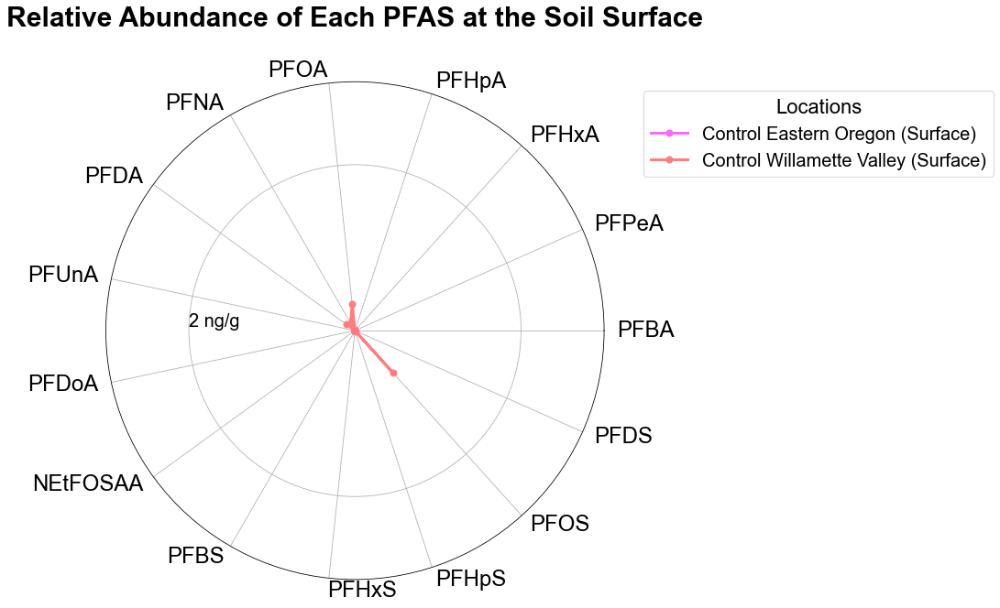

In [73]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087','#ff7c43','gray']
color_list=['#003f5c','#ff7c43']
# List of keys you want to include in the new dictionary
include_keys = [ 'Control Eastern Oregon (Surface)','Control Willamette Valley (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the Soil Surface', ymax=y_max,percent_angle=180)

5.371666666666668


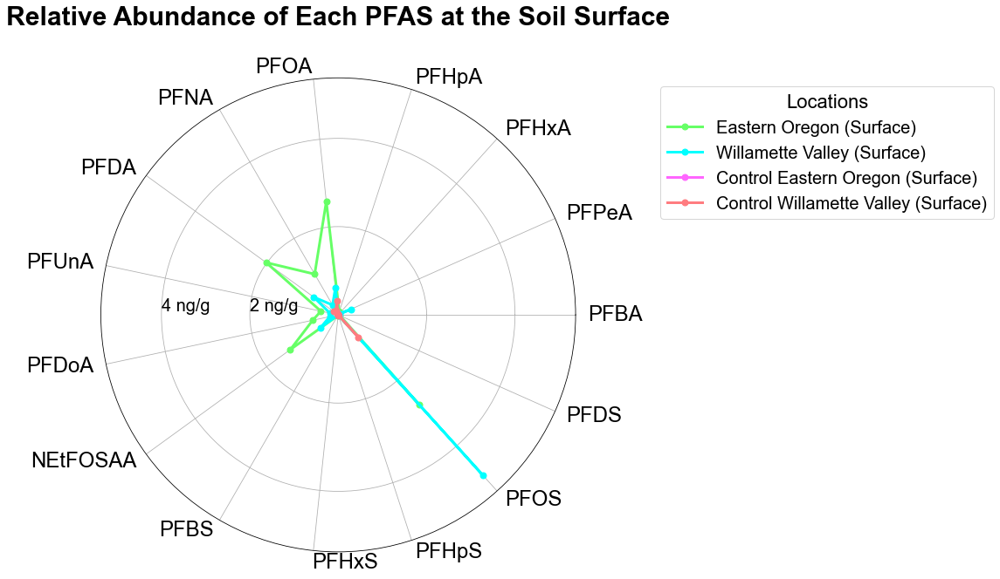

In [74]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#ff7c43','#665191','#d45087']

# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (Surface)','Willamette Valley (Surface)','Control Eastern Oregon (Surface)','Control Willamette Valley (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.9, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the Soil Surface', ymax=y_max,percent_angle=180)

5


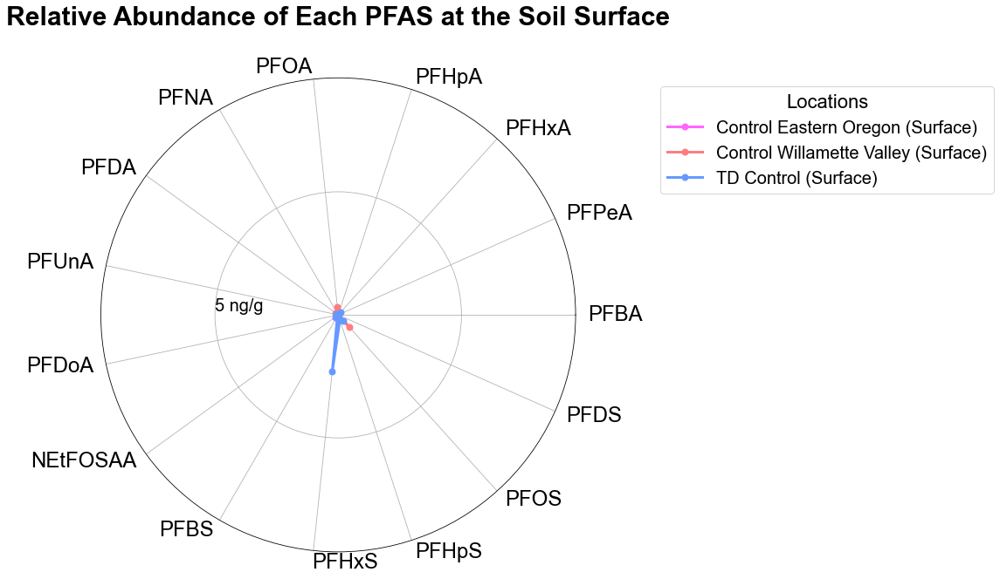

In [75]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087']
# List of keys you want to include in the new dictionary
include_keys = [ 'Control Eastern Oregon (Surface)','Control Willamette Valley (Surface)','TD Control (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.9, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the Soil Surface', ymax=9.63,percent_angle=180)

8.195


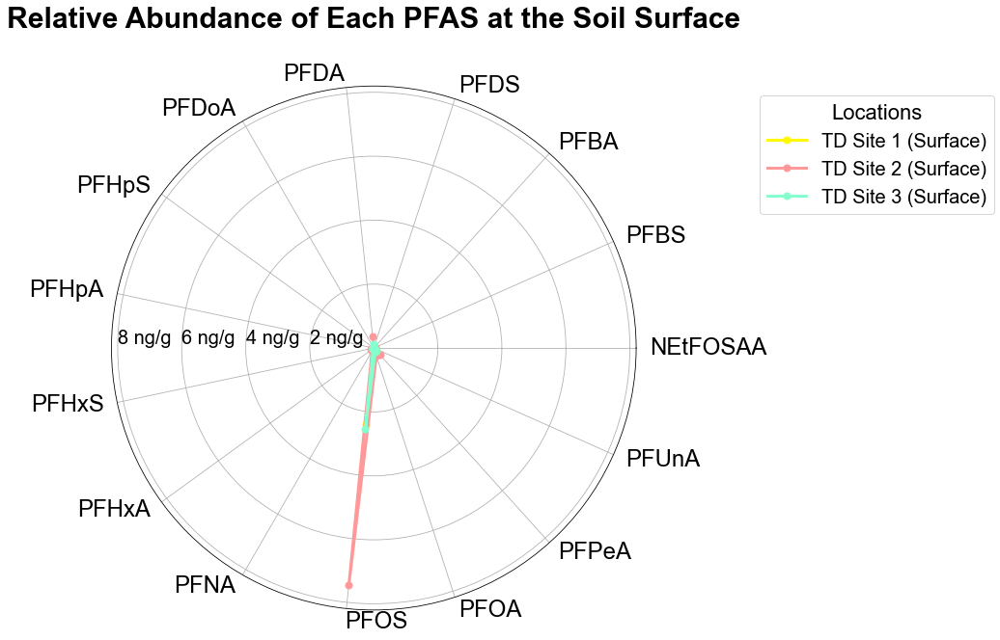

In [76]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['TD Site 1 (Surface)','TD Site 2 (Surface)','TD Site 3 (Surface)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the Soil Surface', ymax=y_max,percent_angle=180)

8.195


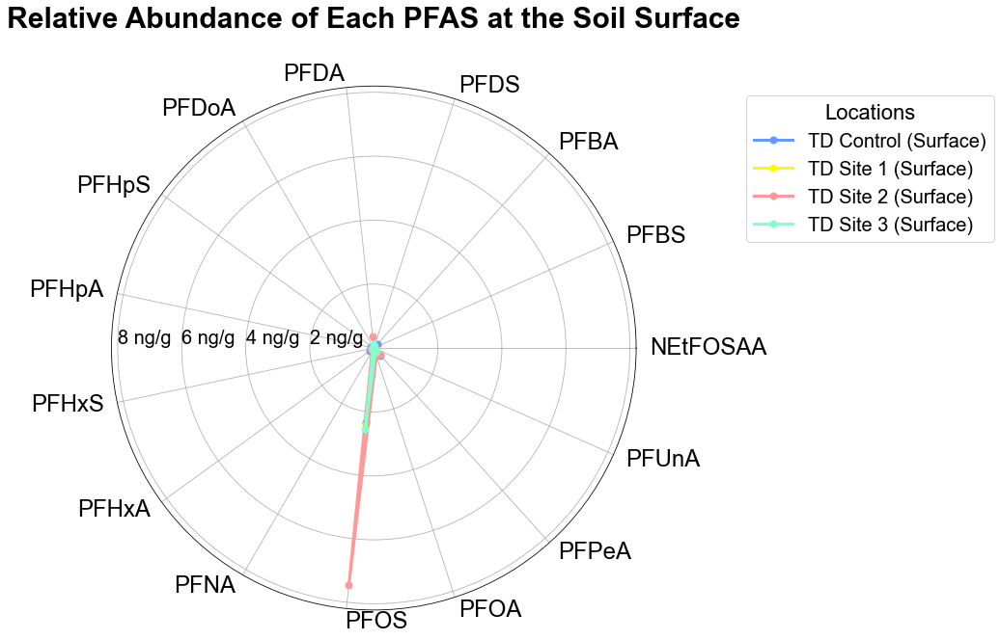

In [77]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray','yellowgreen']
# List of keys you want to include in the new dictionary
include_keys = [ 'TD Control (Surface)','TD Site 1 (Surface)','TD Site 2 (Surface)','TD Site 3 (Surface)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the Soil Surface', ymax=y_max,percent_angle=180)

5


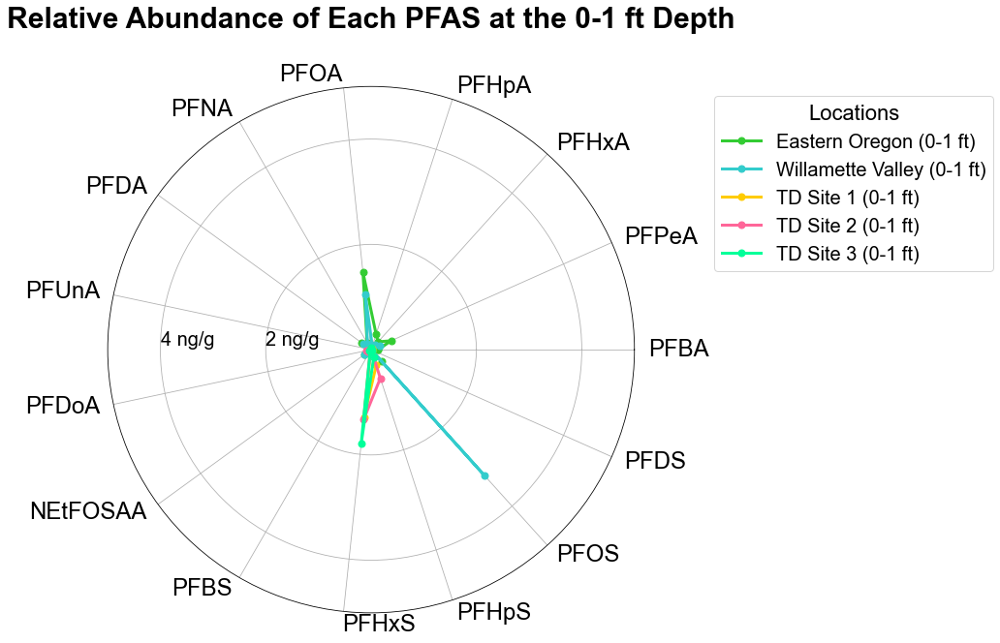

In [78]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087','#ff7c43','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (0-1 ft)','Willamette Valley (0-1 ft)','TD Site 1 (0-1 ft)','TD Site 2 (0-1 ft)','TD Site 3 (0-1 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}

# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the 0-1 ft Depth', ymax=y_max,percent_angle=180)

5


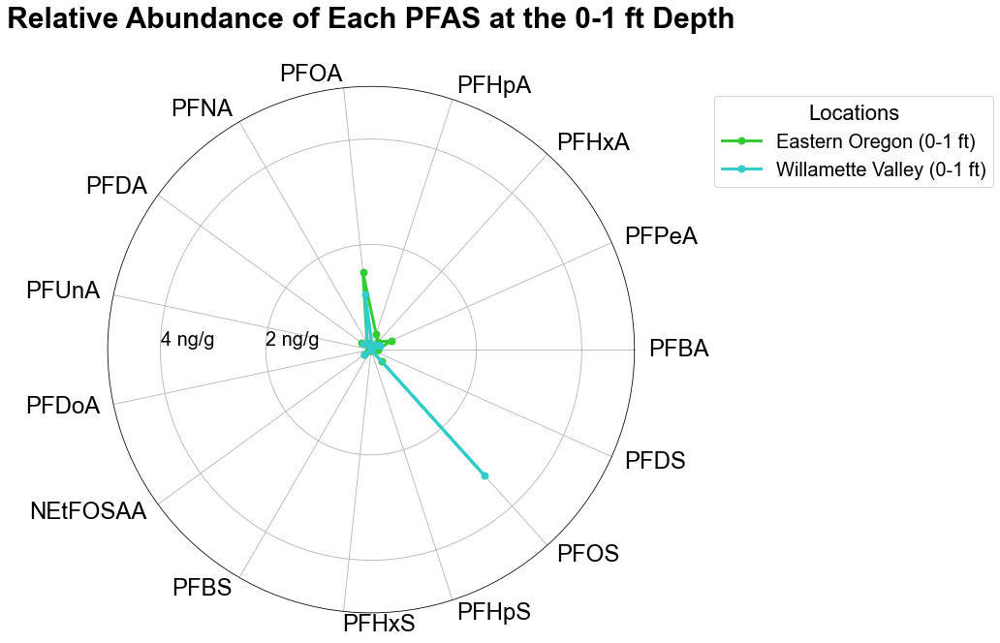

In [79]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#ff7c43']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (0-1 ft)','Willamette Valley (0-1 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the 0-1 ft Depth', ymax=y_max,percent_angle=180)

5


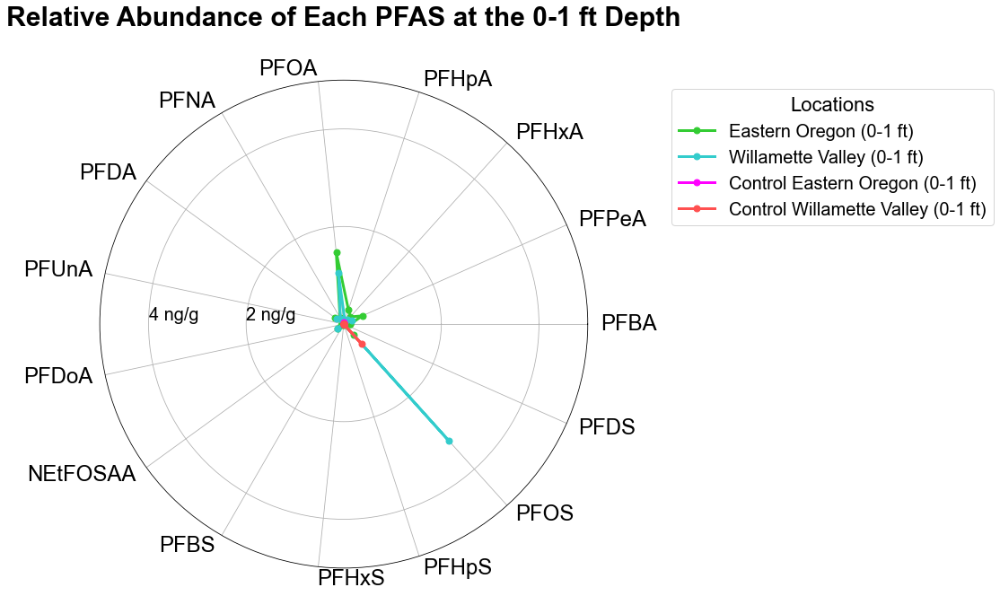

In [80]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#ff7c43','#665191','#d45087']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (0-1 ft)','Willamette Valley (0-1 ft)','Control Eastern Oregon (0-1 ft)','Control Willamette Valley (0-1 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.85, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the 0-1 ft Depth', ymax=y_max,percent_angle=180)

3


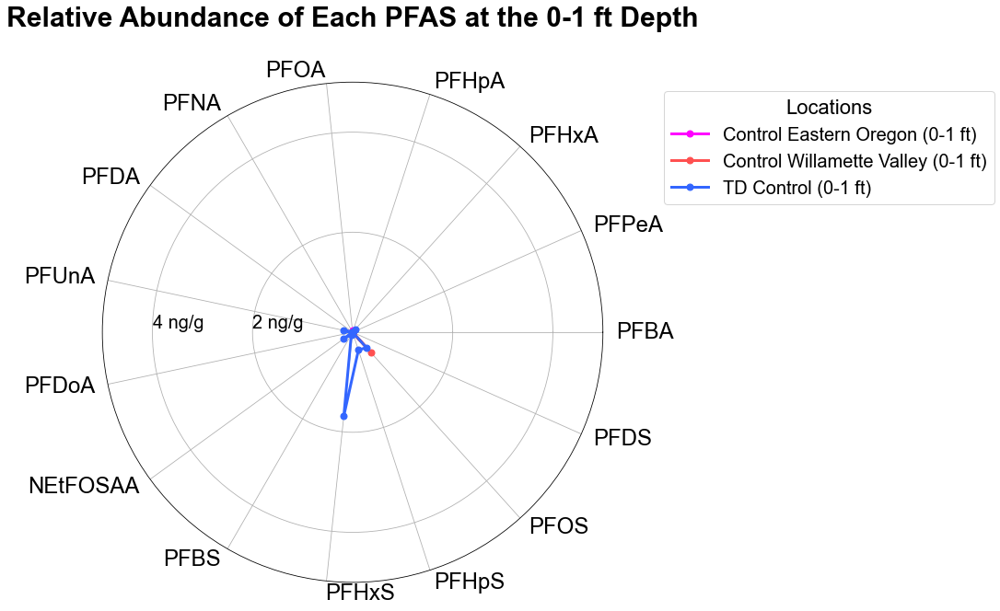

In [81]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087']
# List of keys you want to include in the new dictionary
include_keys = ['Control Eastern Oregon (0-1 ft)','Control Willamette Valley (0-1 ft)','TD Control (0-1 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}

# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the 0-1 ft Depth', ymax=5,percent_angle=180)

3


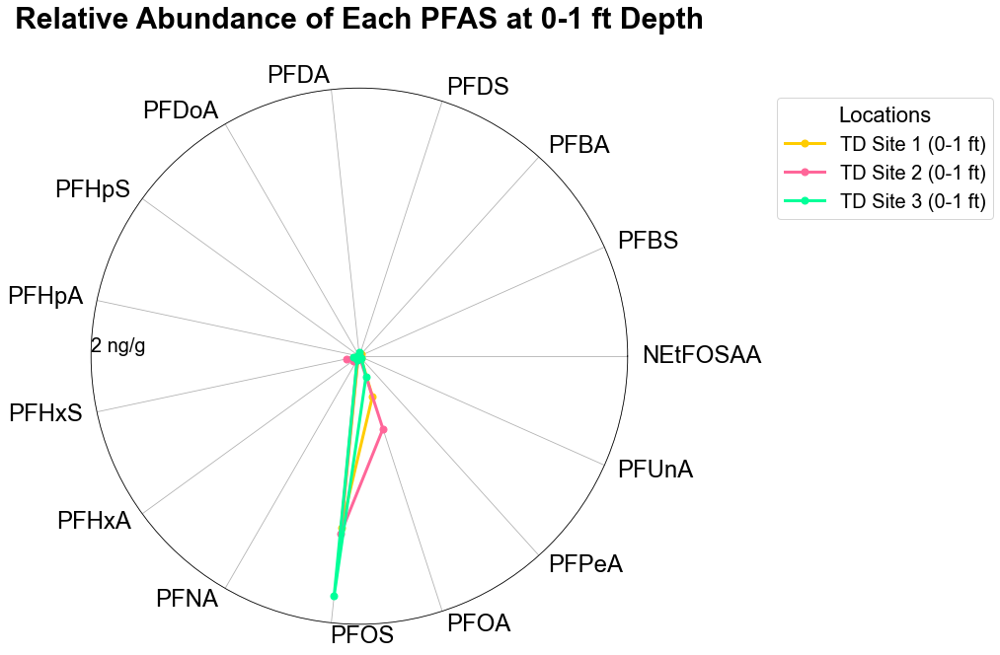

In [82]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['TD Site 1 (0-1 ft)','TD Site 2 (0-1 ft)','TD Site 3 (0-1 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 0-1 ft Depth', ymax=2,percent_angle=180)

3


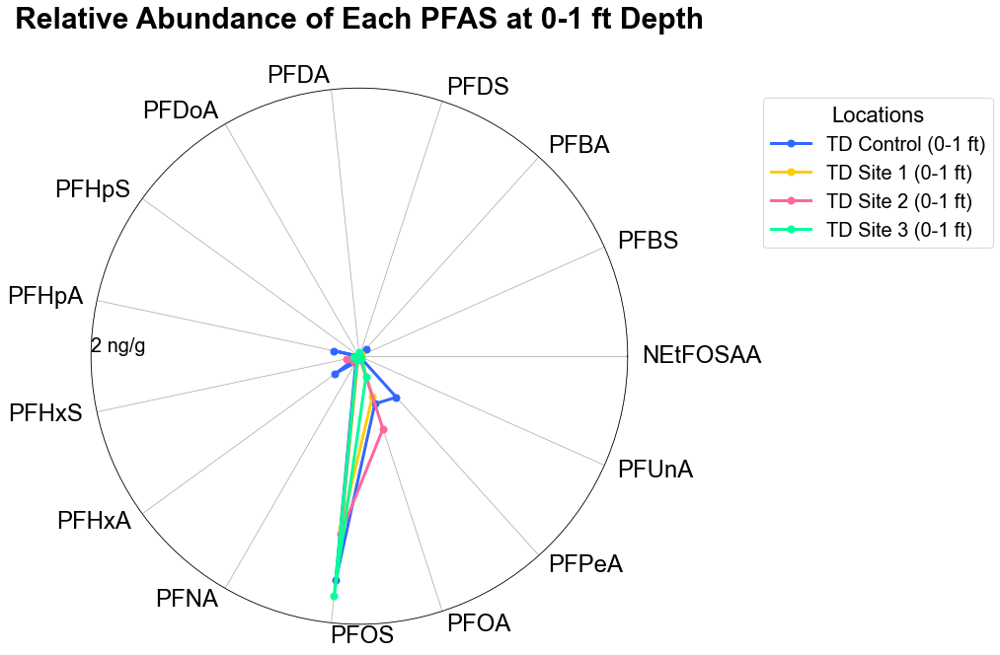

In [83]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray','yellowgreen']
# List of keys you want to include in the new dictionary
include_keys = ['TD Control (0-1 ft)','TD Site 1 (0-1 ft)','TD Site 2 (0-1 ft)','TD Site 3 (0-1 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}

# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 0-1 ft Depth', ymax=2,percent_angle=180)

5


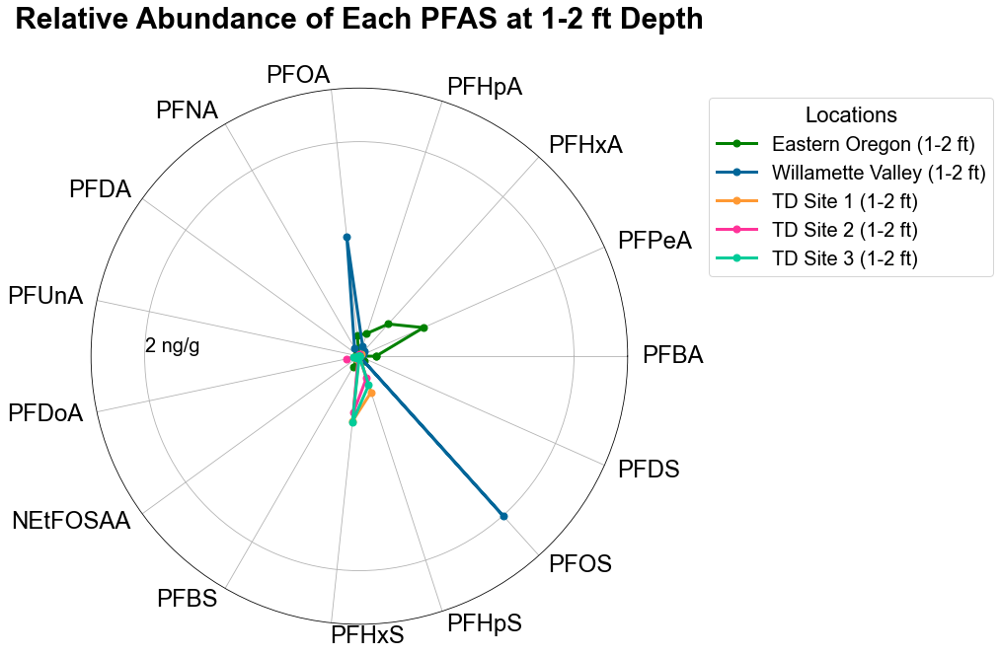

In [84]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087','#ff7c43','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (1-2 ft)','Willamette Valley (1-2 ft)','TD Site 1 (1-2 ft)','TD Site 2 (1-2 ft)','TD Site 3 (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}

# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 1-2 ft Depth', ymax=2.5,percent_angle=180)

5


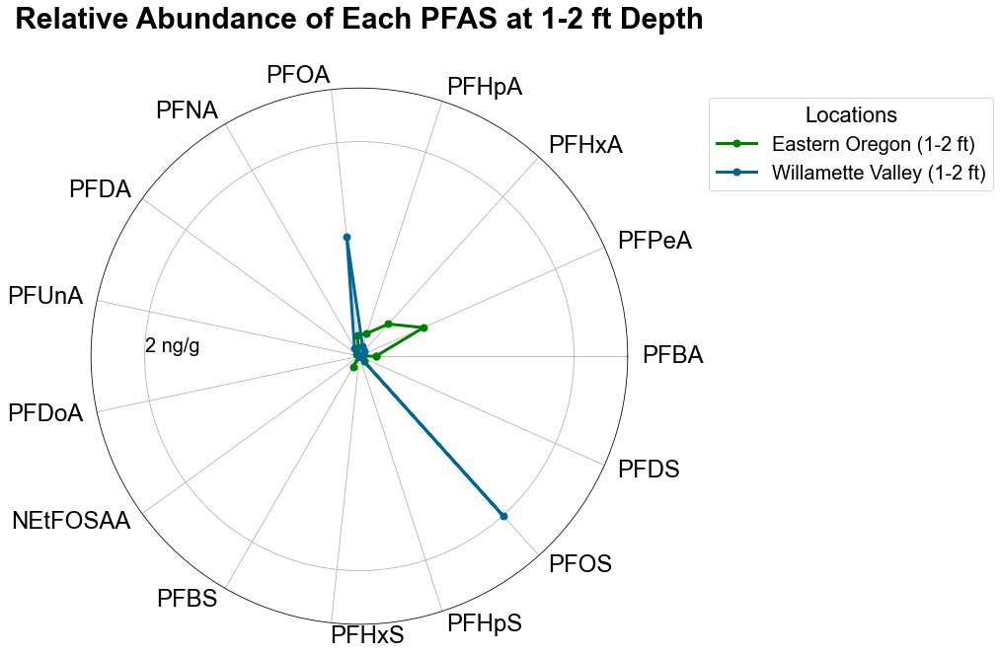

In [85]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#ff7c43']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (1-2 ft)','Willamette Valley (1-2 ft)',]

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 1-2 ft Depth', ymax=2.5,percent_angle=180)

5


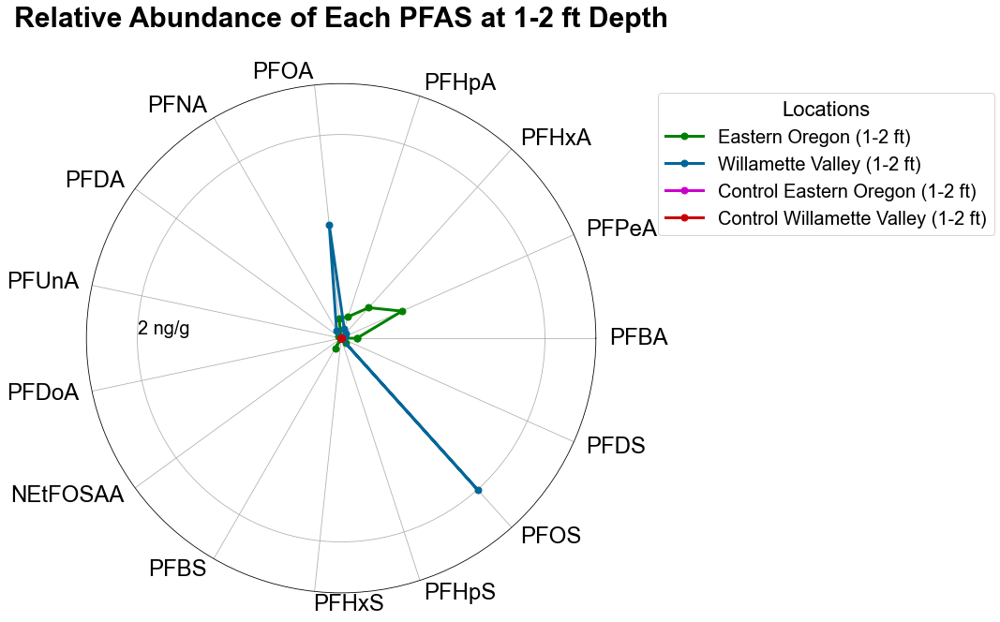

In [86]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#ff7c43','#665191','#d45087']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (1-2 ft)','Willamette Valley (1-2 ft)','Control Eastern Oregon (1-2 ft)','Control Willamette Valley (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}

# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 1-2 ft Depth', ymax=2.5,percent_angle=180)

3


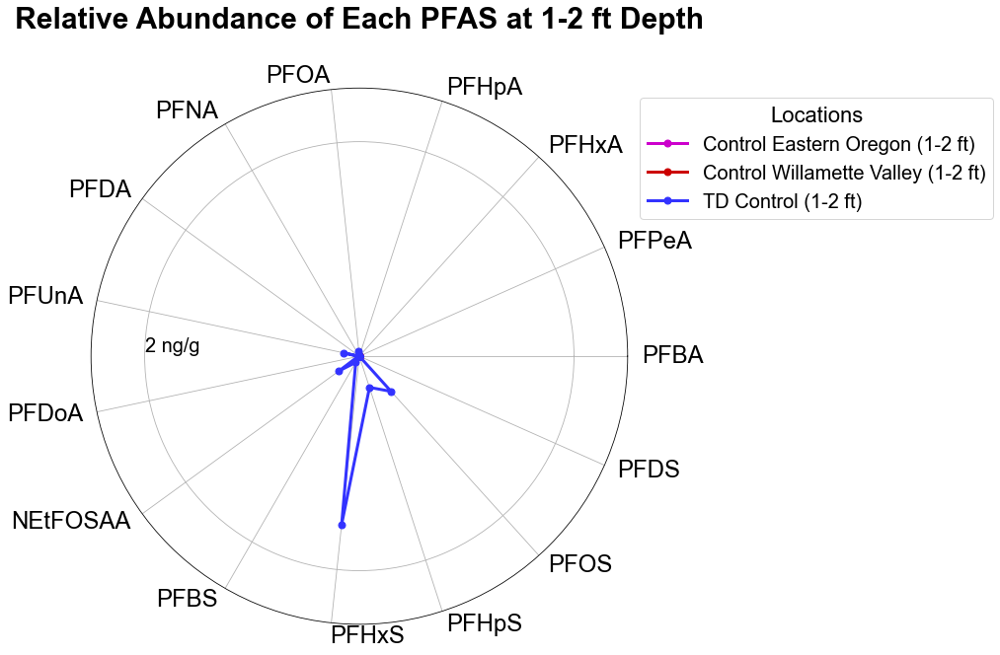

In [87]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087']
# List of keys you want to include in the new dictionary
include_keys = [ 'Control Eastern Oregon (1-2 ft)','Control Willamette Valley (1-2 ft)','TD Control (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}

# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 1-2 ft Depth', ymax=2.5,percent_angle=180)

3


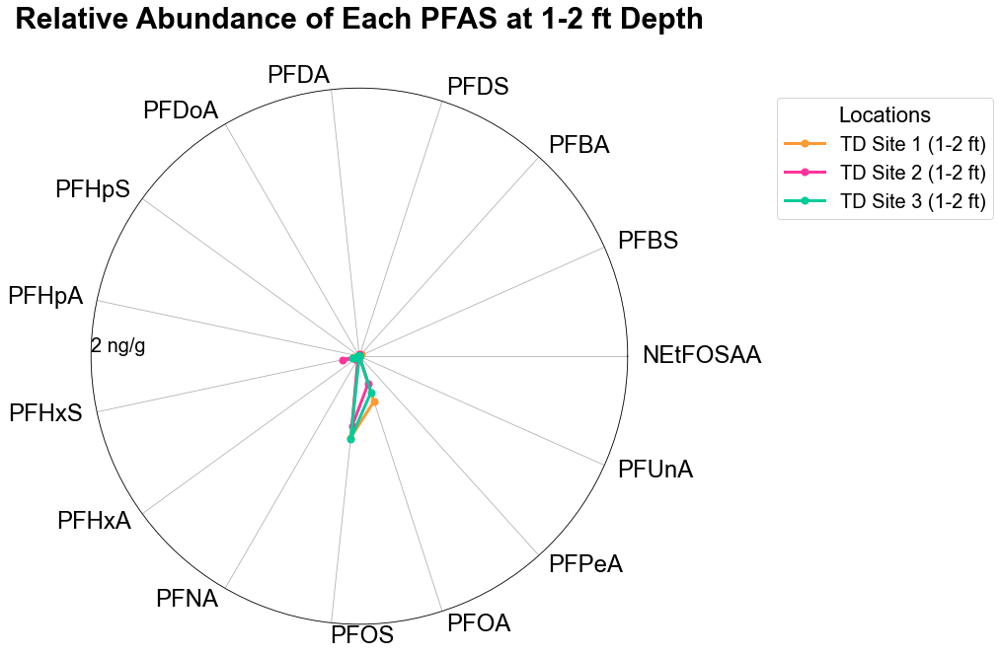

In [88]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['TD Site 1 (1-2 ft)','TD Site 2 (1-2 ft)','TD Site 3 (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 1-2 ft Depth', ymax=2,percent_angle=180)

3


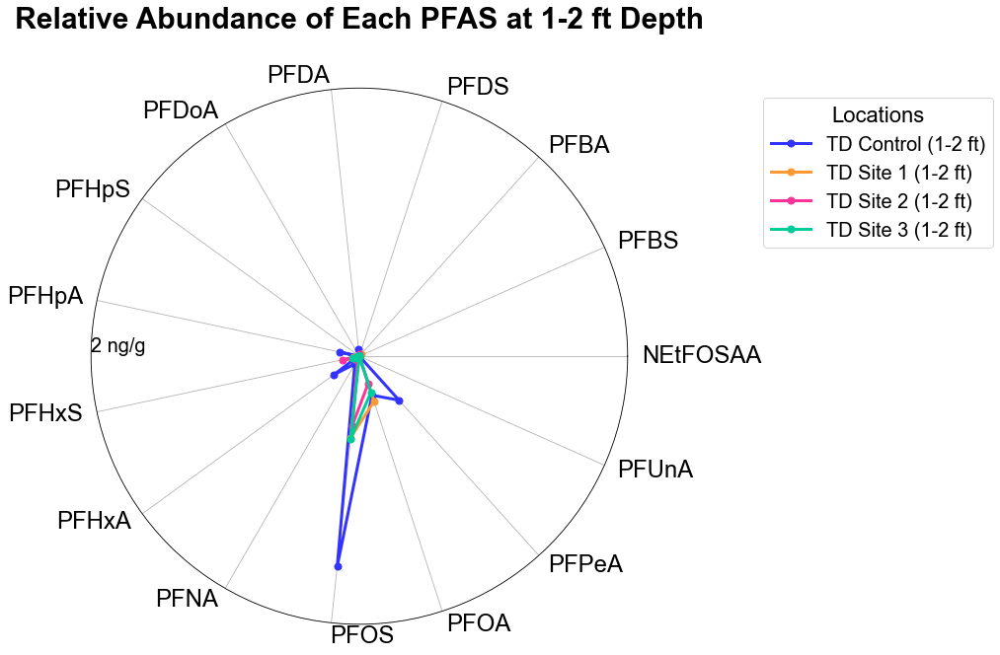

In [89]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray','yellowgreen']
# List of keys you want to include in the new dictionary
include_keys = ['TD Control (1-2 ft)','TD Site 1 (1-2 ft)','TD Site 2 (1-2 ft)','TD Site 3 (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 1-2 ft Depth', ymax=2,percent_angle=180)

11.110000000000001


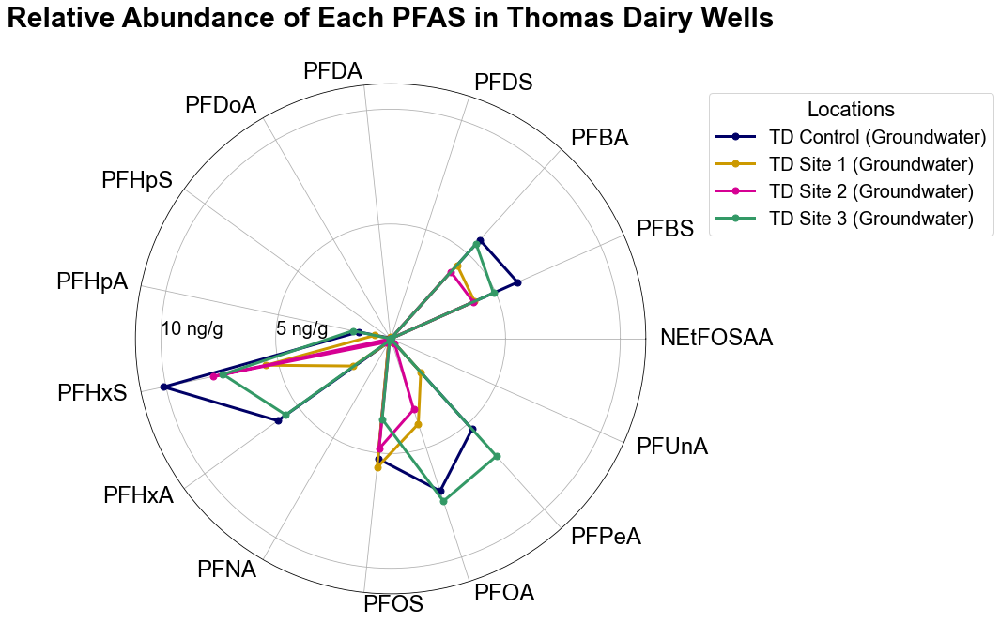

In [90]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray','yellowgreen']
# List of keys you want to include in the new dictionary
include_keys = ['TD Control (Groundwater)','TD Site 1 (Groundwater)','TD Site 2 (Groundwater)','TD Site 3 (Groundwater)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}

# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS in Thomas Dairy Wells', ymax=y_max,percent_angle=180)

5


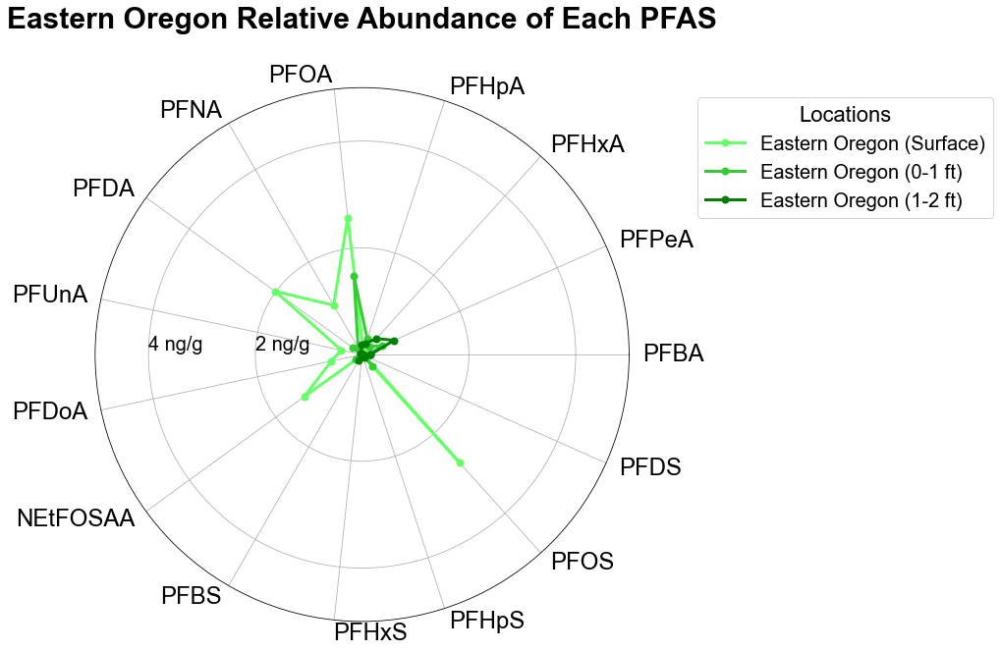

In [91]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['Eastern Oregon (Surface)','Eastern Oregon (0-1 ft)','Eastern Oregon (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Eastern Oregon Relative Abundance of Each PFAS', ymax=y_max,percent_angle=180)

3


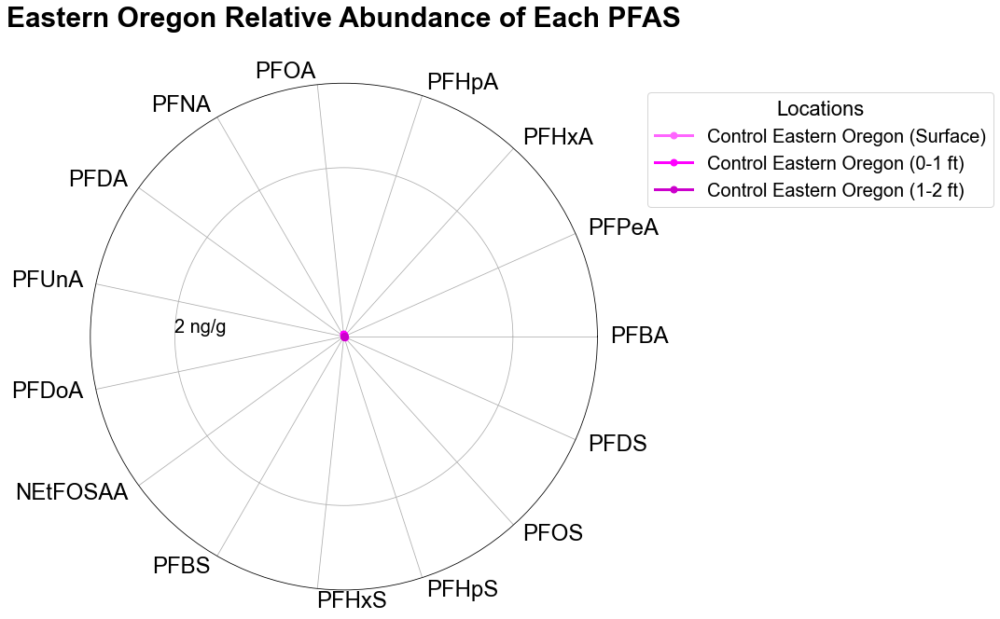

In [92]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['Control Eastern Oregon (Surface)','Control Eastern Oregon (0-1 ft)','Control Eastern Oregon (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Eastern Oregon Relative Abundance of Each PFAS', ymax=y_max,percent_angle=180)

5.371666666666668


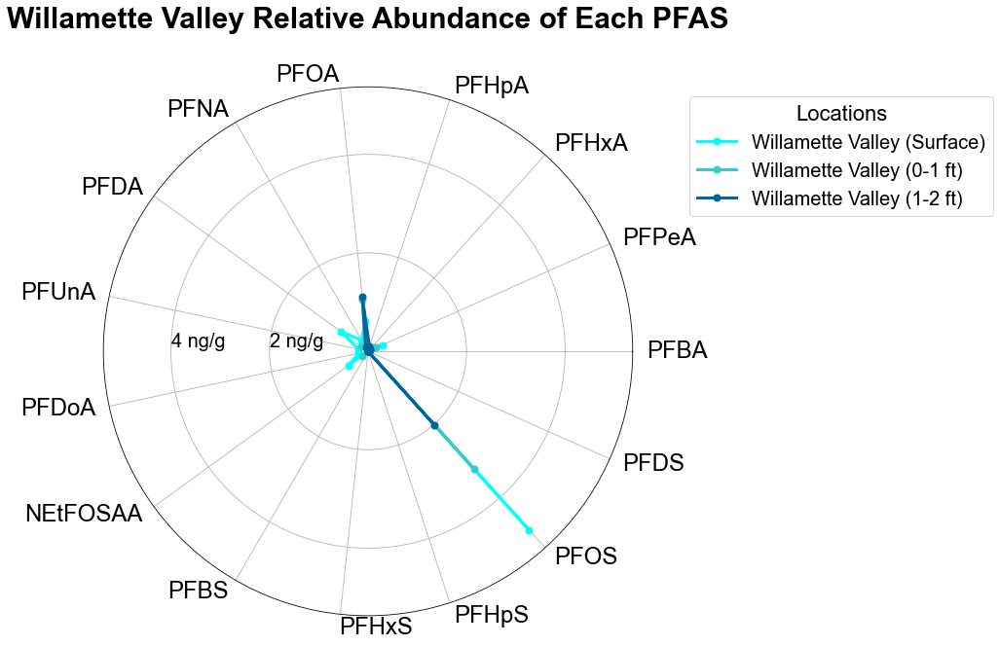

In [93]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['Willamette Valley (Surface)','Willamette Valley (0-1 ft)','Willamette Valley (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Willamette Valley Relative Abundance of Each PFAS', ymax=y_max,percent_angle=180)

3


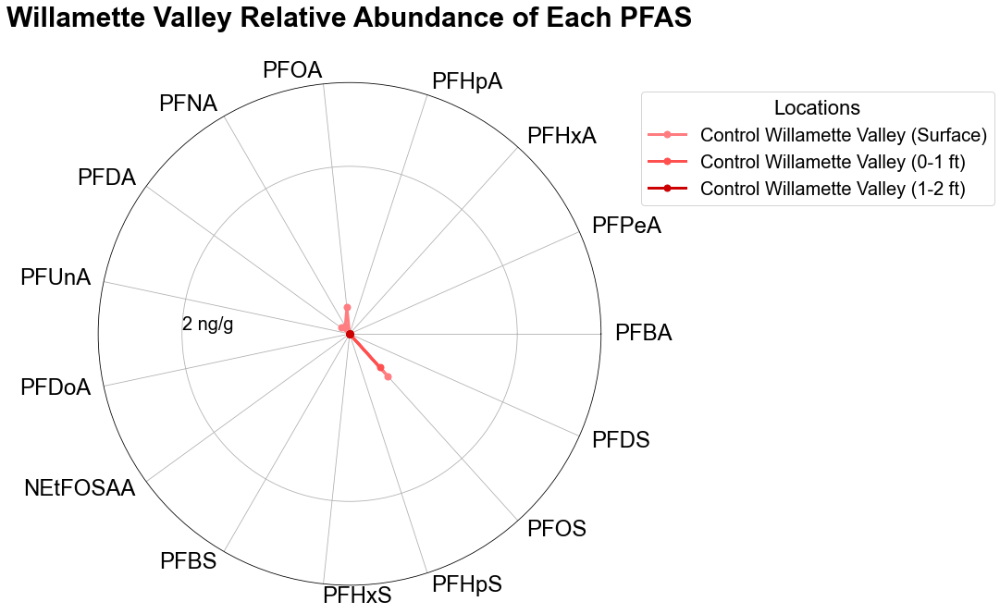

In [94]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['Control Willamette Valley (Surface)','Control Willamette Valley (0-1 ft)','Control Willamette Valley (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Willamette Valley Relative Abundance of Each PFAS', ymax=y_max,percent_angle=180)

5


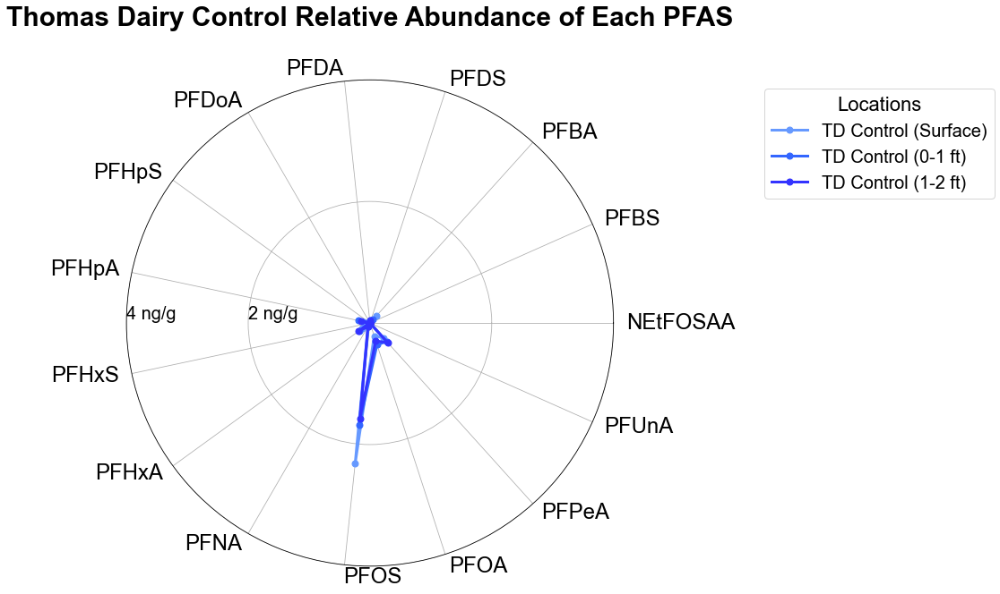

In [95]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['TD Control (Surface)','TD Control (0-1 ft)','TD Control (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Thomas Dairy Control Relative Abundance of Each PFAS', ymax=4,percent_angle=180)

5


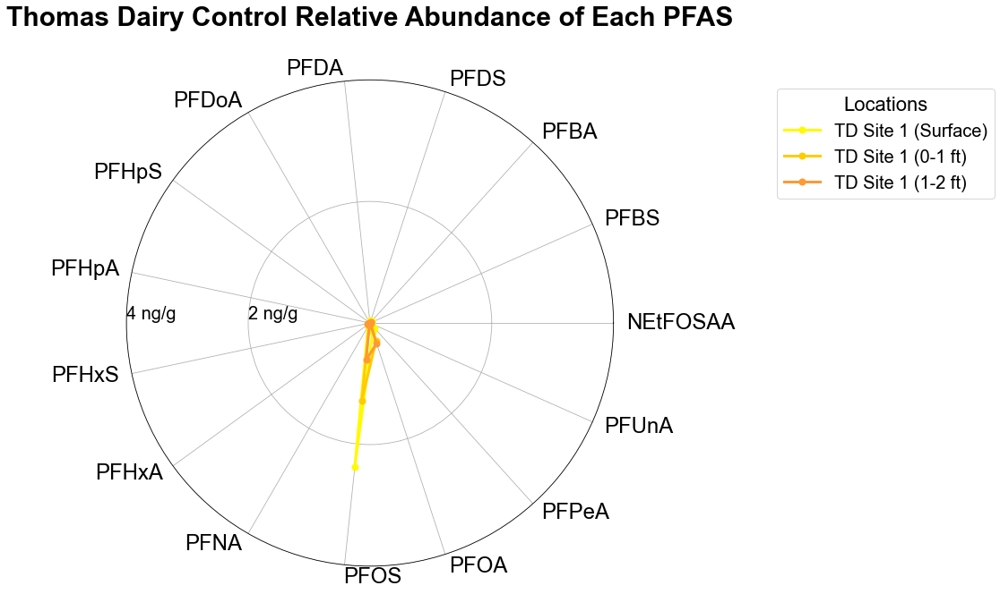

In [96]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['TD Site 1 (Surface)','TD Site 1 (0-1 ft)','TD Site 1 (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Thomas Dairy Control Relative Abundance of Each PFAS', ymax=4,percent_angle=180)

8.195


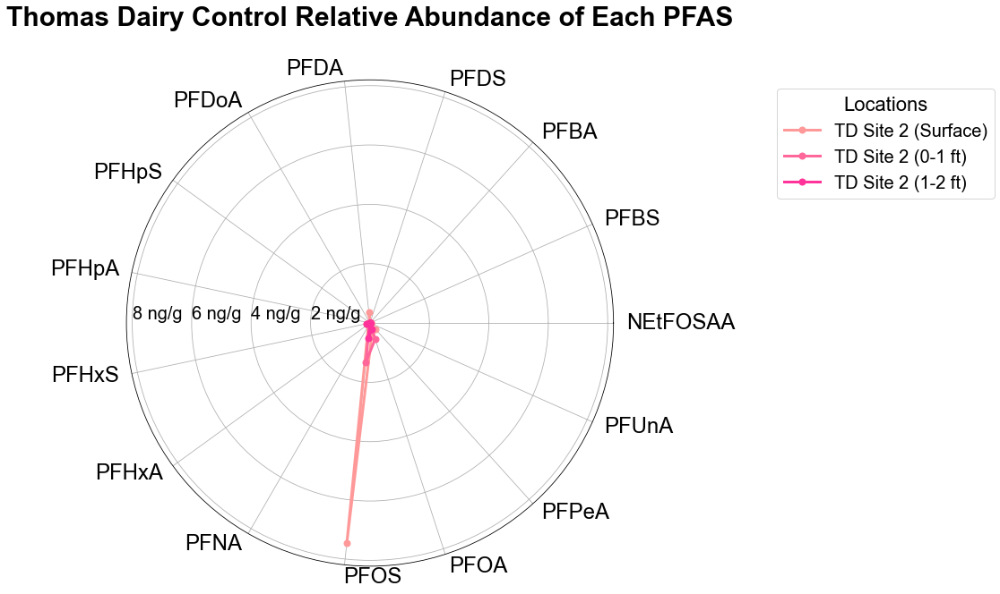

In [97]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['TD Site 2 (Surface)','TD Site 2 (0-1 ft)','TD Site 2 (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Thomas Dairy Control Relative Abundance of Each PFAS', ymax=y_max,percent_angle=180)

5


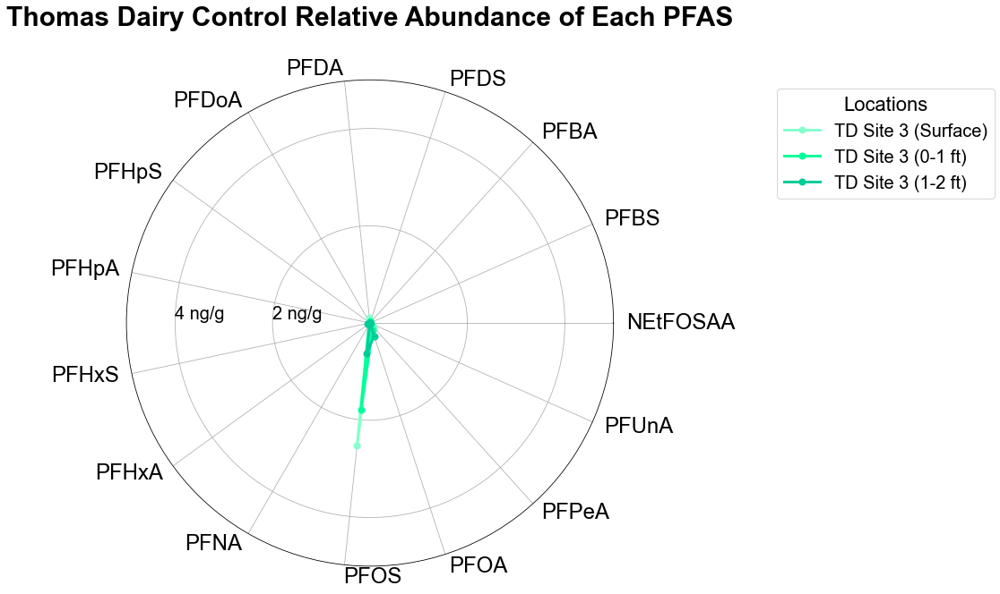

In [98]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['TD Site 3 (Surface)','TD Site 3 (0-1 ft)','TD Site 3 (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_avg_dfs[key] for key in include_keys if key in region_avg_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Thomas Dairy Control Relative Abundance of Each PFAS', ymax=y_max,percent_angle=180)

### Percentages

In [99]:
def create_percent_radar_plot(data_dict, color_list, figsize=(10, 10), legend_pos=(1.4, 1.1), ymax=100, percent_angle=260, title='Relative Abundance of Each PFAS by Location'):
    # Assuming all dataframes in the dictionary have the same index and columns
    labels = list(data_dict[next(iter(data_dict))].index)  # Get index from the first dataframe
    num_vars = len(labels)  # Number of PFAS compounds

    # Compute angle for each axis
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    angles += angles[:1]  # Complete the circle

    fig, ax = plt.subplots(figsize=figsize, subplot_kw=dict(polar=True))
    
    # Draw one axe per variable and add labels
    ax.set_thetagrids(np.degrees(angles[:-1]), labels, fontsize=24, color='black')
    for label, angle in zip(ax.get_xticklabels(), angles):
        if angle in (1.5, 4.5):
            label.set_horizontalalignment('center')
        elif 1.5 < angle < 4.5:
            label.set_horizontalalignment('right')
        else:
            label.set_horizontalalignment('left')

    # Check if the number of colors matches the number of locations
    if len(color_list) != len(data_dict):
        raise ValueError("The number of colors must match the number of locations provided in data_dict.")

    for (location, df), color in zip(data_dict.items(), color_list):
        values = df.iloc[:, 0].tolist()  # Assume each dataframe has one column of data per PFAS compound
        values += values[:1]  # Complete the circle to close the radar plot
        ax.plot(angles, values, linewidth=3, linestyle='solid', label=location, color=color, marker='o', markersize=8)
        #ax.fill(angles, values, alpha=0.25, color=color)

    # Adjusting the angle position for the radial grid labels (percentages)
    ax.set_rgrids(np.arange(20, 90, 20), labels=[f"{r}%" for r in range(20, 90, 20)], angle=percent_angle, fontsize=20)

    # Set the limits for radial grids
    ax.set_ylim(0, ymax)  # Assuming percentages are normalized to 100%

    # Add legend to the right side with custom position
    plt.legend(loc='upper right', bbox_to_anchor=legend_pos, title="Locations")
    
    plt.title(title, size=30, color='black', y=1.1)
    plt.show()

# Usage example:
# colors = ['red', 'blue', 'green', 'yellow']  # Define your color list
# create_percent_radar_plot(region_dfs, colors, figsize=(12, 12), legend_pos=(1.5, 1.2))

92.724598325413


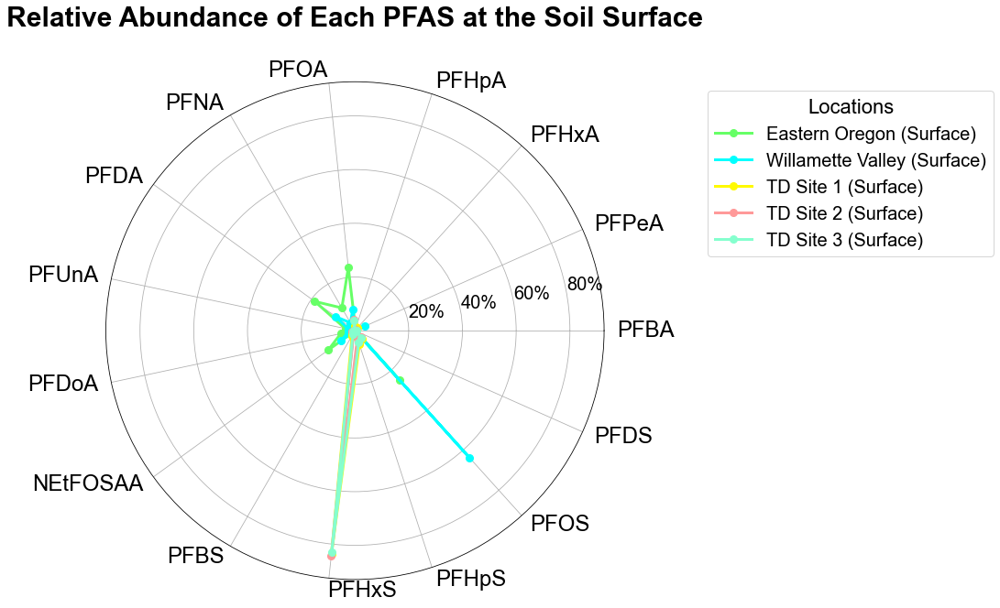

In [100]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087','#ff7c43','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (Surface)','Willamette Valley (Surface)','TD Site 1 (Surface)','TD Site 2 (Surface)','TD Site 3 (Surface)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the Soil Surface', ymax=y_max,percent_angle=10)

75.42708518058755


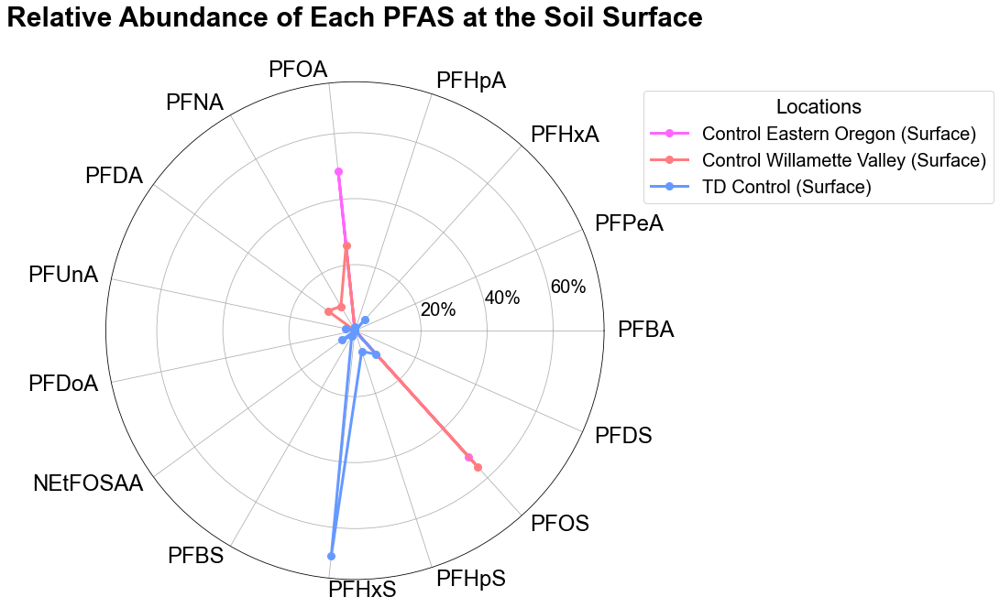

In [101]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Control Eastern Oregon (Surface)','Control Willamette Valley (Surface)','TD Control (Surface)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the Soil Surface', ymax=y_max,percent_angle=10)

92.61203825239079


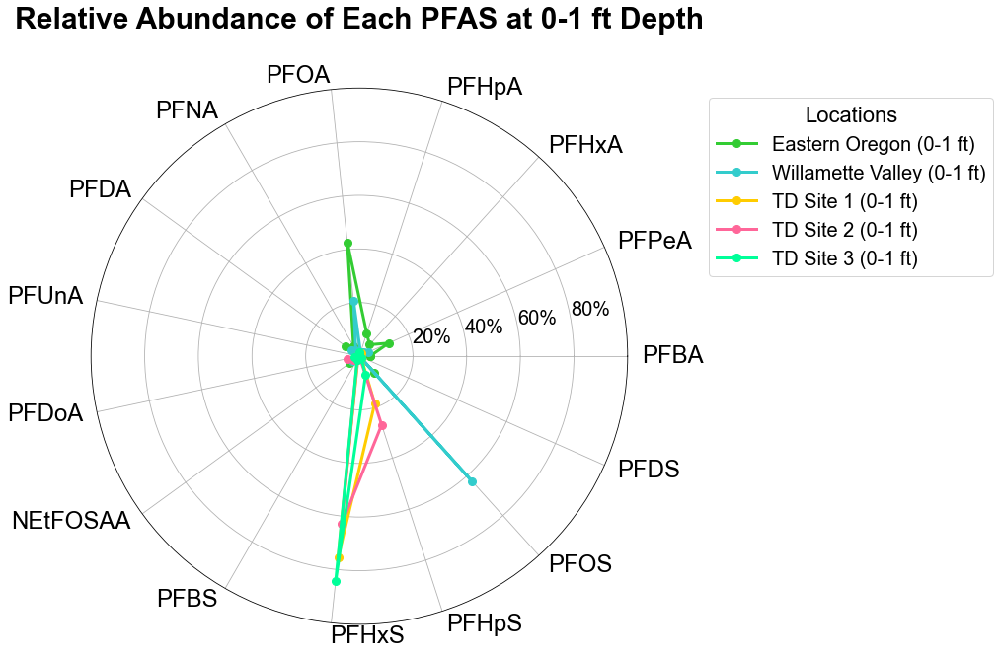

In [102]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087','#ff7c43','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (0-1 ft)','Willamette Valley (0-1 ft)','TD Site 1 (0-1 ft)','TD Site 2 (0-1 ft)','TD Site 3 (0-1 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 0-1 ft Depth', ymax=100,percent_angle=10)

110.00000000000001


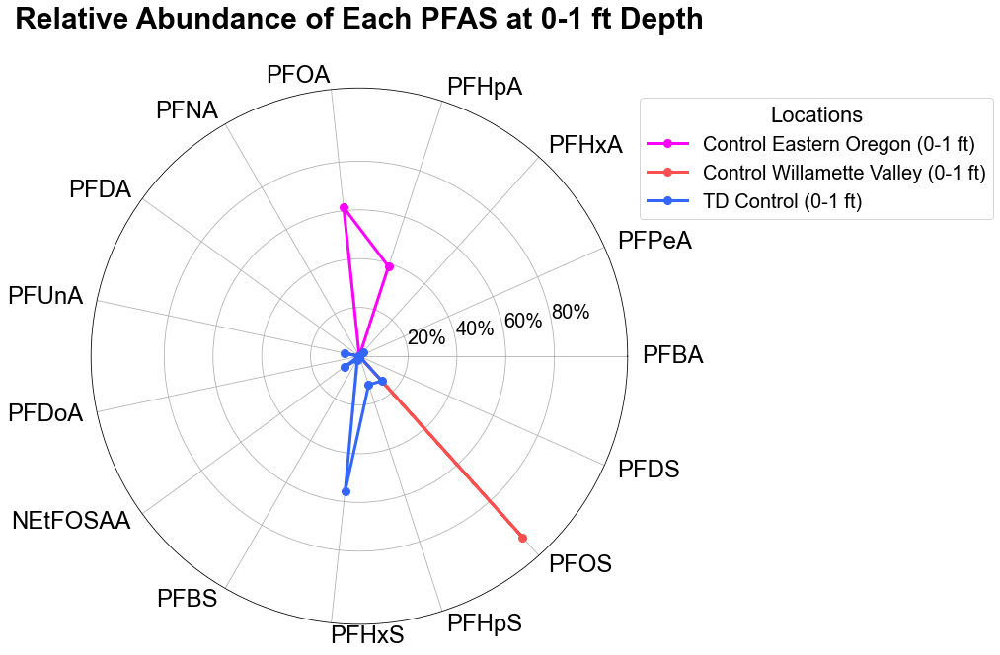

In [103]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Control Eastern Oregon (0-1 ft)','Control Willamette Valley (0-1 ft)','TD Control (0-1 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at 0-1 ft Depth', ymax=y_max,percent_angle=10)

67.9418210798964


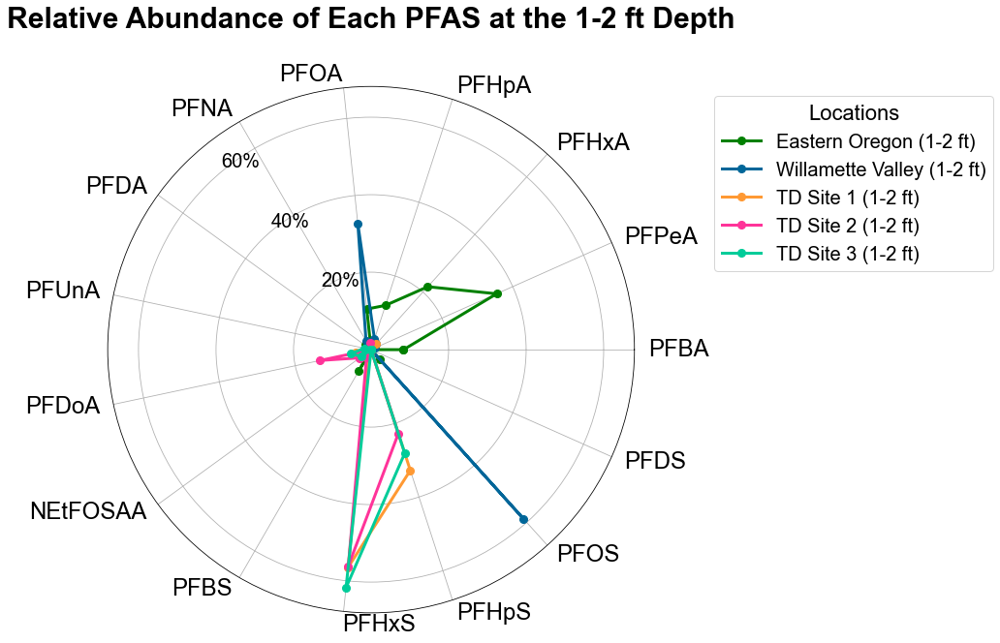

In [104]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','#d45087','#ff7c43','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (1-2 ft)','Willamette Valley (1-2 ft)','TD Site 1 (1-2 ft)','TD Site 2 (1-2 ft)','TD Site 3 (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the 1-2 ft Depth', ymax=y_max,percent_angle=130)

100


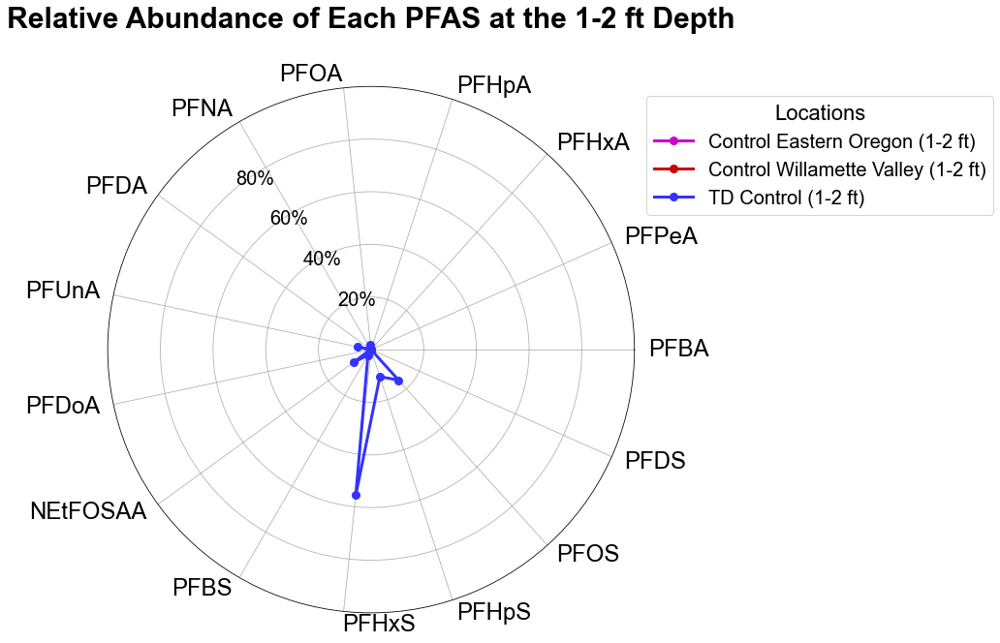

In [105]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#665191','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Control Eastern Oregon (1-2 ft)','Control Willamette Valley (1-2 ft)','TD Control (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Relative Abundance of Each PFAS at the 1-2 ft Depth', ymax=y_max,percent_angle=130)

46.93364084285565


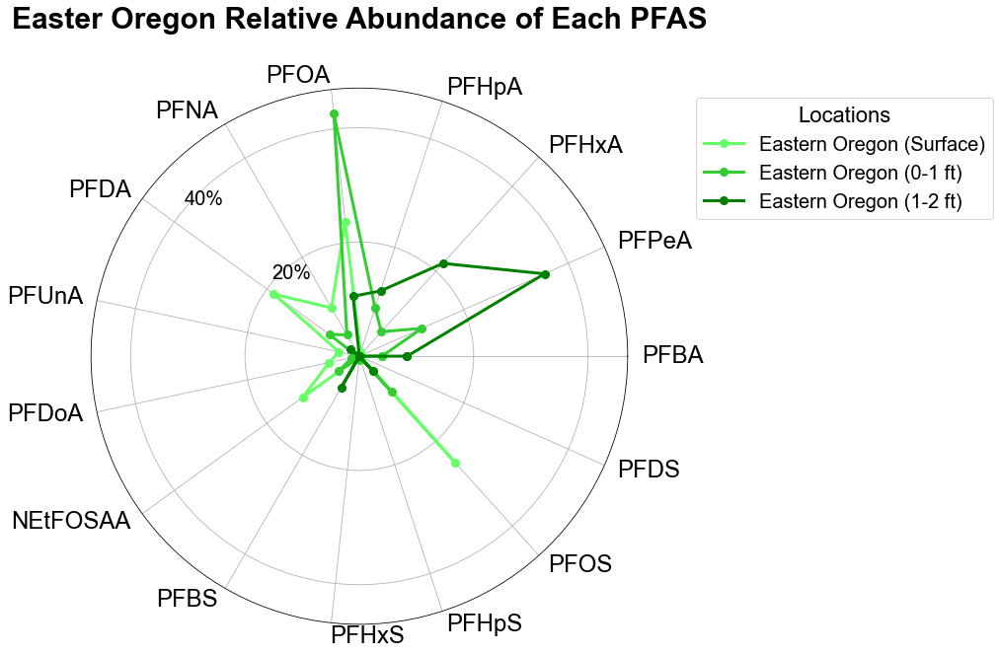

In [106]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['Eastern Oregon (Surface)','Eastern Oregon (0-1 ft)','Eastern Oregon (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Easter Oregon Relative Abundance of Each PFAS', ymax=y_max,percent_angle=140)

67.41935483870968


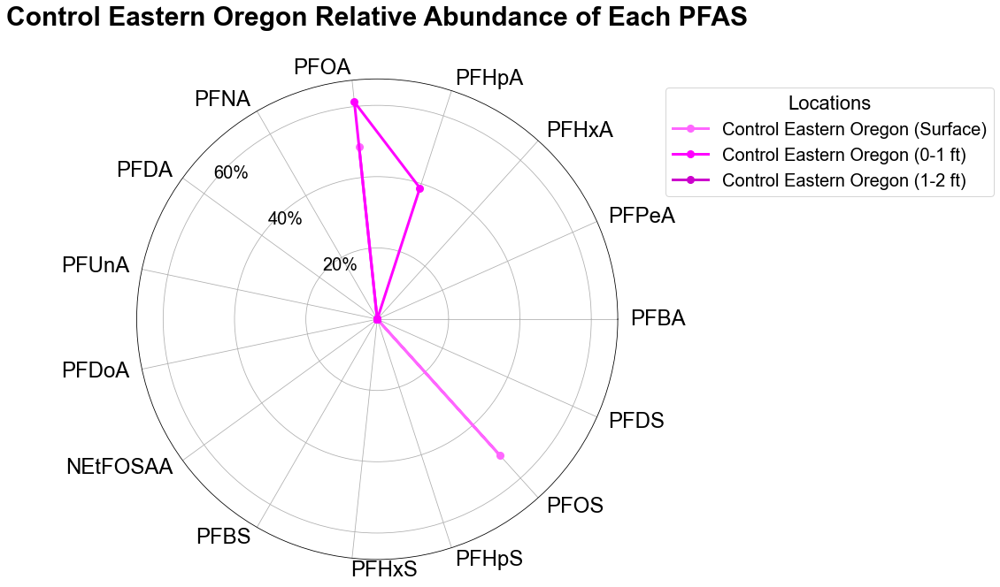

In [107]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['Control Eastern Oregon (Surface)','Control Eastern Oregon (0-1 ft)','Control Eastern Oregon (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Control Eastern Oregon Relative Abundance of Each PFAS', ymax=y_max,percent_angle=140)

69.95875841111354


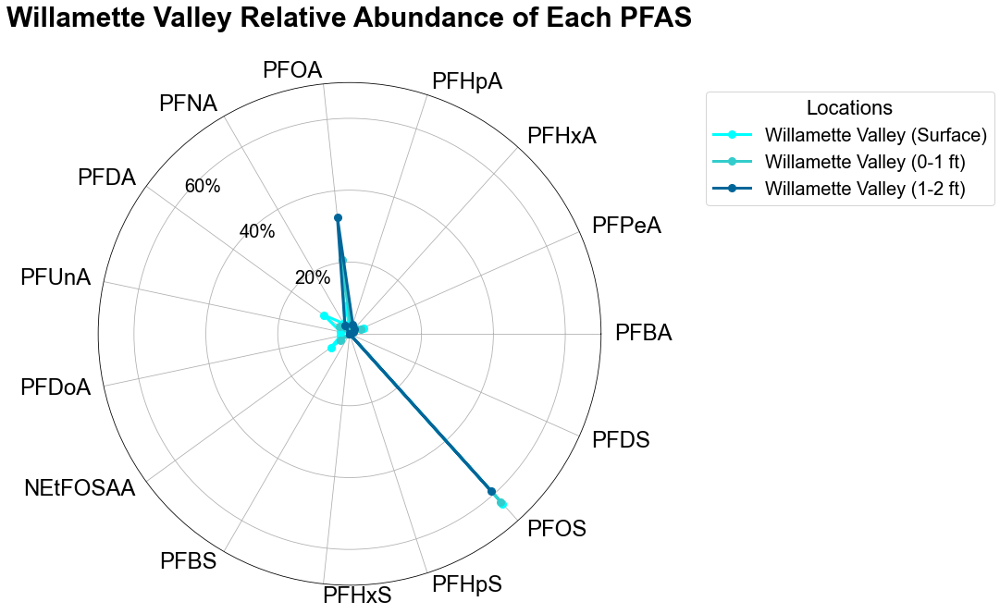

In [108]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['Willamette Valley (Surface)', 'Willamette Valley (0-1 ft)','Willamette Valley (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Willamette Valley Relative Abundance of Each PFAS', ymax=y_max,percent_angle=140)

110.00000000000001


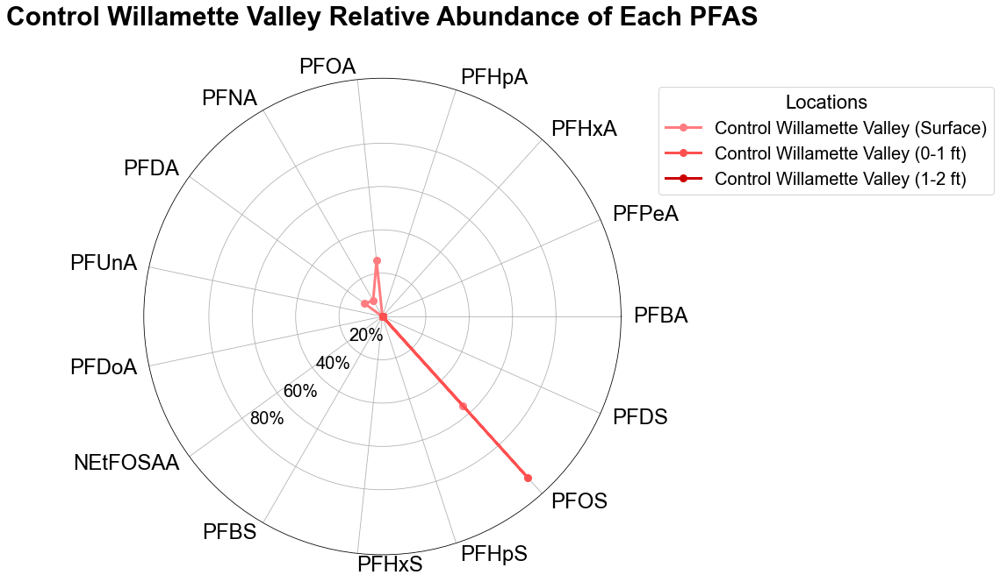

In [109]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = ['Control Willamette Valley (Surface)', 'Control Willamette Valley (0-1 ft)','Control Willamette Valley (1-2 ft)']

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.8, 1), color_list=color_list, title=f'Control Willamette Valley Relative Abundance of Each PFAS', ymax=y_max,percent_angle=220)

75.42708518058755


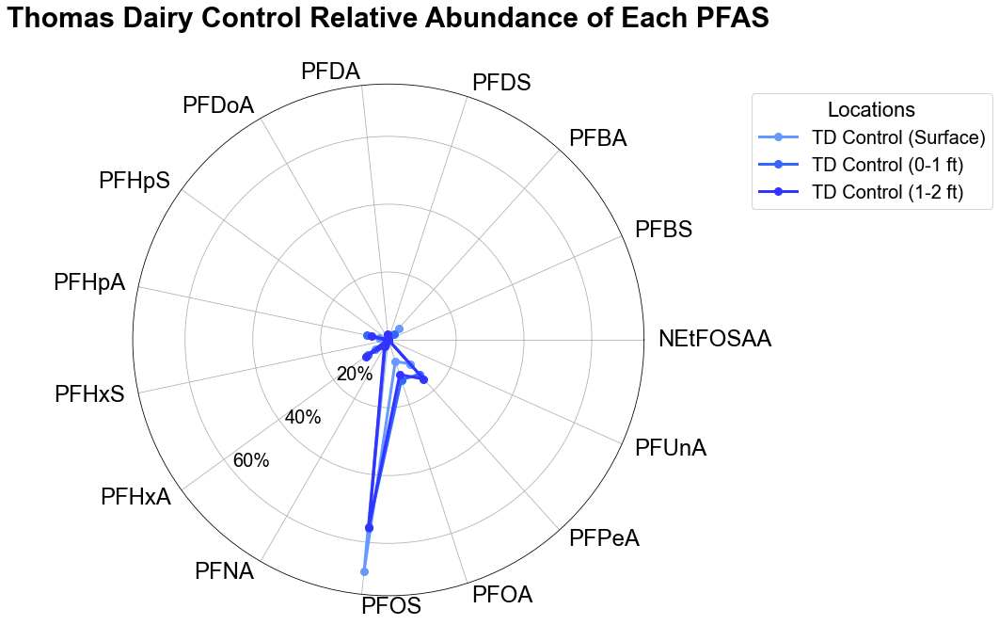

In [110]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'TD Control (Surface)','TD Control (0-1 ft)','TD Control (1-2 ft)',]

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Thomas Dairy Control Relative Abundance of Each PFAS', ymax=y_max,percent_angle=220)

91.96936696409753


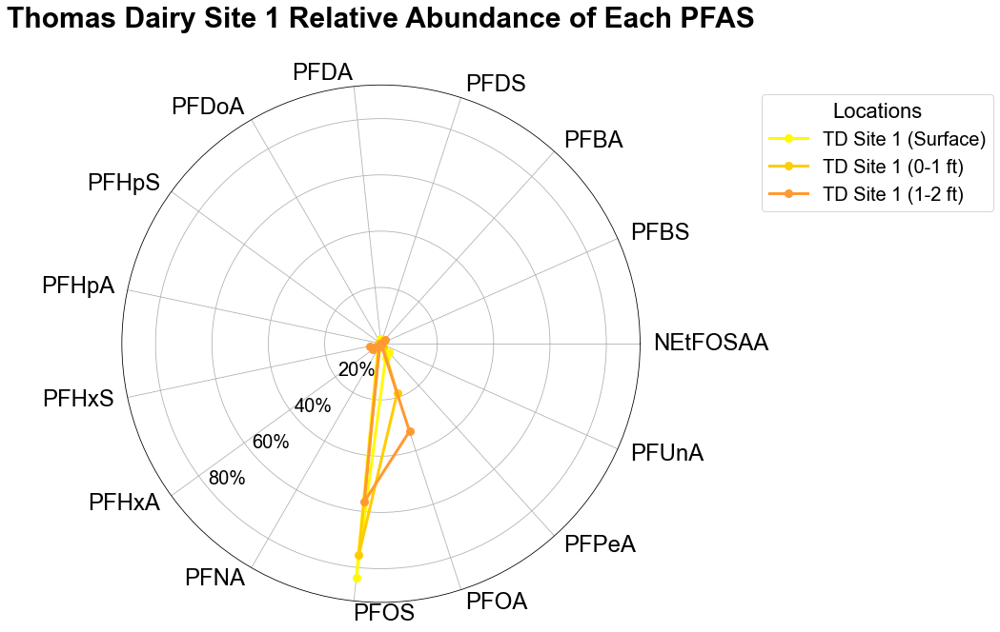

In [111]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'TD Site 1 (Surface)','TD Site 1 (0-1 ft)','TD Site 1 (1-2 ft)',]

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Thomas Dairy Site 1 Relative Abundance of Each PFAS', ymax=y_max,percent_angle=220)

92.724598325413


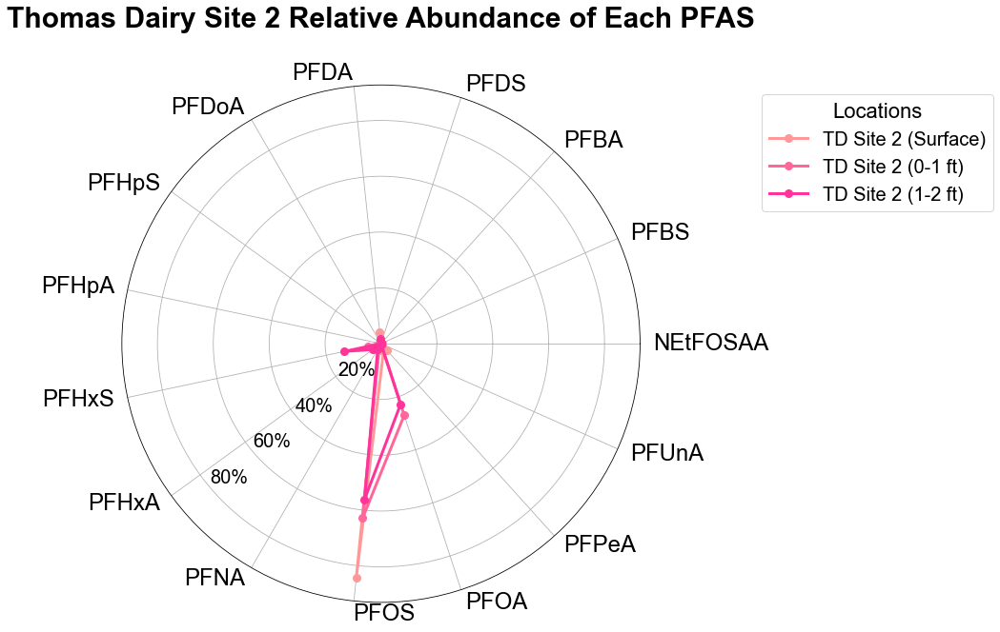

In [112]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'TD Site 2 (Surface)','TD Site 2 (0-1 ft)','TD Site 2 (1-2 ft)',]

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Thomas Dairy Site 2 Relative Abundance of Each PFAS', ymax=y_max,percent_angle=220)

92.61203825239079


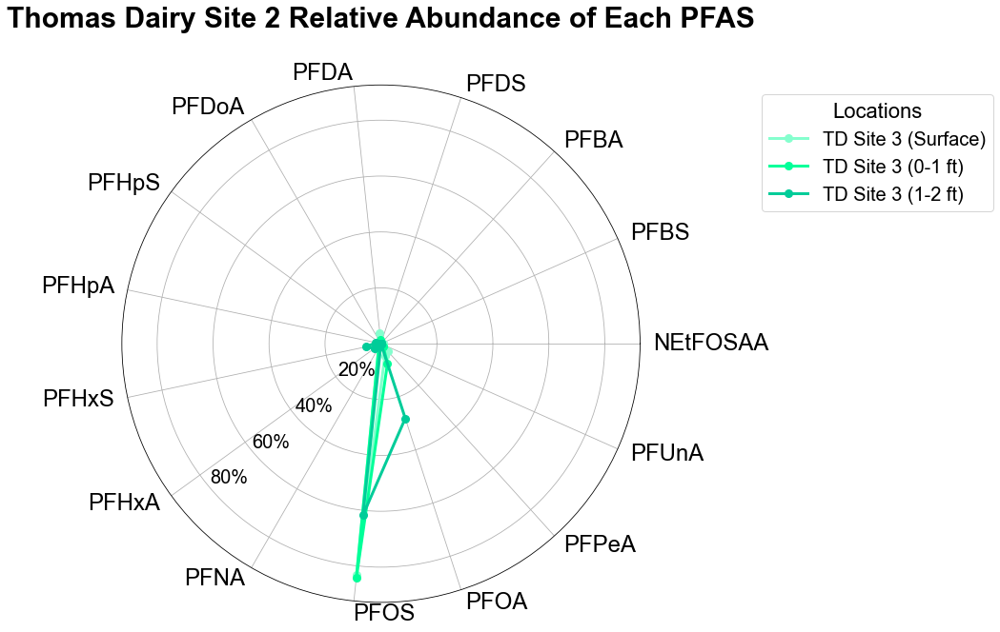

In [113]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#d45087','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'TD Site 3 (Surface)','TD Site 3 (0-1 ft)','TD Site 3 (1-2 ft)',]

# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}

# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# First, combine the values from all dataframes into a single list
all_values = [df.iloc[:, 0].max() for df in filtered_region_dfs.values()]

# Find the maximum value from this list
max_value_across_dfs = max(all_values)


y_max= max_value_across_dfs*1.10

if np.isnan(y_max):
    y_max = 100
elif y_max < 2:
    y_max=3
elif y_max < 5:
    y_max=5
else:
    y_max=y_max 
print(y_max)
# Generate the radar plot for the current dataframe
create_percent_radar_plot(filtered_region_dfs, figsize=(10, 10), legend_pos=(1.7, 1), color_list=color_list, title=f'Thomas Dairy Site 2 Relative Abundance of Each PFAS', ymax=y_max,percent_angle=220)

In [114]:
['Biosolids',
 'Eastern Oregon (0-1 ft)',
 'Eastern Oregon (1-2 ft)',
 'Eastern Oregon (Surface)',
 'Willamette Valley (0-1 ft)',
 'Willamette Valley (1-2 ft)',
 'Willamette Valley (Surface)',
 'Control Eastern Oregon (0-1 ft)',
 'Control Eastern Oregon (1-2 ft)',
 'Control Eastern Oregon (Surface)',
 'Control Willamette Valley (0-1 ft)',
 'Control Willamette Valley (1-2 ft)',
 'Control Willamette Valley (Surface)',
 'TD Control (Surface)',
 'TD Control (0-1 ft)',
 'TD Control (1-2 ft)',
 'TD Control (Groundwater)',
 'TD Site 1 (Surface)',
 'TD Site 1 (0-1 ft)',
 'TD Site 1 (1-2 ft)',
 'TD Site 1 (Groundwater)',
 'TD Site 2 (Surface)',
 'TD Site 2 (0-1 ft)',
 'TD Site 2 (1-2 ft)',
 'TD Site 2 (Groundwater)',
 'TD Site 3 (Surface)',
 'TD Site 3 (0-1 ft)',
 'TD Site 3 (1-2 ft)',
 'TD Site 3 (Groundwater)']

['Biosolids',
 'Eastern Oregon (0-1 ft)',
 'Eastern Oregon (1-2 ft)',
 'Eastern Oregon (Surface)',
 'Willamette Valley (0-1 ft)',
 'Willamette Valley (1-2 ft)',
 'Willamette Valley (Surface)',
 'Control Eastern Oregon (0-1 ft)',
 'Control Eastern Oregon (1-2 ft)',
 'Control Eastern Oregon (Surface)',
 'Control Willamette Valley (0-1 ft)',
 'Control Willamette Valley (1-2 ft)',
 'Control Willamette Valley (Surface)',
 'TD Control (Surface)',
 'TD Control (0-1 ft)',
 'TD Control (1-2 ft)',
 'TD Control (Groundwater)',
 'TD Site 1 (Surface)',
 'TD Site 1 (0-1 ft)',
 'TD Site 1 (1-2 ft)',
 'TD Site 1 (Groundwater)',
 'TD Site 2 (Surface)',
 'TD Site 2 (0-1 ft)',
 'TD Site 2 (1-2 ft)',
 'TD Site 2 (Groundwater)',
 'TD Site 3 (Surface)',
 'TD Site 3 (0-1 ft)',
 'TD Site 3 (1-2 ft)',
 'TD Site 3 (Groundwater)']

### Eastern Oregon, Willamette Valley, TD soils by Depth

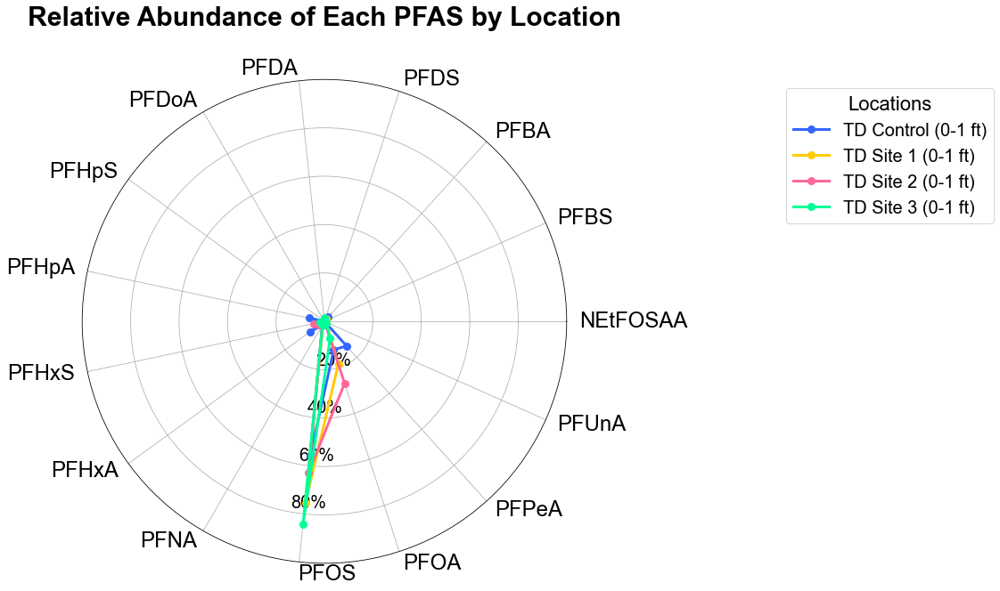

In [124]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
color_list=['#003f5c','#ffa600','gray','#a05195']
# List of keys you want to include in the new dictionary
include_keys = [ 'TD Control (0-1 ft)','TD Site 1 (0-1 ft)',
                 'TD Site 2 (0-1 ft)', 'TD Site 3 (0-1 ft)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
create_percent_radar_plot(filtered_region_dfs,figsize=(15, 10), legend_pos=(1.9, 1),color_list=color_list,title='Relative Abundance of Each PFAS by Location',ymax=100)

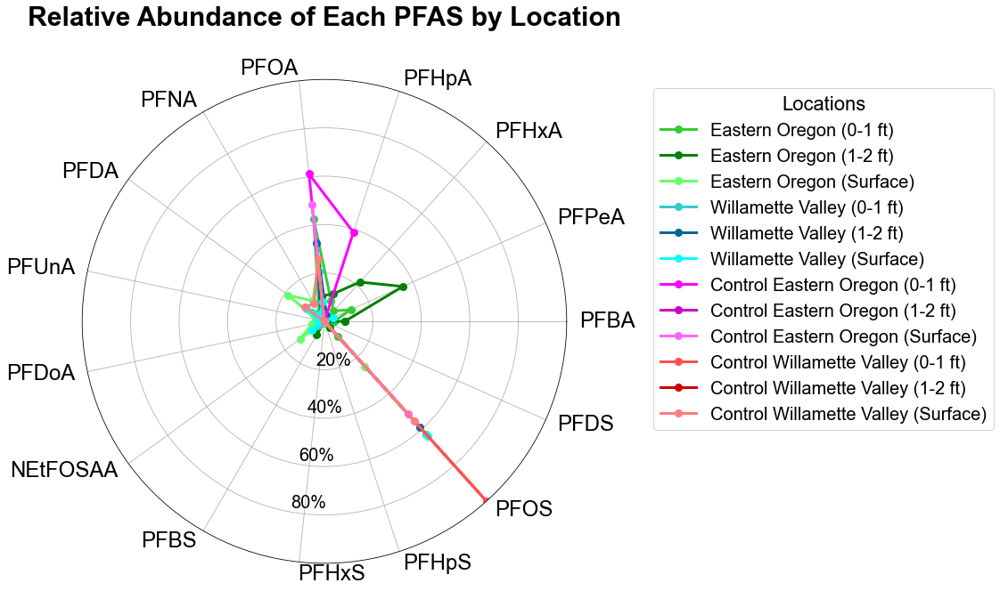

In [125]:
color_list=['#003f5c','#2f4b7c','#665191','#a05195','#d45087','#f95d6a','#ff7c43','#ffa600','gray','yellowgreen','yellow','hotpink']
# List of keys you want to include in the new dictionary
include_keys = ['Eastern Oregon (0-1 ft)',
 'Eastern Oregon (1-2 ft)',
 'Eastern Oregon (Surface)',
 'Willamette Valley (0-1 ft)',
 'Willamette Valley (1-2 ft)',
 'Willamette Valley (Surface)',
 'Control Eastern Oregon (0-1 ft)',
 'Control Eastern Oregon (1-2 ft)',
 'Control Eastern Oregon (Surface)',
 'Control Willamette Valley (0-1 ft)',
 'Control Willamette Valley (1-2 ft)',
 'Control Willamette Valley (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
create_percent_radar_plot(filtered_region_dfs,figsize=(15, 10), legend_pos=(1.9, 1),color_list=color_list,title='Relative Abundance of Each PFAS by Location')

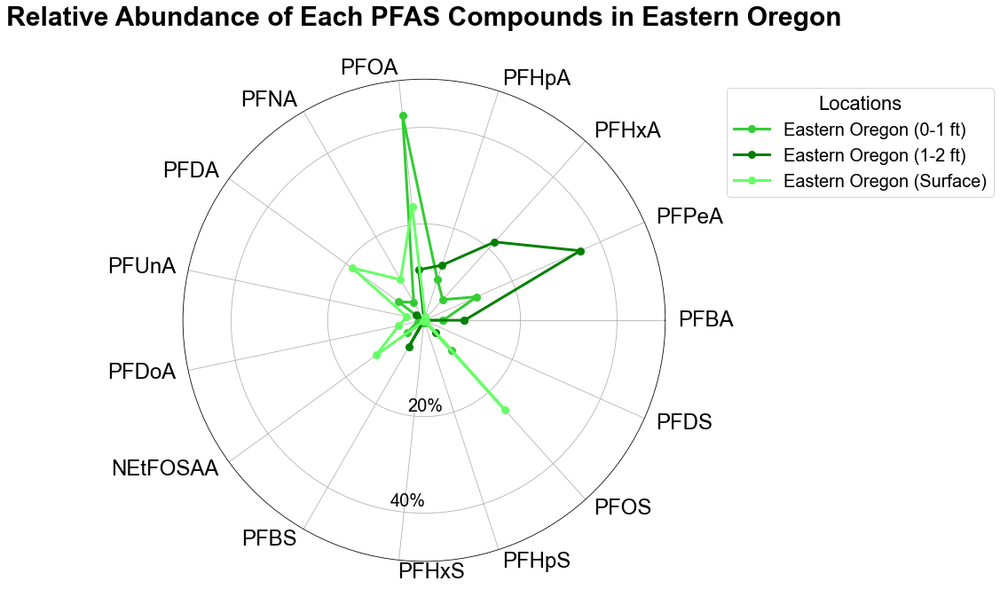

In [126]:
# Eastern Oregon
color_list=['#003f5c','#665191','#d45087']
# List of keys you want to include in the new dictionary
include_keys = ['Eastern Oregon (0-1 ft)','Eastern Oregon (1-2 ft)','Eastern Oregon (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
create_percent_radar_plot(filtered_region_dfs,figsize=(15, 10), legend_pos=(1.7, 1),color_list=color_list,title='Relative Abundance of Each PFAS Compounds in Eastern Oregon',ymax=50)


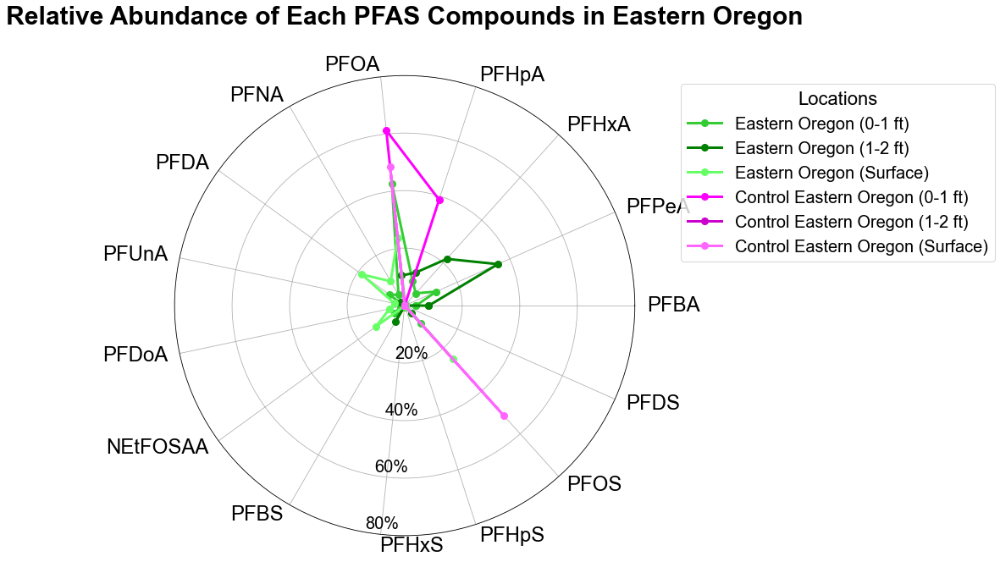

In [127]:
# Control Eastern Oregon
color_list=['#003f5c','#665191','#d45087','#ff7c43','yellowgreen','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Eastern Oregon (0-1 ft)', 'Eastern Oregon (1-2 ft)','Eastern Oregon (Surface)','Control Eastern Oregon (0-1 ft)','Control Eastern Oregon (1-2 ft)',
 'Control Eastern Oregon (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
create_percent_radar_plot(filtered_region_dfs,figsize=(15, 10), legend_pos=(1.8, 1),color_list=color_list,title='Relative Abundance of Each PFAS Compounds in Eastern Oregon',ymax=80)

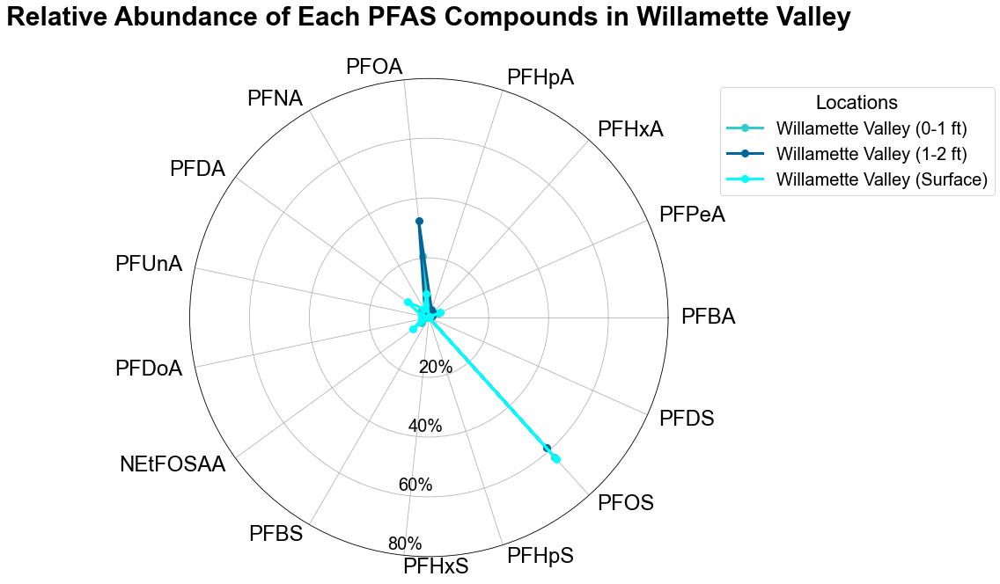

In [128]:
# Eastern Oregon
color_list=['#003f5c','#665191','#d45087']
# List of keys you want to include in the new dictionary
include_keys = ['Willamette Valley (0-1 ft)','Willamette Valley (1-2 ft)','Willamette Valley (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
create_percent_radar_plot(filtered_region_dfs,figsize=(15, 10), legend_pos=(1.7, 1),color_list=color_list,title='Relative Abundance of Each PFAS Compounds in Willamette Valley',ymax=80)

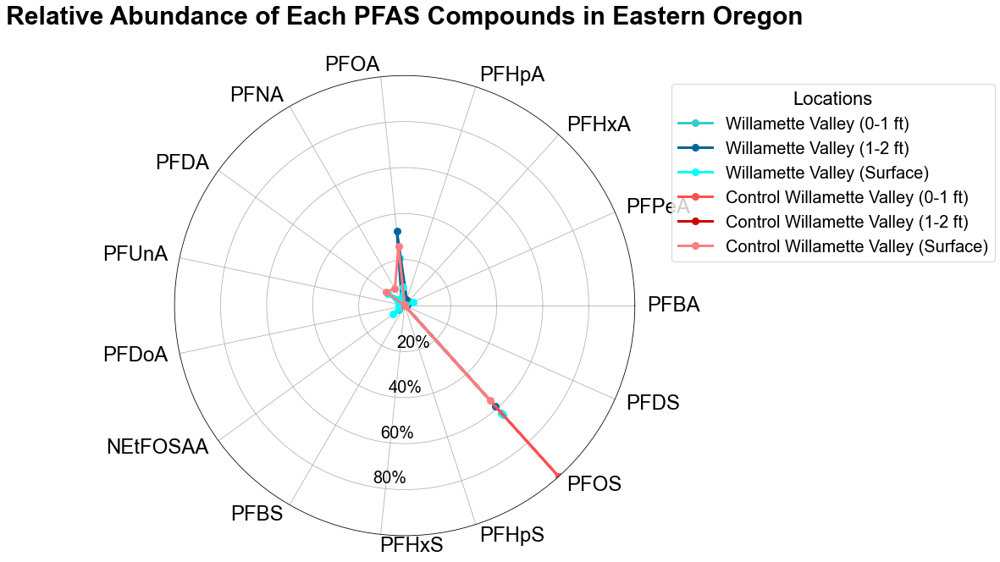

In [129]:
# Control Eastern Oregon
color_list=['#003f5c','#665191','#d45087','#ff7c43','yellowgreen','gray']
# List of keys you want to include in the new dictionary
include_keys = [ 'Willamette Valley (0-1 ft)','Willamette Valley (1-2 ft)','Willamette Valley (Surface)','Control Willamette Valley (0-1 ft)','Control Willamette Valley (1-2 ft)','Control Willamette Valley (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
create_percent_radar_plot(filtered_region_dfs,figsize=(15, 10), legend_pos=(1.8, 1),color_list=color_list,title='Relative Abundance of Each PFAS Compounds in Eastern Oregon',ymax=100)

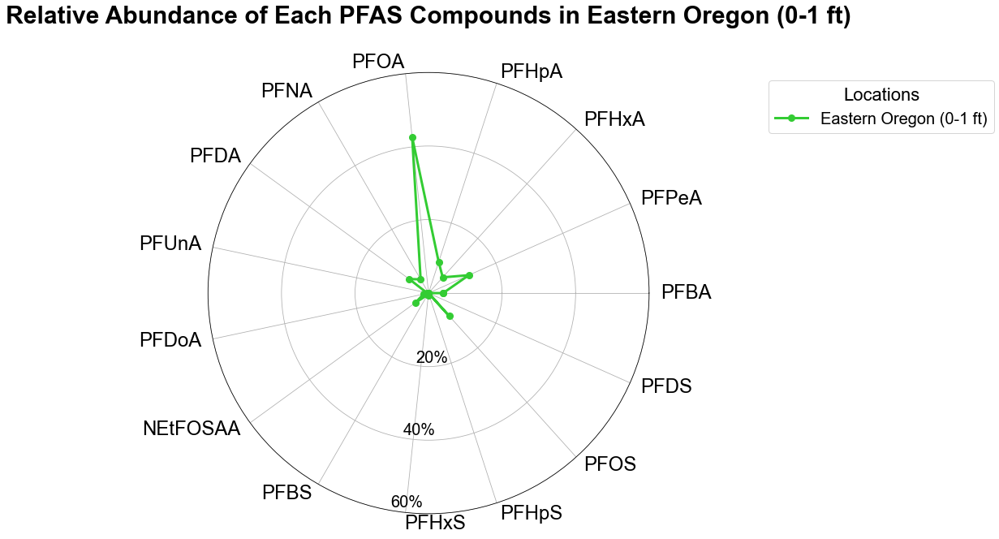

In [130]:
# Control Eastern Oregon
color_list=['#003f5c']
# List of keys you want to include in the new dictionary
include_keys = ['Eastern Oregon (0-1 ft)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
create_percent_radar_plot(filtered_region_dfs,figsize=(15, 10), legend_pos=(1.8, 1),color_list=color_list,title='Relative Abundance of Each PFAS Compounds in Eastern Oregon (0-1 ft)',ymax=60)

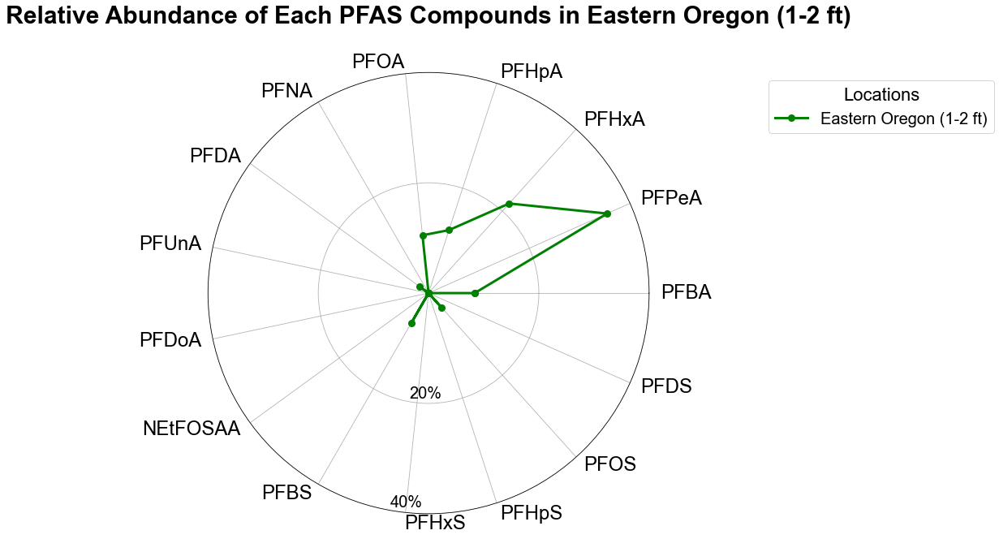

In [131]:
# Control Eastern Oregon
color_list=['#003f5c']
# List of keys you want to include in the new dictionary
include_keys = ['Eastern Oregon (1-2 ft)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
create_percent_radar_plot(filtered_region_dfs,figsize=(15, 10), legend_pos=(1.8, 1),color_list=color_list,title='Relative Abundance of Each PFAS Compounds in Eastern Oregon (1-2 ft)',ymax=40)

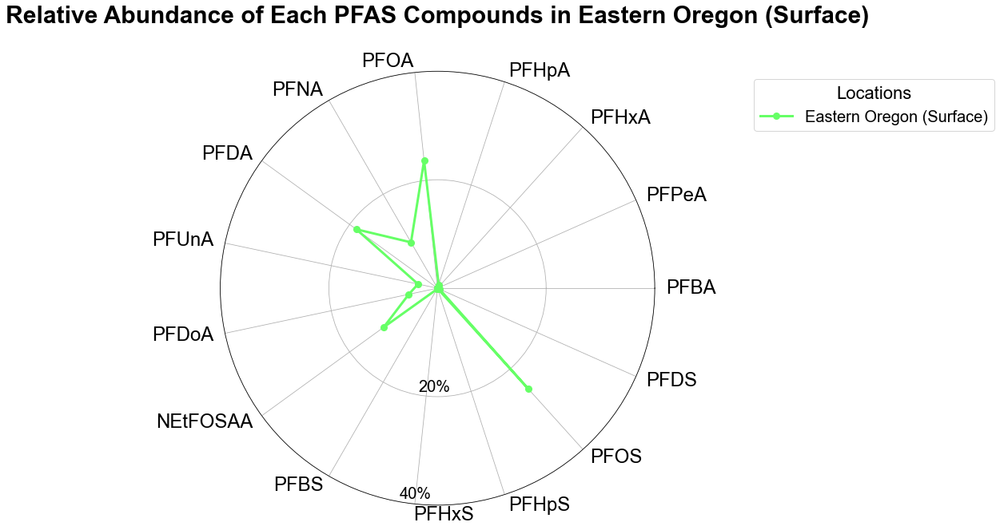

In [132]:
# Control Eastern Oregon
color_list=['#003f5c']
# List of keys you want to include in the new dictionary
include_keys = ['Eastern Oregon (Surface)']
# Create a color list by extracting the corresponding colors from the color_dic_radar_normalized dictionary
color_list = [color_dic_radar_normalized[key] for key in include_keys if key in color_dic_radar_normalized]
# Create a new dictionary with only these keys
filtered_region_dfs = {key: region_percent_dfs[key] for key in include_keys if key in region_percent_dfs}
create_percent_radar_plot(filtered_region_dfs,figsize=(15, 10), legend_pos=(1.8, 1),color_list=color_list,title='Relative Abundance of Each PFAS Compounds in Eastern Oregon (Surface)',ymax=40)